<a href="https://colab.research.google.com/github/DenyaUdin/_CV_/blob/main/Pizza.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pandas as pd
import numpy as np
from tqdm import tqdm_notebook
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
# модули библиотеки PyTorch
import torch
from torchvision import datasets, transforms
from sklearn.model_selection import train_test_split
import torch
from torch import nn
from torch.nn import functional as F
import tensorflow as tf
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import f1_score
from pathlib import Path
from PIL import Image
import os
from torchsummary import summary
import datetime
from torchmetrics import JaccardIndex

In [ ]:
alls_images = os.listdir('/train/images')
alls_images_train = []
for i in range(len(alls_images)):
    alls_images_train.append(Path('/train/images/'+alls_images[i]))


alls_masks = os.listdir('/train/masks')
alls_masks_new = []
for i in range(len(alls_images)):
    for j in range(len(alls_masks)):
        if alls_images[i][:26] == alls_masks[j][0:26]:
            alls_masks_new.append(alls_masks[j])

alls_masks_train = []
for i in range(len(alls_masks_new)):
    alls_masks_train.append(Path('/train/masks/'+alls_masks_new[i]))

torch.manual_seed(17)
X_train, X_val, y_train, y_val = train_test_split(alls_images_train, alls_masks_train, train_size=0.8)
import torch

df_train = pd.DataFrame(list(zip(X_train, y_train)), columns = ['images', 'masks'])
df_val = pd.DataFrame(list(zip(X_val, y_val)), columns = ['images', 'masks'])

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import argparse
import os
import datetime

In [ ]:
class Dataset_new():
    
    def __init__(self, image_dir):
        self.image_dir = image_dir
        
        
        
    def __len__(self):
        return len(self.image_dir)
    
    def __getitem__(self, index):
        image_fn = self.image_dir['images'][index]
        image_fp = os.path.join(image_fn)
        image = Image.open(image_fp)
        transform_img = transforms.Compose([
            transforms.Resize((512, 512), Image.NEAREST),
                transforms.ToTensor(),
            
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
        transform_mask = transforms.Compose([
                transforms.Resize((512, 512), Image.NEAREST),
                transforms.ToTensor()
                ])
        image = transform_img(image)

        mask_fn = self.image_dir['masks'][index]
        mask_fp = os.path.join(mask_fn)
        mask = Image.open(mask_fp)
        mask = transform_mask(mask)*255
        
        x = np.random.randint(0, 2)
        y = np.random.randint(0, 2)
        image = self.__crop__(image, y, x)
        mask = self.__crop__(mask, y, x)
        z = np.random.randint(0, 3)
        if z == 0:
            image = transforms.functional.hflip(image)
            mask = transforms.functional.hflip(mask)
        elif z == 1:
            image = transforms.functional.vflip(image)
            mask = transforms.functional.vflip(mask)
        #elif z == 2:
            #image = transforms.functional.vflip(image)
            #mask = transforms.functional.vflip(mask)
            #image = transforms.functional.hflip(image)
            #mask = transforms.functional.hflip(mask)
        t = np.random.randint(0, 2)
        if t == 0:
            image = transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))(image)

        
        mask = self._gen_masks_(mask)
        return image, mask
    
    def __crop__(self, mask_, y, x):
        mask_crop = mask_[:, y*256:y*256+256, x*256:x*256+256]
        return mask_crop
    def _gen_masks_(self, mask_):
        output = np.zeros((mask_.shape[1], mask_.shape[2], 4))
        for i in range(mask_.shape[1]):
            for j in range(mask_.shape[2]):
                if mask_[0][i][j] == 254:
                    output[i][j][0] = 1
                elif mask_[0][i][j] == 114:
                    output[i][j][1] = 1
                elif mask_[0][i][j] == 24:
                    output[i][j][2] = 1
                elif mask_[0][i][j] == 0:
                    output[i][j][3] = 1
            
        return output  


In [ ]:
def __gen_pred__(mask_):
    mask_= mask_.permute(1, 2, 0)
    output = np.zeros((256, 256))
    for i in range(256):
        for j in range(256):
            if np.argmax(mask_[i][j].cpu().detach().numpy()) == 0:
                output[i][j] = 254
            elif np.argmax(mask_[i][j].cpu().detach().numpy()) == 1:
                output[i][j] = 114
            elif np.argmax(mask_[i][j].cpu().detach().numpy()) == 2:
                output[i][j] = 24
            elif np.argmax(mask_[i][j].cpu().detach().numpy()) == 3:
                output[i][j] = 0
            
    return output  

inverse_transform = transforms.Compose([
    transforms.Normalize((-0.485/0.229, -0.456/0.224, -0.406/0.225), (1/0.229, 1/0.224, 1/0.225))
    ])

In [ ]:
def __gen__(mask_):
        output = np.zeros((mask_.shape[0], mask_.shape[1]))
        for i in range(mask_.shape[0]):
            for j in range(mask_.shape[1]):
                if mask_[i][j][0] == 1:
                    output[i][j] = 254
                elif mask_[i][j][1] == 1:
                    output[i][j] = 114
                elif mask_[i][j][2] == 1:
                    output[i][j] = 24
                elif mask_[i][j][3] == 1:
                    output[i][j] = 0
        return output

In [ ]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.Relu = nn.ReLU()
        self.Upsample = torch.nn.Upsample(scale_factor=2)
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_11_res = self.shortcut_conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_21_res = self.shortcut_conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_31_res = self.shortcut_conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_41_res = self.shortcut_conv_block(in_channels=128, out_channels=256)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=256, out_channels=512)
        self.middle_res = self.shortcut_conv_block(in_channels=256, out_channels=512)
        self.expansive_11 = self.up_conv_block(in_channels=512, out_channels=256)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_12_res = self.shortcut_conv_block(in_channels=512, out_channels=256)
        self.expansive_21 = self.up_conv_block(in_channels=256, out_channels=128)
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_22_res = self.shortcut_conv_block(in_channels=256, out_channels=128)
        self.expansive_31 = self.up_conv_block(in_channels=128, out_channels=64)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_32_res = self.shortcut_conv_block(in_channels=128, out_channels=64)
        self.expansive_41 = self.up_conv_block(in_channels=64, out_channels=32)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.expansive_42_res = self.shortcut_conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
    
    def shortcut_conv_block(self, in_channels, out_channels):
        block = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1)
        return block

    def up_conv_block(self, in_channels, out_channels):
        block = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1)
        return block
    
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_11_out_res = self.Relu(torch.add(self.contracting_11_res(X), contracting_11_out))
        contracting_12_out = self.contracting_12(contracting_11_out_res) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_21_out_res = self.Relu(torch.add(self.contracting_21_res(contracting_12_out), contracting_21_out))
        contracting_22_out = self.contracting_22(contracting_21_out_res) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_res = self.Relu(torch.add(self.contracting_31_res(contracting_22_out), contracting_31_out))
        #contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_res) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_res = self.Relu(torch.add(self.contracting_41_res(contracting_32_out), contracting_41_out))
        #contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_res) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        middle_out_res = self.Relu(torch.add(self.middle_res(contracting_42_out), middle_out))
        expansive_11_out = self.expansive_11(self.Upsample(middle_out_res)) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, contracting_41_out), dim=1)) # [-1, 1024, 32, 32] -> [-1, 512, 32, 32]
        expansive_12_out_res = self.Relu(torch.add(self.expansive_12_res(torch.cat((expansive_11_out, contracting_41_out), dim=1)), expansive_12_out))
        expansive_21_out = self.expansive_21(self.Upsample(expansive_12_out_res)) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        
        expansive_22_out_res = self.Relu(torch.add(self.expansive_22_res(torch.cat((expansive_21_out, contracting_31_out), dim=1)), expansive_22_out))
        
        expansive_31_out = self.expansive_31(self.Upsample(expansive_22_out_res)) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
       
        expansive_32_out_res = self.Relu(torch.add(self.expansive_32_res(torch.cat((expansive_31_out, contracting_21_out), dim=1)), expansive_32_out))
        
        expansive_41_out = self.expansive_41(self.Upsample(expansive_32_out_res)) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        expansive_42_out_res = self.Relu(torch.add(self.expansive_42_res(torch.cat((expansive_41_out, contracting_11_out), dim=1)), expansive_42_out))
        output_out = self.output(expansive_42_out_res) # [-1, num_classes, 256, 256]
        return output_out

В att перейдем к размерности g


In [ ]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.Relu = nn.ReLU()
        self.Sigmoid = nn.Sigmoid()
        self.Softmax = nn.Softmax2d()
        self.Upsample = torch.nn.Upsample(scale_factor=2)
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_11_res = self.shortcut_conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_21_res = self.shortcut_conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_31_res = self.shortcut_conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_41_res = self.shortcut_conv_block(in_channels=128, out_channels=256)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=256, out_channels=512)
        self.middle_res = self.shortcut_conv_block(in_channels=256, out_channels=512)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.phi_g_11 = self.shortcut_conv_block(in_channels=512, out_channels=256)
        self.theta_11 = self.theta_conv_block(in_channels=256, out_channels=256)
        self.psi_11 = nn.Conv2d(in_channels=256, out_channels=1, kernel_size=1, stride=1)
        self.result_att_11 = self.shortcut_conv_block(in_channels=256, out_channels=256)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_12_res = self.shortcut_conv_block(in_channels=512, out_channels=256)
        
        self.expansive_21 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.phi_g_21 = self.shortcut_conv_block(in_channels=256, out_channels=128)
        self.theta_21 = self.theta_conv_block(in_channels=128, out_channels=128)
        self.psi_21 = nn.Conv2d(in_channels=128, out_channels=1, kernel_size=1, stride=1)
        self.result_att_21 = self.shortcut_conv_block(in_channels=128, out_channels=128)
    
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_22_res = self.shortcut_conv_block(in_channels=256, out_channels=128)
        
        self.expansive_31 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.phi_g_31 = self.shortcut_conv_block(in_channels=128, out_channels=64)
        self.theta_31 = self.theta_conv_block(in_channels=64, out_channels=64)
        self.psi_31 = nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1, stride=1)
        self.result_att_31 = self.shortcut_conv_block(in_channels=64, out_channels=64)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_32_res = self.shortcut_conv_block(in_channels=128, out_channels=64)
        
        self.expansive_41 = nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.phi_g_41 = self.shortcut_conv_block(in_channels=64, out_channels=32)
        self.theta_41 = self.theta_conv_block(in_channels=32, out_channels=32)
        self.psi_41 = nn.Conv2d(in_channels=32, out_channels=1, kernel_size=1, stride=1)
        self.result_att_41 = self.shortcut_conv_block(in_channels=32, out_channels=32)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.expansive_42_res = self.shortcut_conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
    
    def shortcut_conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1),
                           nn.BatchNorm2d(num_features=out_channels))    
        return block
    def theta_conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=2, stride=2),
                           nn.BatchNorm2d(num_features=out_channels))    
        return block
    
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_11_out_res = self.Relu(torch.add(self.contracting_11_res(X), contracting_11_out))
        contracting_12_out = self.contracting_12(contracting_11_out_res) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_21_out_res = self.Relu(torch.add(self.contracting_21_res(contracting_12_out), contracting_21_out))
        contracting_22_out = self.contracting_22(contracting_21_out_res) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_res = self.Relu(torch.add(self.contracting_31_res(contracting_22_out), contracting_31_out))
        #contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_res) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_res = self.Relu(torch.add(self.contracting_41_res(contracting_32_out), contracting_41_out))
        #contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_res) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        middle_out_res = self.Relu(torch.add(self.middle_res(contracting_42_out), middle_out))
        
        expansive_11_out = self.Relu(self.expansive_11(middle_out_res))
        expansive_11_psi = self.Upsample(self.Softmax(self.psi_11(self.Relu(torch.add(self.phi_g_11(middle_out_res), self.theta_11(contracting_41_out_res)))))).repeat(1, 256, 1, 1)
        expansive_11_att = self.Relu(self.result_att_11(torch.mul(expansive_11_psi, contracting_41_out_res)))
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, expansive_11_att), dim=1))
        expansive_12_out_res = self.Relu(torch.add(self.expansive_12_res(torch.cat((expansive_11_out, expansive_11_att), dim=1)), expansive_12_out))
        
        expansive_21_out = self.Relu(self.expansive_21(expansive_12_out_res))
        expansive_21_psi = self.Upsample(self.Softmax(self.psi_21(self.Relu(torch.add(self.phi_g_21(expansive_12_out_res), self.theta_21(contracting_31_out_res)))))).repeat(1, 128, 1, 1)
        expansive_21_att = self.Relu(self.result_att_21(torch.mul(expansive_21_psi, contracting_31_out_res)))
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, expansive_21_att), dim=1)) 
        expansive_22_out_res = self.Relu(torch.add(self.expansive_22_res(torch.cat((expansive_21_out, expansive_21_att), dim=1)), expansive_22_out))
        
        expansive_31_out = self.Relu(self.expansive_31(expansive_22_out_res))
        expansive_31_psi = self.Upsample(self.Softmax(self.psi_31(self.Relu(torch.add(self.phi_g_31(expansive_22_out_res), self.theta_31(contracting_21_out_res)))))).repeat(1, 64, 1, 1)
        expansive_31_att = self.Relu(self.result_att_31(torch.mul(expansive_31_psi, contracting_21_out_res)))
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, expansive_31_att), dim=1)) 
        expansive_32_out_res = self.Relu(torch.add(self.expansive_32_res(torch.cat((expansive_31_out, expansive_31_att), dim=1)), expansive_32_out))
        
        expansive_41_out = self.Relu(self.expansive_41(expansive_32_out_res))
        expansive_41_psi = self.Upsample(self.Softmax(self.psi_41(self.Relu(torch.add(self.phi_g_41(expansive_32_out_res), self.theta_41(contracting_11_out_res)))))).repeat(1, 32, 1, 1)
        expansive_41_att = self.Relu(self.result_att_41(torch.mul(expansive_41_psi, contracting_11_out_res)))
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, expansive_41_att), dim=1)) 
        expansive_42_out_res = self.Relu(torch.add(self.expansive_42_res(torch.cat((expansive_41_out, expansive_41_att), dim=1)), expansive_42_out))
        
        output_out = self.output(expansive_42_out_res) 
        return output_out

In [ ]:
model = UNet(num_classes=4).to(device)
from torchsummary import summary
summary(model, (3, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 32, 256, 256]        --
|    └─Conv2d: 2-1                       [-1, 32, 256, 256]        896
|    └─ReLU: 2-2                         [-1, 32, 256, 256]        --
|    └─BatchNorm2d: 2-3                  [-1, 32, 256, 256]        64
|    └─Conv2d: 2-4                       [-1, 32, 256, 256]        9,248
|    └─BatchNorm2d: 2-5                  [-1, 32, 256, 256]        64
├─Sequential: 1-2                        [-1, 32, 256, 256]        --
|    └─Conv2d: 2-6                       [-1, 32, 256, 256]        128
|    └─BatchNorm2d: 2-7                  [-1, 32, 256, 256]        64
├─ReLU: 1-3                              [-1, 32, 256, 256]        --
├─MaxPool2d: 1-4                         [-1, 32, 128, 128]        --
├─Sequential: 1-5                        [-1, 64, 128, 128]        --
|    └─Conv2d: 2-8                       [-1, 64, 128, 128]        18,496
|    └

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 32, 256, 256]        --
|    └─Conv2d: 2-1                       [-1, 32, 256, 256]        896
|    └─ReLU: 2-2                         [-1, 32, 256, 256]        --
|    └─BatchNorm2d: 2-3                  [-1, 32, 256, 256]        64
|    └─Conv2d: 2-4                       [-1, 32, 256, 256]        9,248
|    └─BatchNorm2d: 2-5                  [-1, 32, 256, 256]        64
├─Sequential: 1-2                        [-1, 32, 256, 256]        --
|    └─Conv2d: 2-6                       [-1, 32, 256, 256]        128
|    └─BatchNorm2d: 2-7                  [-1, 32, 256, 256]        64
├─ReLU: 1-3                              [-1, 32, 256, 256]        --
├─MaxPool2d: 1-4                         [-1, 32, 128, 128]        --
├─Sequential: 1-5                        [-1, 64, 128, 128]        --
|    └─Conv2d: 2-8                       [-1, 64, 128, 128]        18,496
|    └

In [ ]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.Relu = nn.ReLU()
        self.Sigmoid = nn.Sigmoid()
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_11_res = self.shortcut_conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_21_res = self.shortcut_conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_31_res = self.shortcut_conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_41_res = self.shortcut_conv_block(in_channels=128, out_channels=256)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=256, out_channels=512)
        self.middle_res = self.shortcut_conv_block(in_channels=256, out_channels=512)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.psi_11 = nn.Conv2d(in_channels=256, out_channels=1, kernel_size=1, stride=1)
        self.result_att_11 = self.shortcut_conv_block(in_channels=256, out_channels=256)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_12_res = self.shortcut_conv_block(in_channels=512, out_channels=256)
        
        self.expansive_21 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.psi_21 = nn.Conv2d(in_channels=128, out_channels=1, kernel_size=1, stride=1)
        self.result_att_21 = self.shortcut_conv_block(in_channels=128, out_channels=128)
    
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_22_res = self.shortcut_conv_block(in_channels=256, out_channels=128)
        
        self.expansive_31 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.psi_31 = nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1, stride=1)
        self.result_att_31 = self.shortcut_conv_block(in_channels=64, out_channels=64)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_32_res = self.shortcut_conv_block(in_channels=128, out_channels=64)
        
        self.expansive_41 = nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.psi_41 = nn.Conv2d(in_channels=32, out_channels=1, kernel_size=1, stride=1)
        self.result_att_41 = self.shortcut_conv_block(in_channels=32, out_channels=32)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.expansive_42_res = self.shortcut_conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
    
    def shortcut_conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1),
                           nn.BatchNorm2d(num_features=out_channels))    
        return block
    
    
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_11_out_res = self.Relu(torch.add(self.contracting_11_res(X), contracting_11_out))
        contracting_12_out = self.contracting_12(contracting_11_out_res) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_21_out_res = self.Relu(torch.add(self.contracting_21_res(contracting_12_out), contracting_21_out))
        contracting_22_out = self.contracting_22(contracting_21_out_res) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_res = self.Relu(torch.add(self.contracting_31_res(contracting_22_out), contracting_31_out))
        #contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_res) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_res = self.Relu(torch.add(self.contracting_41_res(contracting_32_out), contracting_41_out))
        #contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_res) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        middle_out_res = self.Relu(torch.add(self.middle_res(contracting_42_out), middle_out))
        
        expansive_11_out = self.expansive_11(middle_out_res) 
        expansive_11_psi = self.Sigmoid(self.psi_11(self.Relu(torch.add(expansive_11_out, contracting_41_out_res)))).repeat(1, 256, 1, 1)
        expansive_11_att = self.Relu(self.result_att_11(torch.mul(expansive_11_psi, contracting_41_out_res)))
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, expansive_11_att), dim=1))
        expansive_12_out_res = self.Relu(torch.add(self.expansive_12_res(torch.cat((expansive_11_out, expansive_11_att), dim=1)), expansive_12_out))
        
        expansive_21_out = self.expansive_21(expansive_12_out_res) 
        expansive_21_psi = self.Sigmoid(self.psi_21(self.Relu(torch.add(expansive_21_out, contracting_31_out_res)))).repeat(1, 128, 1, 1)
        expansive_21_att = self.Relu(self.result_att_21(torch.mul(expansive_21_psi, contracting_31_out_res)))
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, expansive_21_att), dim=1)) 
        expansive_22_out_res = self.Relu(torch.add(self.expansive_22_res(torch.cat((expansive_21_out, expansive_21_att), dim=1)), expansive_22_out))
        
        expansive_31_out = self.expansive_31(expansive_22_out_res) 
        expansive_31_psi = self.Sigmoid(self.psi_31(self.Relu(torch.add(expansive_31_out, contracting_21_out_res)))).repeat(1, 64, 1, 1)
        expansive_31_att = self.Relu(self.result_att_31(torch.mul(expansive_31_psi, contracting_21_out_res)))
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, expansive_31_att), dim=1)) 
        expansive_32_out_res = self.Relu(torch.add(self.expansive_32_res(torch.cat((expansive_31_out, expansive_31_att), dim=1)), expansive_32_out))
        
        expansive_41_out = self.expansive_41(expansive_32_out_res) 
        expansive_41_psi = self.Sigmoid(self.psi_41(self.Relu(torch.add(expansive_41_out, contracting_11_out_res)))).repeat(1, 32, 1, 1)
        expansive_41_att = self.Relu(self.result_att_41(torch.mul(expansive_41_psi, contracting_11_out_res)))
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, expansive_41_att), dim=1)) 
        expansive_42_out_res = self.Relu(torch.add(self.expansive_42_res(torch.cat((expansive_41_out, expansive_41_att), dim=1)), expansive_42_out))
        
        output_out = self.output(expansive_42_out_res) 
        return output_out

In [ ]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.Relu = nn.ReLU()
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_11_res = self.shortcut_conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_21_res = self.shortcut_conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_31_res = self.shortcut_conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_41_res = self.shortcut_conv_block(in_channels=128, out_channels=256)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=256, out_channels=512)
        self.middle_res = self.shortcut_conv_block(in_channels=256, out_channels=512)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_12_res = self.shortcut_conv_block(in_channels=512, out_channels=256)
        self.expansive_21 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_22_res = self.shortcut_conv_block(in_channels=256, out_channels=128)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_32_res = self.shortcut_conv_block(in_channels=128, out_channels=64)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.expansive_42_res = self.shortcut_conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
    
    def shortcut_conv_block(self, in_channels, out_channels):
        block = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1)
        return block
    
    
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_11_out_res = self.Relu(torch.add(self.contracting_11_res(X), contracting_11_out))
        contracting_12_out = self.contracting_12(contracting_11_out_res) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_21_out_res = self.Relu(torch.add(self.contracting_21_res(contracting_12_out), contracting_21_out))
        contracting_22_out = self.contracting_22(contracting_21_out_res) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_res = self.Relu(torch.add(self.contracting_31_res(contracting_22_out), contracting_31_out))
        #contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_res) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_res = self.Relu(torch.add(self.contracting_41_res(contracting_32_out), contracting_41_out))
        #contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_res) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        middle_out_res = self.Relu(torch.add(self.middle_res(contracting_42_out), middle_out))
        expansive_11_out = self.expansive_11(middle_out_res) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, contracting_41_out_res), dim=1)) # [-1, 1024, 32, 32] -> [-1, 512, 32, 32]
        expansive_12_out_res = self.Relu(torch.add(self.expansive_12_res(torch.cat((expansive_11_out, contracting_41_out_res), dim=1)), expansive_12_out))
        expansive_21_out = self.expansive_21(expansive_12_out_res) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out_res), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        
        expansive_22_out_res = self.Relu(torch.add(self.expansive_22_res(torch.cat((expansive_21_out, contracting_31_out_res), dim=1)), expansive_22_out))
        
        expansive_31_out = self.expansive_31(expansive_22_out_res) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out_res), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
       
        expansive_32_out_res = self.Relu(torch.add(self.expansive_32_res(torch.cat((expansive_31_out, contracting_21_out_res), dim=1)), expansive_32_out))
        
        expansive_41_out = self.expansive_41(expansive_32_out_res) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out_res), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        expansive_42_out_res = self.Relu(torch.add(self.expansive_42_res(torch.cat((expansive_41_out, contracting_11_out_res), dim=1)), expansive_42_out))
        output_out = self.output(expansive_42_out_res) # [-1, num_classes, 256, 256]
        return output_out

In [ ]:
class UNet_SHIR(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=64)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=256, out_channels=512)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=512, out_channels=1024)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_12 = self.conv_block(in_channels=1024, out_channels=512)
        self.expansive_21 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_22 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_32 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_42 = self.conv_block(in_channels=128, out_channels=64)
        self.output_1 = self.conv_block_out(in_channels=64, out_channels=32)
        self.output_2 = self.conv_block_out(in_channels=32, out_channels=16)
        self.output_3 = nn.Conv2d(in_channels=16, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def conv_block_out(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_12_out = self.contracting_12(contracting_11_out) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_22_out = self.contracting_22(contracting_21_out) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_dr) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_dr) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        expansive_11_out = self.expansive_11(middle_out) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, contracting_41_out), dim=1)) # [-1, 1024, 32, 32] -> [-1, 512, 32, 32]
        expansive_21_out = self.expansive_21(expansive_12_out) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        expansive_31_out = self.expansive_31(expansive_22_out) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
        expansive_41_out = self.expansive_41(expansive_32_out) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        output_out = self.output_1(expansive_42_out)# [-1, num_classes, 256, 256]
        output_out = self.output_2(output_out)
        output_out = self.output_3(output_out)
        
        return output_out

In [ ]:
class UNet_Glub(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.contracting_51 = self.conv_block(in_channels=256, out_channels=512)
        self.contracting_52 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.middle = self.conv_block(in_channels=512, out_channels=1024)
        self.expansive_01 = nn.ConvTranspose2d(in_channels=1024, out_channels=512, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_02 = self.conv_block(in_channels=1024, out_channels=512)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_21 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
        
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_12_out = self.contracting_12(contracting_11_out) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_22_out = self.contracting_22(contracting_21_out) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_dr) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_dr) # [-1, 512, 16, 16]
        contracting_51_out = self.contracting_51(contracting_42_out)
        contracting_51_out_dr = self.dropout(contracting_51_out)
        contracting_52_out = self.contracting_52(contracting_51_out_dr) 
        middle_out = self.middle(contracting_52_out) # [-1, 1024, 16, 16]
        expansive_01_out = self.expansive_01(middle_out) # [-1, 512, 32, 32]
        expansive_02_out = self.expansive_02(torch.cat((expansive_01_out, contracting_51_out), dim=1))
        expansive_11_out = self.expansive_11(expansive_02_out) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, contracting_41_out), dim=1)) # [-1, 1024, 32, 32] -> [-1, 512, 32, 32]
        expansive_21_out = self.expansive_21(expansive_12_out) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        expansive_31_out = self.expansive_31(expansive_22_out) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
        expansive_41_out = self.expansive_41(expansive_32_out) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        output_out = self.output(expansive_42_out) # [-1, num_classes, 256, 256]
        return output_out

In [ ]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=128, out_channels=256)
        
        self.expansive_21 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
        
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_12_out = self.contracting_12(contracting_11_out) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_22_out = self.contracting_22(contracting_21_out)# [-1, 128, 64, 64]
        #contracting_22_out_dr = self.dropout(contracting_22_out)
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_32_out = self.contracting_32(contracting_31_out) # [-1, 256, 32, 32]
        #contracting_32_out_dr = self.dropout(contracting_32_out)
        
        middle_out = self.middle(contracting_32_out) # [-1, 1024, 16, 16]
       
        expansive_21_out = self.expansive_21(middle_out) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        expansive_31_out = self.expansive_31(expansive_22_out) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
        expansive_41_out = self.expansive_41(expansive_32_out) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        output_out = self.output(expansive_42_out) # [-1, num_classes, 256, 256]
        return output_out

In [ ]:
class UNet(nn.Module):
    
    def __init__(self, num_classes):
        super(UNet, self).__init__()
        self.num_classes = num_classes
        self.contracting_11 = self.conv_block(in_channels=3, out_channels=32)
        self.contracting_12 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_21 = self.conv_block(in_channels=32, out_channels=64)
        self.contracting_22 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_31 = self.conv_block(in_channels=64, out_channels=128)
        self.contracting_32 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.contracting_41 = self.conv_block(in_channels=128, out_channels=256)
        self.contracting_42 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.dropout = nn.Dropout(0.5)
        self.middle = self.conv_block(in_channels=256, out_channels=512)
        self.expansive_11 = nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_12 = self.conv_block(in_channels=512, out_channels=256)
        self.expansive_21 = nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_22 = self.conv_block(in_channels=256, out_channels=128)
        self.expansive_31 = nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_32 = self.conv_block(in_channels=128, out_channels=64)
        self.expansive_41 = nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.expansive_42 = self.conv_block(in_channels=64, out_channels=32)
        self.output = nn.Conv2d(in_channels=32, out_channels=num_classes, kernel_size=3, stride=1, padding=1)
        
    def conv_block(self, in_channels, out_channels):
        block = nn.Sequential(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels),
                                    nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=3, stride=1, padding=1),
                                    nn.ReLU(),
                                    nn.BatchNorm2d(num_features=out_channels))
        return block
    
    def forward(self, X):
        contracting_11_out = self.contracting_11(X) # [-1, 64, 256, 256]
        contracting_12_out = self.contracting_12(contracting_11_out) # [-1, 64, 128, 128]
        contracting_21_out = self.contracting_21(contracting_12_out) # [-1, 128, 128, 128]
        contracting_22_out = self.contracting_22(contracting_21_out) # [-1, 128, 64, 64]
        contracting_31_out = self.contracting_31(contracting_22_out) # [-1, 256, 64, 64]
        contracting_31_out_dr = self.dropout(contracting_31_out)
        contracting_32_out = self.contracting_32(contracting_31_out_dr) # [-1, 256, 32, 32]
        contracting_41_out = self.contracting_41(contracting_32_out) # [-1, 512, 32, 32]
        contracting_41_out_dr = self.dropout(contracting_41_out)
        contracting_42_out = self.contracting_42(contracting_41_out_dr) # [-1, 512, 16, 16]
        middle_out = self.middle(contracting_42_out) # [-1, 1024, 16, 16]
        expansive_11_out = self.expansive_11(middle_out) # [-1, 512, 32, 32]
        expansive_12_out = self.expansive_12(torch.cat((expansive_11_out, contracting_41_out), dim=1)) # [-1, 1024, 32, 32] -> [-1, 512, 32, 32]
        expansive_21_out = self.expansive_21(expansive_12_out) # [-1, 256, 64, 64]
        expansive_22_out = self.expansive_22(torch.cat((expansive_21_out, contracting_31_out), dim=1)) # [-1, 512, 64, 64] -> [-1, 256, 64, 64]
        expansive_31_out = self.expansive_31(expansive_22_out) # [-1, 128, 128, 128]
        expansive_32_out = self.expansive_32(torch.cat((expansive_31_out, contracting_21_out), dim=1)) # [-1, 256, 128, 128] -> [-1, 128, 128, 128]
        expansive_41_out = self.expansive_41(expansive_32_out) # [-1, 64, 256, 256]
        expansive_42_out = self.expansive_42(torch.cat((expansive_41_out, contracting_11_out), dim=1)) # [-1, 128, 256, 256] -> [-1, 64, 256, 256]
        output_out = self.output(expansive_42_out) # [-1, num_classes, 256, 256]
        return output_out

In [ ]:
device = "cuda:0" if torch.cuda.is_available() else "cpu"
device = torch.device(device)
print(device)

cpu


In [ ]:
dataset = Dataset_new(df_train)
print(len(dataset))
data_loader = DataLoader(dataset, batch_size=21)
print(len(dataset), len(data_loader))

#X, Y = iter(data_loader).next()
#X, Y = X.to(device), Y.to(device)
#print(X.shape, Y.shape)

189
189 9


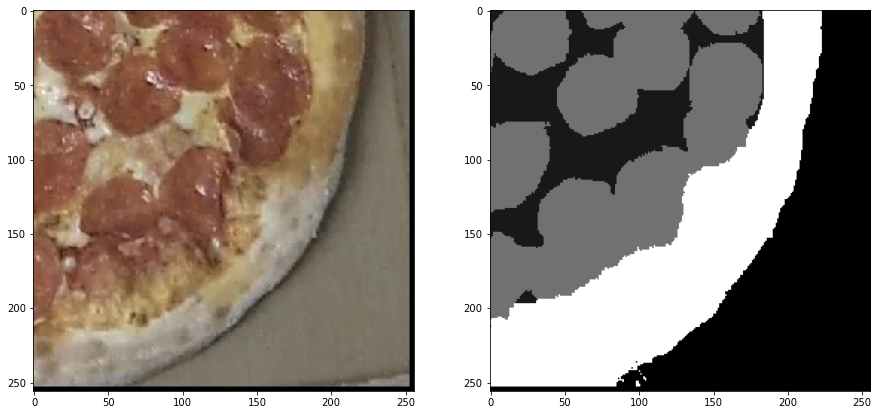

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(3*5, 9*5))

landscape = inverse_transform(X[0]).permute(1, 2, 0).cpu().detach().numpy()
label_class = __gen__(Y[0])
axes[0].imshow(landscape)
axes[1].imshow(label_class, cmap='gray')
   

In [ ]:
y_pred = model(X)

In [ ]:
r = torch.flatten(y_pred.argmax(dim = 1)).float()[0]
r.dtype

torch.float32

In [ ]:
criterion = nn.CrossEntropyLoss()
loss = jacard_coef_loss(y_pred, Y.permute(0, 3, 1, 2))
loss

tensor(-0.8704, requires_grad=True)

In [ ]:
class IOU(nn.Module):
        def __init__(self):
            super(IOU, self).__init__()
            self.softmax=nn.Softmax2d()
     
        def iou(self,score, label, smooth=1):
     
            intersection = torch.sum(score * label, dim=(0, 2, 3))
            union = torch.sum(score, dim=(0, 2, 3)) + torch.sum(label, dim=(0, 2, 3))
            return torch.mean((intersection + smooth) / (union-intersection + smooth), dim=0)
     
        def iou_loss(self,score, label):
            return 1 - self.iou(score, label)
     
        def forward(self, score,label):
            score=self.softmax(score)
            dice_loss=self.iou_loss(score,label)
            return dice_loss

In [ ]:
r = Y.permute(0, 3, 1, 2).argmax(dim = 1)
t =torch.unsqueeze(r, dim=1)
target = torch.zeros_like(y_pred).scatter_(1, t, torch.ones_like(t, dtype=torch.float32))
target[0][3][0][0]

tensor(1.)

In [ ]:
iou = IOU()

In [ ]:
res = iou(y_pred, Y.permute(0, 3, 1, 2))
res

tensor(0.8092, grad_fn=<MeanBackward1>)

In [ ]:
r =torch.flatten(Y)
r.shape

torch.Size([5505024])

In [ ]:
model_path = "/weights_Unet_THE_END_100epohs.pth"
model = UNet(num_classes=4).to(device)
model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
print(type(model_path))

RuntimeError: Error(s) in loading state_dict for UNet:
	Missing key(s) in state_dict: "contracting_51.0.weight", "contracting_51.0.bias", "contracting_51.2.weight", "contracting_51.2.bias", "contracting_51.2.running_mean", "contracting_51.2.running_var", "contracting_51.3.weight", "contracting_51.3.bias", "contracting_51.5.weight", "contracting_51.5.bias", "contracting_51.5.running_mean", "contracting_51.5.running_var", "expansive_01.weight", "expansive_01.bias", "expansive_02.0.weight", "expansive_02.0.bias", "expansive_02.2.weight", "expansive_02.2.bias", "expansive_02.2.running_mean", "expansive_02.2.running_var", "expansive_02.3.weight", "expansive_02.3.bias", "expansive_02.5.weight", "expansive_02.5.bias", "expansive_02.5.running_mean", "expansive_02.5.running_var". 
	size mismatch for middle.0.weight: copying a param with shape torch.Size([512, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([1024, 512, 3, 3]).
	size mismatch for middle.0.bias: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.2.weight: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.2.bias: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.2.running_mean: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.2.running_var: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.3.weight: copying a param with shape torch.Size([512, 512, 3, 3]) from checkpoint, the shape in current model is torch.Size([1024, 1024, 3, 3]).
	size mismatch for middle.3.bias: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.5.weight: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.5.bias: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.5.running_mean: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for middle.5.running_var: copying a param with shape torch.Size([512]) from checkpoint, the shape in current model is torch.Size([1024]).

In [ ]:
state = torch.load('/attention_res_jacard_softmax_40.pth', map_location=torch.device('cpu'))
model = UNet(num_classes=4).to(device)
#optimizer = optim.Adam(model.parameters(), lr=0.001)
model.load_state_dict(state['model'])        # получаем параметры модели
#optimizer.load_state_dict(state['optimizer'])    # получаем состояние оптимизатора
 
print(state['info'], state['date'])


res блоки attention лосс джакард продолжение с attention_res_jacard_50 использование softmax в att0.001 2022-11-07 11:43:49.603759


In [ ]:
from torch.optim.lr_scheduler import ReduceLROnPlateau
LR = 0.01
#model = UNet(num_classes=4).to(device)
optimizer = optim.Adam(model.parameters(), lr=LR)
criterion = IOU() #nn.CrossEntropyLoss()
epochs = 200
scheduler = ReduceLROnPlateau(optimizer, 'min', patience = 5)

In [ ]:
dataset_test = Dataset_new(df_val)
data_loader_test = DataLoader(dataset_test, batch_size=16)

In [ ]:
from torch.autograd import Variable
def jacard_coef_loss(y_pred, y_true):
    y_true_f = Variable(torch.flatten(y_true.argmax(dim = 1)).float(), requires_grad=True)
    y_pred_f = Variable(torch.flatten(y_pred.argmax(dim = 1)).float(), requires_grad=True)
    jaccard = JaccardIndex(num_classes=4)
    loss = Variable(-jaccard(y_pred_f.int(), y_true_f.int()), requires_grad=True)
    return loss


In [ ]:
from torch.autograd import Variable
def jacard_coef_loss(y_pred, y_true):
    y_true_f = Variable(torch.flatten(y_true.argmax(dim = 1)).float(), requires_grad=True)
    y_pred_f = Variable(torch.flatten(y_pred.argmax(dim = 1)).float(), requires_grad=True)
    intersection = torch.sum(torch.mul(y_true_f, y_pred_f))
    loss = -(intersection + 1.0) / (torch.sum(y_true_f) + torch.sum(y_pred_f) - intersection + 1.0)
    return loss

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(0.3019, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2807, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3283, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3683, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2529, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3643, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2901, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2452, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.2988452688022842	     Validation Loss:0.3044759744423949	 \ LR:0.01


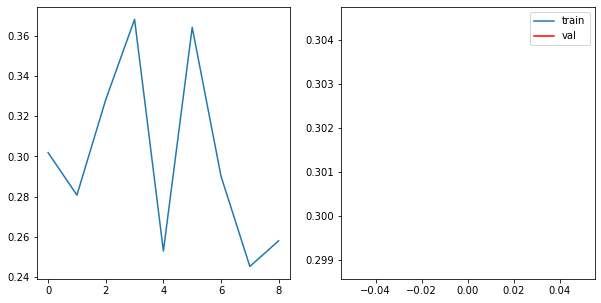

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2578, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2193, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2600, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2715, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2548, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2464, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2171, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.241267257095253	     Validation Loss:0.27078621077768333	 \ LR:0.01


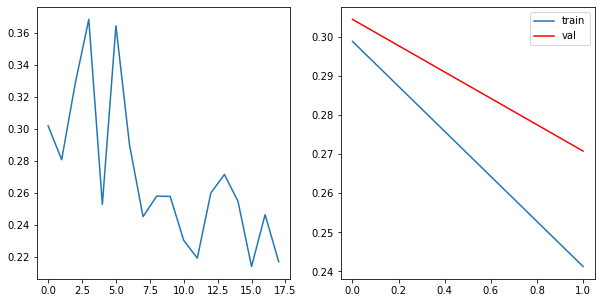

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2197, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2373, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2514, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2506, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2137, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2208, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1794, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1818, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.21777468108865344	     Validation Loss:0.27969138578056807	 \ LR:0.01


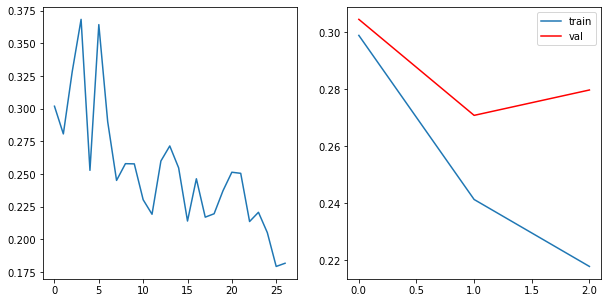

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2049, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2173, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2266, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2165, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2105, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2133, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2222, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1804, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1769, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.20764294736365813	     Validation Loss:0.24946739697671386	 \ LR:0.01


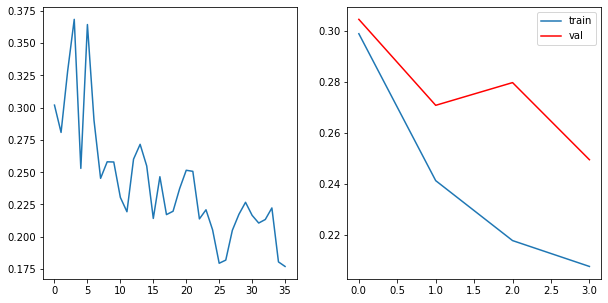

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1904, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2189, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2412, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2244, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1818, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2015, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2127, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2095, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2073, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.20974361831894683	     Validation Loss:0.2470083555138349	 \ LR:0.01


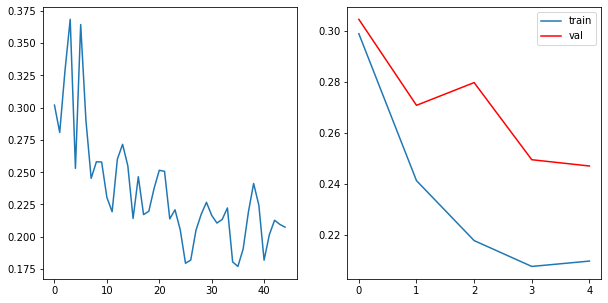

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2081, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2252, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2356, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1760, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1793, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2033, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2092, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2012, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.2048017319570014	     Validation Loss:0.23265024877171514	 \ LR:0.01


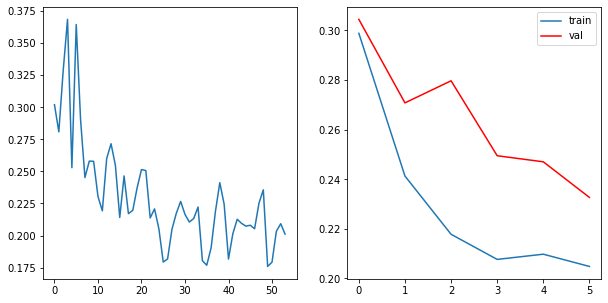

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1833, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2076, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2201, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1838, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2096, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1816, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2068, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.20017718161008907	     Validation Loss:0.23108927433795842	 \ LR:0.01


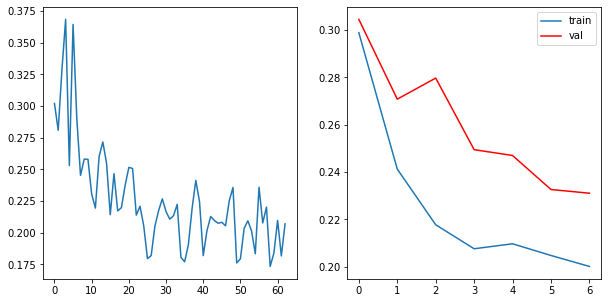

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1867, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2003, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2138, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1865, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1885, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1883, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1995, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1722, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1671, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.18921682848715615	     Validation Loss:0.22592394182560302	 \ LR:0.01


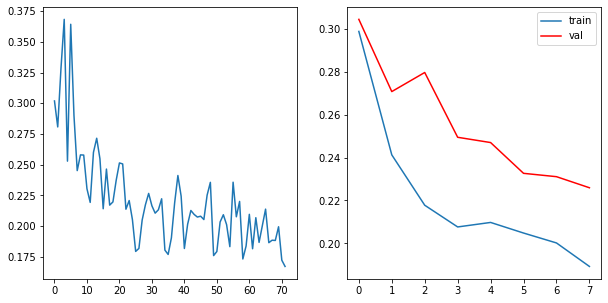

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1808, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2003, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2070, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1907, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1903, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1652, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1862, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1657, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.18613591320180023	     Validation Loss:0.23950791714761976	 \ LR:0.01


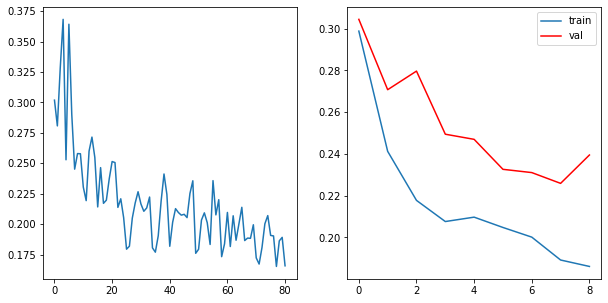

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1763, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1863, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1823, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1995, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2026, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1684, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1868, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1600, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.18573704697186852	     Validation Loss:0.20840380641944936	 \ LR:0.01


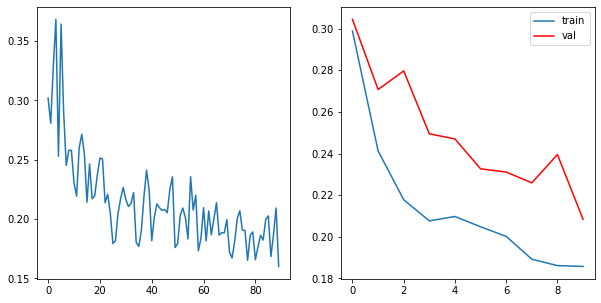

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1598, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1884, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1757, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1868, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1786, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1466, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1736, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1738, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1561, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.17104823866012475	     Validation Loss:0.19923014748285786	 \ LR:0.01


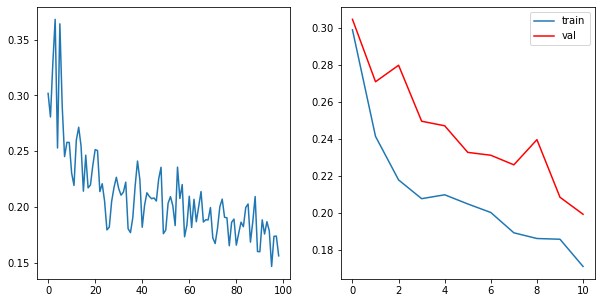

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1848, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2137, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2185, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1847, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2154, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1870, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.18736203563649223	     Validation Loss:0.21259952950365765	 \ LR:0.01


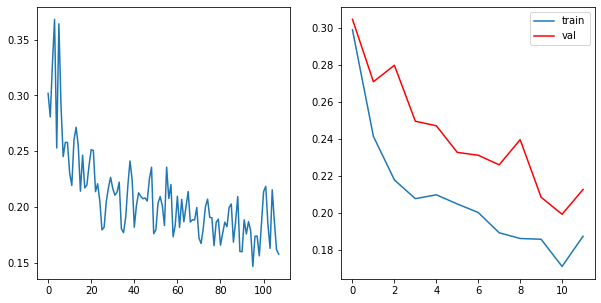

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1836, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1752, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1875, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1809, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1968, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1782, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1450, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.17503695355784646	     Validation Loss:0.19838617359021096	 \ LR:0.01


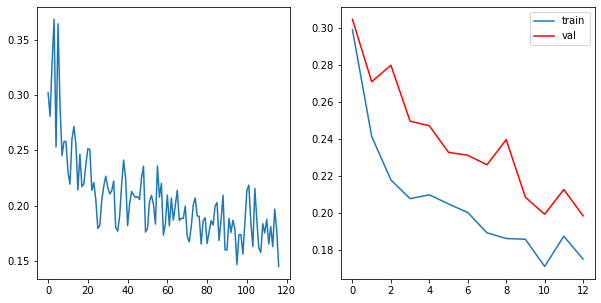

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1714, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1620, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1696, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1670, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1585, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1667, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1592, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.16267526297138638	     Validation Loss:0.22591422969578426	 \ LR:0.01


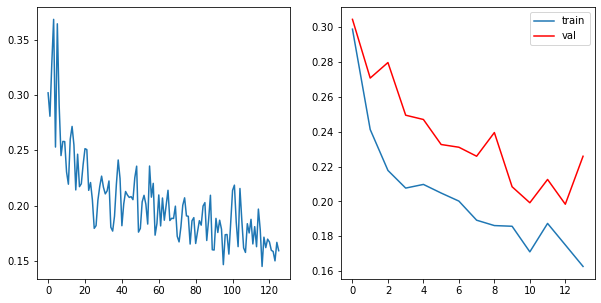

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1493, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1524, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1592, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2070, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1665, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1806, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1641, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.16627268836823952	     Validation Loss:0.22867774752252468	 \ LR:0.01


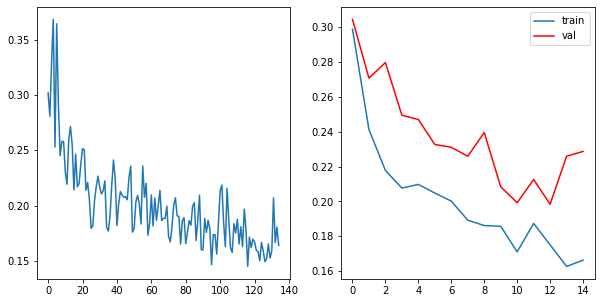

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2086, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1698, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1912, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1762, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1808, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1681, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1566, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.18434272073513208	     Validation Loss:0.2111117467724393	 \ LR:0.01


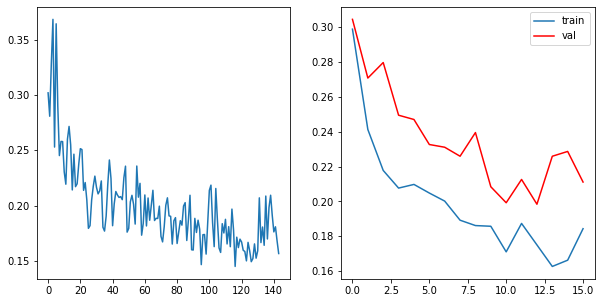

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1739, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1798, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1849, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1818, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1666, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1582, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1924, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1738, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1481, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.17326959985853646	     Validation Loss:0.20349240204651853	 \ LR:0.01


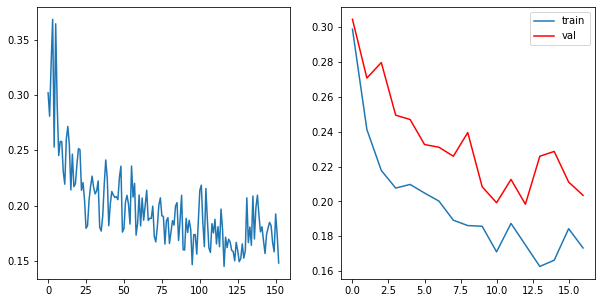

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1624, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1765, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1779, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1529, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1724, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1770, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1749, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.16749365440096553	     Validation Loss:0.17333721658693238	 \ LR:0.01


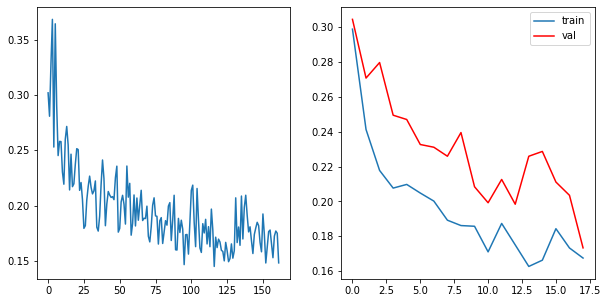

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1538, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1516, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1820, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1563, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.159284502304142	     Validation Loss:0.1822038452321244	 \ LR:0.01


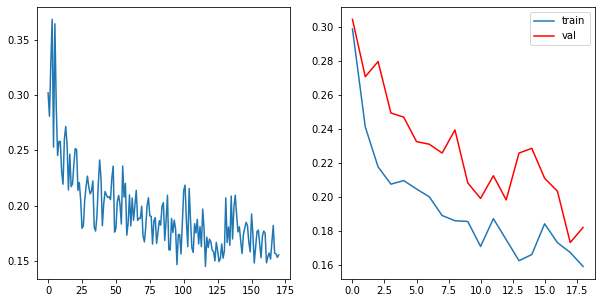

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1706, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1808, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1638, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1793, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1433, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.16365748327790378	     Validation Loss:0.17450885208270417	 \ LR:0.01


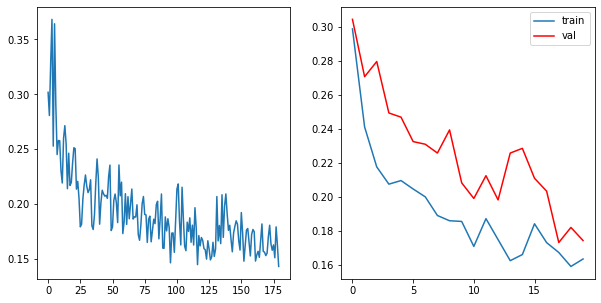

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1701, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1669, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1481, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1686, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1691, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1658, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1646, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.16255724511942976	     Validation Loss:0.1699848004400704	 \ LR:0.01


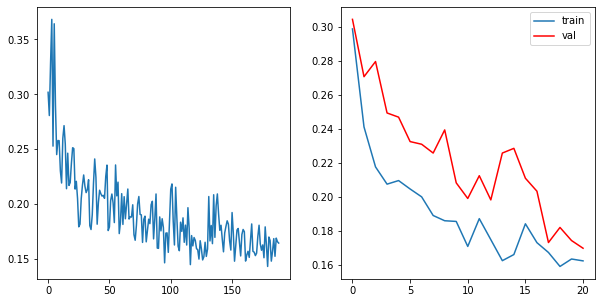

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1586, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1584, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1723, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1677, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1667, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1712, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1372, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.15848611278842017	     Validation Loss:0.1850828869353448	 \ LR:0.01


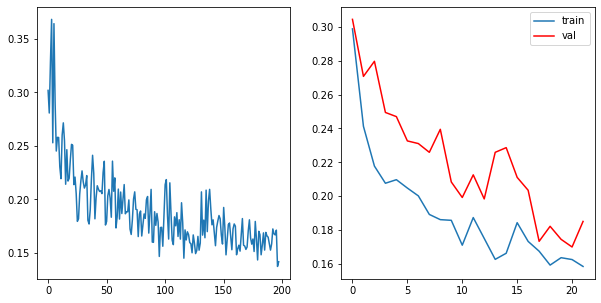

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1424, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1783, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1829, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1594, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1609, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1639, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.15887951891004473	     Validation Loss:0.1836888365467292	 \ LR:0.01


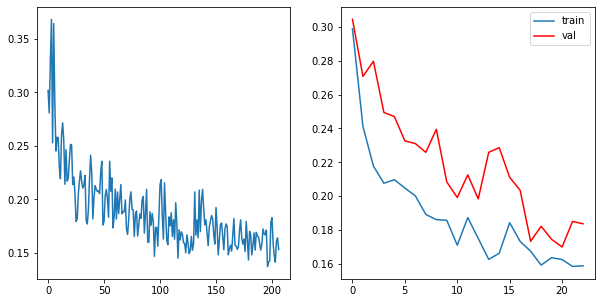

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1471, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1591, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1492, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1502, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.15054420061044765	     Validation Loss:0.20861615229624753	 \ LR:0.01


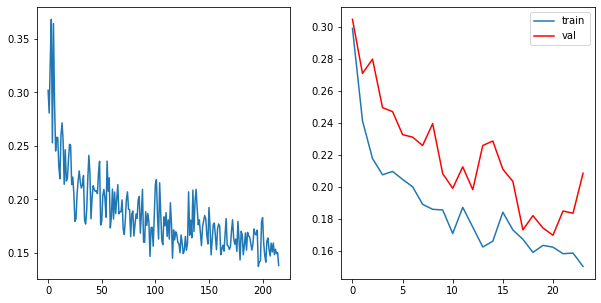

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1438, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1613, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1484, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1710, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1563, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1722, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1502, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1392, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1375, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.15332943259307705	     Validation Loss:0.16556351643191888	 \ LR:0.01


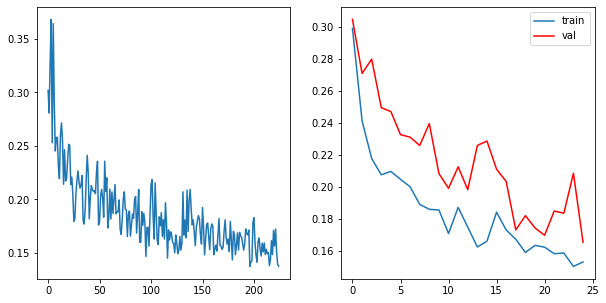

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1388, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1464, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1602, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1383, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.14527345632065872	     Validation Loss:0.1833440431743567	 \ LR:0.01


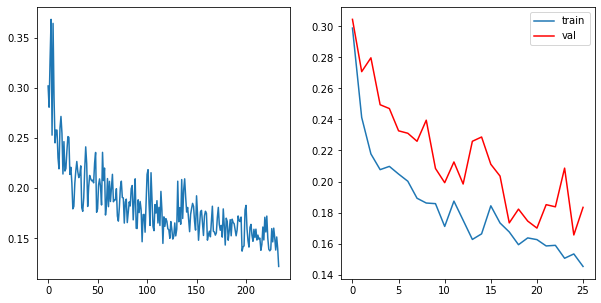

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1350, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1429, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1786, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1415, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1450, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1637, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1456, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.1498925504117363	     Validation Loss:0.1585437670404858	 \ LR:0.01


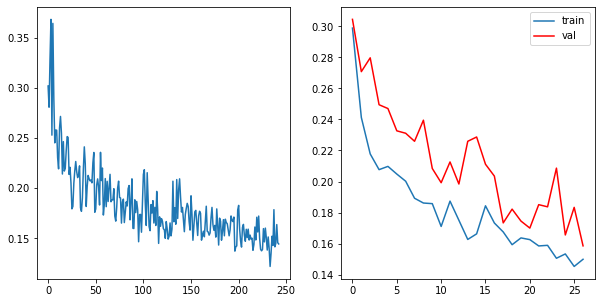

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1480, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1616, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1520, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1447, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1504, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.15049726998716711	     Validation Loss:0.18402892328995943	 \ LR:0.01


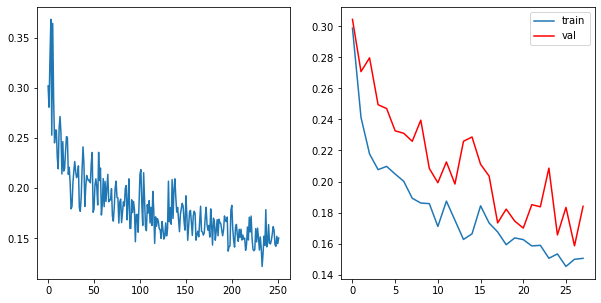

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1374, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1329, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1382, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1402, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.14382327819413582	     Validation Loss:0.154870918044138	 \ LR:0.01


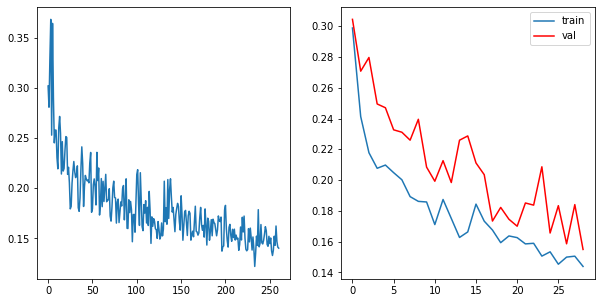

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1325, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1382, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1485, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1502, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.14371988757573625	     Validation Loss:0.1695177206576948	 \ LR:0.01


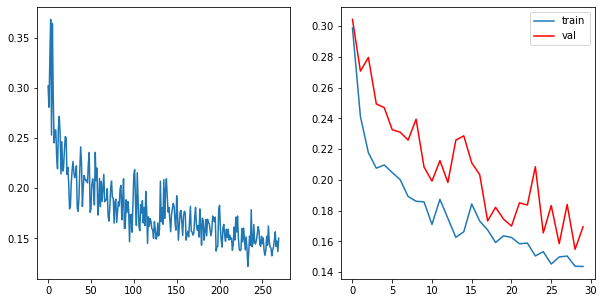

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1432, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1369, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1599, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1377, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1346, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.14508378037637365	     Validation Loss:0.1596669517986985	 \ LR:0.01


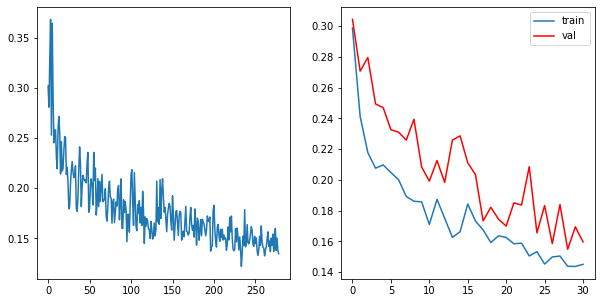

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1280, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1457, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1411, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1643, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1435, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1352, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1477, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1700, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.14595061731891615	     Validation Loss:0.176072557781088	 \ LR:0.01


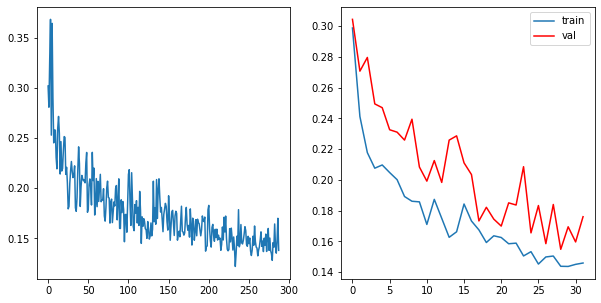

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1453, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1605, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1529, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1561, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1433, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.14848970775488388	     Validation Loss:0.17417115646790907	 \ LR:0.01


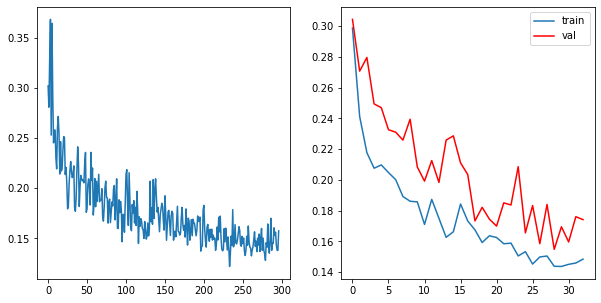

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1556, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1450, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1373, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1467, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1433, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1573, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1242, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.14670919008297223	     Validation Loss:0.1748556013303326	 \ LR:0.01


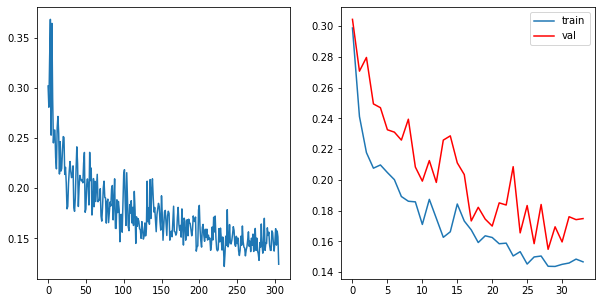

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1293, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1434, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1345, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1481, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1463, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1303, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1308, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.1401229623722654	     Validation Loss:0.1913805065312966	 \ LR:0.001


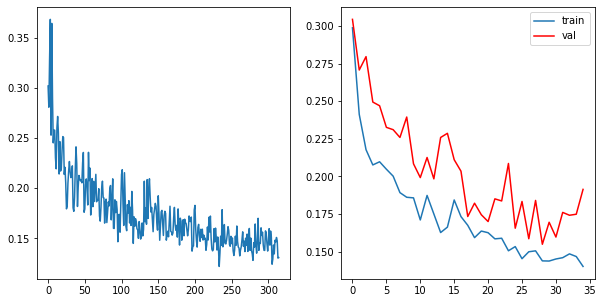

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1372, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1442, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1327, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1322, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.14026467155435401	     Validation Loss:0.15348127099285744	 \ LR:0.001


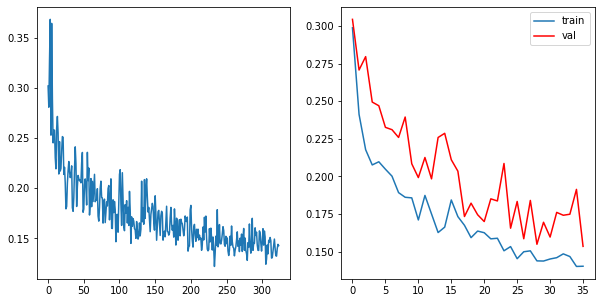

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1202, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1336, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1222, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1302, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1388, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1237, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1377, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1297, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1315, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.12972808185327525	     Validation Loss:0.1517731839460289	 \ LR:0.001


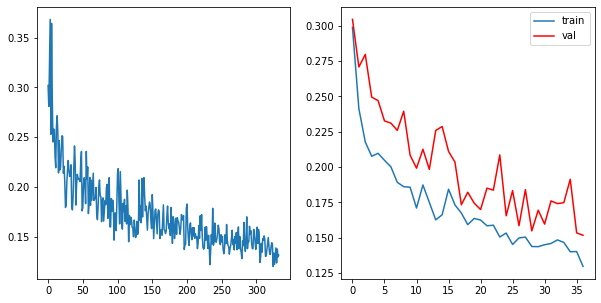

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1222, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1402, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1341, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1283, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1294, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1367, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1348, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1308, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.13423256316004326	     Validation Loss:0.14301793661270043	 \ LR:0.001


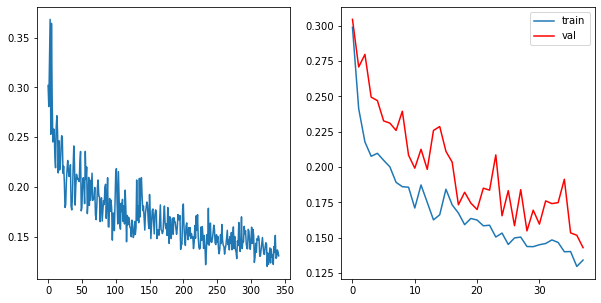

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1280, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1391, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1249, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1241, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1299, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1269, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1307, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.12850763486837333	     Validation Loss:0.1502644095309552	 \ LR:0.001


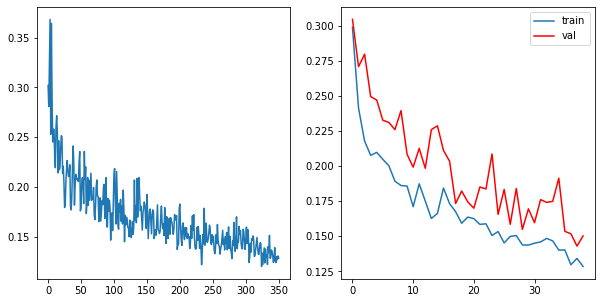

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1306, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1306, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1291, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1467, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1289, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1269, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.1333011946066304	     Validation Loss:0.13040299650140316	 \ LR:0.001


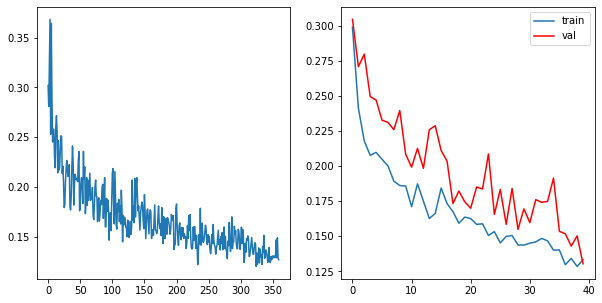

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1172, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1331, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1261, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1358, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1210, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1313, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1215, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1246, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.12659409672063945	     Validation Loss:0.14197238660546818	 \ LR:0.001


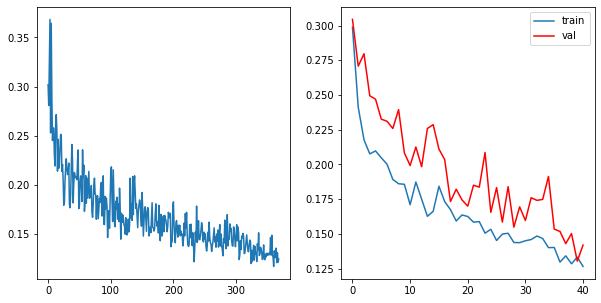

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1323, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1315, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1412, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1370, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1213, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1309, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1231, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1246, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.12911794677142063	     Validation Loss:0.14377410887227934	 \ LR:0.001


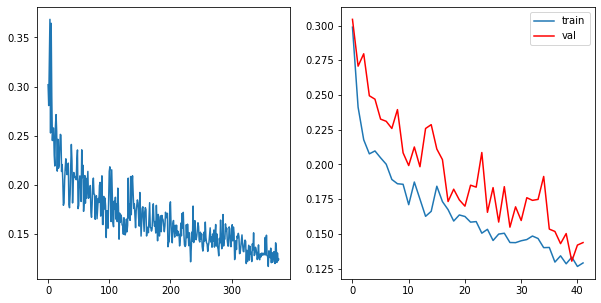

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1278, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1370, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1318, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1297, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1262, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1268, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1256, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1255, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.12829686599621126	     Validation Loss:0.14324020270271773	 \ LR:0.001


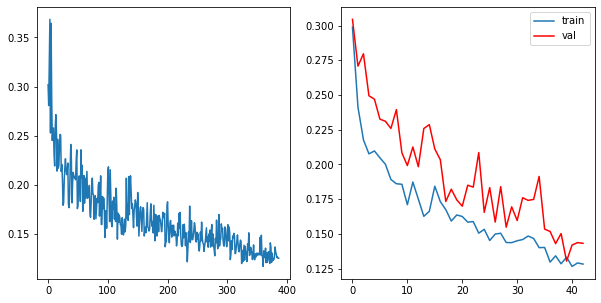

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1163, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1377, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1168, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1281, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1254, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1279, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1306, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1255, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.1263387505664414	     Validation Loss:0.14311720484949578	 \ LR:0.001


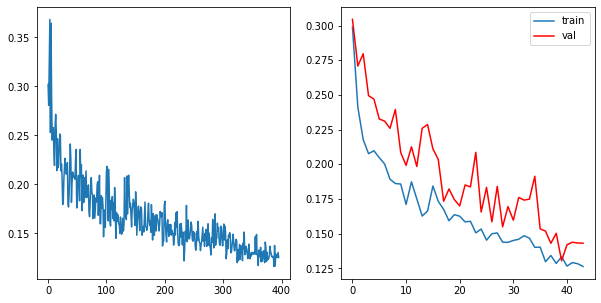

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1187, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1314, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1243, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1342, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1260, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1303, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1275, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1289, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.12717250072625008	     Validation Loss:0.14302228459613128	 \ LR:0.001


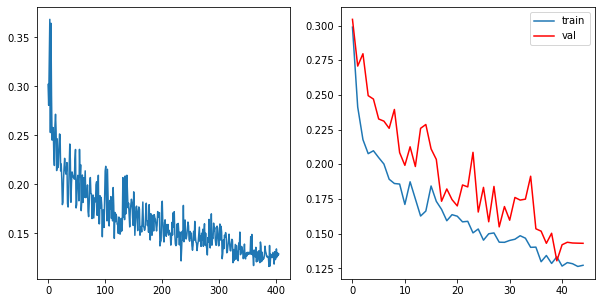

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1211, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1389, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1181, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1181, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1221, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.12400105218472961	     Validation Loss:0.15387452609531813	 \ LR:0.0001


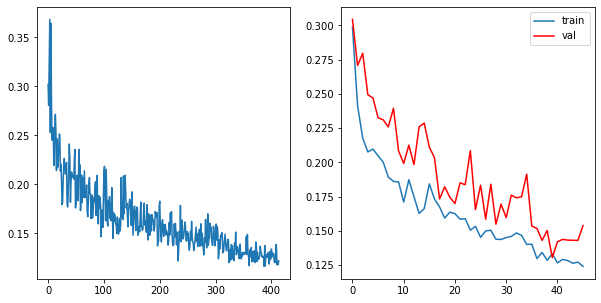

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1320, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1299, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1280, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1317, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1272, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1345, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1280, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.12748346906413655	     Validation Loss:0.14603687973948057	 \ LR:0.0001


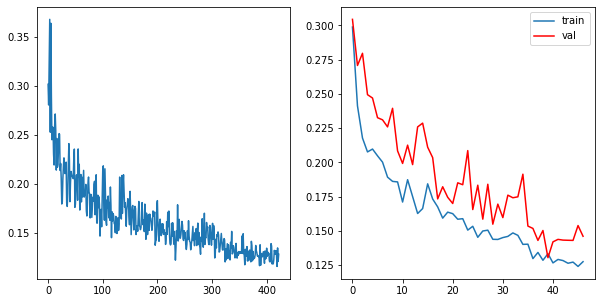

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1135, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1395, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1245, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1223, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1311, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1311, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1211, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.12777962493932443	     Validation Loss:0.14518063947906357	 \ LR:0.0001


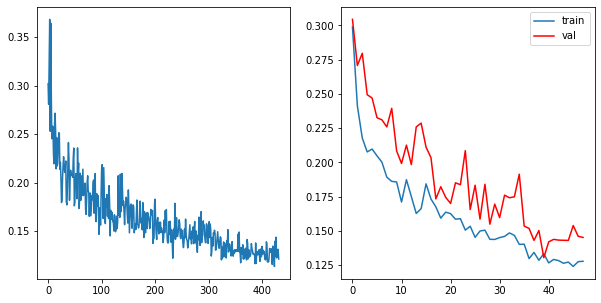

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1266, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1172, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1210, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1244, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1407, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1283, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.12824765712753658	     Validation Loss:0.13927467977460714	 \ LR:0.0001


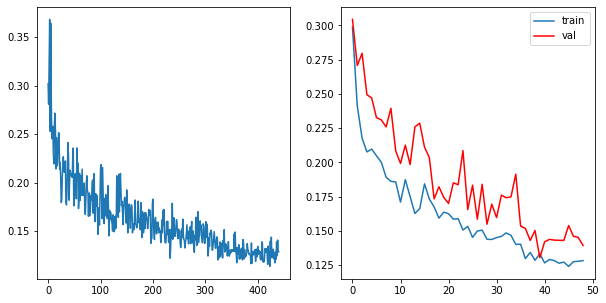

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1150, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1365, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1304, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1337, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1388, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1209, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1317, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1194, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1304, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.12853999302950117	     Validation Loss:0.13766731544946956	 \ LR:0.0001


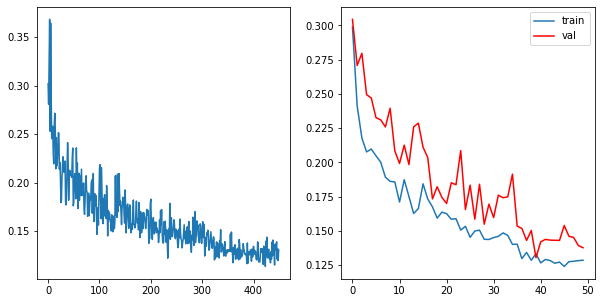

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1399, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1282, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1199, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1293, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1350, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1212, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1356, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1299, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1213, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.12892078232506188	     Validation Loss:0.14746658746920271	 \ LR:0.0001


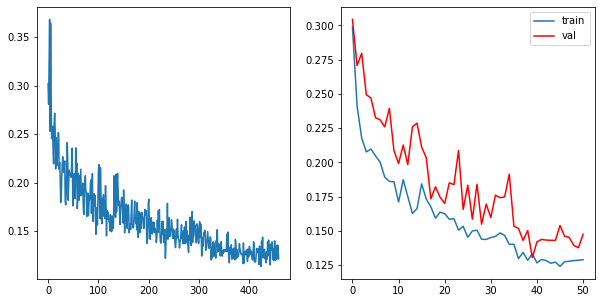

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1200, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1280, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1276, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1252, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1137, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1235, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1239, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1252, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.12483697674157407	     Validation Loss:0.14447202981400367	 \ LR:1e-05


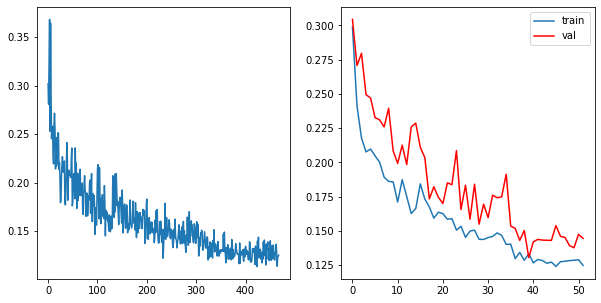

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1227, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1311, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1212, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1275, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1319, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1338, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1315, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1254, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.12760058364997612	     Validation Loss:0.14343169351671117	 \ LR:1e-05


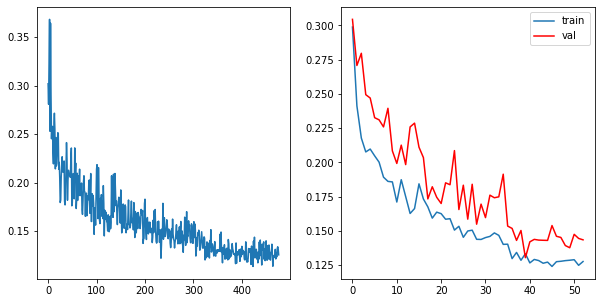

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1127, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1194, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1275, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1320, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1188, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1183, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1276, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1292, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1255, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.12343840895624192	     Validation Loss:0.14391506145635138	 \ LR:1e-05


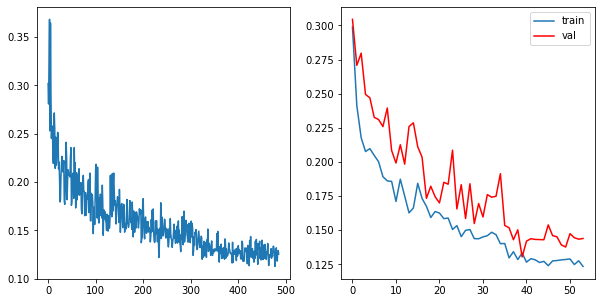

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1235, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1199, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1259, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1350, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1129, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1295, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1354, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1245, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.1254966864202381	     Validation Loss:0.1389600672962417	 \ LR:1e-05


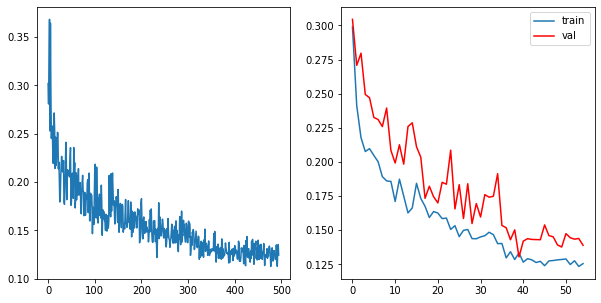

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1166, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1248, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1212, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1329, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1266, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1313, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1293, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1294, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.1260225644680977	     Validation Loss:0.14251715848874016	 \ LR:1e-05


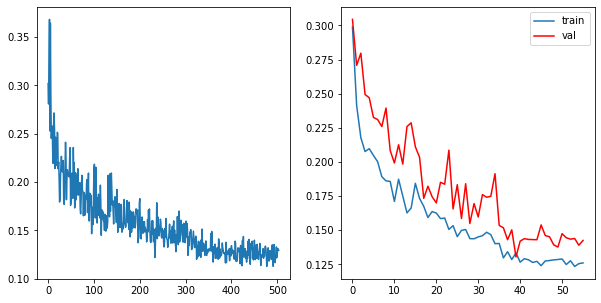

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1204, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<RsubBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "res блоки attention лосс джакард продолжение с attention_res_jacard_50 использование softmax в att"+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/attention_res_jacard_softmax_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(0.8566, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.7638, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.5962, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.5299, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.4862, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.4559, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.4386, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.4515, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.4010, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.5533015767509357	     Validation Loss:0.9115126545545591	 \ LR:0.01


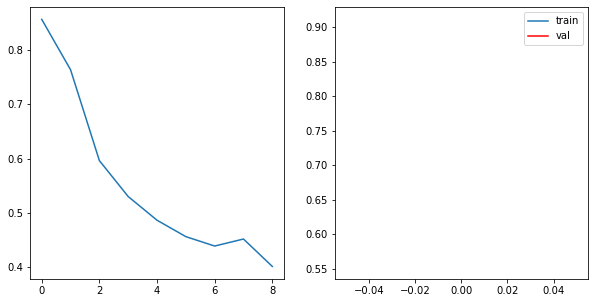

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4427, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3625, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3758, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3795, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3482, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3468, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3404, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3935, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3152, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.36719754382495595	     Validation Loss:0.6794362910782672	 \ LR:0.01


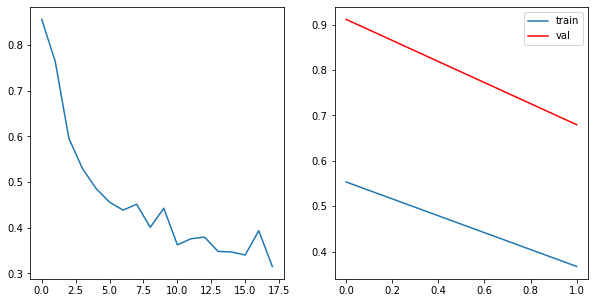

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3428, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3060, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2953, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2986, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3039, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3083, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2838, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3322, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2759, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.3051936216051454	     Validation Loss:0.4865731077921642	 \ LR:0.01


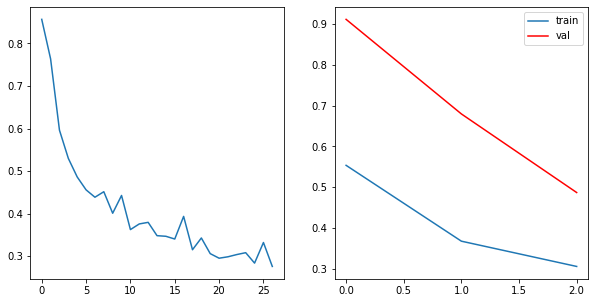

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2928, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2604, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2798, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2763, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2775, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2944, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2612, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3128, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2419, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.2774364581072818	     Validation Loss:0.47803365575348716	 \ LR:0.01


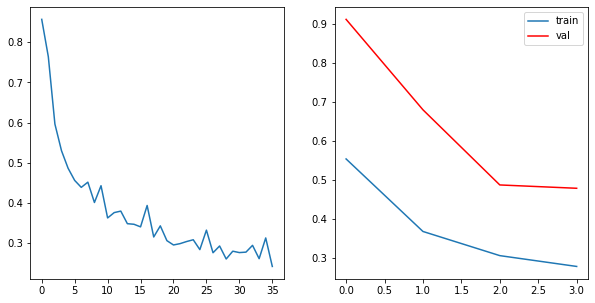

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2690, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2582, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2506, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2667, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2451, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2706, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2270, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.25592813096972217	     Validation Loss:0.4581471897875051	 \ LR:0.01


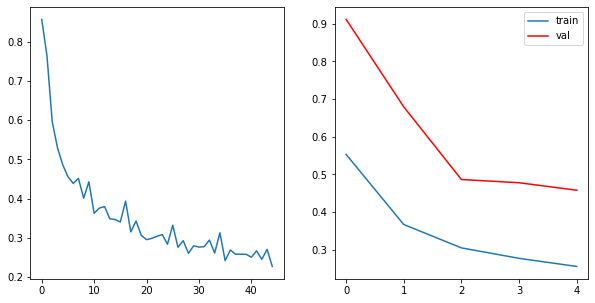

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2478, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2310, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2339, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2577, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2100, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.23613427324799227	     Validation Loss:0.403782977581886	 \ LR:0.01


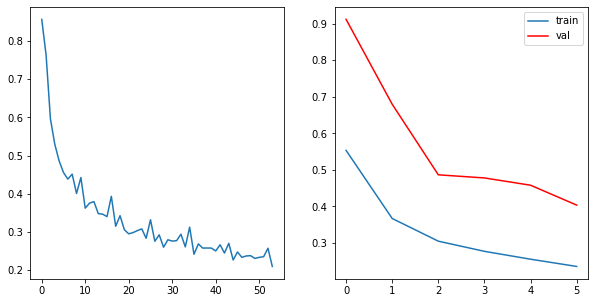

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2428, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2226, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2149, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2171, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2233, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2180, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2308, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2445, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1931, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.2230257426325687	     Validation Loss:0.38598663040690523	 \ LR:0.01


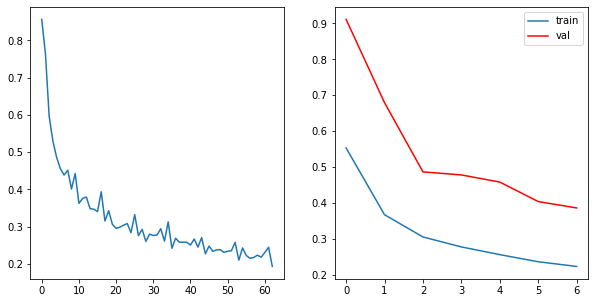

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2407, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2150, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1996, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1952, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2139, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2139, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2385, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1976, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.2137382194611669	     Validation Loss:0.349551646155059	 \ LR:0.01


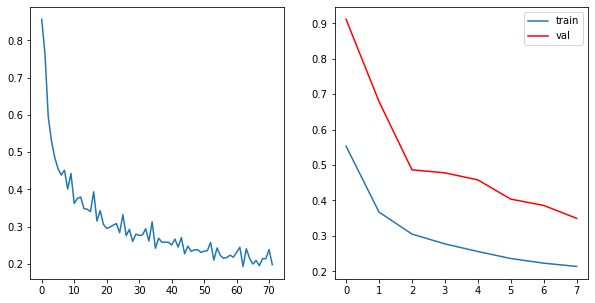

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2158, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2035, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1960, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2059, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1904, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1991, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2087, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2172, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1825, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.20212669180236242	     Validation Loss:0.345837525274905	 \ LR:0.01


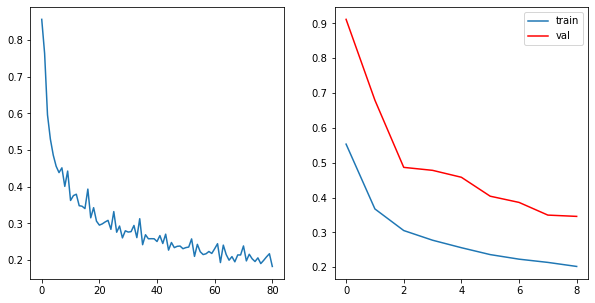

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2061, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1933, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1760, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1925, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1792, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1968, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1897, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2076, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1717, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.1903195004174073	     Validation Loss:0.2583048060702516	 \ LR:0.01


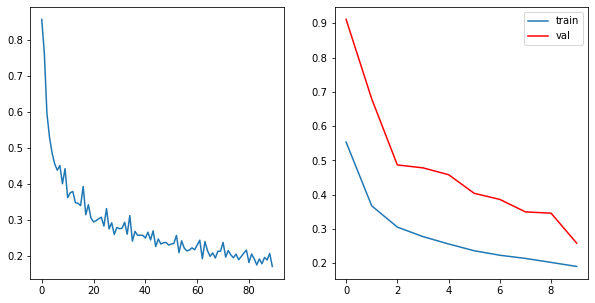

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2155, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1972, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1820, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1838, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1808, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1945, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1901, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2136, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1942, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.19462896508233493	     Validation Loss:0.2565262000986939	 \ LR:0.01


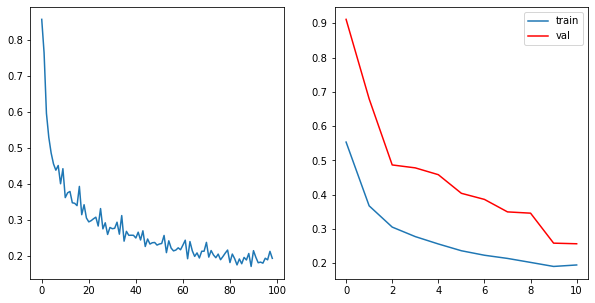

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2013, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1940, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1818, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1807, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1843, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1853, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1883, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2152, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1719, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.1891781149427314	     Validation Loss:0.22982915658155736	 \ LR:0.01


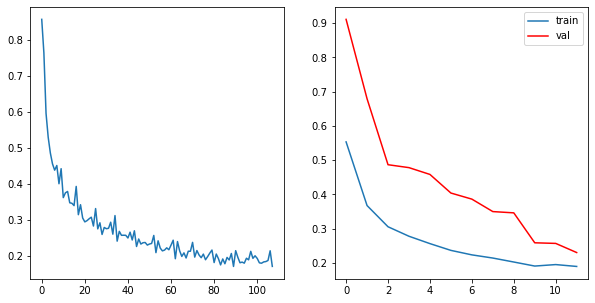

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1938, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1914, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1711, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1852, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1752, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1902, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1760, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1904, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1782, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.18347761121154776	     Validation Loss:0.23774132819802626	 \ LR:0.01


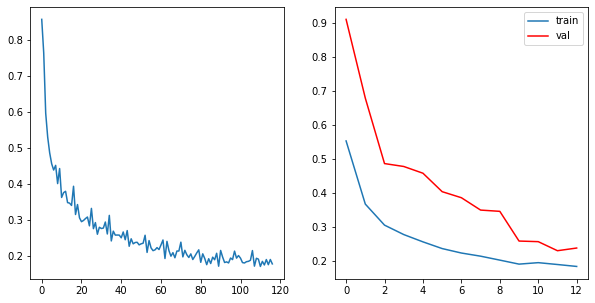

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1846, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1738, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1731, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1767, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1775, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1802, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1774, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1877, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1636, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.17716747925483622	     Validation Loss:0.21695049635469074	 \ LR:0.01


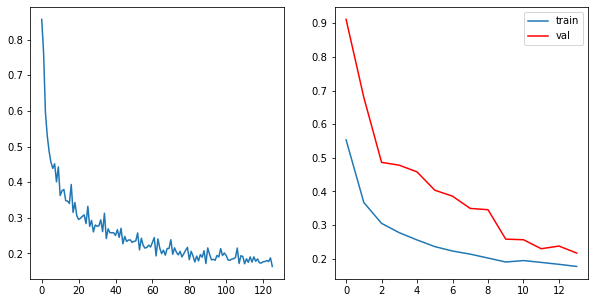

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1845, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1750, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1648, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1749, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1750, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1641, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1830, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1641, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.1720190738496048	     Validation Loss:0.2035265194182999	 \ LR:0.01


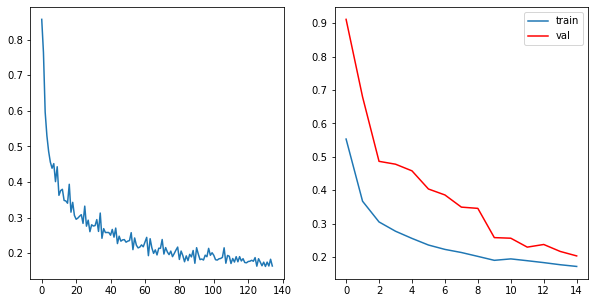

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1803, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1692, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1550, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1670, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1792, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1580, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1796, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1591, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.16766516070444146	     Validation Loss:0.20379696272284065	 \ LR:0.01


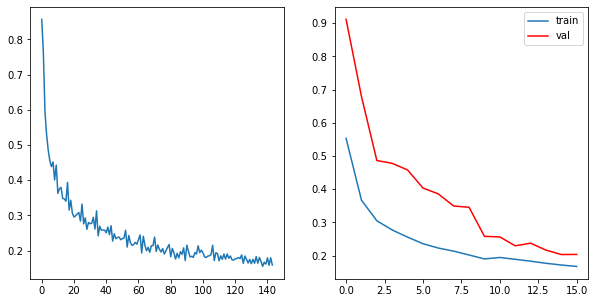

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1854, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1807, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1693, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1695, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1870, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1681, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1857, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1681, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.1739974699575401	     Validation Loss:0.25032450787940874	 \ LR:0.01


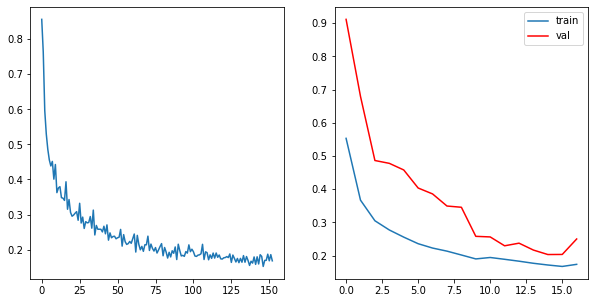

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1958, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1755, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1686, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1761, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1827, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1826, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1616, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.17316657207689917	     Validation Loss:0.24018867907385208	 \ LR:0.01


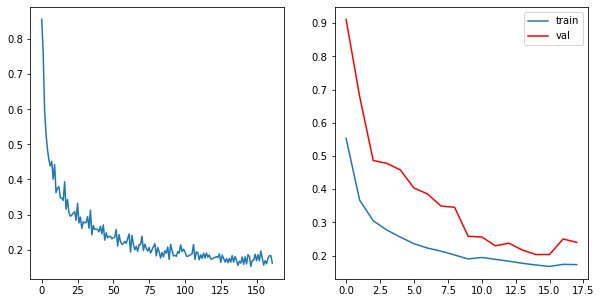

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1826, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1789, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1548, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1674, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1614, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1734, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1749, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1740, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1528, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.1689192311225329	     Validation Loss:0.19735766806703578	 \ LR:0.01


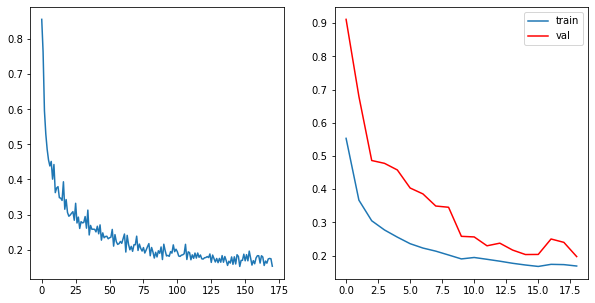

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1648, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1698, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1711, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1645, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1718, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1433, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.1620579395586667	     Validation Loss:0.24140165478306594	 \ LR:0.01


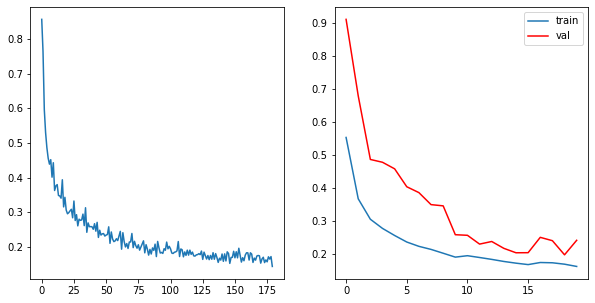

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1622, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1680, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1506, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1656, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1637, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1785, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1459, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.160642715228754	     Validation Loss:0.19165528001048326	 \ LR:0.01


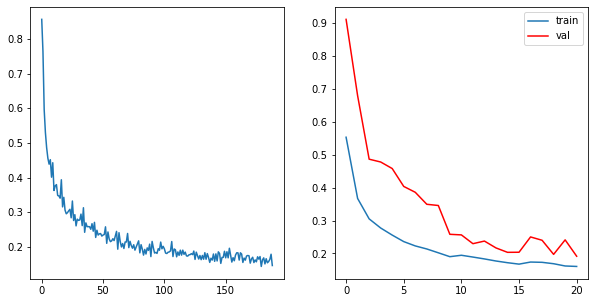

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1569, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1614, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1550, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1766, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1458, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.15745331209436808	     Validation Loss:0.1856379826954164	 \ LR:0.01


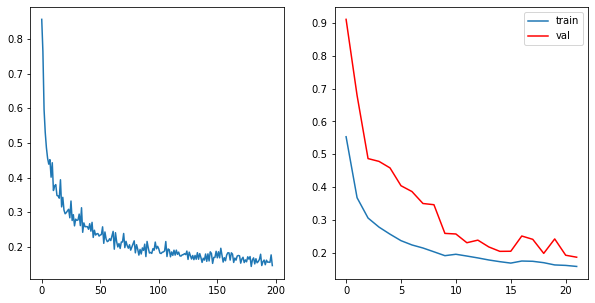

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1604, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1584, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1454, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1627, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1651, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.15618325776531602	     Validation Loss:0.19502966253145884	 \ LR:0.01


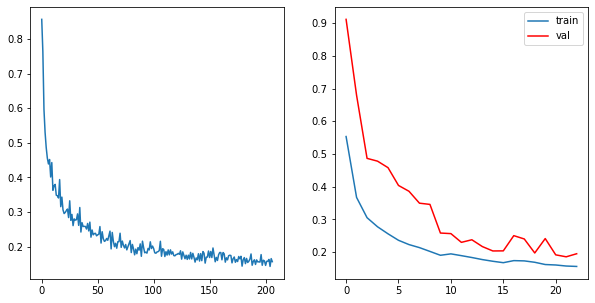

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1606, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1522, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1420, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1616, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1402, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.15197857771238224	     Validation Loss:0.19711265855962667	 \ LR:0.01


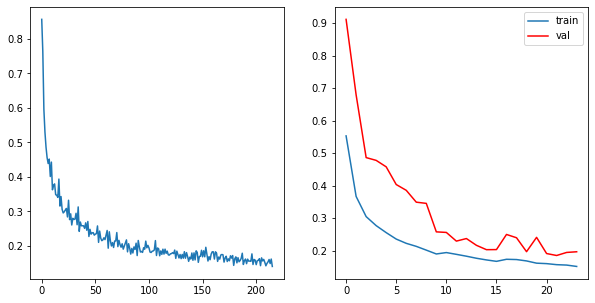

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1617, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1470, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1474, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1513, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1455, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1372, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.15025997619931786	     Validation Loss:0.18400951776845564	 \ LR:0.01


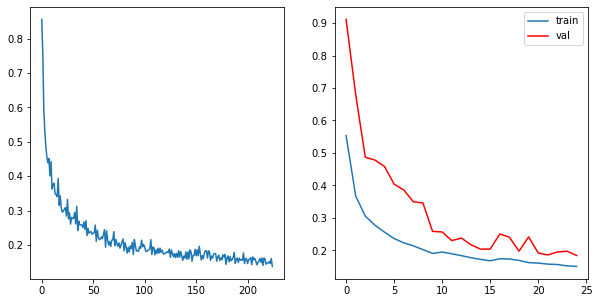

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1528, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1403, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1452, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.14862072222947156	     Validation Loss:0.19622433392396277	 \ LR:0.01


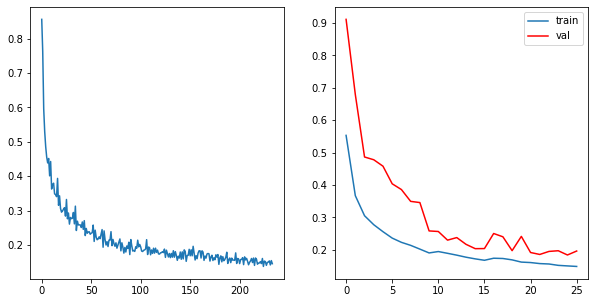

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1561, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1497, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1336, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1461, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1447, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1426, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.1461594056165716	     Validation Loss:0.198665345700942	 \ LR:0.01


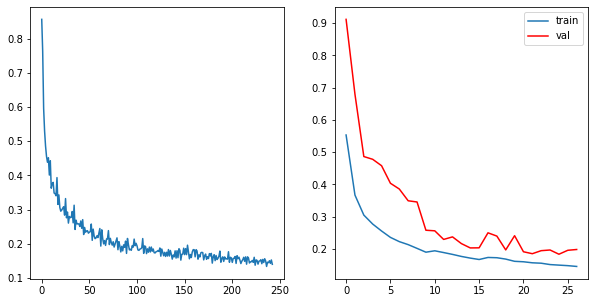

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1484, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1432, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1448, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1513, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1566, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1378, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.1483396516487385	     Validation Loss:0.20246428212615797	 \ LR:0.01


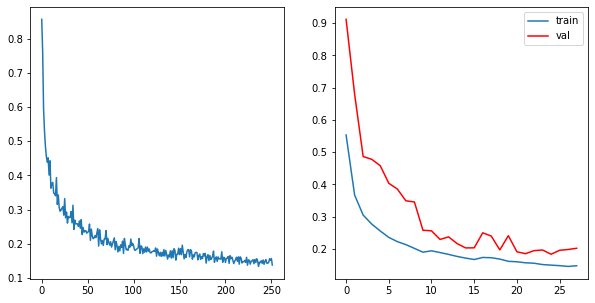

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1508, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1547, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1355, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1498, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1375, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.14724546465696273	     Validation Loss:0.22070376766324487	 \ LR:0.01


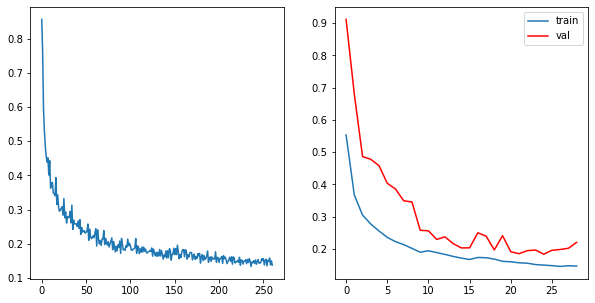

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1533, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1337, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1445, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1448, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1428, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1354, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.1467366349732468	     Validation Loss:0.21104479777704563	 \ LR:0.01


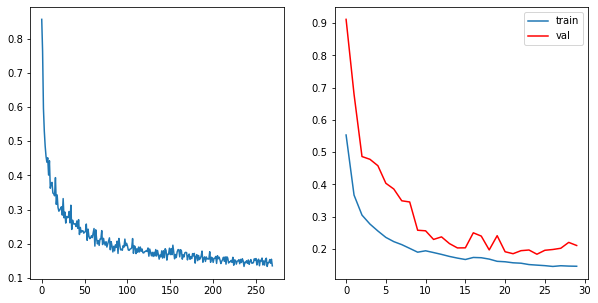

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1505, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1344, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1429, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1548, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.14591016947865254	     Validation Loss:0.21704328992427754	 \ LR:0.001


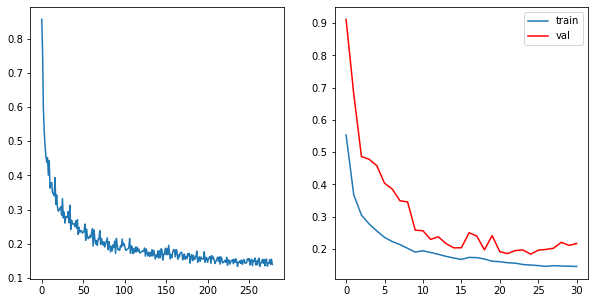

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1429, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1391, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1369, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1326, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1448, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1226, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.14003409386314633	     Validation Loss:0.15563534353399078	 \ LR:0.001


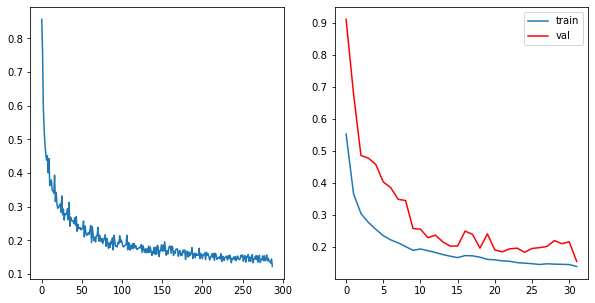

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1410, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1331, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1253, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1307, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1325, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1276, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1249, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.13180084013286042	     Validation Loss:0.15422811863299157	 \ LR:0.001


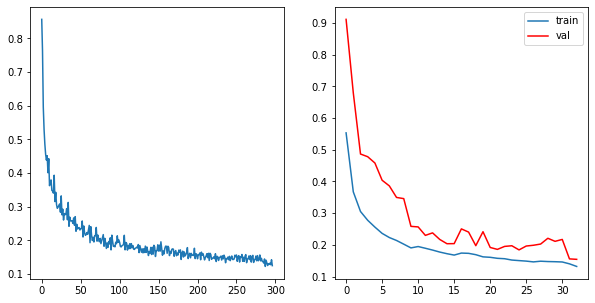

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1361, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1328, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1232, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1300, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1271, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1301, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1242, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1382, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.12906639445544682	     Validation Loss:0.15336704248884114	 \ LR:0.001


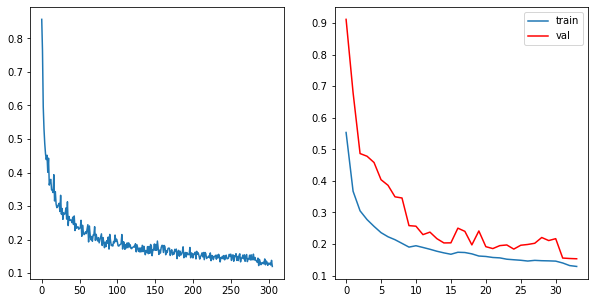

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1325, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1322, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1215, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1254, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1291, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1243, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1187, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.12766920002793467	     Validation Loss:0.14974136556282402	 \ LR:0.001


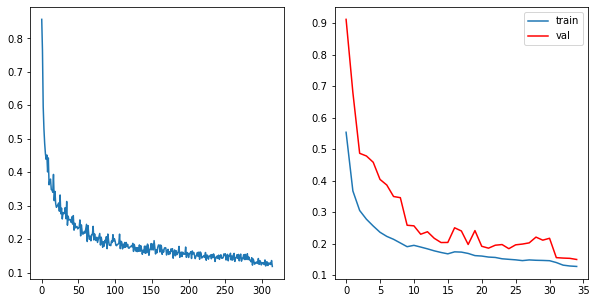

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1327, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1299, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1204, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1271, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1242, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1284, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1348, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1188, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.12654868607901407	     Validation Loss:0.1496586199257378	 \ LR:0.001


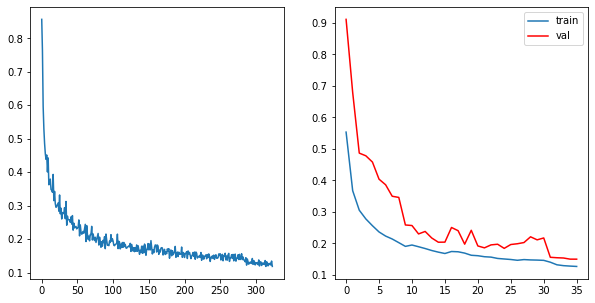

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1309, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1293, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1196, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1265, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1236, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1273, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1337, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1179, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.12566721816030013	     Validation Loss:0.1491563020430209	 \ LR:0.001


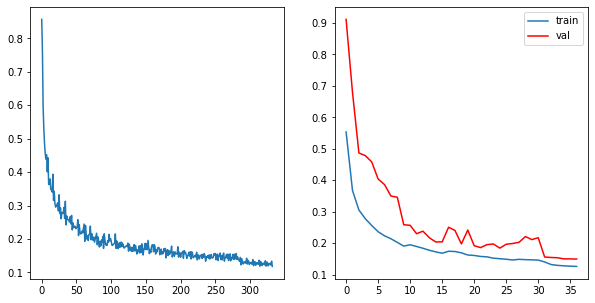

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1301, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1285, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1189, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1259, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1229, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1268, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1218, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1329, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1173, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.12501706812605676	     Validation Loss:0.14884958840340468	 \ LR:0.001


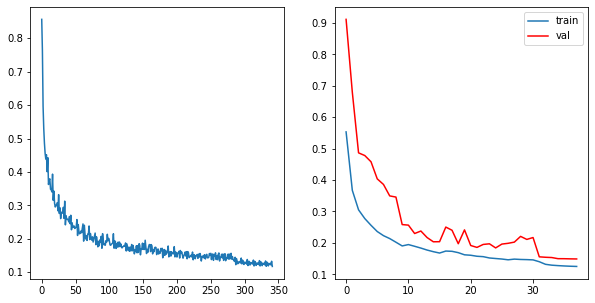

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1295, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1277, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1183, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1251, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1223, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1261, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1211, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1321, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1169, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.12434256590518987	     Validation Loss:0.14915206017873606	 \ LR:0.001


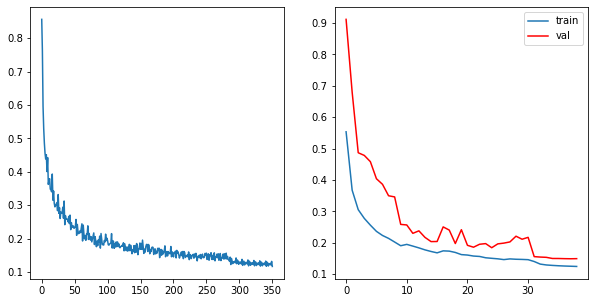

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1287, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1272, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1178, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1245, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1217, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1256, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1207, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1313, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1164, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.12376600272999244	     Validation Loss:0.1485688612415771	 \ LR:0.001


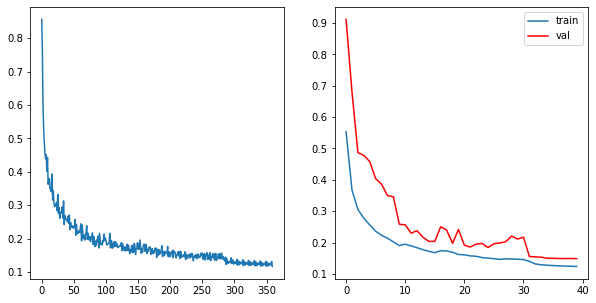

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1281, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1265, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1173, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1239, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1211, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1250, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1306, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1160, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.12319109171354548	     Validation Loss:0.14865778378726738	 \ LR:0.001


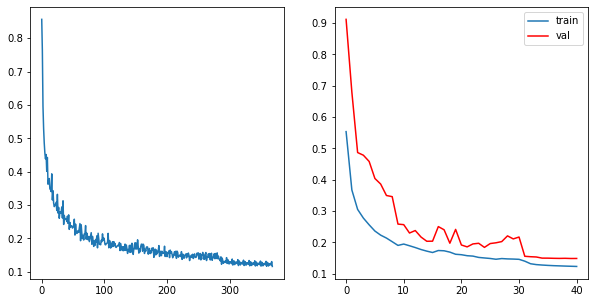

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1276, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1259, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1169, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1235, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1244, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1199, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1299, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.12265483750933646	     Validation Loss:0.1482514874809703	 \ LR:0.001


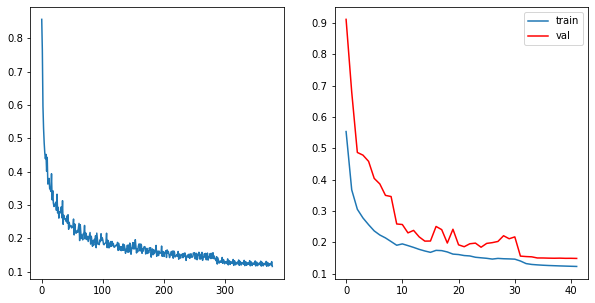

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1271, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1252, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1164, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1230, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1199, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1238, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1195, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1293, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1151, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.12213373726915523	     Validation Loss:0.14796518438097203	 \ LR:0.001


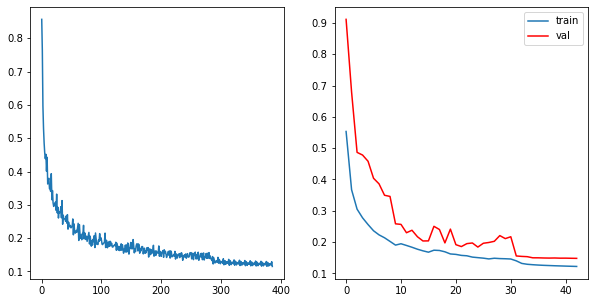

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1265, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1246, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1160, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1224, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1193, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1232, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1191, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1146, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.12161140455526478	     Validation Loss:0.14750131976857214	 \ LR:0.001


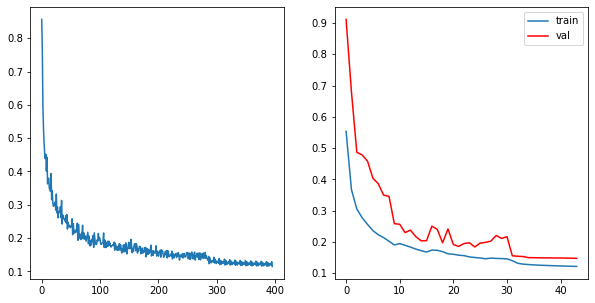

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1260, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1239, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1156, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1219, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1188, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1227, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1186, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1281, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1141, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.12107954645140831	     Validation Loss:0.1472675052151875	 \ LR:0.001


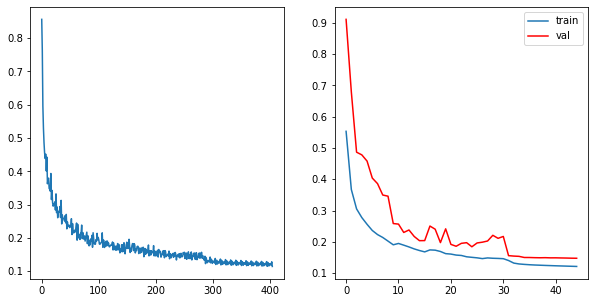

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1254, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1151, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1214, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1182, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1222, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1182, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1276, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1137, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.1205829003336915	     Validation Loss:0.1470905437962101	 \ LR:0.001


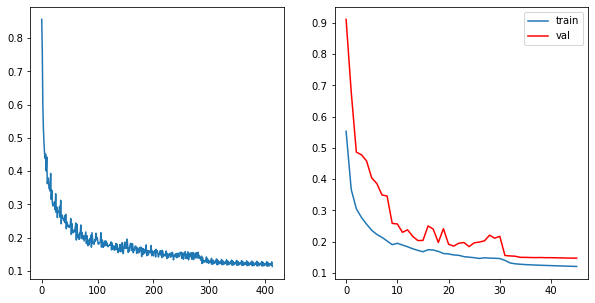

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1250, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1227, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1146, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1209, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1177, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1218, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1177, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1270, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1133, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.12007122063541226	     Validation Loss:0.14706103726682054	 \ LR:0.001


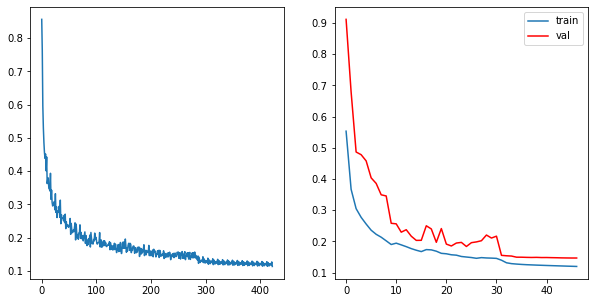

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1244, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1142, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1171, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1213, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1173, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1264, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1129, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.11956236451892163	     Validation Loss:0.1469006520132806	 \ LR:0.001


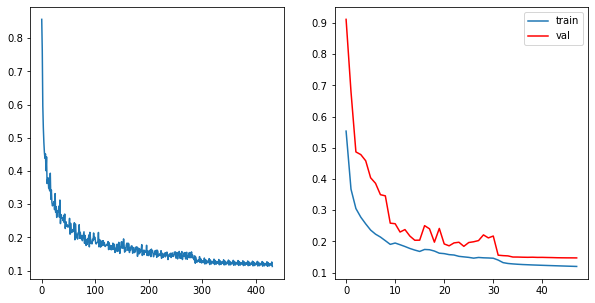

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1239, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1213, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1139, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1198, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1166, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1208, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1169, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1258, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1125, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.11905050446769347	     Validation Loss:0.14681455672664526	 \ LR:0.001


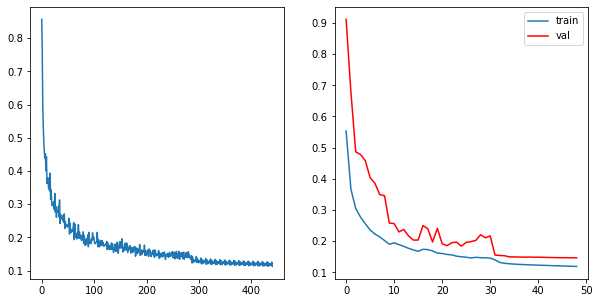

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1234, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1134, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1194, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1161, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1165, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1252, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1121, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.11855088207325082	     Validation Loss:0.14661577877983725	 \ LR:0.001


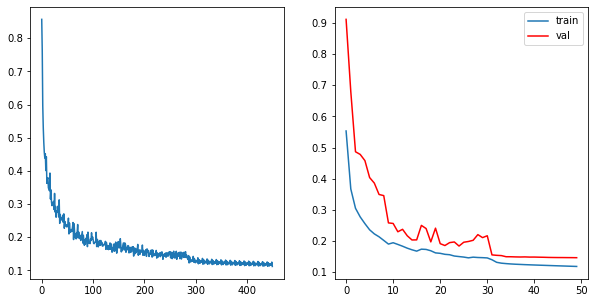

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1229, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1199, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1130, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1188, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1156, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1198, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1161, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1246, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1117, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.11803825430435683	     Validation Loss:0.1467783578319012	 \ LR:0.001


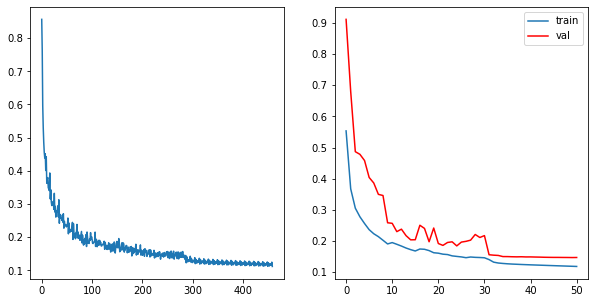

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1222, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1193, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1127, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1183, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1151, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1193, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1158, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1241, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1112, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.11755919941710043	     Validation Loss:0.14625374597580257	 \ LR:0.001


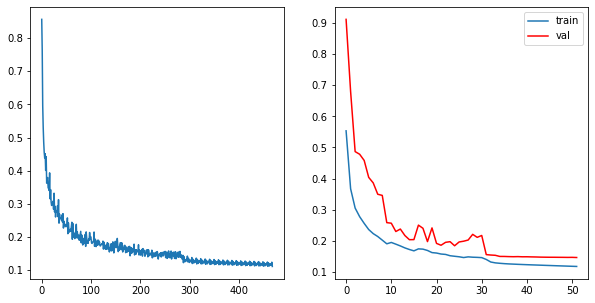

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1218, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1186, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1123, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1177, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1146, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1187, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1153, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1234, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1108, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "res блоки attention лосс джакард "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/attention_res_jacard_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(0.8592, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.8053, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.7484, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.6967, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.6354, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.5981, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.5491, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.5128, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.5014, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.6562526962227627	     Validation Loss:0.7984613275655587	 \ LR:0.001


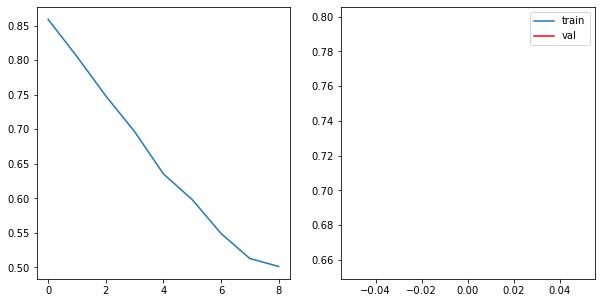

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4345, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.4202, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3809, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3314, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3038, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2924, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2706, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2720, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2599, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.3295308099764378	     Validation Loss:0.8309722971262219	 \ LR:0.001


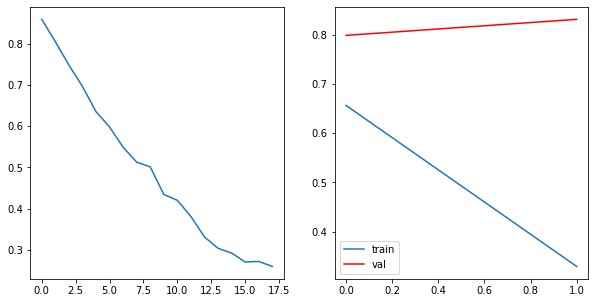

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2400, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.3026, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2570, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2945, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2627, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2421, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2124, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2429, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2608, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.2572095848800988	     Validation Loss:0.6812915421208364	 \ LR:0.001


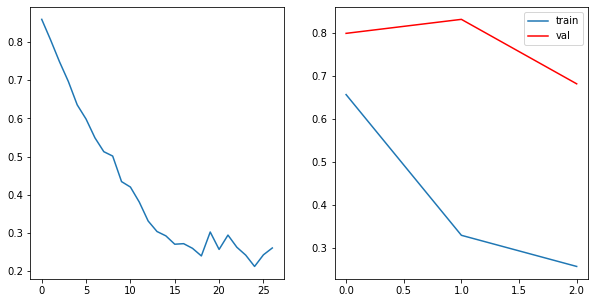

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2376, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2477, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2207, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2282, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1994, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1903, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2154, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2174, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.22155181631380075	     Validation Loss:0.34758115635198017	 \ LR:0.001


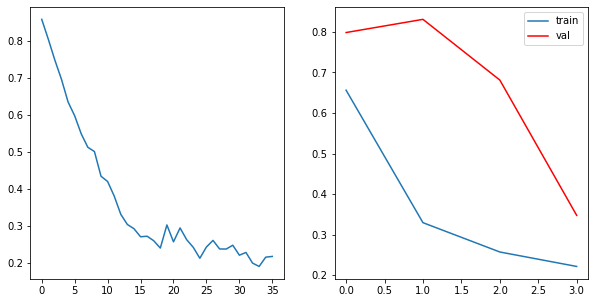

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2064, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2205, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2065, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2039, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1902, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1866, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2022, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2058, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.20623195607843023	     Validation Loss:0.2217433852102846	 \ LR:0.001


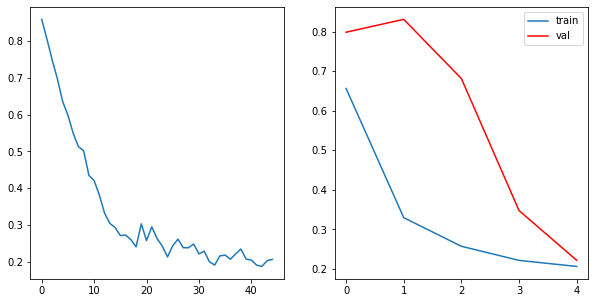

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1986, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1999, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2207, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1756, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1932, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1801, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1769, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1956, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1870, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.1919448494756376	     Validation Loss:0.21178355828284087	 \ LR:0.001


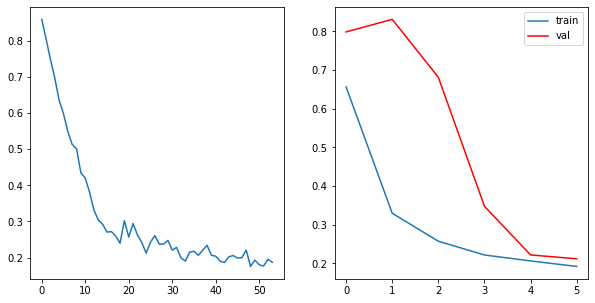

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1820, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2004, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2073, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1787, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1965, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1756, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1677, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1861, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1759, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.18559163276689844	     Validation Loss:0.19865120036716796	 \ LR:0.001


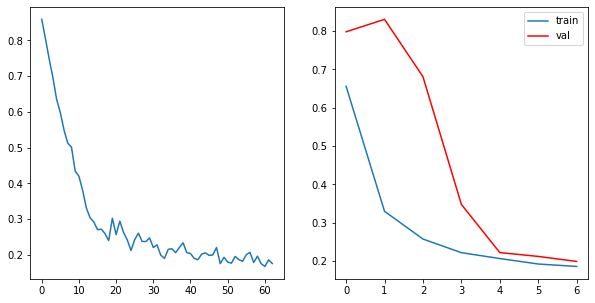

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1708, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1920, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1961, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1600, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1826, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1592, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1524, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1769, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1696, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.17328949725306264	     Validation Loss:0.18536285091852736	 \ LR:0.001


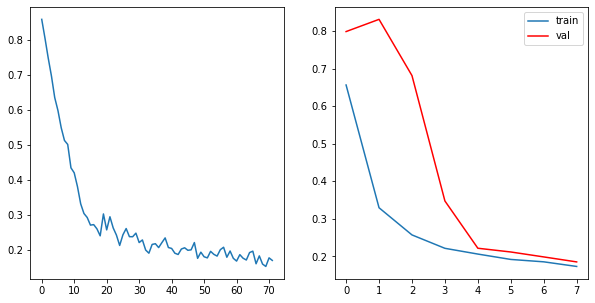

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1671, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1728, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1848, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1764, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1647, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1547, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.16577582583583444	     Validation Loss:0.18503405065201414	 \ LR:0.001


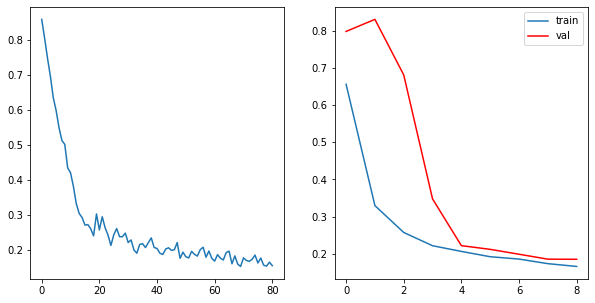

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1564, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1728, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1553, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.15489990956753907	     Validation Loss:0.16769875623850128	 \ LR:0.001


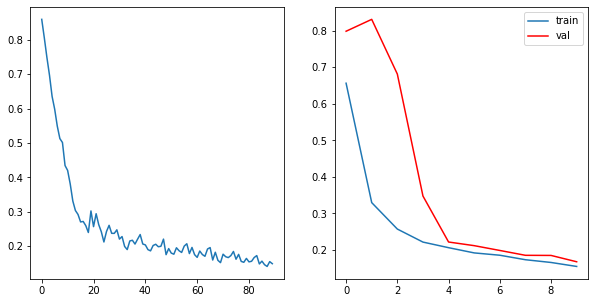

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1504, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1585, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1439, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1462, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1404, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.1475381786037775	     Validation Loss:0.16673231839186023	 \ LR:0.001


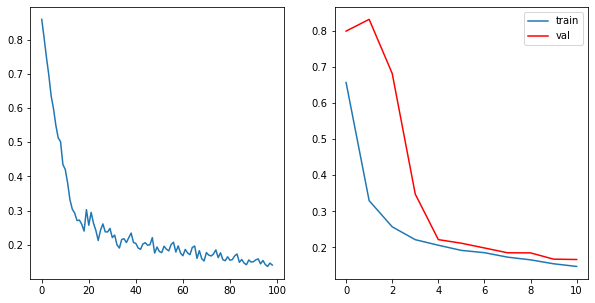

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1496, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1566, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1584, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1320, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1332, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1435, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.14383967628966235	     Validation Loss:0.16491198057288384	 \ LR:0.001


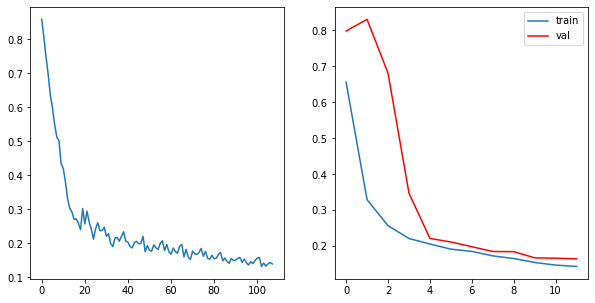

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1360, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1458, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1366, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1400, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1256, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1327, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1407, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1430, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.13967762687310603	     Validation Loss:0.15500485524425212	 \ LR:0.001


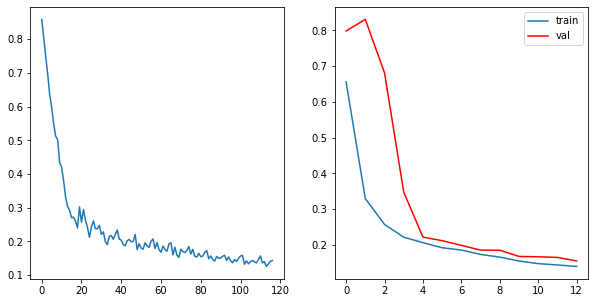

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1332, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1324, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1420, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1245, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1352, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1351, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.13383999781870395	     Validation Loss:0.15247434165086404	 \ LR:0.001


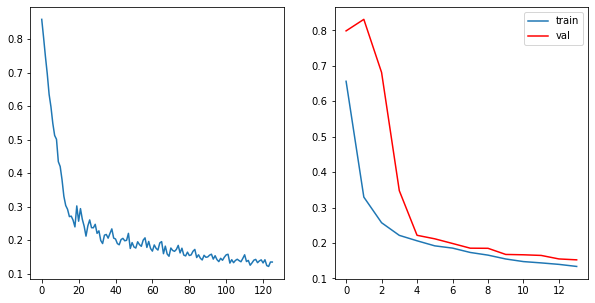

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1312, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1335, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1248, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1185, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1186, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1284, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1253, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.12744685129786062	     Validation Loss:0.15237856658424698	 \ LR:0.001


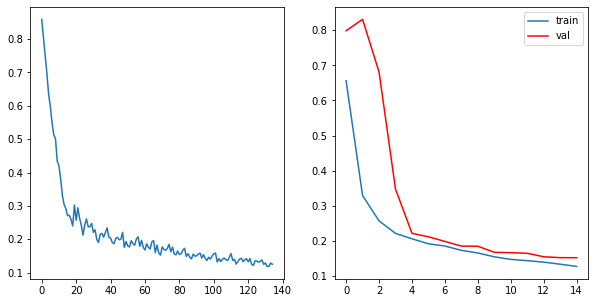

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1276, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1328, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1322, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1193, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1296, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1190, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1255, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1240, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.12514904221731904	     Validation Loss:0.1553104247266943	 \ LR:0.001


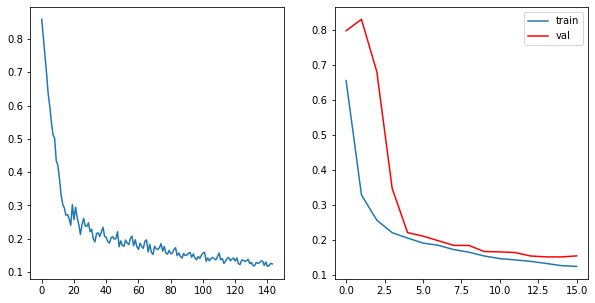

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1231, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1254, dtype=torch.float64, grad_fn=<RsubBackward1>)


KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "res блоки лосс джакард "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/res_jacard_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1944, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.2281, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1721, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1619, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1520, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1659, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.17054160964723453	     Validation Loss:0.15032889410378428	 \ LR:0.001


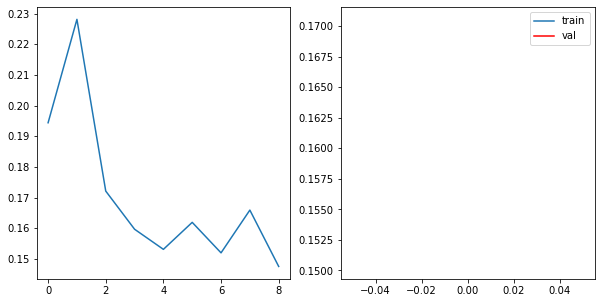

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1464, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1422, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1369, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1384, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1391, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.14205771376607565	     Validation Loss:0.20723566583572053	 \ LR:0.001


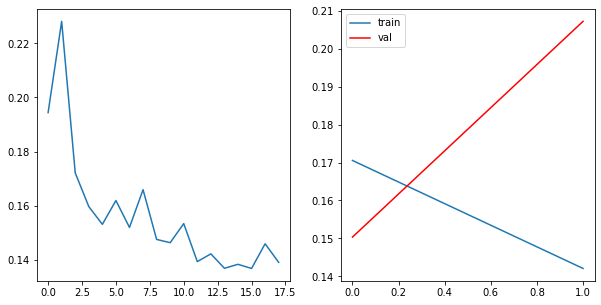

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1344, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1403, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1303, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1336, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1254, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1337, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1279, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1341, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1344, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.13267486847324672	     Validation Loss:0.2699893434704877	 \ LR:0.001


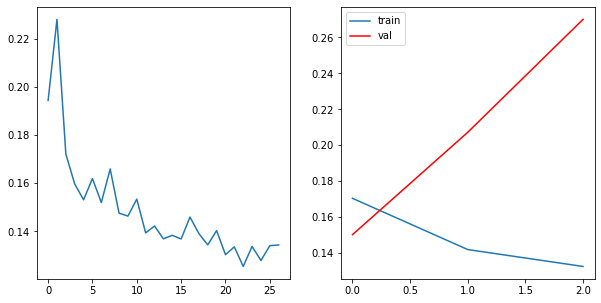

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1245, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1334, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1282, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1234, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1216, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1265, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1244, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1319, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1300, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.1271093642584427	     Validation Loss:0.2765984930139265	 \ LR:0.001


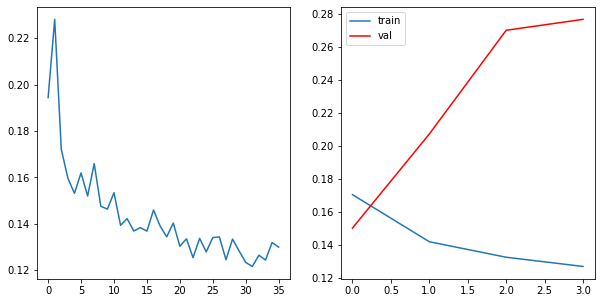

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1208, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1272, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1234, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1239, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1207, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1214, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1212, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1260, dtype=torch.float64, grad_fn=<RsubBackward1>)
tensor(0.1270, dtype=torch.float64, grad_fn=<RsubBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "продолжение с state_130 лосс джакард "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_130_jacard_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.8549, requires_grad=True)
tensor(-0.8580, requires_grad=True)
tensor(-0.8012, requires_grad=True)
tensor(-0.7978, requires_grad=True)
tensor(-0.7290, requires_grad=True)
tensor(-0.6139, requires_grad=True)
tensor(-0.6887, requires_grad=True)
tensor(-0.5645, requires_grad=True)
tensor(-0.5530, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: -0.7178968985875448	     Validation Loss:-0.4649001856644948	 \ LR:0.001


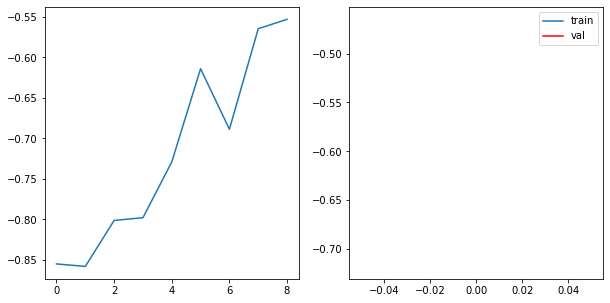

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.4886, requires_grad=True)
tensor(-0.4945, requires_grad=True)
tensor(-0.4214, requires_grad=True)
tensor(-0.4291, requires_grad=True)
tensor(-0.3681, requires_grad=True)
tensor(-0.3177, requires_grad=True)
tensor(-0.3600, requires_grad=True)
tensor(-0.3081, requires_grad=True)
tensor(-0.3156, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: -0.38925930195384556	     Validation Loss:-0.27276985843976337	 \ LR:0.001


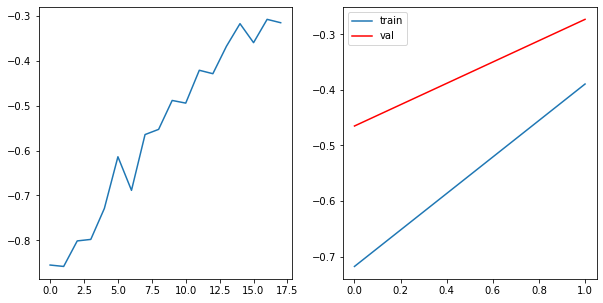

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2862, requires_grad=True)
tensor(-0.3005, requires_grad=True)
tensor(-0.2833, requires_grad=True)
tensor(-0.2909, requires_grad=True)
tensor(-0.2697, requires_grad=True)
tensor(-0.2442, requires_grad=True)
tensor(-0.2723, requires_grad=True)
tensor(-0.2506, requires_grad=True)
tensor(-0.2563, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: -0.2726750622193019	     Validation Loss:-0.2289996494849523	 \ LR:0.001


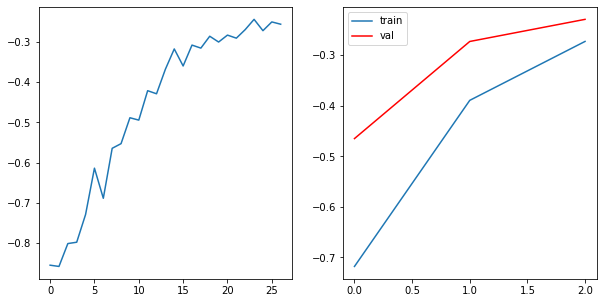

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2405, requires_grad=True)
tensor(-0.2509, requires_grad=True)
tensor(-0.2478, requires_grad=True)
tensor(-0.2537, requires_grad=True)
tensor(-0.2407, requires_grad=True)
tensor(-0.2215, requires_grad=True)
tensor(-0.2456, requires_grad=True)
tensor(-0.2314, requires_grad=True)
tensor(-0.2362, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: -0.24091768595907423	     Validation Loss:-0.21709959705670676	 \ LR:0.001


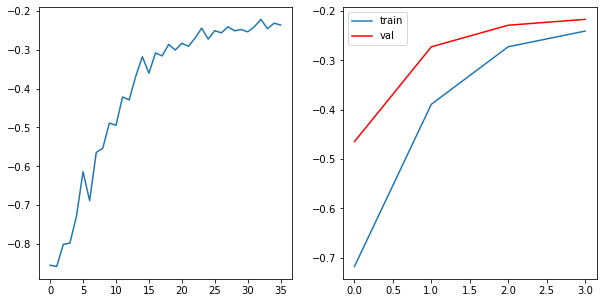

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2267, requires_grad=True)
tensor(-0.2330, requires_grad=True)
tensor(-0.2340, requires_grad=True)
tensor(-0.2404, requires_grad=True)
tensor(-0.2301, requires_grad=True)
tensor(-0.2135, requires_grad=True)
tensor(-0.2360, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2281, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: -0.2294486098819309	     Validation Loss:-0.2145496904850006	 \ LR:0.001


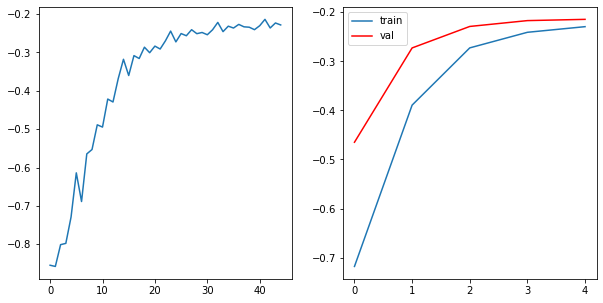

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2222, requires_grad=True)
tensor(-0.2265, requires_grad=True)
tensor(-0.2290, requires_grad=True)
tensor(-0.2349, requires_grad=True)
tensor(-0.2259, requires_grad=True)
tensor(-0.2101, requires_grad=True)
tensor(-0.2313, requires_grad=True)
tensor(-0.2193, requires_grad=True)
tensor(-0.2253, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: -0.22493503987789154	     Validation Loss:-0.21497195462385812	 \ LR:0.001


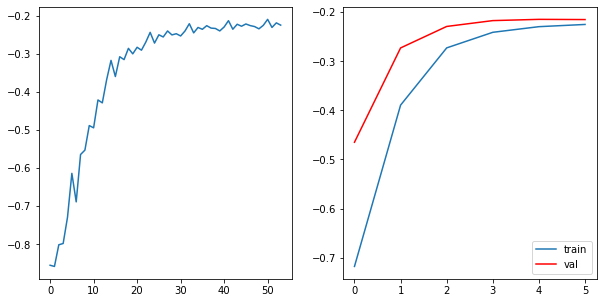

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2199, requires_grad=True)
tensor(-0.2232, requires_grad=True)
tensor(-0.2273, requires_grad=True)
tensor(-0.2337, requires_grad=True)
tensor(-0.2237, requires_grad=True)
tensor(-0.2095, requires_grad=True)
tensor(-0.2301, requires_grad=True)
tensor(-0.2182, requires_grad=True)
tensor(-0.2232, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: -0.22320775853263009	     Validation Loss:-0.21652903159459433	 \ LR:0.0001


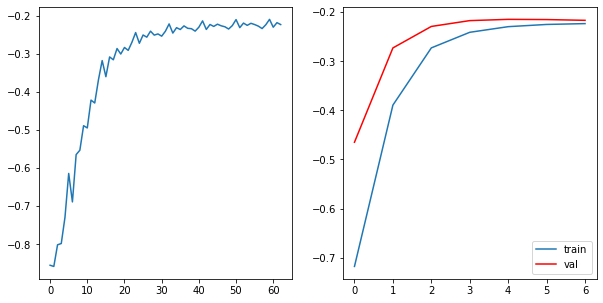

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2190, requires_grad=True)
tensor(-0.2232, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2324, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2295, requires_grad=True)
tensor(-0.2184, requires_grad=True)
tensor(-0.2234, requires_grad=True)


  0%|          | 0/3 [00:02<?, ?it/s]

Epoch 7	 \Training Loss: -0.2226328882906172	     Validation Loss:-0.21627309421698251	 \ LR:0.0001


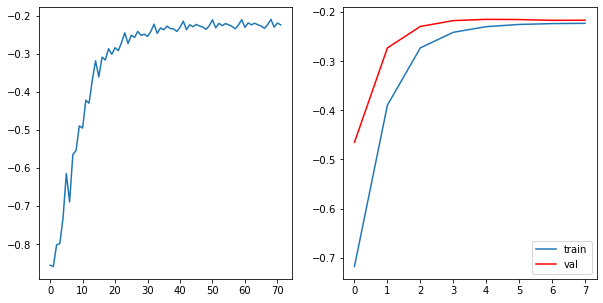

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2192, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2255, requires_grad=True)
tensor(-0.2331, requires_grad=True)
tensor(-0.2223, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2302, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2239, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: -0.22265605959627363	     Validation Loss:-0.21575218935807547	 \ LR:0.0001


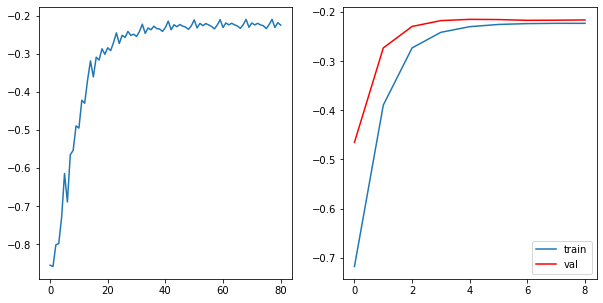

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2189, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2322, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2090, requires_grad=True)
tensor(-0.2292, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: -0.2225145482354694	     Validation Loss:-0.21611899634202322	 \ LR:0.0001


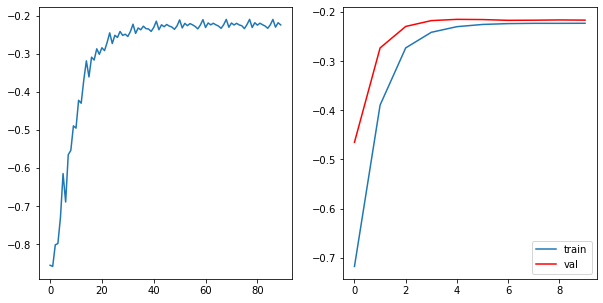

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2191, requires_grad=True)
tensor(-0.2225, requires_grad=True)
tensor(-0.2264, requires_grad=True)
tensor(-0.2332, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2291, requires_grad=True)
tensor(-0.2179, requires_grad=True)
tensor(-0.2239, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: -0.22260362241003248	     Validation Loss:-0.22046049932638803	 \ LR:0.0001


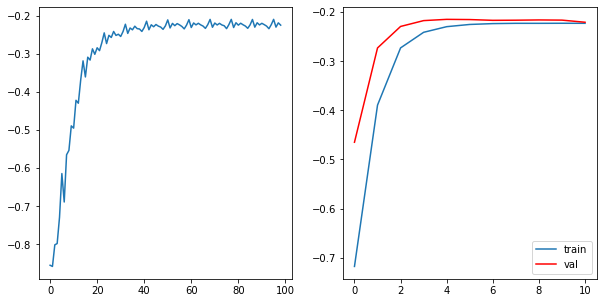

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2191, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2320, requires_grad=True)
tensor(-0.2223, requires_grad=True)
tensor(-0.2086, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2231, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: -0.22239266335964203	     Validation Loss:-0.22478879491488138	 \ LR:0.0001


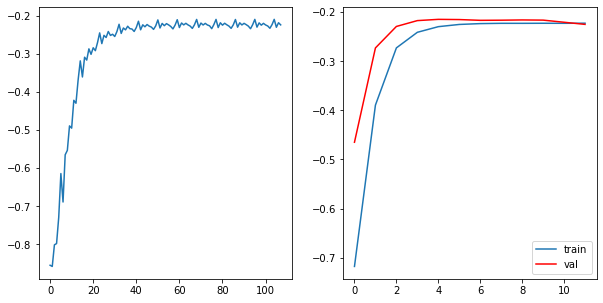

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2192, requires_grad=True)
tensor(-0.2225, requires_grad=True)
tensor(-0.2265, requires_grad=True)
tensor(-0.2322, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2089, requires_grad=True)
tensor(-0.2296, requires_grad=True)
tensor(-0.2173, requires_grad=True)
tensor(-0.2236, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: -0.22252983848253885	     Validation Loss:-0.226783220966657	 \ LR:1e-05


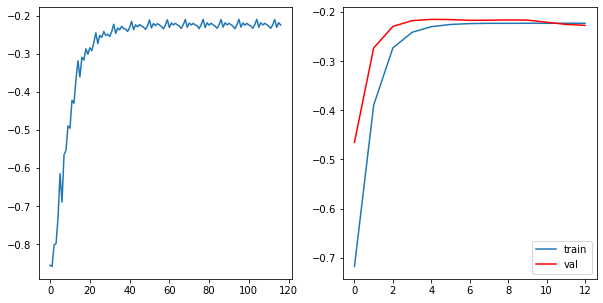

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2194, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2259, requires_grad=True)
tensor(-0.2321, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2091, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2169, requires_grad=True)
tensor(-0.2242, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: -0.2225379231903288	     Validation Loss:-0.22522168358167013	 \ LR:1e-05


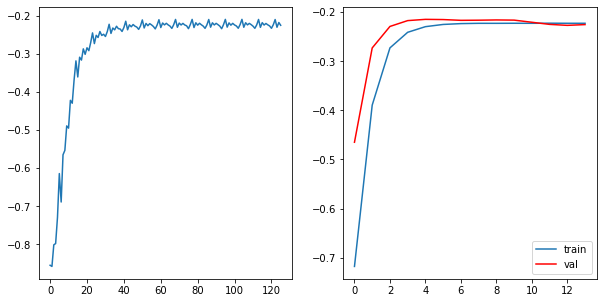

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2187, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2262, requires_grad=True)
tensor(-0.2328, requires_grad=True)
tensor(-0.2224, requires_grad=True)
tensor(-0.2091, requires_grad=True)
tensor(-0.2302, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2237, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: -0.22260306278864542	     Validation Loss:-0.22372297445933023	 \ LR:1e-05


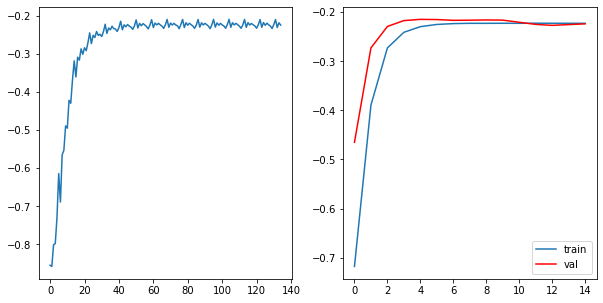

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2189, requires_grad=True)
tensor(-0.2232, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2325, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2090, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2232, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: -0.222531548804707	     Validation Loss:-0.22580643991629282	 \ LR:1e-05


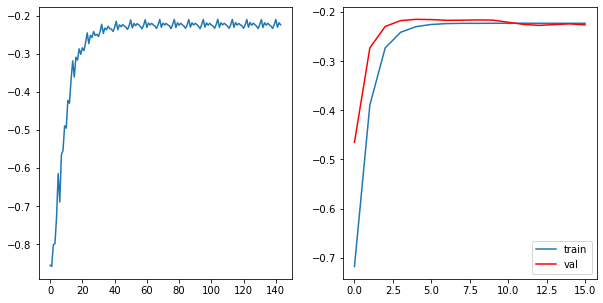

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2194, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2262, requires_grad=True)
tensor(-0.2324, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2178, requires_grad=True)
tensor(-0.2231, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: -0.22257955703470442	     Validation Loss:-0.22925128042697906	 \ LR:1e-05


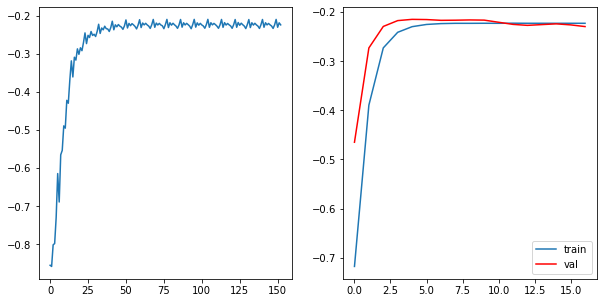

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2192, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2258, requires_grad=True)
tensor(-0.2323, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2083, requires_grad=True)
tensor(-0.2298, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: -0.2224766578939226	     Validation Loss:-0.2287557323773702	 \ LR:1e-05


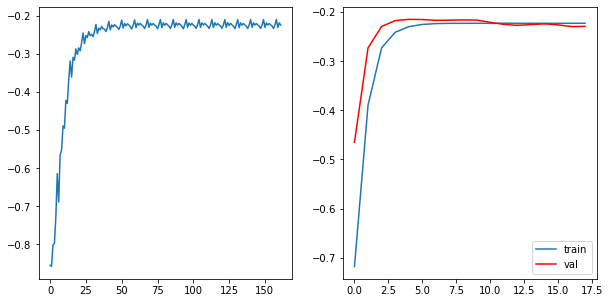

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2189, requires_grad=True)
tensor(-0.2225, requires_grad=True)
tensor(-0.2260, requires_grad=True)
tensor(-0.2329, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2085, requires_grad=True)
tensor(-0.2295, requires_grad=True)
tensor(-0.2178, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: -0.22252927554978263	     Validation Loss:-0.22966618835926056	 \ LR:1.0000000000000002e-06


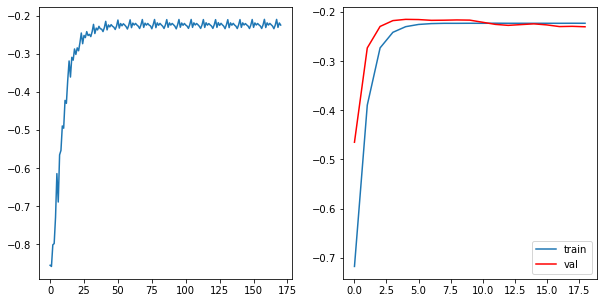

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2194, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2267, requires_grad=True)
tensor(-0.2328, requires_grad=True)
tensor(-0.2235, requires_grad=True)
tensor(-0.2090, requires_grad=True)
tensor(-0.2291, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2234, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: -0.22271441751056248	     Validation Loss:-0.2284600188334783	 \ LR:1.0000000000000002e-06


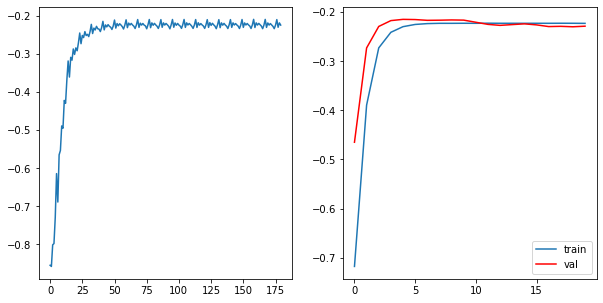

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2187, requires_grad=True)
tensor(-0.2228, requires_grad=True)
tensor(-0.2252, requires_grad=True)
tensor(-0.2334, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2084, requires_grad=True)
tensor(-0.2291, requires_grad=True)
tensor(-0.2181, requires_grad=True)
tensor(-0.2234, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: -0.22248318129115635	     Validation Loss:-0.22833182911078134	 \ LR:1.0000000000000002e-06


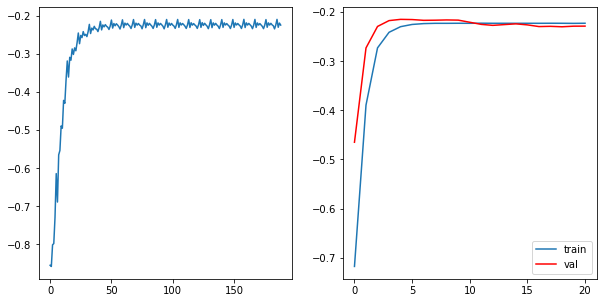

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2188, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2264, requires_grad=True)
tensor(-0.2321, requires_grad=True)
tensor(-0.2238, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2303, requires_grad=True)
tensor(-0.2178, requires_grad=True)
tensor(-0.2237, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: -0.22272826896773446	     Validation Loss:-0.22798523803551993	 \ LR:1.0000000000000002e-06


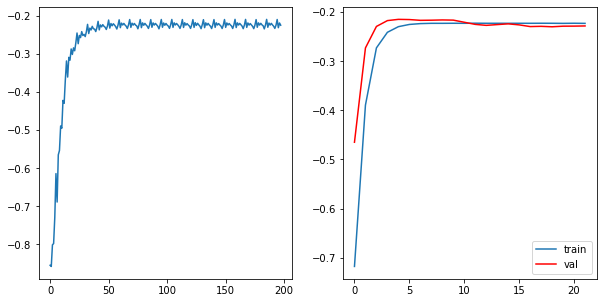

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2186, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2255, requires_grad=True)
tensor(-0.2325, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2084, requires_grad=True)
tensor(-0.2296, requires_grad=True)
tensor(-0.2177, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: -0.22230065365632376	     Validation Loss:-0.22498631477355957	 \ LR:1.0000000000000002e-06


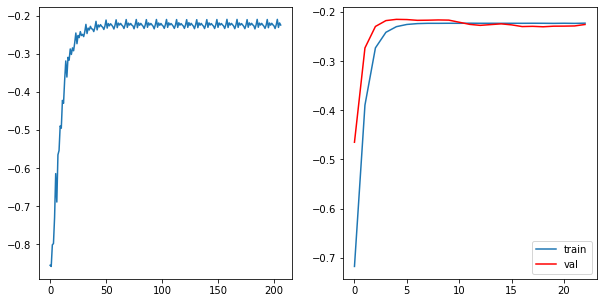

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2192, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2257, requires_grad=True)
tensor(-0.2326, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2089, requires_grad=True)
tensor(-0.2300, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2234, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: -0.22259289026260376	     Validation Loss:-0.22839354972044626	 \ LR:1.0000000000000002e-06


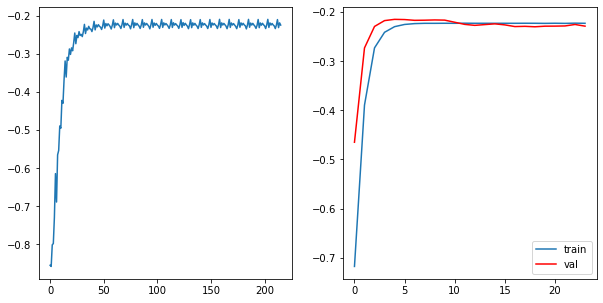

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2194, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2256, requires_grad=True)
tensor(-0.2322, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2086, requires_grad=True)
tensor(-0.2297, requires_grad=True)
tensor(-0.2177, requires_grad=True)
tensor(-0.2237, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: -0.22253812021679348	     Validation Loss:-0.22714618345101675	 \ LR:1.0000000000000002e-07


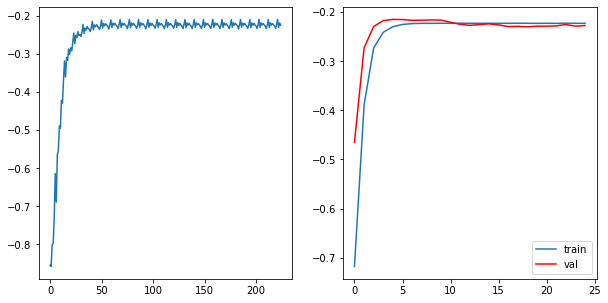

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2193, requires_grad=True)
tensor(-0.2224, requires_grad=True)
tensor(-0.2267, requires_grad=True)
tensor(-0.2326, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2086, requires_grad=True)
tensor(-0.2299, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2237, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: -0.22267216609583962	     Validation Loss:-0.2254319985707601	 \ LR:1.0000000000000002e-07


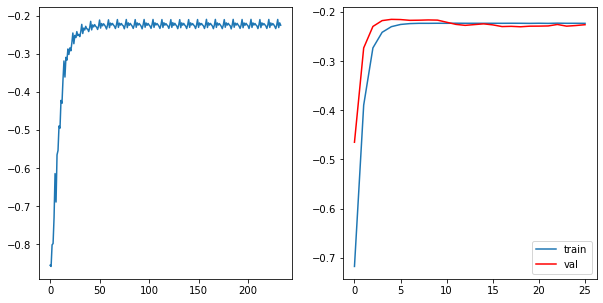

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2196, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2258, requires_grad=True)
tensor(-0.2324, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2091, requires_grad=True)
tensor(-0.2298, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2235, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: -0.22266383800241682	     Validation Loss:-0.22522825002670288	 \ LR:1.0000000000000002e-07


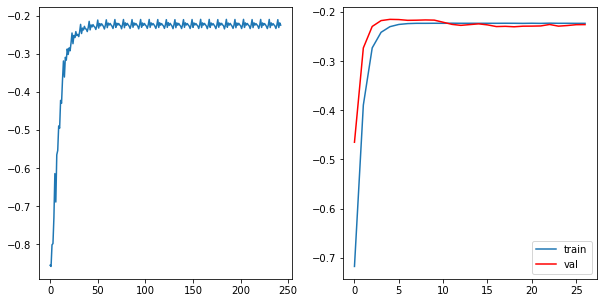

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2187, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2259, requires_grad=True)
tensor(-0.2329, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2298, requires_grad=True)
tensor(-0.2170, requires_grad=True)
tensor(-0.2237, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: -0.22250493036376107	     Validation Loss:-0.22468569378058115	 \ LR:1.0000000000000002e-07


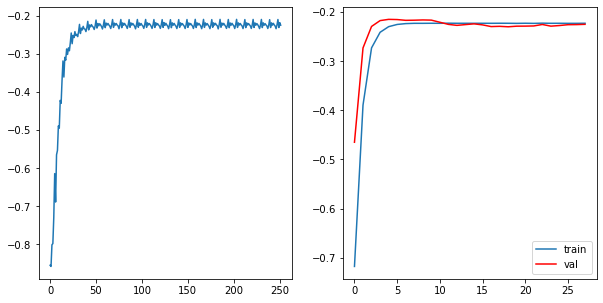

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2193, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2324, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2090, requires_grad=True)
tensor(-0.2296, requires_grad=True)
tensor(-0.2172, requires_grad=True)
tensor(-0.2236, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: -0.2225648065408071	     Validation Loss:-0.22562280297279358	 \ LR:1.0000000000000002e-07


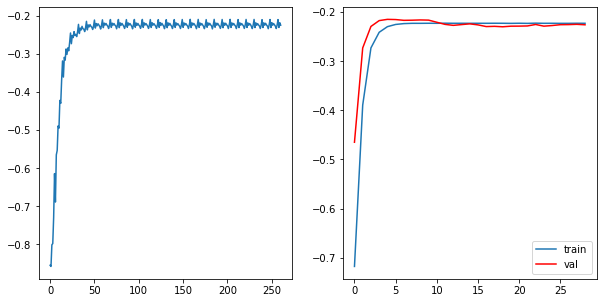

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2191, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2264, requires_grad=True)
tensor(-0.2323, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2295, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2235, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: -0.22256842090023887	     Validation Loss:-0.22817852596441904	 \ LR:1.0000000000000002e-07


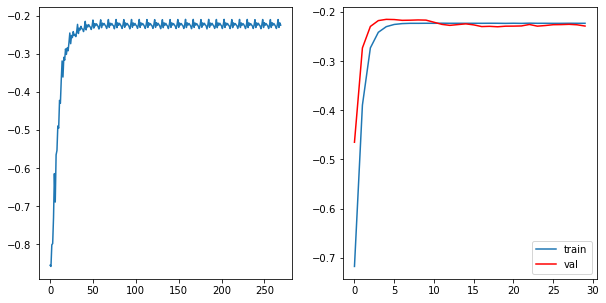

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2185, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2319, requires_grad=True)
tensor(-0.2228, requires_grad=True)
tensor(-0.2086, requires_grad=True)
tensor(-0.2291, requires_grad=True)
tensor(-0.2178, requires_grad=True)
tensor(-0.2235, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: -0.22240379121568468	     Validation Loss:-0.22564667463302612	 \ LR:1.0000000000000004e-08


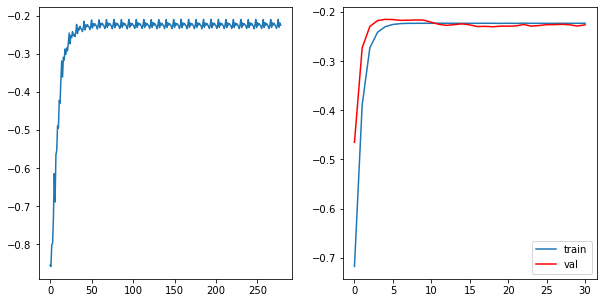

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2191, requires_grad=True)
tensor(-0.2222, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2329, requires_grad=True)
tensor(-0.2237, requires_grad=True)
tensor(-0.2081, requires_grad=True)
tensor(-0.2297, requires_grad=True)
tensor(-0.2179, requires_grad=True)
tensor(-0.2231, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: -0.22253794305854374	     Validation Loss:-0.22823878626028696	 \ LR:1.0000000000000004e-08


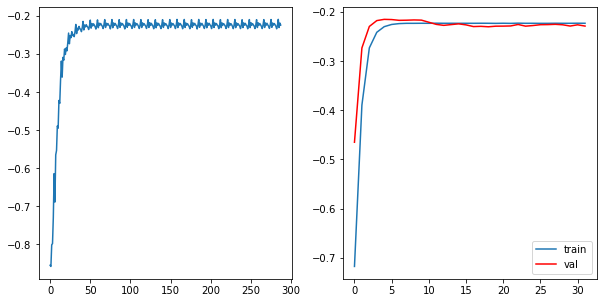

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2182, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2259, requires_grad=True)
tensor(-0.2327, requires_grad=True)
tensor(-0.2235, requires_grad=True)
tensor(-0.2095, requires_grad=True)
tensor(-0.2293, requires_grad=True)
tensor(-0.2174, requires_grad=True)
tensor(-0.2239, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: -0.2226160168647766	     Validation Loss:-0.22785544892152151	 \ LR:1.0000000000000004e-08


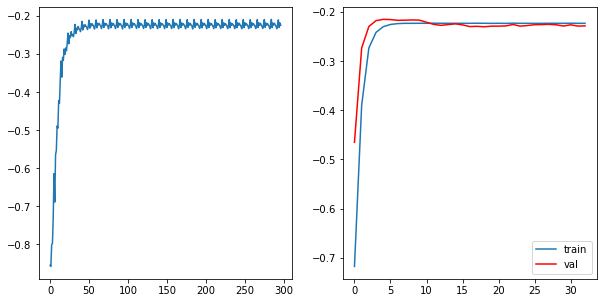

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2193, requires_grad=True)
tensor(-0.2220, requires_grad=True)
tensor(-0.2257, requires_grad=True)
tensor(-0.2322, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2297, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2231, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: -0.22241628501150343	     Validation Loss:-0.22884671886761984	 \ LR:1.0000000000000004e-08


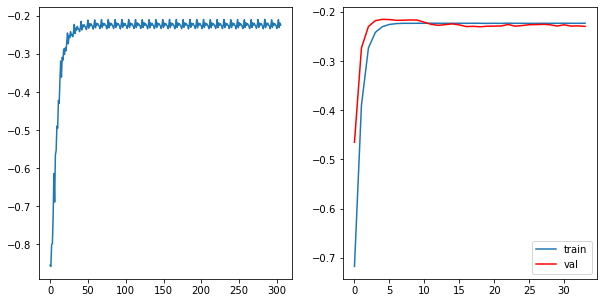

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2191, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2325, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2168, requires_grad=True)
tensor(-0.2236, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: -0.222523538602723	     Validation Loss:-0.22553577025731406	 \ LR:1.0000000000000004e-08


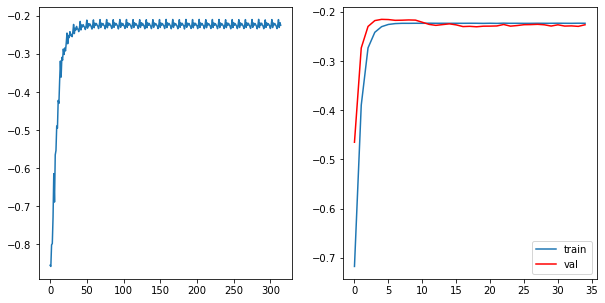

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2188, requires_grad=True)
tensor(-0.2222, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2319, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2299, requires_grad=True)
tensor(-0.2178, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: -0.22241721716192034	     Validation Loss:-0.22535293300946554	 \ LR:1.0000000000000004e-08


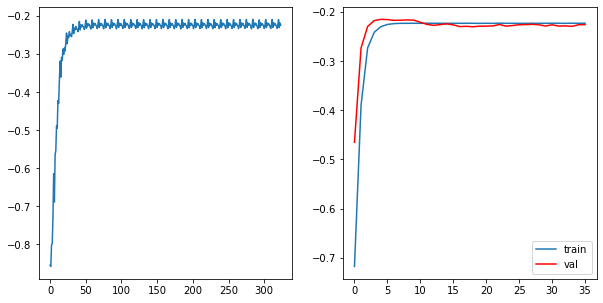

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2191, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2258, requires_grad=True)
tensor(-0.2327, requires_grad=True)
tensor(-0.2232, requires_grad=True)
tensor(-0.2089, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2172, requires_grad=True)
tensor(-0.2234, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: -0.22253460850980547	     Validation Loss:-0.22361810008684793	 \ LR:1.0000000000000004e-08


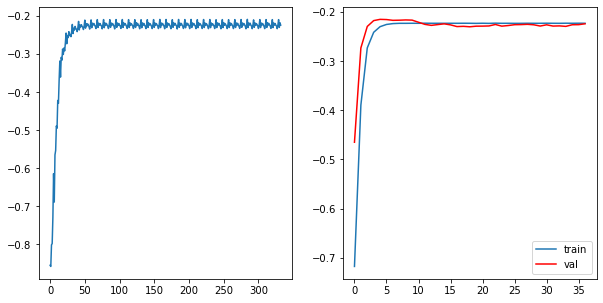

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2195, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2323, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2085, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2227, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: -0.22252039114634195	     Validation Loss:-0.22505568464597067	 \ LR:1.0000000000000004e-08


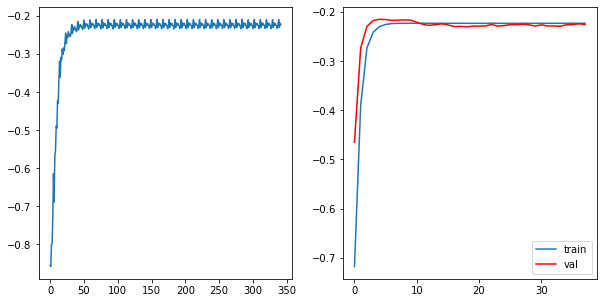

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2196, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2325, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2084, requires_grad=True)
tensor(-0.2295, requires_grad=True)
tensor(-0.2182, requires_grad=True)
tensor(-0.2236, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: -0.22265582614474827	     Validation Loss:-0.228946382800738	 \ LR:1.0000000000000004e-08


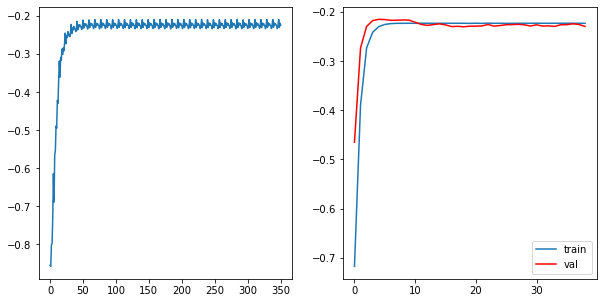

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2195, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2257, requires_grad=True)
tensor(-0.2327, requires_grad=True)
tensor(-0.2237, requires_grad=True)
tensor(-0.2085, requires_grad=True)
tensor(-0.2299, requires_grad=True)
tensor(-0.2177, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: -0.22262792454825509	     Validation Loss:-0.22838138540585837	 \ LR:1.0000000000000004e-08


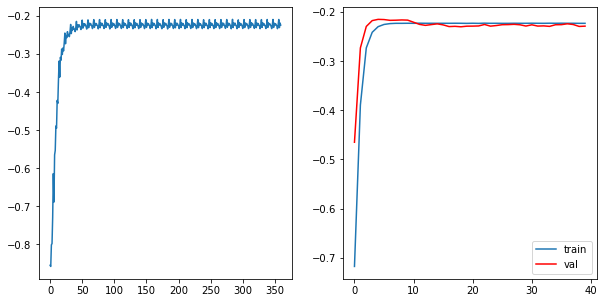

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2193, requires_grad=True)
tensor(-0.2225, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2337, requires_grad=True)
tensor(-0.2232, requires_grad=True)
tensor(-0.2089, requires_grad=True)
tensor(-0.2298, requires_grad=True)
tensor(-0.2179, requires_grad=True)
tensor(-0.2227, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: -0.2226970742146174	     Validation Loss:-0.23049951593081155	 \ LR:1.0000000000000004e-08


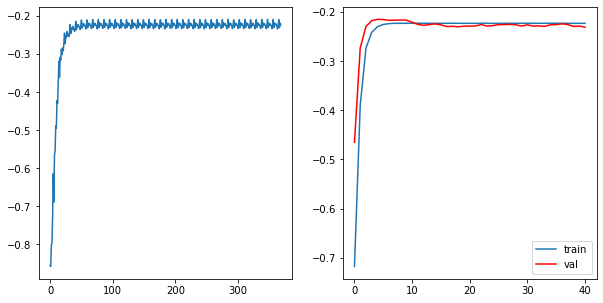

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2190, requires_grad=True)
tensor(-0.2222, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2322, requires_grad=True)
tensor(-0.2236, requires_grad=True)
tensor(-0.2081, requires_grad=True)
tensor(-0.2292, requires_grad=True)
tensor(-0.2180, requires_grad=True)
tensor(-0.2240, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: -0.22252888315253788	     Validation Loss:-0.22773238023122153	 \ LR:1.0000000000000004e-08


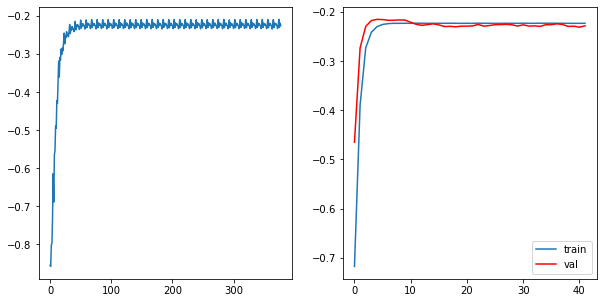

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2194, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2251, requires_grad=True)
tensor(-0.2325, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2089, requires_grad=True)
tensor(-0.2294, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2235, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: -0.2225287225511339	     Validation Loss:-0.22834043701489767	 \ LR:1.0000000000000004e-08


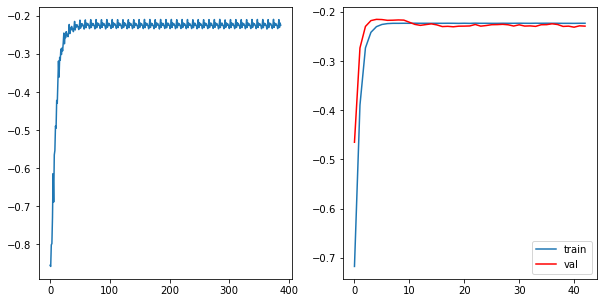

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2198, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2264, requires_grad=True)
tensor(-0.2322, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2297, requires_grad=True)
tensor(-0.2179, requires_grad=True)
tensor(-0.2232, requires_grad=True)


  0%|          | 0/3 [00:02<?, ?it/s]

Epoch 43	 \Training Loss: -0.2226467596160041	     Validation Loss:-0.22787623604138693	 \ LR:1.0000000000000004e-08


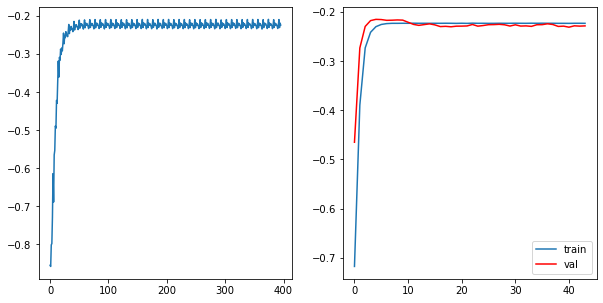

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2192, requires_grad=True)
tensor(-0.2228, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2318, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2090, requires_grad=True)
tensor(-0.2302, requires_grad=True)
tensor(-0.2171, requires_grad=True)
tensor(-0.2236, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: -0.2225591325097614	     Validation Loss:-0.2280690868695577	 \ LR:1.0000000000000004e-08


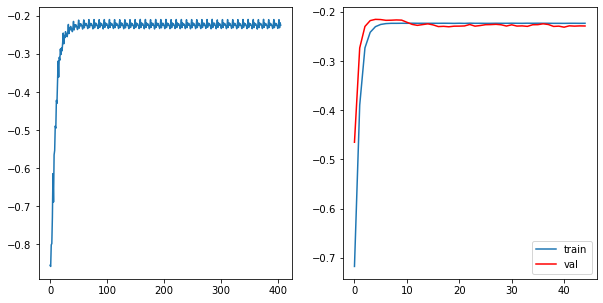

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2190, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2263, requires_grad=True)
tensor(-0.2321, requires_grad=True)
tensor(-0.2232, requires_grad=True)
tensor(-0.2085, requires_grad=True)
tensor(-0.2297, requires_grad=True)
tensor(-0.2173, requires_grad=True)
tensor(-0.2237, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: -0.2225389861398273	     Validation Loss:-0.22701901694138846	 \ LR:1.0000000000000004e-08


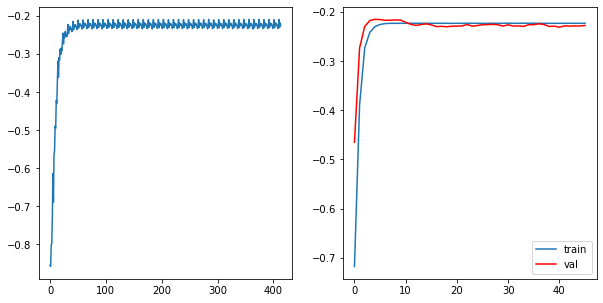

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2200, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2262, requires_grad=True)
tensor(-0.2323, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2085, requires_grad=True)
tensor(-0.2301, requires_grad=True)
tensor(-0.2182, requires_grad=True)
tensor(-0.2229, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: -0.22271116574605307	     Validation Loss:-0.22551321983337402	 \ LR:1.0000000000000004e-08


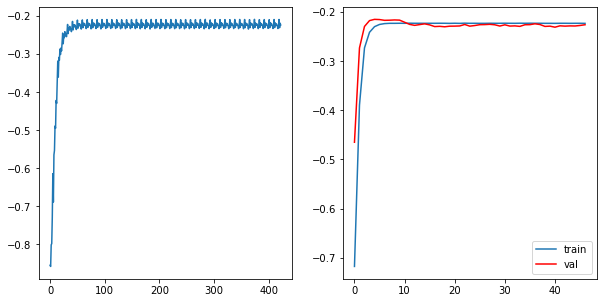

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2189, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2264, requires_grad=True)
tensor(-0.2313, requires_grad=True)
tensor(-0.2230, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2296, requires_grad=True)
tensor(-0.2179, requires_grad=True)
tensor(-0.2231, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: -0.2223972843752967	     Validation Loss:-0.22899087766806284	 \ LR:1.0000000000000004e-08


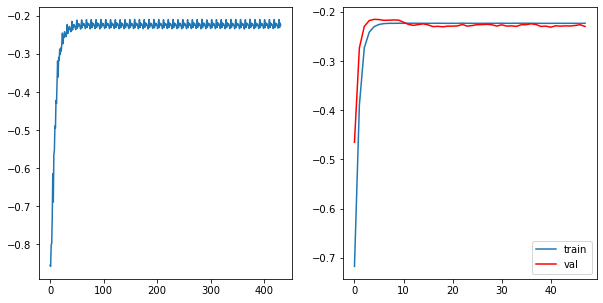

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2195, requires_grad=True)
tensor(-0.2219, requires_grad=True)
tensor(-0.2262, requires_grad=True)
tensor(-0.2318, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2088, requires_grad=True)
tensor(-0.2288, requires_grad=True)
tensor(-0.2173, requires_grad=True)
tensor(-0.2245, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: -0.22244619495338863	     Validation Loss:-0.22623053193092346	 \ LR:1.0000000000000004e-08


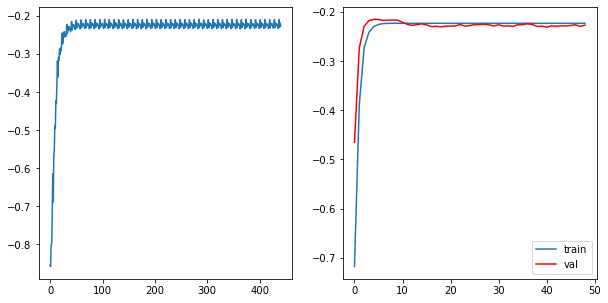

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2190, requires_grad=True)
tensor(-0.2223, requires_grad=True)
tensor(-0.2262, requires_grad=True)
tensor(-0.2325, requires_grad=True)
tensor(-0.2227, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2295, requires_grad=True)
tensor(-0.2177, requires_grad=True)
tensor(-0.2233, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: -0.22243126895692614	     Validation Loss:-0.2279171198606491	 \ LR:1.0000000000000004e-08


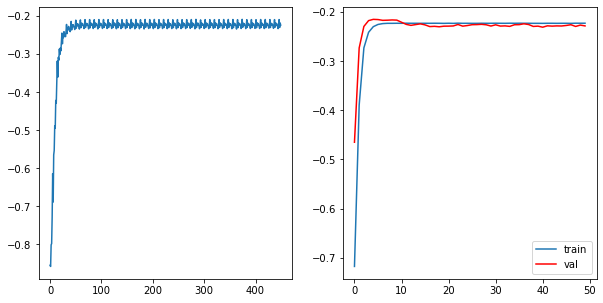

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2194, requires_grad=True)
tensor(-0.2226, requires_grad=True)
tensor(-0.2259, requires_grad=True)
tensor(-0.2331, requires_grad=True)
tensor(-0.2231, requires_grad=True)
tensor(-0.2089, requires_grad=True)
tensor(-0.2296, requires_grad=True)
tensor(-0.2175, requires_grad=True)
tensor(-0.2232, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: -0.22257327371173435	     Validation Loss:-0.2247499277194341	 \ LR:1.0000000000000004e-08


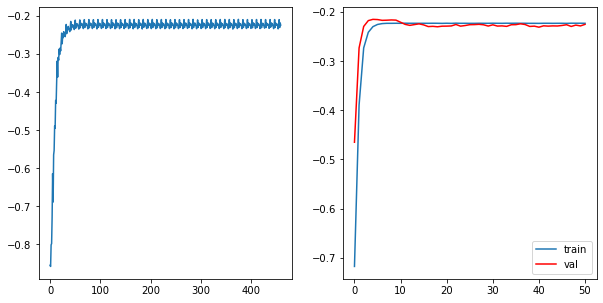

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2195, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2262, requires_grad=True)
tensor(-0.2328, requires_grad=True)
tensor(-0.2234, requires_grad=True)
tensor(-0.2092, requires_grad=True)
tensor(-0.2303, requires_grad=True)
tensor(-0.2176, requires_grad=True)
tensor(-0.2238, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: -0.22284634908040366	     Validation Loss:-0.22697813808918	 \ LR:1.0000000000000004e-08


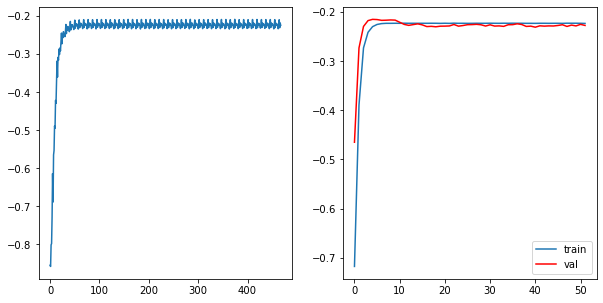

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2190, requires_grad=True)
tensor(-0.2233, requires_grad=True)
tensor(-0.2261, requires_grad=True)
tensor(-0.2323, requires_grad=True)
tensor(-0.2229, requires_grad=True)
tensor(-0.2086, requires_grad=True)
tensor(-0.2297, requires_grad=True)
tensor(-0.2179, requires_grad=True)
tensor(-0.2239, requires_grad=True)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: -0.22262252039379543	     Validation Loss:-0.22828753292560577	 \ LR:1.0000000000000004e-08


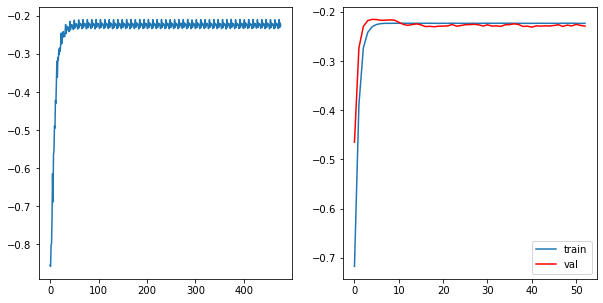

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(-0.2193, requires_grad=True)
tensor(-0.2222, requires_grad=True)
tensor(-0.2260, requires_grad=True)
tensor(-0.2328, requires_grad=True)
tensor(-0.2236, requires_grad=True)
tensor(-0.2087, requires_grad=True)
tensor(-0.2292, requires_grad=True)
tensor(-0.2174, requires_grad=True)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = jacard_coef_loss(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "продолжение с state_130 лосс джакард "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_130_jacard_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = jacard_coef_loss(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2945, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1939, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1720, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1715, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.19327365767196755	     Validation Loss:0.1955588148657715	 \ LR:0.001


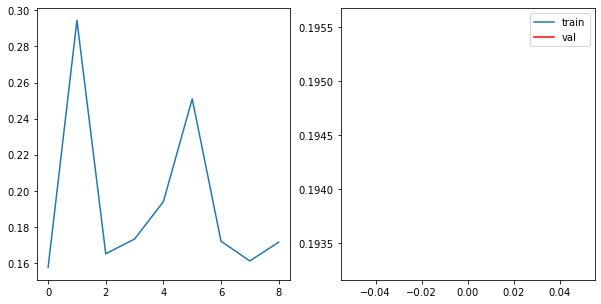

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1877, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.16432645566750748	     Validation Loss:0.22895973260617244	 \ LR:0.001


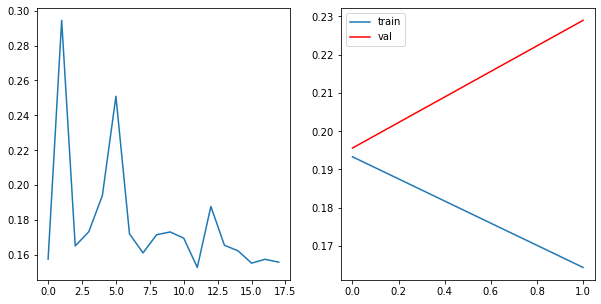

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1408, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.15031191358403298	     Validation Loss:0.21275237566788582	 \ LR:0.001


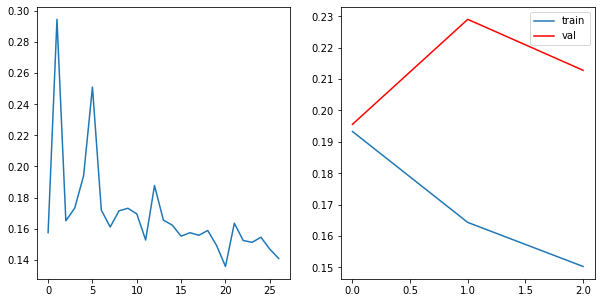

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1349, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1407, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1351, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.13992450655203872	     Validation Loss:0.2635484707523128	 \ LR:0.001


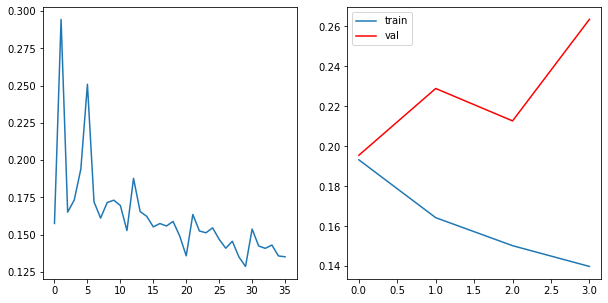

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1349, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1308, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1316, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.13461030880858071	     Validation Loss:0.40447707670491506	 \ LR:0.001


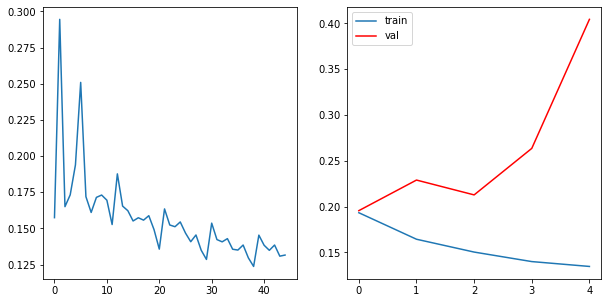

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1359, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1258, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1189, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1412, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1270, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.1308511456502953	     Validation Loss:0.5382105500756966	 \ LR:0.001


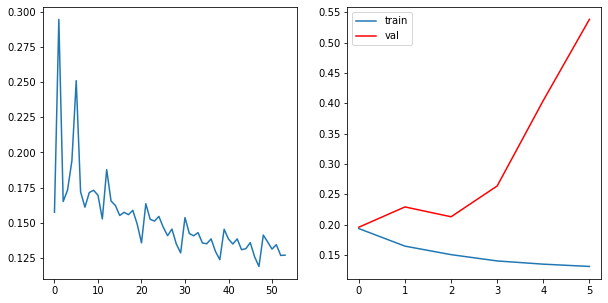

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1167, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1318, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1253, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.1279173265205987	     Validation Loss:0.7087666714796281	 \ LR:0.0001


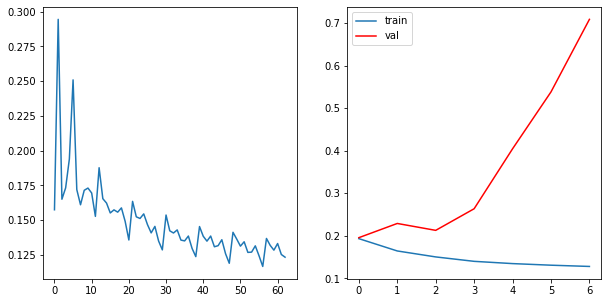

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1209, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.12415554171511917	     Validation Loss:0.7784062673371417	 \ LR:0.0001


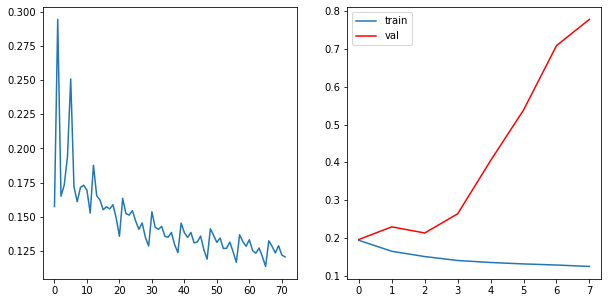

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1189, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.12309748322859917	     Validation Loss:0.8406289017948358	 \ LR:0.0001


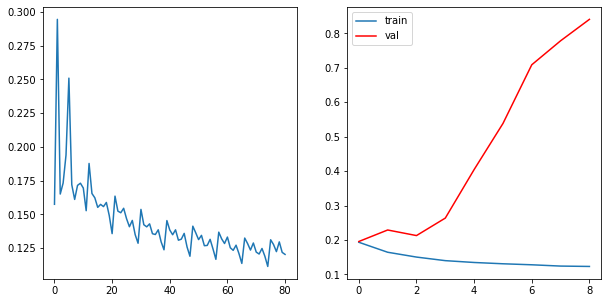

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1244, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1186, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1109, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1310, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1195, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.12262318426759469	     Validation Loss:0.8768866552878443	 \ LR:0.0001


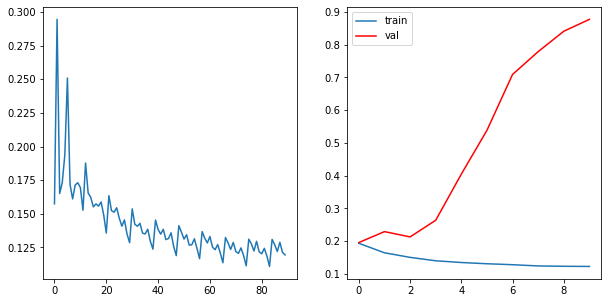

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1106, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1267, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1212, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.12219261907856421	     Validation Loss:0.9115957278081455	 \ LR:0.0001


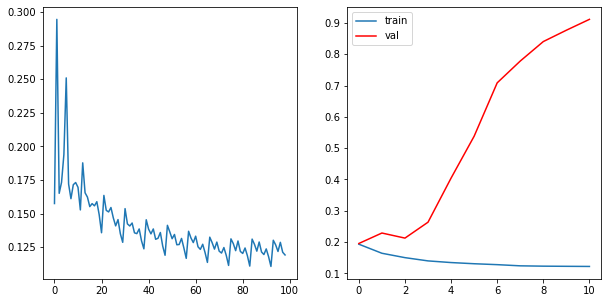

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1233, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1102, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1297, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1260, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1215, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1280, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1187, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.12176287640560103	     Validation Loss:0.9442407227882796	 \ LR:0.0001


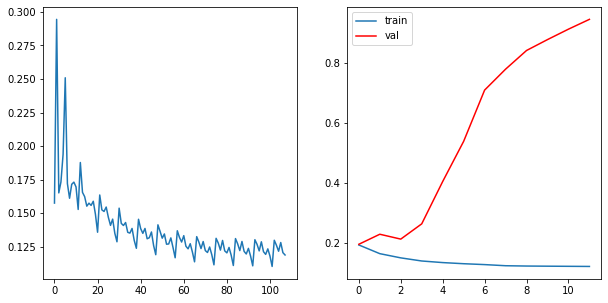

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1175, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1097, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1261, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1215, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1187, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.12153689990698423	     Validation Loss:0.9730307242148308	 \ LR:1e-05


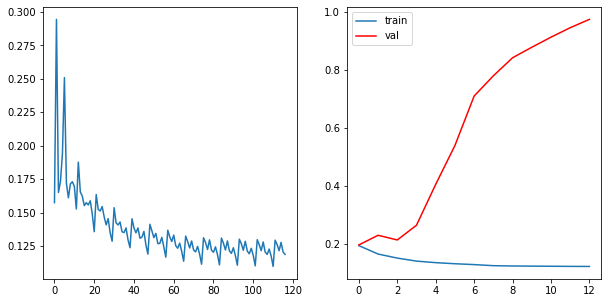

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1183, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.12105268355168748	     Validation Loss:1.0167861116863899	 \ LR:1e-05


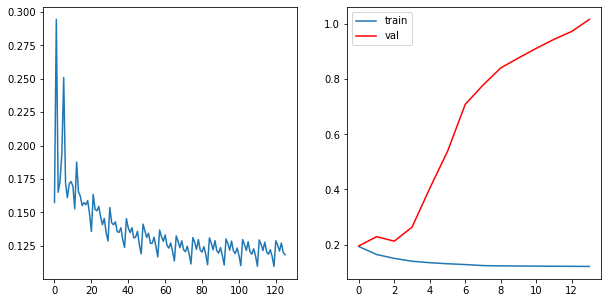

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1223, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1173, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1272, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1185, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.1211174513579405	     Validation Loss:0.9814625910086798	 \ LR:1e-05


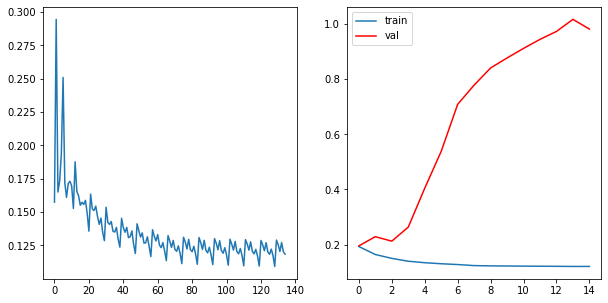

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1167, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1253, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1185, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.1210178570805574	     Validation Loss:0.9988271386185216	 \ LR:1e-05


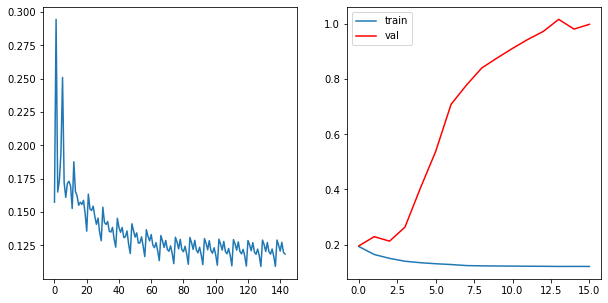

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1167, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1253, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1186, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.1210046710273421	     Validation Loss:0.9810826249438712	 \ LR:1e-05


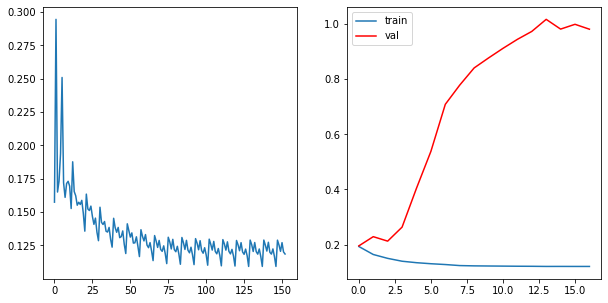

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1209, dtype=torch.float64, grad_fn=<DivBackward1>)


KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "продолжение с state_130  "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_130_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.5545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2630, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4762, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9133, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8095, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 1.1254803896357783	     Validation Loss:3495.0469445703943	 \ LR:0.01


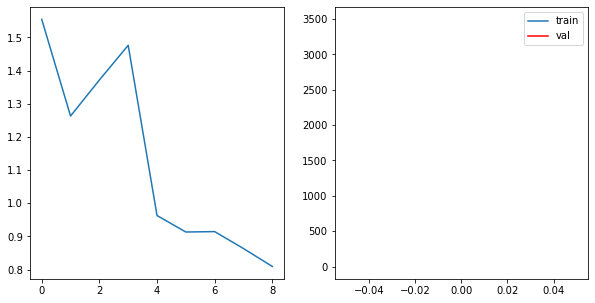

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5744, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7876, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7170, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.7034738259737788	     Validation Loss:19.328659367206708	 \ LR:0.01


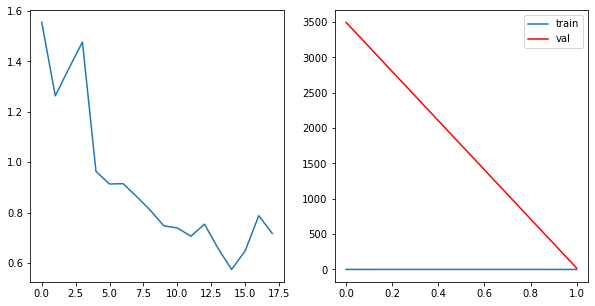

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6309, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5565, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.6095101447013007	     Validation Loss:0.6886882768441979	 \ LR:0.01


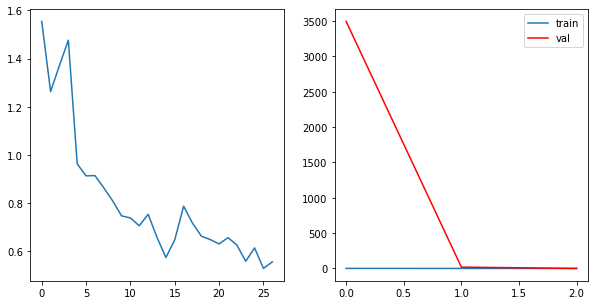

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5182, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4908, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5352, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4819, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4354, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.48730966382176155	     Validation Loss:0.666041461658711	 \ LR:0.01


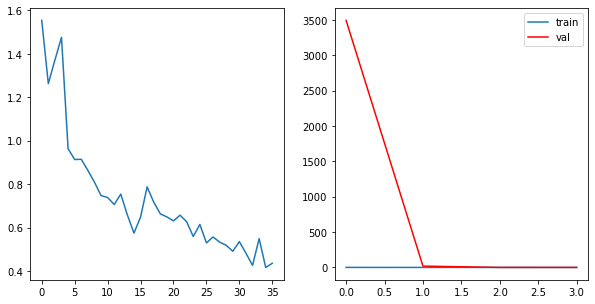

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4181, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4005, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4078, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3799, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.4068616559456245	     Validation Loss:0.4890928107696589	 \ LR:0.01


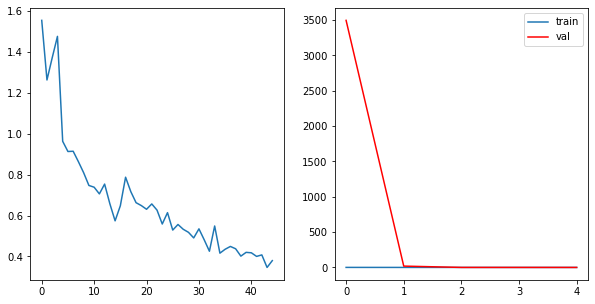

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3879, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3741, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3800, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3973, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.36888275154101274	     Validation Loss:0.4736694498089589	 \ LR:0.01


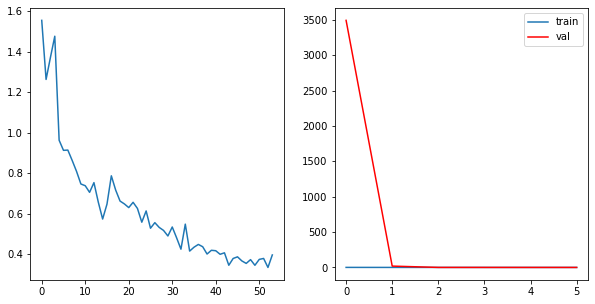

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3250, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3091, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3440, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.3353781608378644	     Validation Loss:0.4628128875568864	 \ LR:0.01


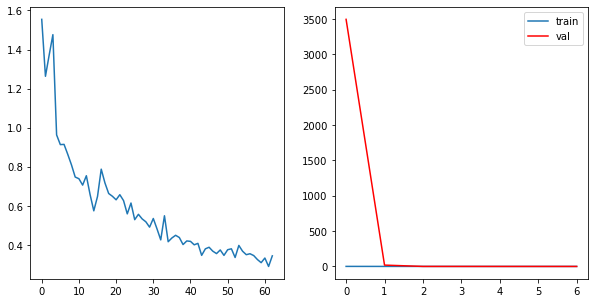

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3318, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3081, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3243, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.31409890814565095	     Validation Loss:0.35838862681938605	 \ LR:0.01


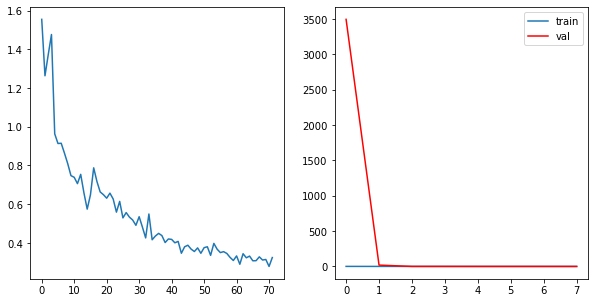

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2950, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2872, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2799, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2820, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2833, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2906, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.29260104852964275	     Validation Loss:0.5209057703536961	 \ LR:0.01


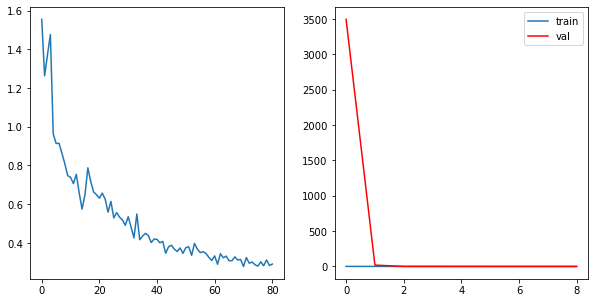

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2892, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2701, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2815, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2800, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.27826546924987877	     Validation Loss:0.42754101314776305	 \ LR:0.01


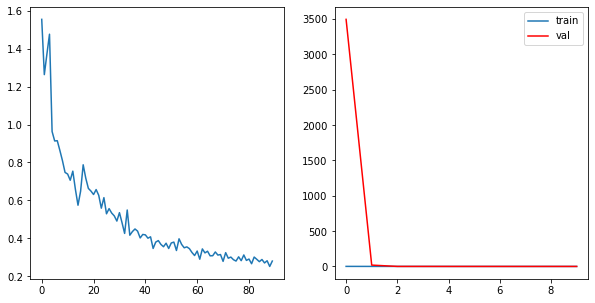

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2853, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2893, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2651, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2968, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.273906805574835	     Validation Loss:0.3673800634430689	 \ LR:0.01


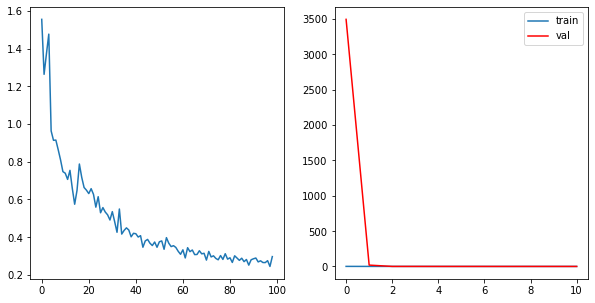

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2506, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2938, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2726, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2679, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2706, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2593, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.26567047529632726	     Validation Loss:0.2832221732123457	 \ LR:0.01


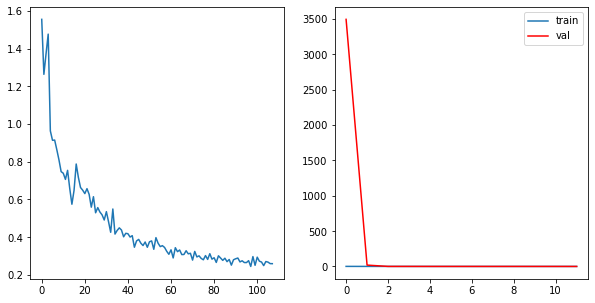

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2663, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2679, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.2541883161661706	     Validation Loss:0.417522849261329	 \ LR:0.01


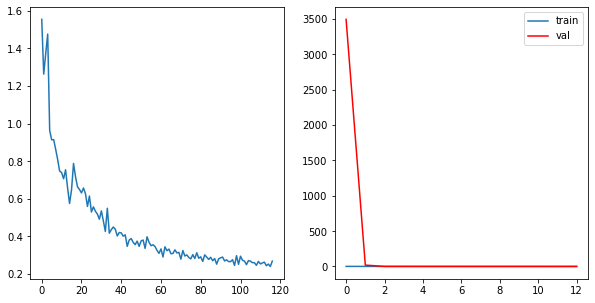

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2350, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2349, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.2454280196106103	     Validation Loss:0.2986200330618475	 \ LR:0.01


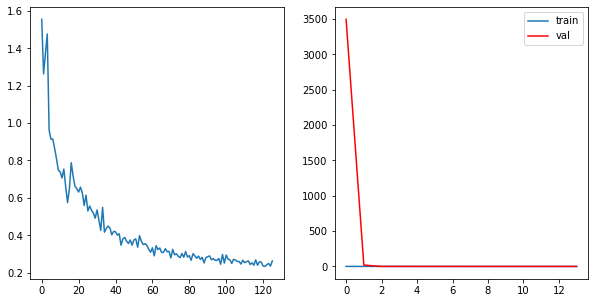

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2629, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.2472993238413196	     Validation Loss:0.3697068035161477	 \ LR:0.01


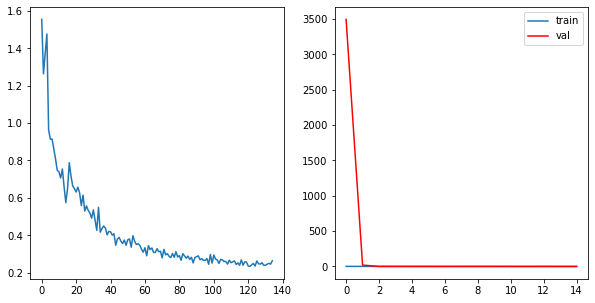

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2341, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2339, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2692, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.24863601198745502	     Validation Loss:0.3196587578896366	 \ LR:0.01


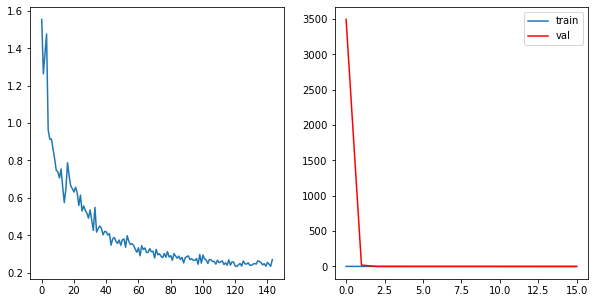

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2795, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2267, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2486, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.24505659862251564	     Validation Loss:0.29130106656843807	 \ LR:0.01


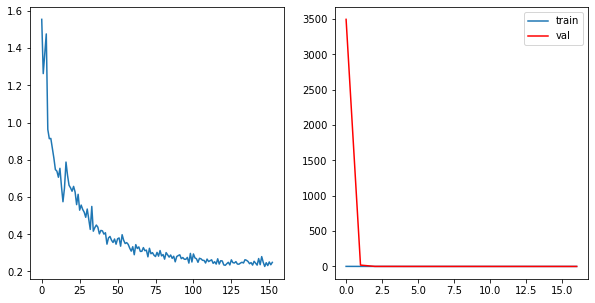

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2351, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2310, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2345, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2582, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.24199080943698156	     Validation Loss:0.2996847765258494	 \ LR:0.001


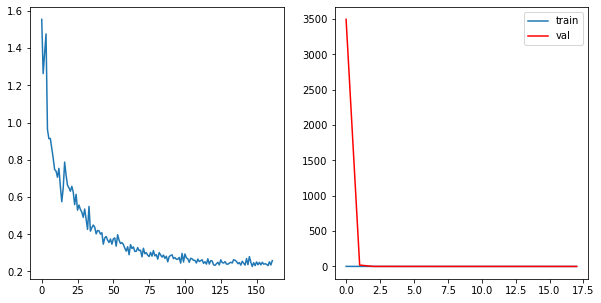

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2349, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2174, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2293, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.23342028488058356	     Validation Loss:0.3028402735082009	 \ LR:0.001


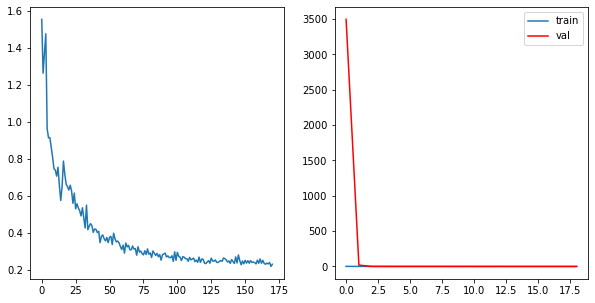

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2305, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2342, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2232, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2104, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2239, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.22220276187736598	     Validation Loss:0.24379194226103085	 \ LR:0.001


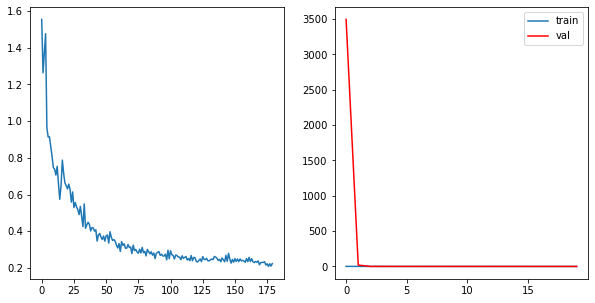

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2189, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2041, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2123, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2036, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2227, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.2157529974394098	     Validation Loss:0.2555091567601905	 \ LR:0.001


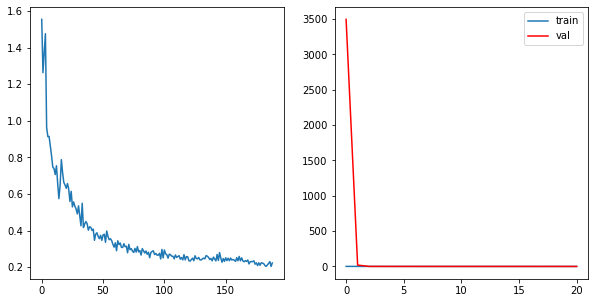

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2092, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2021, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2138, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2071, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2189, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.2123903670506844	     Validation Loss:0.2483338871743556	 \ LR:0.001


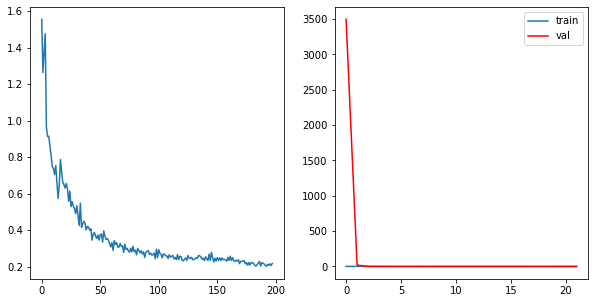

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2187, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2102, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2024, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2025, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2085, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2225, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2126, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.21045426155021685	     Validation Loss:0.23760814140798994	 \ LR:0.001


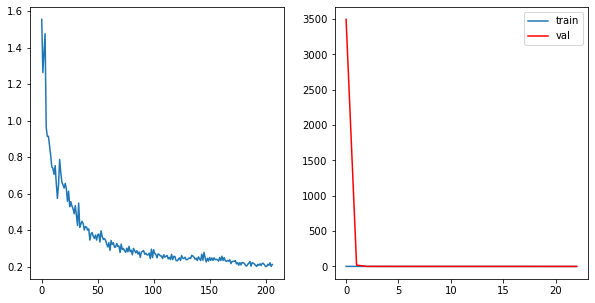

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2089, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2013, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2059, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2002, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2143, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.2087847033974383	     Validation Loss:0.24542768069077123	 \ LR:0.001


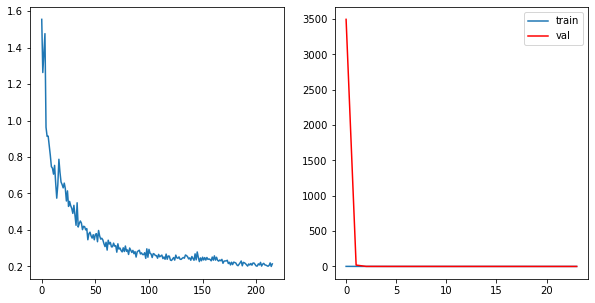

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2153, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1967, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2198, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2000, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2105, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.20813459476885754	     Validation Loss:0.24736255047462552	 \ LR:0.001


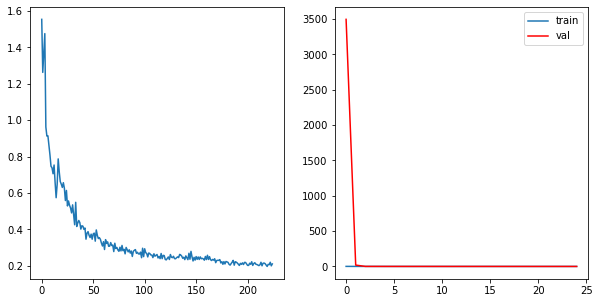

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2174, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2067, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2021, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2051, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2126, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.20703954472692987	     Validation Loss:0.24836915002417734	 \ LR:0.001


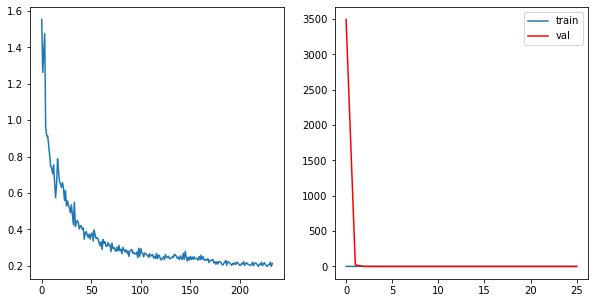

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2094, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1988, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2133, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.2064507989187134	     Validation Loss:0.24036513091748657	 \ LR:0.001


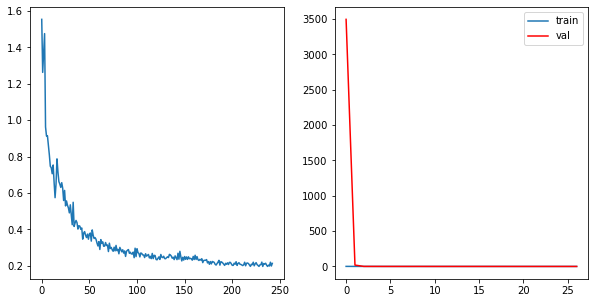

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1928, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2113, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.20480536308681646	     Validation Loss:0.23979249405252548	 \ LR:0.001


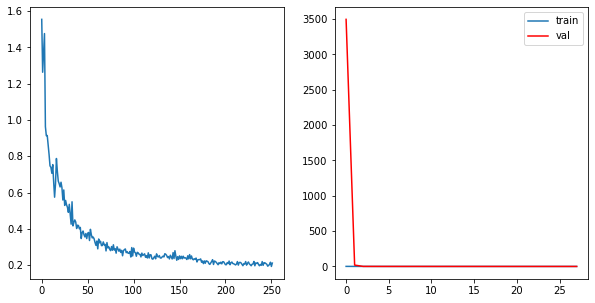

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2050, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2060, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2021, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1993, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1972, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2118, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.20467078259532154	     Validation Loss:0.24593087428579352	 \ LR:0.0001


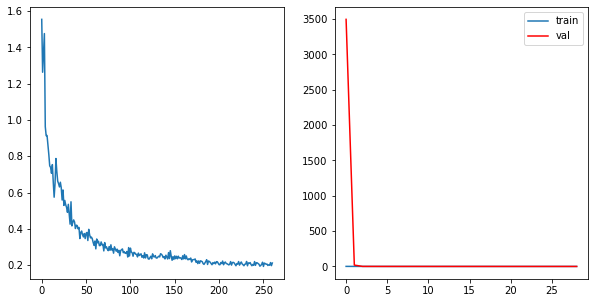

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2070, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1939, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2117, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.20223866867656642	     Validation Loss:0.2428382393927232	 \ LR:0.0001


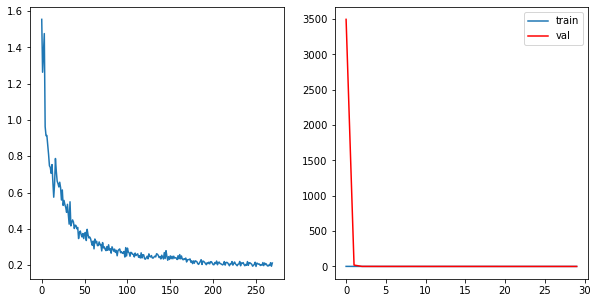

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2117, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1928, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2080, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.20115590000154102	     Validation Loss:0.23813507391768896	 \ LR:0.0001


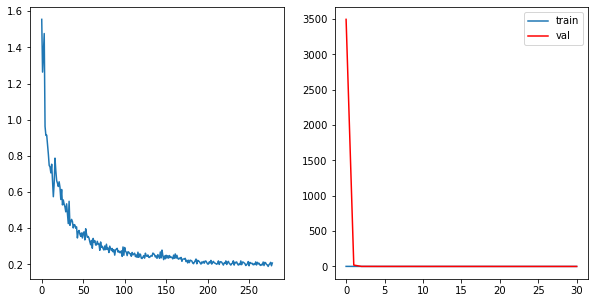

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1999, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1880, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2150, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2066, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.20209980985398515	     Validation Loss:0.2459570842712284	 \ LR:0.0001


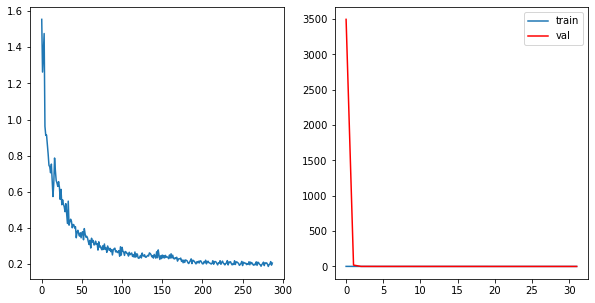

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2057, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2025, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2118, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.2004118967756905	     Validation Loss:0.23901409985232328	 \ LR:0.0001


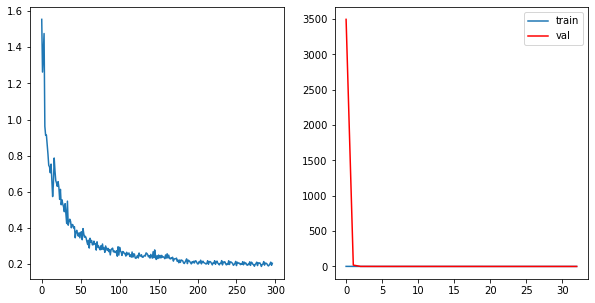

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1851, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2003, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2117, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1888, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.19899259082983214	     Validation Loss:0.24399430514069756	 \ LR:0.0001


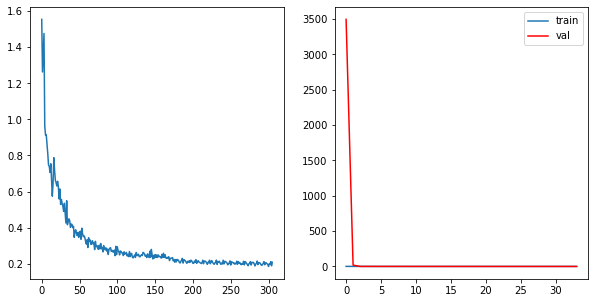

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2051, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2024, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1953, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2000, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2080, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.20152028420707893	     Validation Loss:0.24103390834819827	 \ LR:1e-05


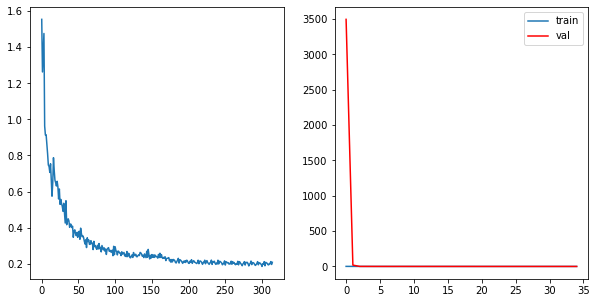

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1879, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1973, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.198806335469841	     Validation Loss:0.2430370591079077	 \ LR:1e-05


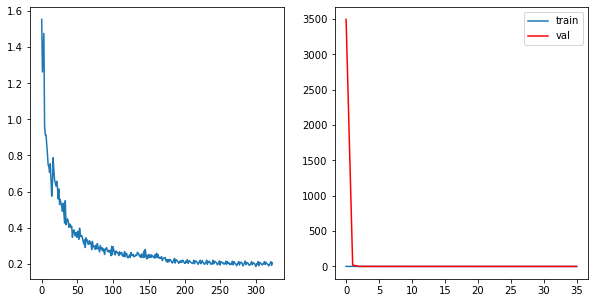

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1996, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2006, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1930, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1904, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1952, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2087, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.19850114379721162	     Validation Loss:0.24470219188949796	 \ LR:1e-05


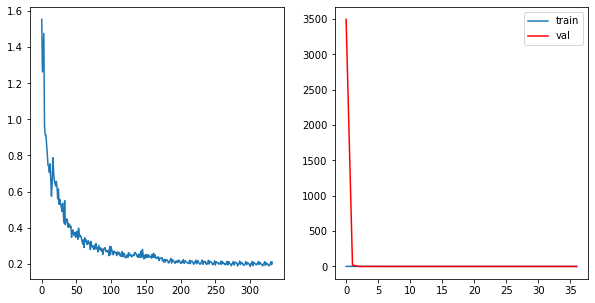

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2048, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1939, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1932, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2125, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.20039223895093553	     Validation Loss:0.2461257441448724	 \ LR:1e-05


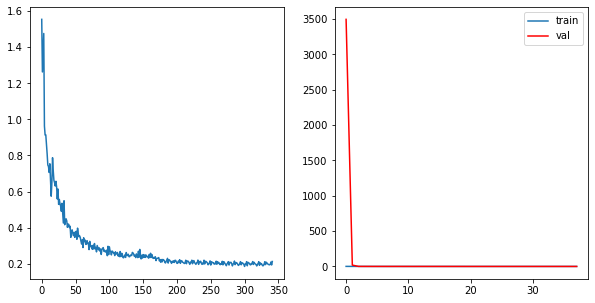

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2108, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.20050234413980444	     Validation Loss:0.24566254018310515	 \ LR:1e-05


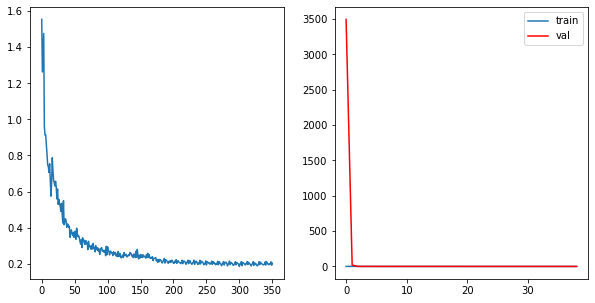

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1973, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2105, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2081, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.20022756380550372	     Validation Loss:0.24707877238665124	 \ LR:1e-05


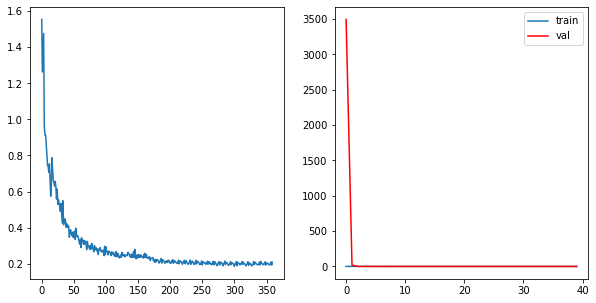

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2105, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2092, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1935, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2019, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.2008646293757461	     Validation Loss:0.24397558924106352	 \ LR:1.0000000000000002e-06


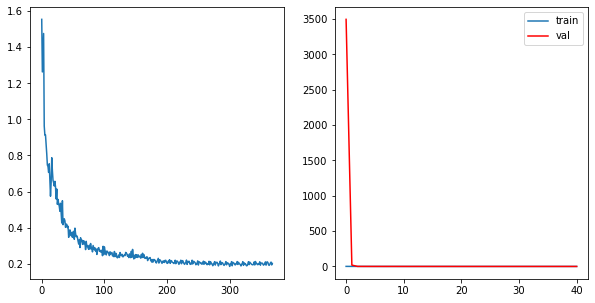

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1957, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1988, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2098, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.20250638478666697	     Validation Loss:0.23611422410920202	 \ LR:1.0000000000000002e-06


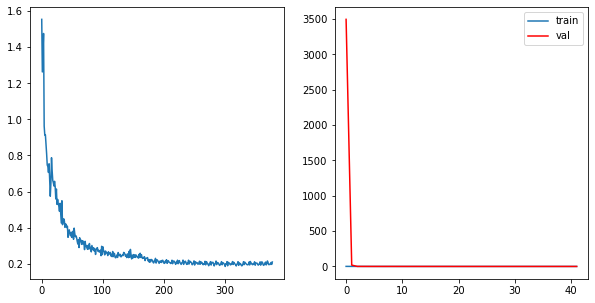

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2046, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2039, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1925, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1944, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2030, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.19920733302223836	     Validation Loss:0.24534354176901596	 \ LR:1.0000000000000002e-06


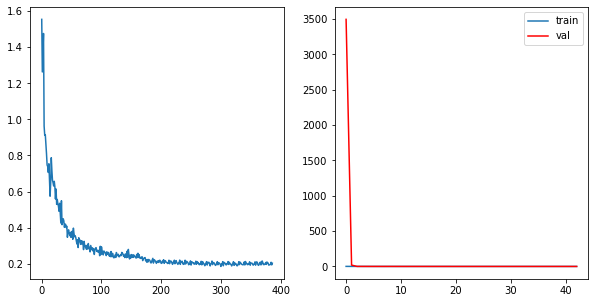

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2083, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1988, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2087, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2061, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.19951490745135467	     Validation Loss:0.2349723540000345	 \ LR:1.0000000000000002e-06


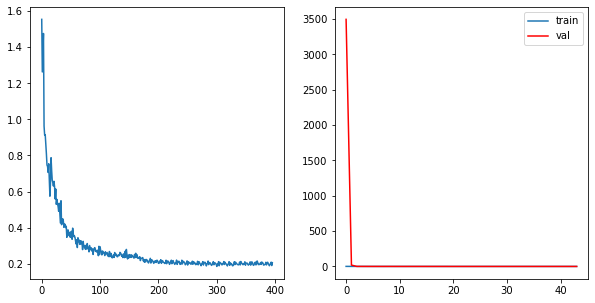

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2065, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2048, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2090, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2044, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.2000588527633993	     Validation Loss:0.24438515284557694	 \ LR:1.0000000000000002e-06


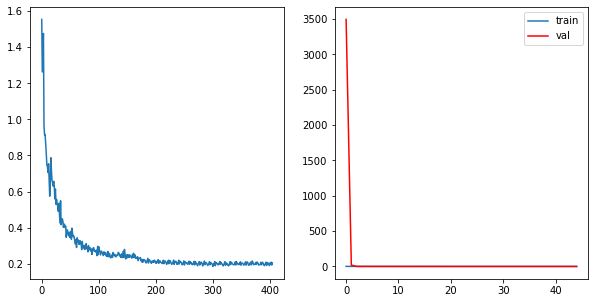

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2072, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1913, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1926, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2074, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.1996362862516956	     Validation Loss:0.23907118290203497	 \ LR:1.0000000000000002e-06


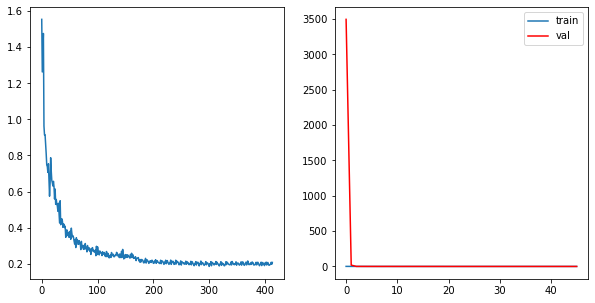

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2056, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1923, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2010, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2078, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2098, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.2011818349769297	     Validation Loss:0.24418913845775633	 \ LR:1.0000000000000002e-06


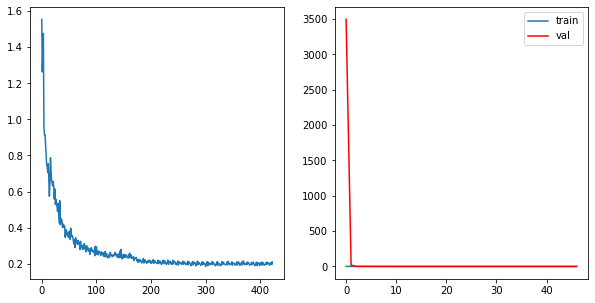

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1996, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1967, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2090, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2043, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.20052116211402013	     Validation Loss:0.23611537367505106	 \ LR:1.0000000000000002e-06


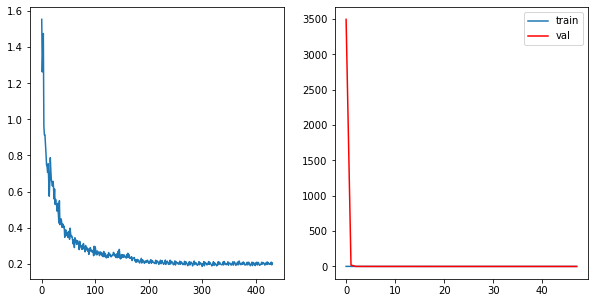

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2109, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2043, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1987, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2002, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2104, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1944, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2071, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.2020493070292056	     Validation Loss:0.2390356321361736	 \ LR:1.0000000000000002e-06


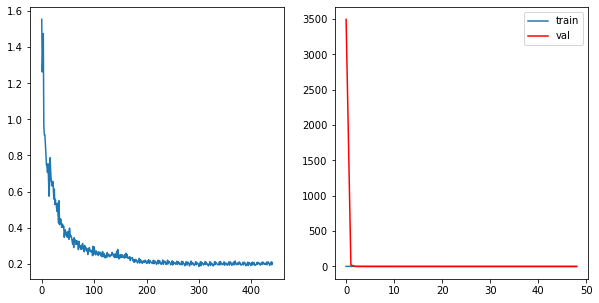

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2125, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2045, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.20027640101400357	     Validation Loss:0.23866864149513511	 \ LR:1.0000000000000002e-07


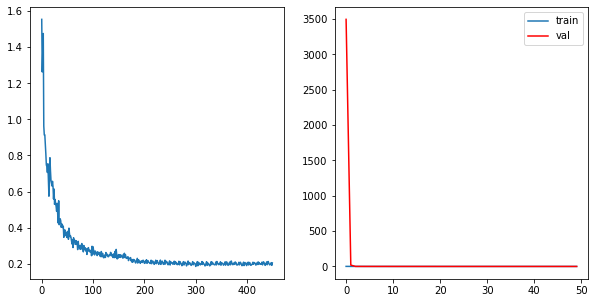

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2058, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2147, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1908, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.20081188362545044	     Validation Loss:0.2422927982720083	 \ LR:1.0000000000000002e-07


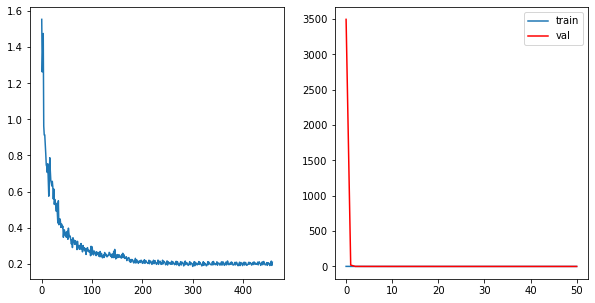

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1959, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2002, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2067, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.20132772169724944	     Validation Loss:0.23907625067164986	 \ LR:1.0000000000000002e-07


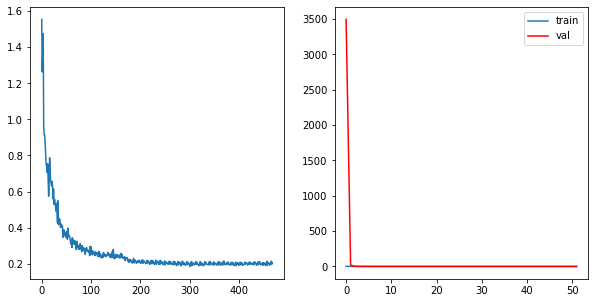

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2106, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1929, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.19983236676121463	     Validation Loss:0.23887902768817026	 \ LR:1.0000000000000002e-07


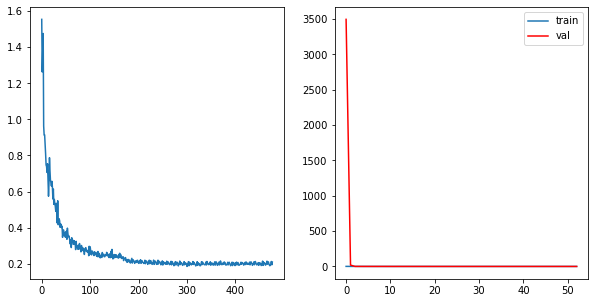

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2108, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1930, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2070, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.2007555238732811	     Validation Loss:0.23852734865414424	 \ LR:1.0000000000000002e-07


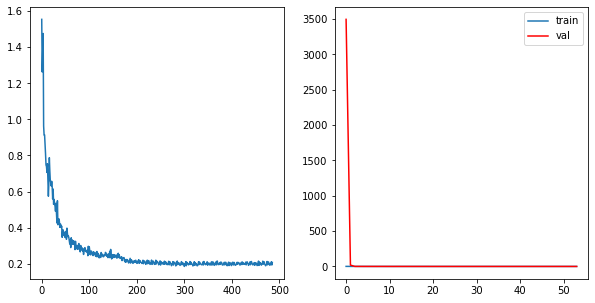

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1977, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2094, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1977, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2117, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.2011020667075151	     Validation Loss:0.2388272282879261	 \ LR:1.0000000000000002e-07


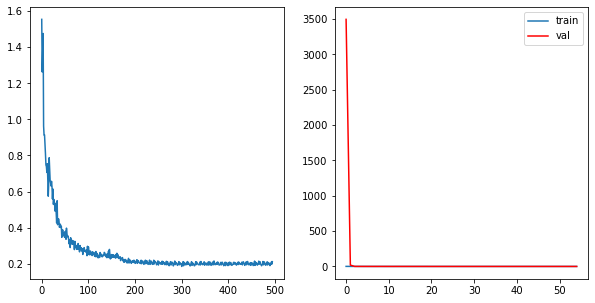

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2072, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1996, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2113, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.20075313137591416	     Validation Loss:0.24389789964558475	 \ LR:1.0000000000000004e-08


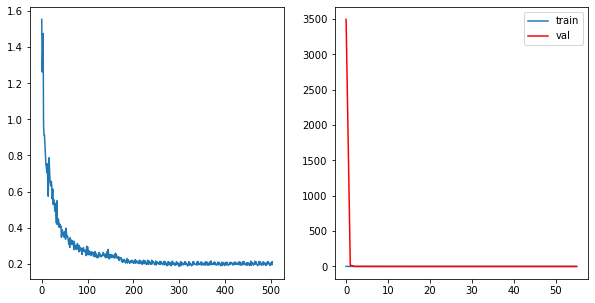

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2076, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2024, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2057, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1972, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2099, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.20167869023822593	     Validation Loss:0.2462842369942008	 \ LR:1.0000000000000004e-08


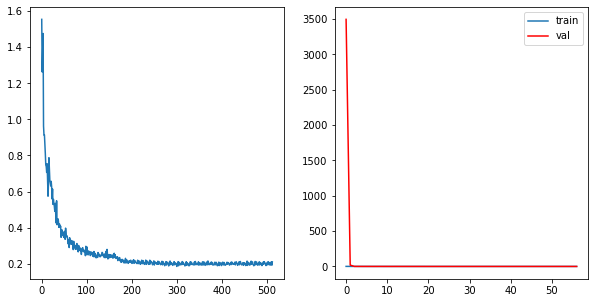

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1957, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1875, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2125, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1932, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2054, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 57	 \Training Loss: 0.19940645262654189	     Validation Loss:0.2420259669701829	 \ LR:1.0000000000000004e-08


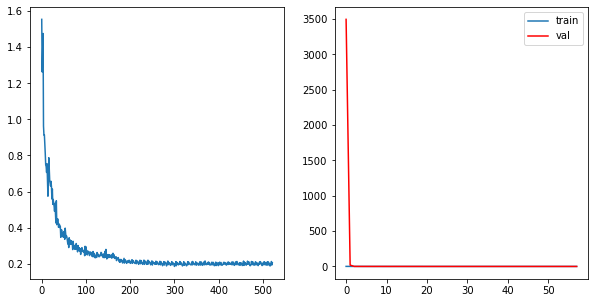

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2019, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1927, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2055, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1934, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2098, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 58	 \Training Loss: 0.20163720462638363	     Validation Loss:0.2453032174619766	 \ LR:1.0000000000000004e-08


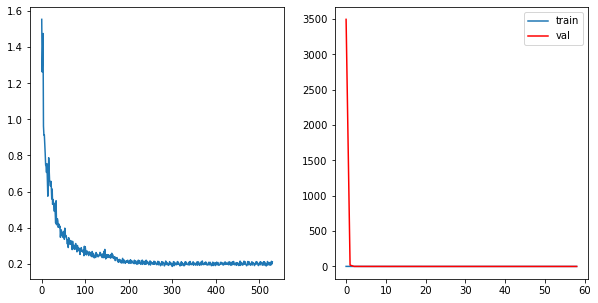

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1925, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2101, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1912, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2068, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 59	 \Training Loss: 0.20030338807696735	     Validation Loss:0.23827415533619867	 \ LR:1.0000000000000004e-08


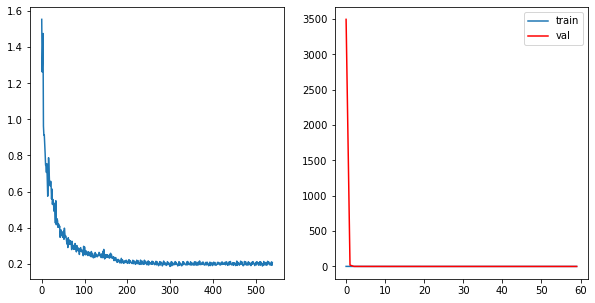

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2021, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2005, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2078, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 60	 \Training Loss: 0.20071494951106697	     Validation Loss:0.2460844036523797	 \ LR:1.0000000000000004e-08


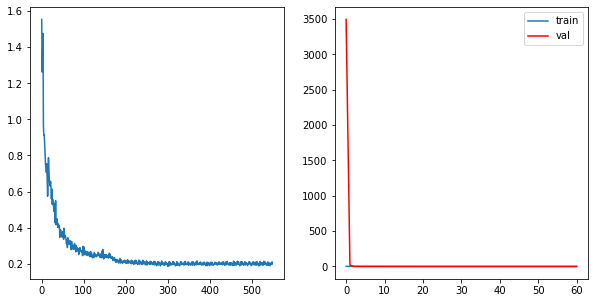

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1959, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1906, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1945, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2056, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 61	 \Training Loss: 0.19829862775734744	     Validation Loss:0.24065870635915473	 \ LR:1.0000000000000004e-08


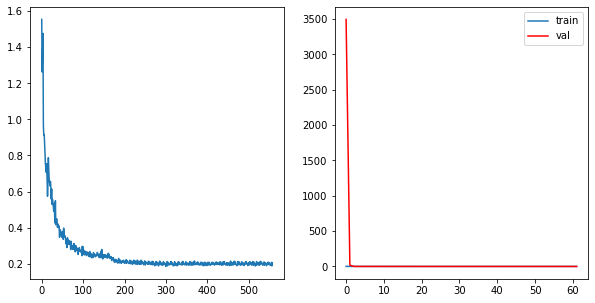

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1892, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1956, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2073, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 62	 \Training Loss: 0.19996619519687775	     Validation Loss:0.23898587661317006	 \ LR:1.0000000000000004e-08


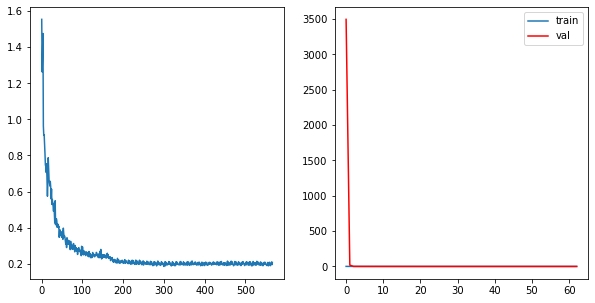

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1880, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2021, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2033, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 63	 \Training Loss: 0.19870733660072276	     Validation Loss:0.23568727595314218	 \ LR:1.0000000000000004e-08


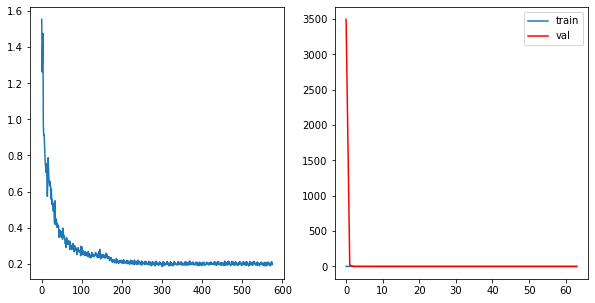

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1912, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1953, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 64	 \Training Loss: 0.1994237664819603	     Validation Loss:0.24338511253757888	 \ LR:1.0000000000000004e-08


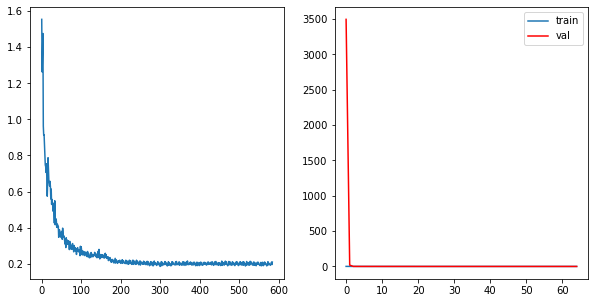

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2017, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1850, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1953, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 65	 \Training Loss: 0.1999527606813131	     Validation Loss:0.23872911011230866	 \ LR:1.0000000000000004e-08


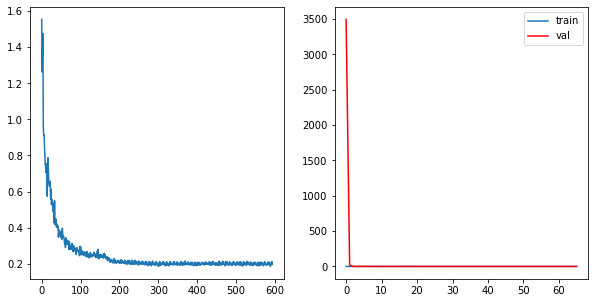

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2041, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 66	 \Training Loss: 0.200482380742539	     Validation Loss:0.24173425695782857	 \ LR:1.0000000000000004e-08


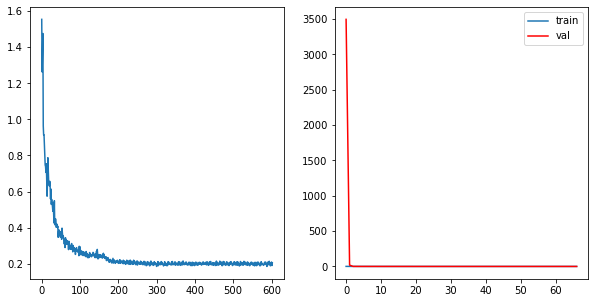

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2048, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1915, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2002, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2129, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1952, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2140, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 67	 \Training Loss: 0.20106787686905775	     Validation Loss:0.2477053884961026	 \ LR:1.0000000000000004e-08


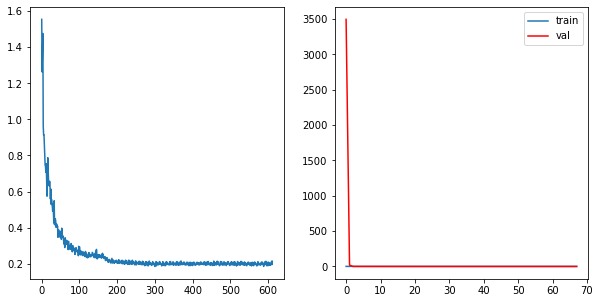

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1940, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1846, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2057, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 68	 \Training Loss: 0.1996754615657156	     Validation Loss:0.23814480419700113	 \ LR:1.0000000000000004e-08


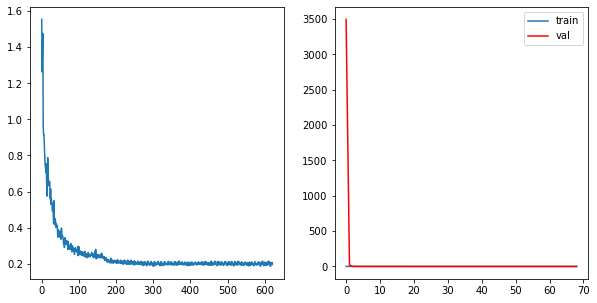

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2000, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1888, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2060, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 69	 \Training Loss: 0.1985229251847459	     Validation Loss:0.24419341865825941	 \ LR:1.0000000000000004e-08


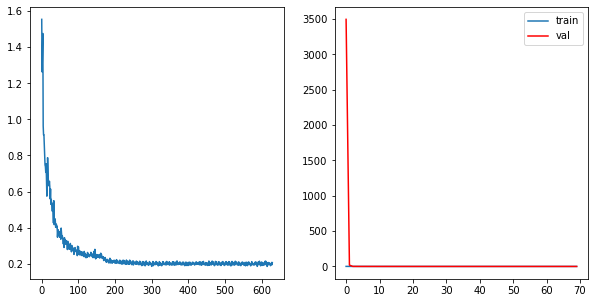

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2070, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1940, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1950, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2159, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1927, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 70	 \Training Loss: 0.20063930444269334	     Validation Loss:0.24255410314310985	 \ LR:1.0000000000000004e-08


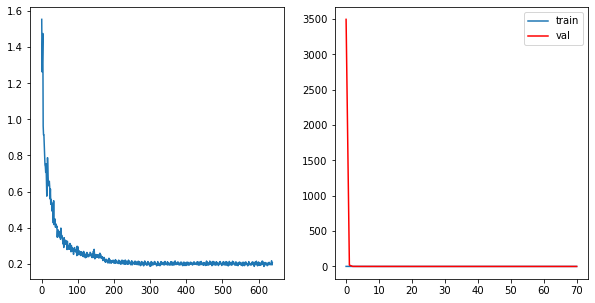

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2054, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2030, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1926, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1871, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1952, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2072, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2098, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 71	 \Training Loss: 0.1990511150359246	     Validation Loss:0.241992408460426	 \ LR:1.0000000000000004e-08


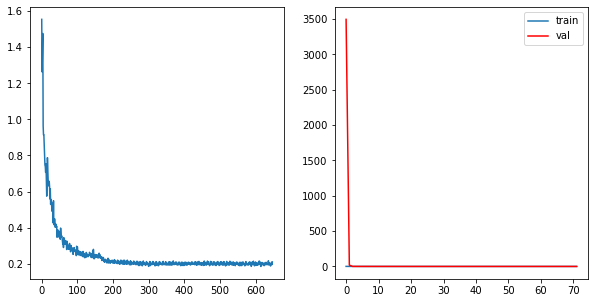

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1993, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1887, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1999, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2128, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1953, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2054, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 72	 \Training Loss: 0.1997757585406466	     Validation Loss:0.23486801362426504	 \ LR:1.0000000000000004e-08


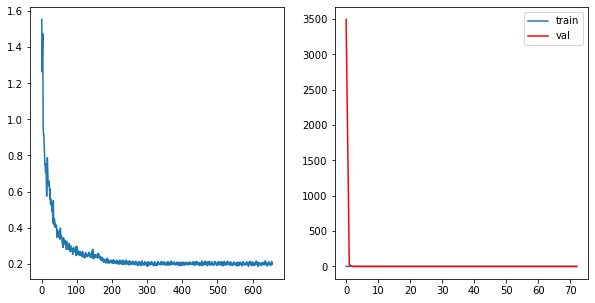

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2037, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1896, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1999, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2094, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 73	 \Training Loss: 0.20141080597259786	     Validation Loss:0.24689610349061938	 \ LR:1.0000000000000004e-08


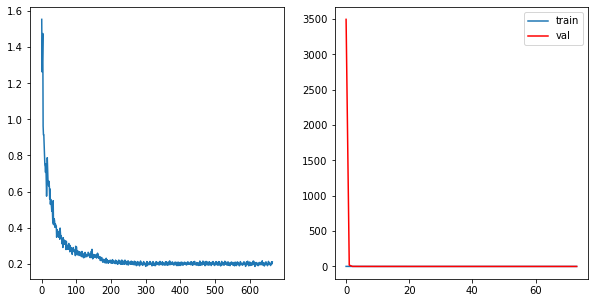

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2010, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1924, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2090, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2080, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 74	 \Training Loss: 0.2011741552584721	     Validation Loss:0.2317137159205387	 \ LR:1.0000000000000004e-08


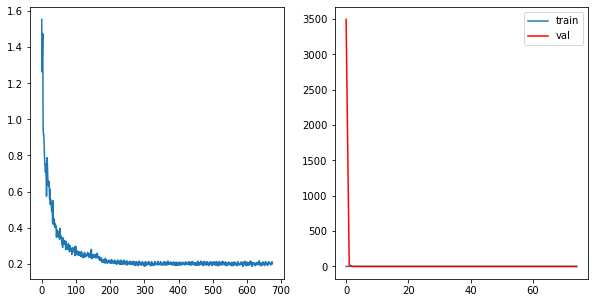

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2113, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1929, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 75	 \Training Loss: 0.19962433738489327	     Validation Loss:0.24338414202679018	 \ LR:1.0000000000000004e-08


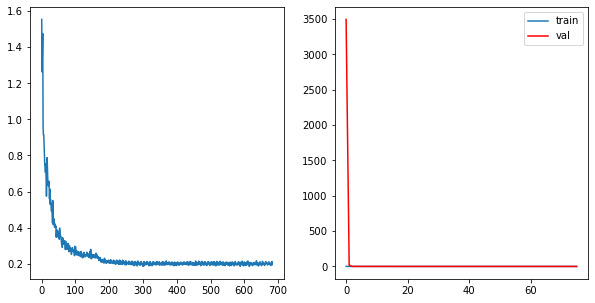

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2057, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2083, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2103, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 76	 \Training Loss: 0.20057382104588417	     Validation Loss:0.23592385888036635	 \ LR:1.0000000000000004e-08


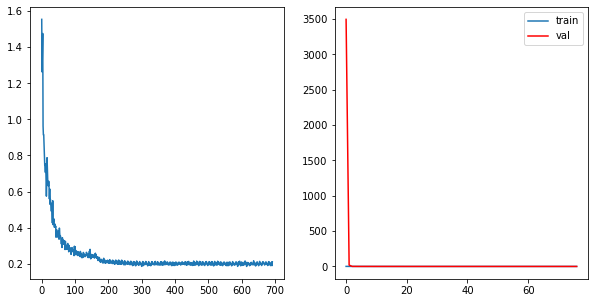

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2039, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 77	 \Training Loss: 0.20233149506796289	     Validation Loss:0.2434561719127261	 \ LR:1.0000000000000004e-08


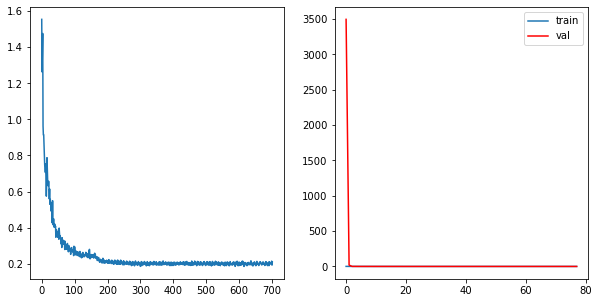

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2017, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2051, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1987, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1925, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2049, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 78	 \Training Loss: 0.2007524106872922	     Validation Loss:0.24313122012927746	 \ LR:1.0000000000000004e-08


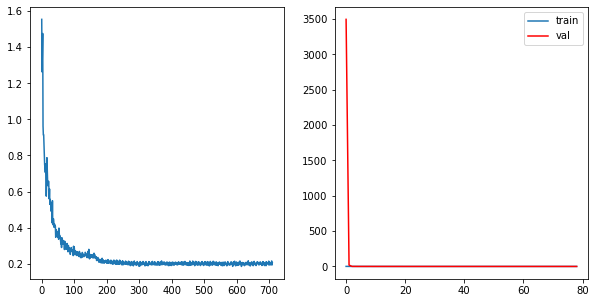

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2037, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2122, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2072, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 79	 \Training Loss: 0.20098437582351514	     Validation Loss:0.24346037598526574	 \ LR:1.0000000000000004e-08


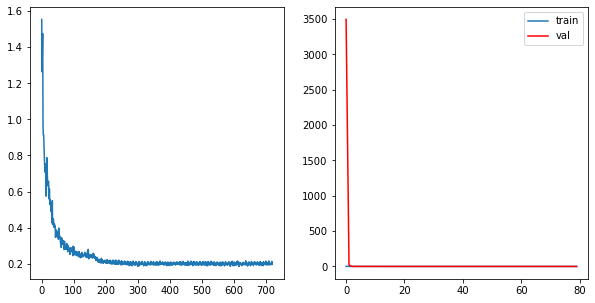

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2078, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 80	 \Training Loss: 0.20001196765054796	     Validation Loss:0.23759835459154602	 \ LR:1.0000000000000004e-08


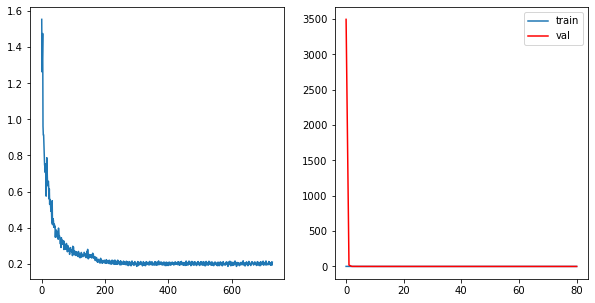

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2068, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1939, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1993, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2047, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "skip_connection with aug "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/skip_connection_aug' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(1.4620, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9000, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7226, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5865, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5515, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.8602913511619232	     Validation Loss:3585.1430556536197	 \ LR:0.01


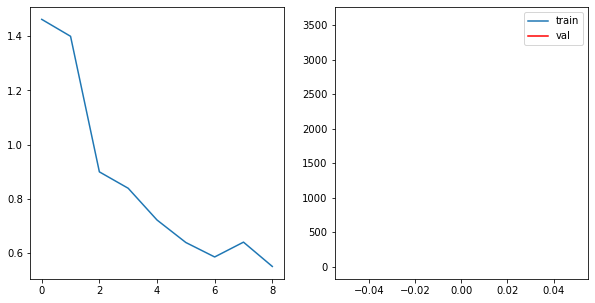

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5750, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5123, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5518, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4583, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.5573721082653043	     Validation Loss:16.721478666162074	 \ LR:0.01


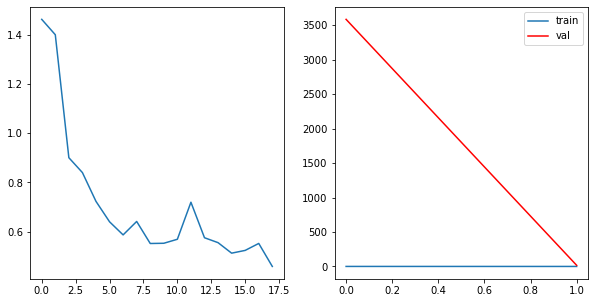

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4072, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4065, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3428, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.4024838378195801	     Validation Loss:3.4202955995898807	 \ LR:0.01


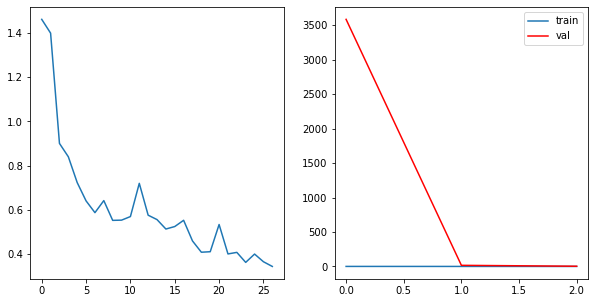

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3282, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2777, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.33018795792703814	     Validation Loss:3.6328559703868657	 \ LR:0.01


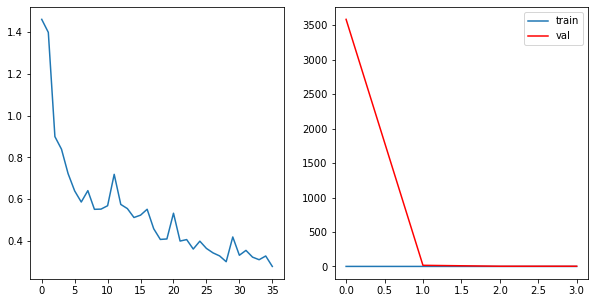

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2724, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2917, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3742, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2818, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2819, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3124, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2735, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.29665773818480123	     Validation Loss:3.2340214179818845	 \ LR:0.01


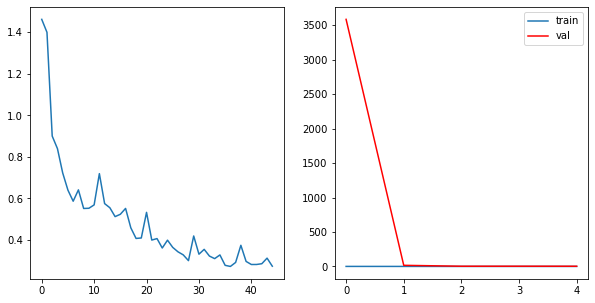

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2707, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2626, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2560, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.28406768621395945	     Validation Loss:0.8379734771306945	 \ LR:0.01


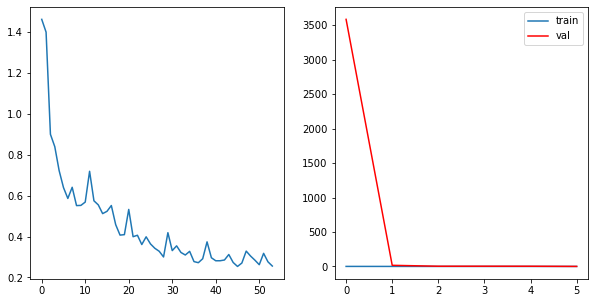

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2714, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3059, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2392, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.2589773306319469	     Validation Loss:0.6291382058101429	 \ LR:0.01


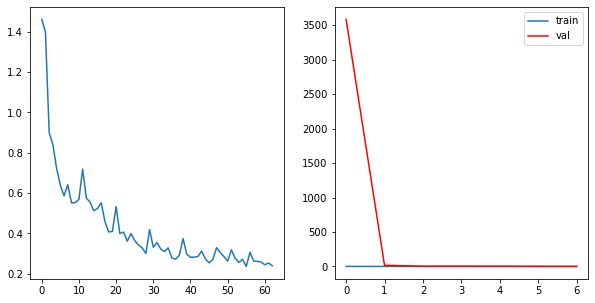

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.24409767670674276	     Validation Loss:0.5450459921308917	 \ LR:0.01


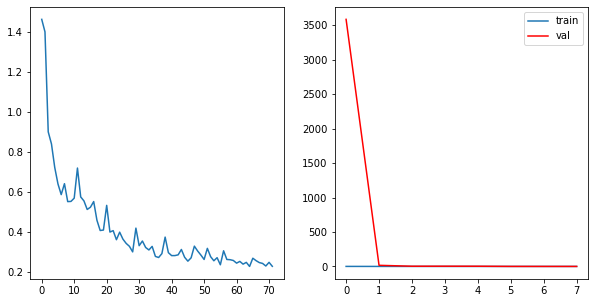

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2660, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2600, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.24356209768874898	     Validation Loss:0.38326039353222524	 \ LR:0.01


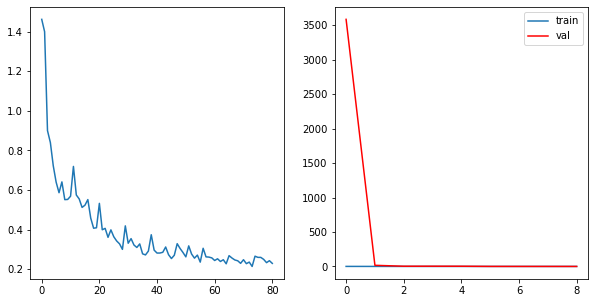

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2163, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.242064806371	     Validation Loss:0.46146749561068184	 \ LR:0.01


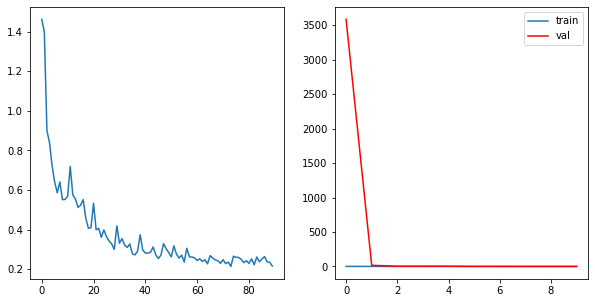

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2999, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2334, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2715, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2735, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2023, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.2534550220962128	     Validation Loss:0.42287298810555035	 \ LR:0.01


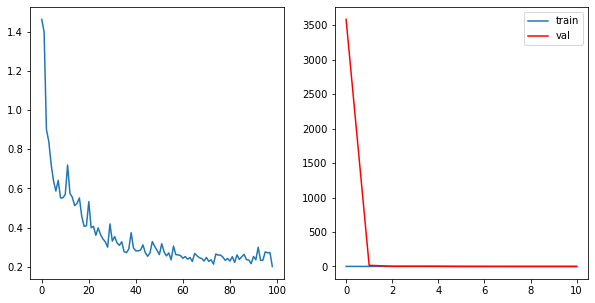

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2308, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2310, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2225, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.25589766067822123	     Validation Loss:0.5019040573319844	 \ LR:0.01


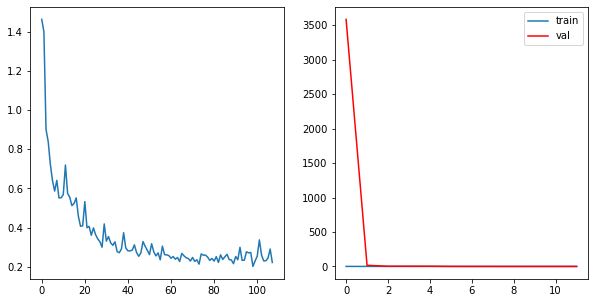

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2132, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2183, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2750, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2216, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2178, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2260, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2113, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.23393424051666833	     Validation Loss:0.44835852144394056	 \ LR:0.01


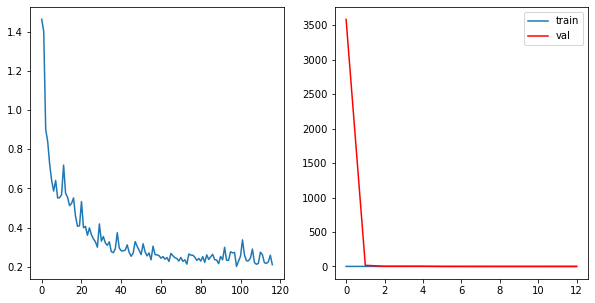

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2058, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1952, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.22136396272813197	     Validation Loss:0.33969036362847427	 \ LR:0.01


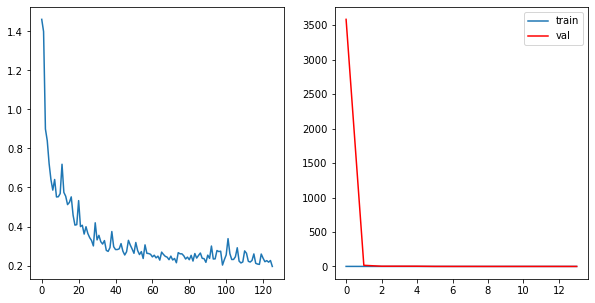

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2071, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2101, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2131, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.21402148607267962	     Validation Loss:0.47929949247044323	 \ LR:0.01


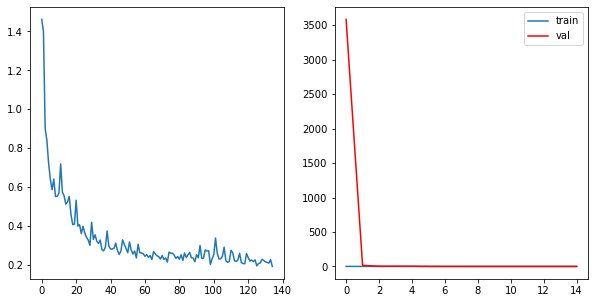

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2048, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2187, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.21086432507987132	     Validation Loss:0.39219155034715975	 \ LR:0.01


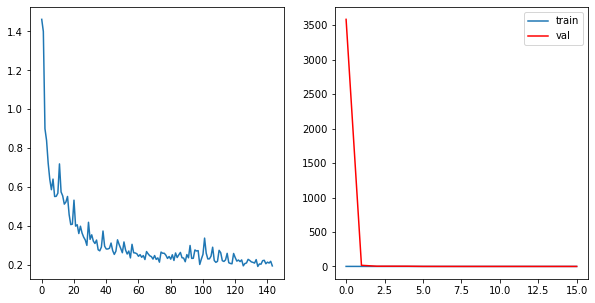

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2110, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2097, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2092, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2157, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2091, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1824, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.21101857527557513	     Validation Loss:0.5177655859936351	 \ LR:0.01


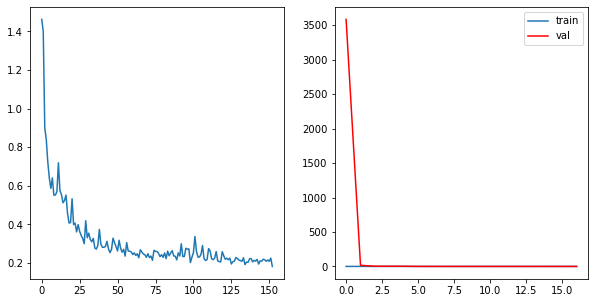

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2116, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2242, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1971, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.2176340577728813	     Validation Loss:0.2598727583440684	 \ LR:0.01


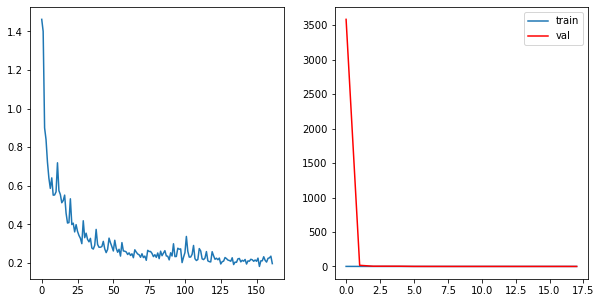

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2087, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2005, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2153, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1907, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.21242778018024283	     Validation Loss:0.40302693964042285	 \ LR:0.01


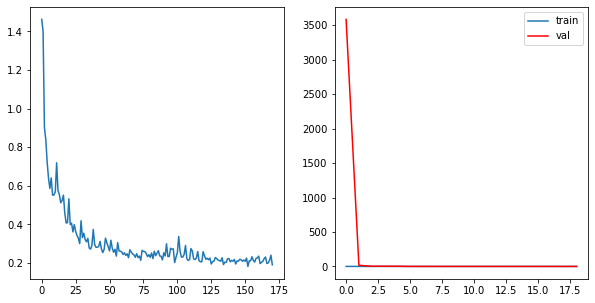

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1987, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2001, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2055, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2232, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1870, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.2128859830739589	     Validation Loss:0.24171974042756864	 \ LR:0.01


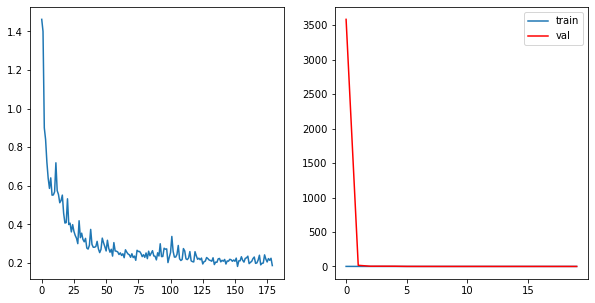

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1944, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1912, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1848, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2223, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1828, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.201798136004024	     Validation Loss:0.2094558825298868	 \ LR:0.01


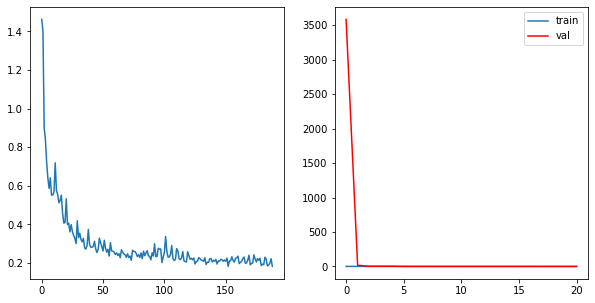

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1792, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2147, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1879, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1967, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2017, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1781, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.19622576742777376	     Validation Loss:0.23422814655792915	 \ LR:0.01


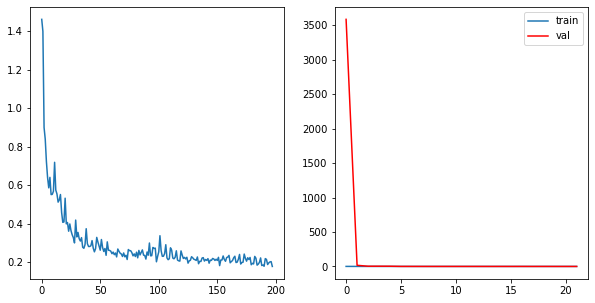

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1887, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1775, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.19647651340275096	     Validation Loss:0.35487069865211646	 \ LR:0.01


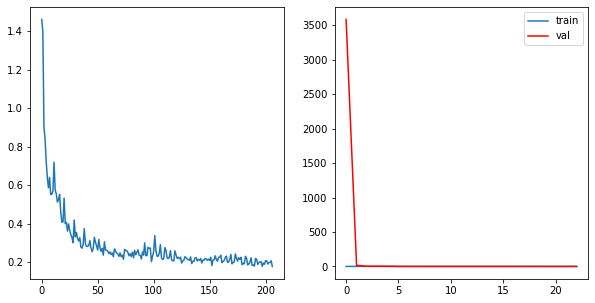

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1878, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1832, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2067, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2065, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1880, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1950, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1739, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.19342158797749856	     Validation Loss:0.30815070482134876	 \ LR:0.01


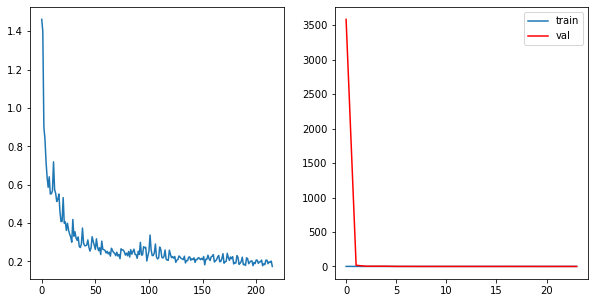

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1872, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1821, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1981, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1660, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.19063661213869537	     Validation Loss:0.2100952432256542	 \ LR:0.01


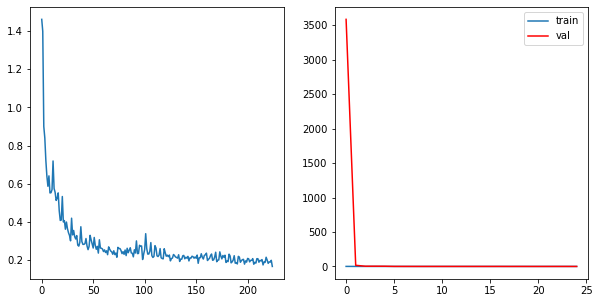

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1733, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1743, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1956, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1761, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1866, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1824, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.18219088608552605	     Validation Loss:0.24490013448247958	 \ LR:0.01


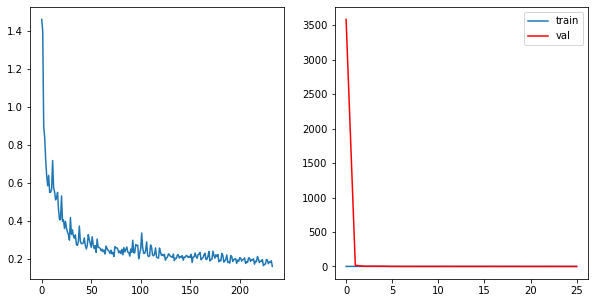

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1953, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1860, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1668, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1861, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.17711735294096842	     Validation Loss:0.2576700369156117	 \ LR:0.001


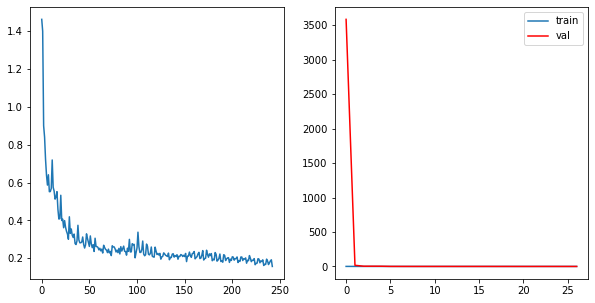

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1737, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1739, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1707, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1637, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.16874549182745455	     Validation Loss:0.1930835851999941	 \ LR:0.001


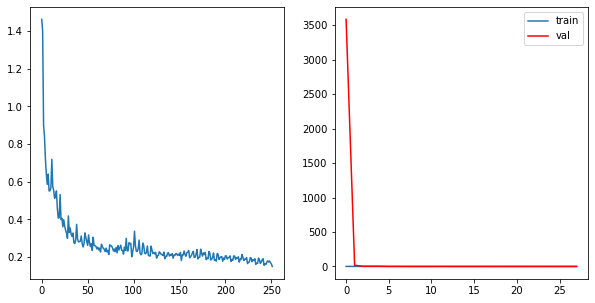

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1717, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1696, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1647, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1504, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.16346842549388096	     Validation Loss:0.18807082371162445	 \ LR:0.001


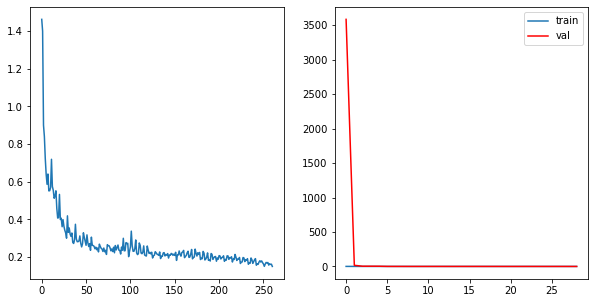

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1698, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1618, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.16210642163261452	     Validation Loss:0.18447987101860017	 \ LR:0.001


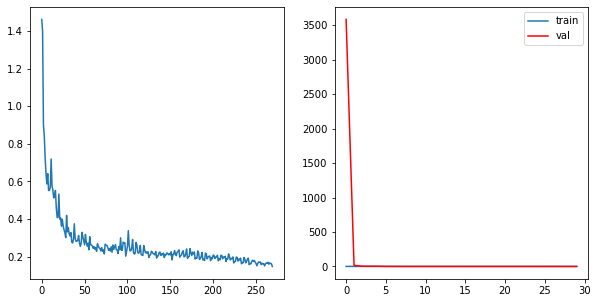

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1616, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1600, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1473, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.15971815800388275	     Validation Loss:0.18280252782875986	 \ LR:0.001


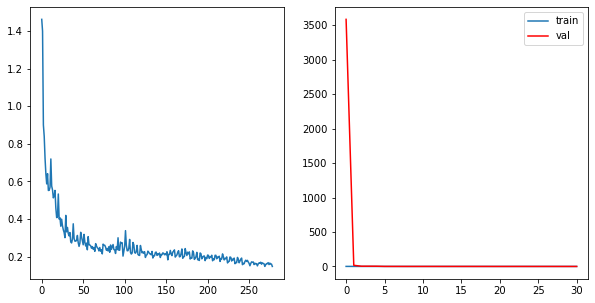

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.15894466054838635	     Validation Loss:0.18403704146987654	 \ LR:0.001


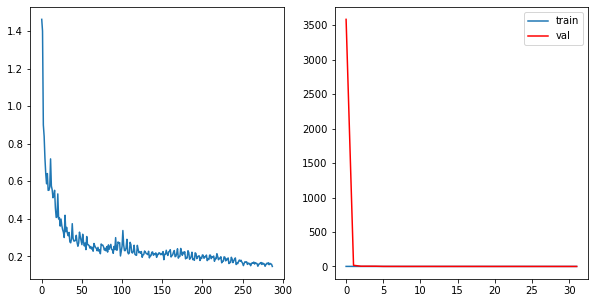

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1655, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.15794296766585927	     Validation Loss:0.18342148797868738	 \ LR:0.001


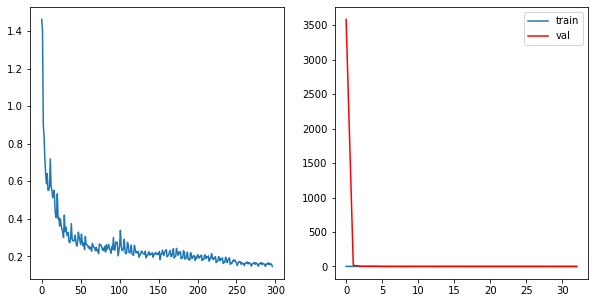

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1616, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1453, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.15725520957663855	     Validation Loss:0.18345653124726968	 \ LR:0.001


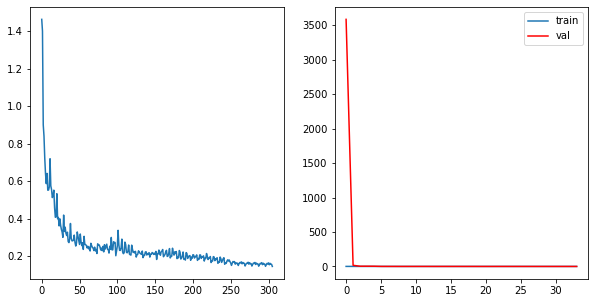

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1605, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1611, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1448, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.15647034315792122	     Validation Loss:0.18388927232168648	 \ LR:0.001


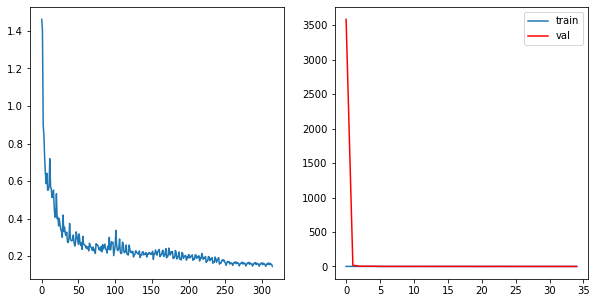

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1604, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1442, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.15582217455609781	     Validation Loss:0.1833959538543849	 \ LR:0.001


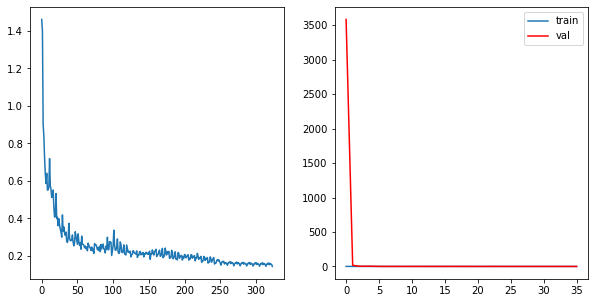

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.1551395441352121	     Validation Loss:0.1832858465619501	 \ LR:0.0001


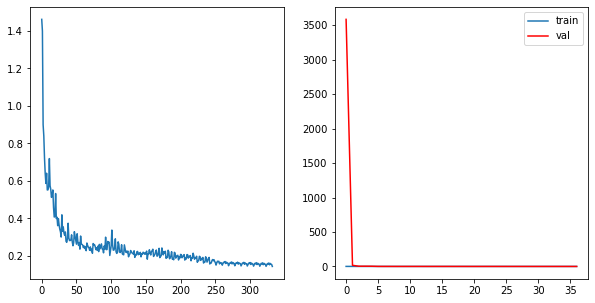

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1434, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.15428478305738758	     Validation Loss:0.1828966047757676	 \ LR:0.0001


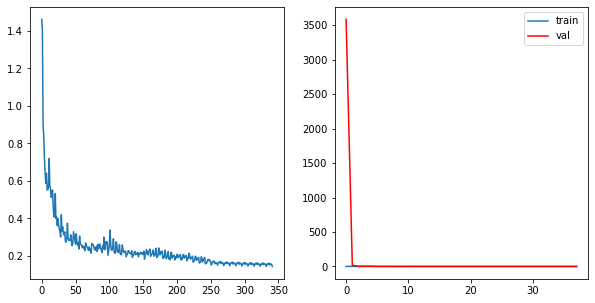

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1586, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1582, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1433, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.15420034750777037	     Validation Loss:0.18278611747698736	 \ LR:0.0001


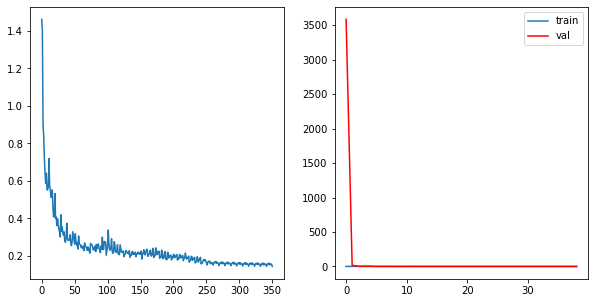

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1432, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.1541099929038447	     Validation Loss:0.1827324974007498	 \ LR:0.0001


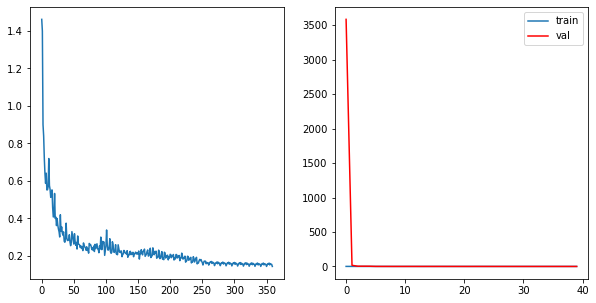

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1611, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.15402886288475567	     Validation Loss:0.18268354399737877	 \ LR:0.0001


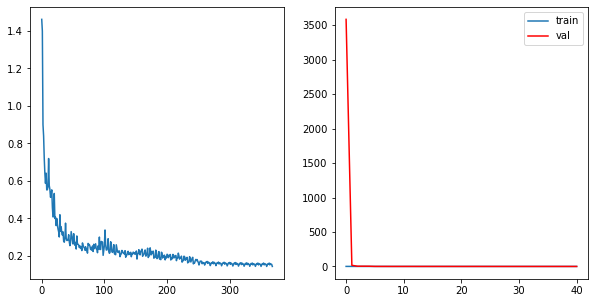

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1502, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1553, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1611, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1430, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.15395235399754117	     Validation Loss:0.18264283127611744	 \ LR:0.0001


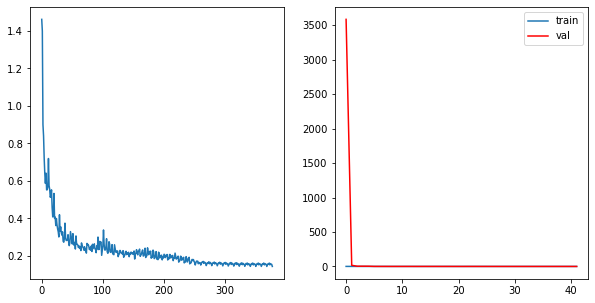

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1553, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1582, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1430, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.15388062181235695	     Validation Loss:0.18261887486269934	 \ LR:0.0001


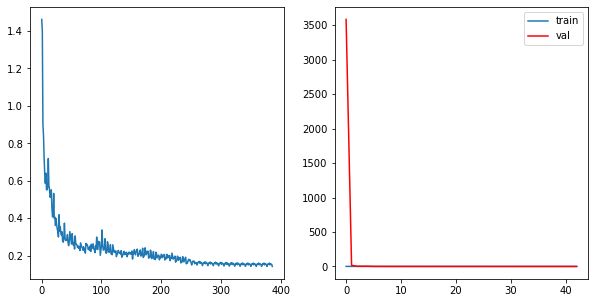

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1429, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.15381226534927742	     Validation Loss:0.18260791220874376	 \ LR:0.0001


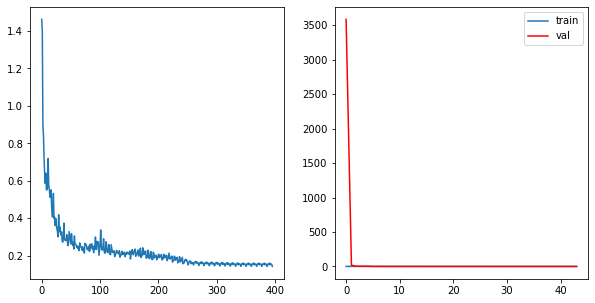

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.15374449812482463	     Validation Loss:0.18260153903286505	 \ LR:0.0001


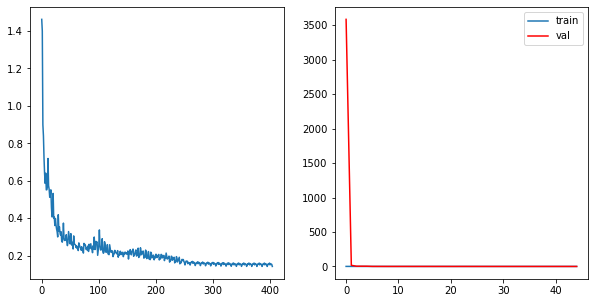

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1580, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.1536758027270452	     Validation Loss:0.18259289182948257	 \ LR:0.0001


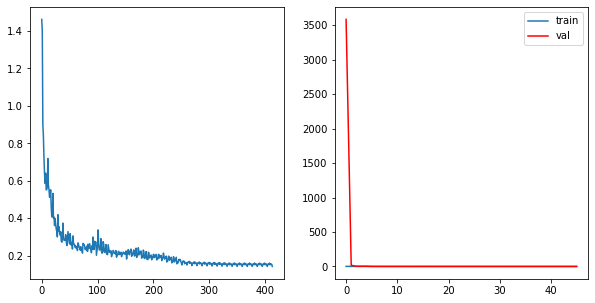

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.15360585008953911	     Validation Loss:0.1825808966736171	 \ LR:0.0001


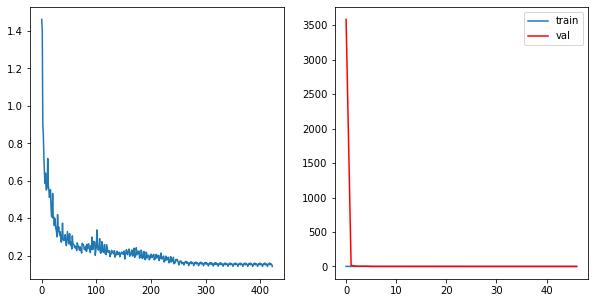

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1578, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.1535350051854362	     Validation Loss:0.18256227339854458	 \ LR:0.0001


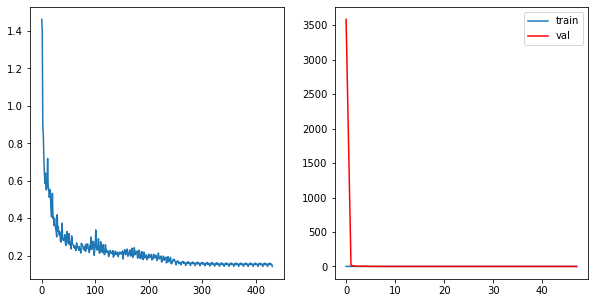

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1605, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.1534634063966437	     Validation Loss:0.1825421872436638	 \ LR:0.0001


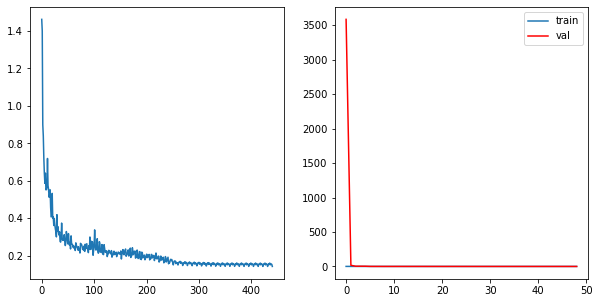

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1604, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.15339150060289863	     Validation Loss:0.18252452401260114	 \ LR:0.0001


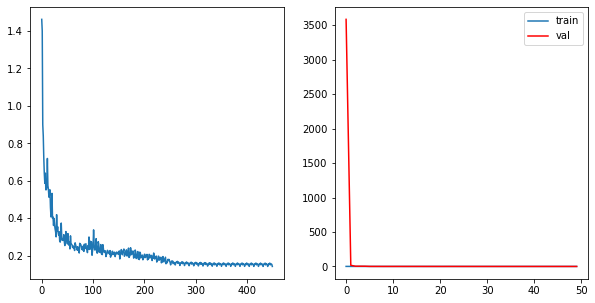

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.1533188094443142	     Validation Loss:0.1825090896221846	 \ LR:0.0001


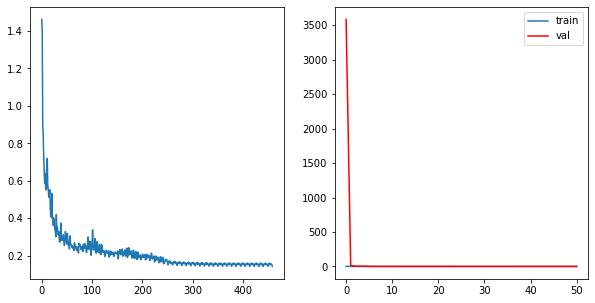

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.1532455771369752	     Validation Loss:0.18249307021681935	 \ LR:0.0001


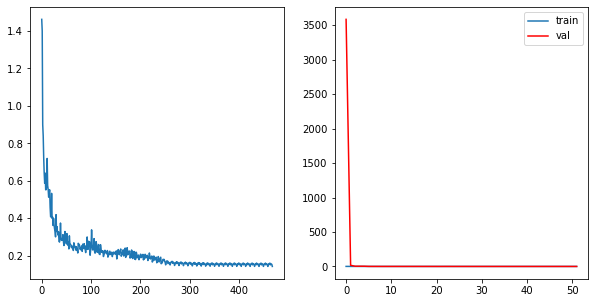

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1506, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.15317170087949994	     Validation Loss:0.18247477513393803	 \ LR:0.0001


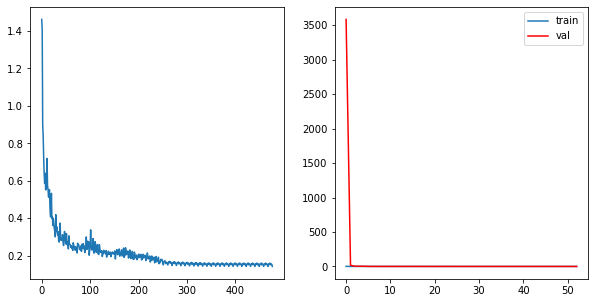

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.15309734377912043	     Validation Loss:0.18245521330053568	 \ LR:0.0001


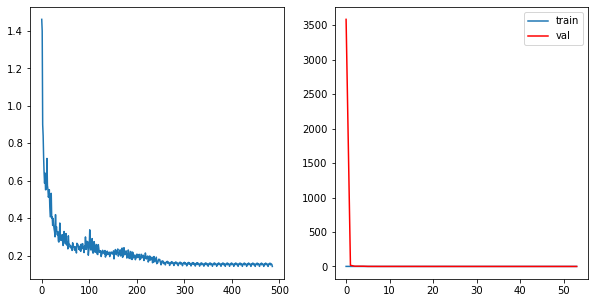

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1600, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1422, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.15302247185323054	     Validation Loss:0.18244700414204365	 \ LR:0.0001


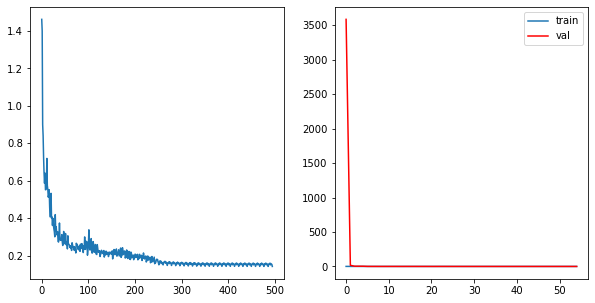

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.15294333692927062	     Validation Loss:0.18243210451950184	 \ LR:0.0001


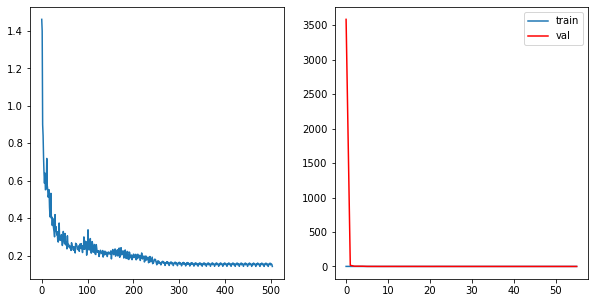

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.1528645723589935	     Validation Loss:0.18241549486295439	 \ LR:0.0001


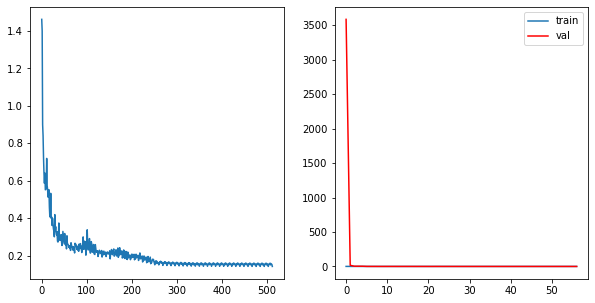

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1420, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 57	 \Training Loss: 0.15278552487895322	     Validation Loss:0.18239316994120078	 \ LR:0.0001


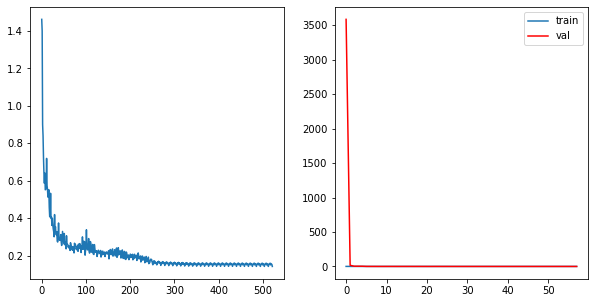

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1502, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1419, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 58	 \Training Loss: 0.1527083621512532	     Validation Loss:0.18237095193059538	 \ LR:0.0001


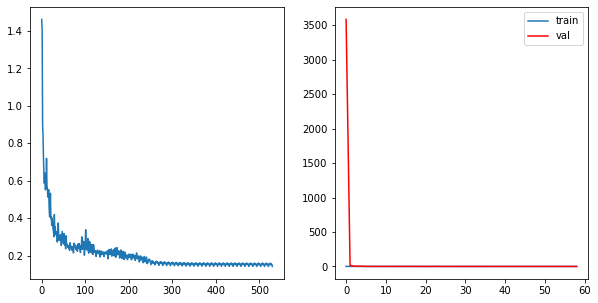

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1419, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 59	 \Training Loss: 0.15263089270027863	     Validation Loss:0.1823503349565387	 \ LR:0.0001


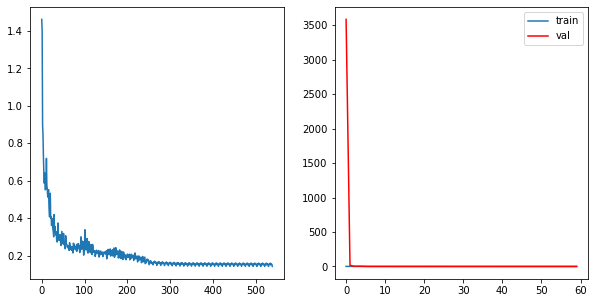

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1418, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 60	 \Training Loss: 0.15255287515606722	     Validation Loss:0.1823263355783189	 \ LR:0.0001


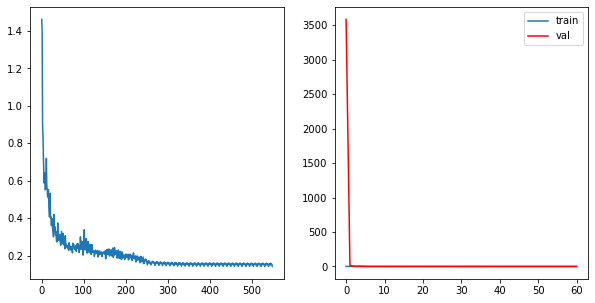

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1417, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 61	 \Training Loss: 0.15247416564852015	     Validation Loss:0.18230331090422927	 \ LR:0.0001


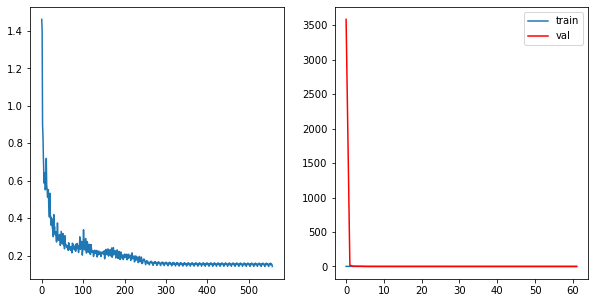

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1592, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1417, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 62	 \Training Loss: 0.1523948922619679	     Validation Loss:0.18227926217652413	 \ LR:0.0001


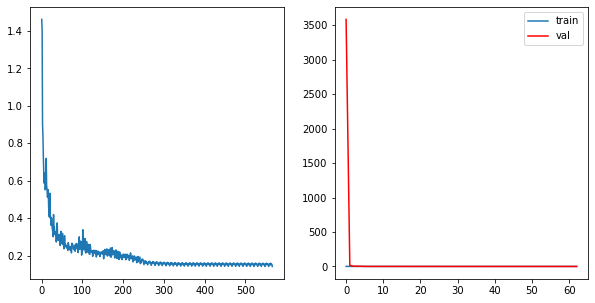

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 63	 \Training Loss: 0.15231510415490124	     Validation Loss:0.18225524019542025	 \ LR:0.0001


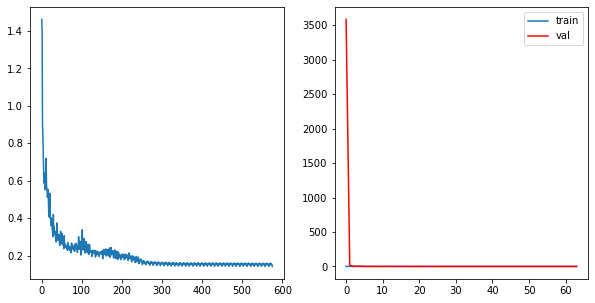

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1485, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1415, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 64	 \Training Loss: 0.15223462851478456	     Validation Loss:0.18223433144184953	 \ LR:0.0001


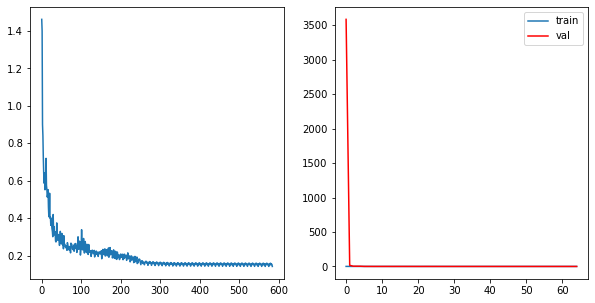

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1414, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 65	 \Training Loss: 0.15215355972852146	     Validation Loss:0.18221574394799397	 \ LR:0.0001


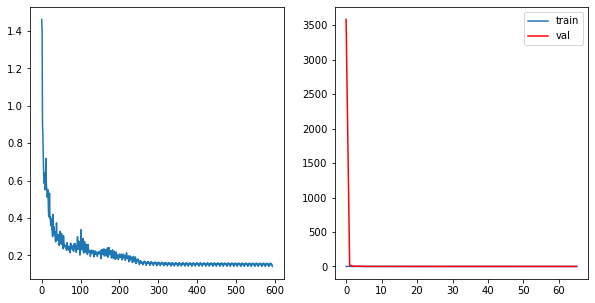

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1414, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 66	 \Training Loss: 0.1520718621710907	     Validation Loss:0.1821938817103134	 \ LR:0.0001


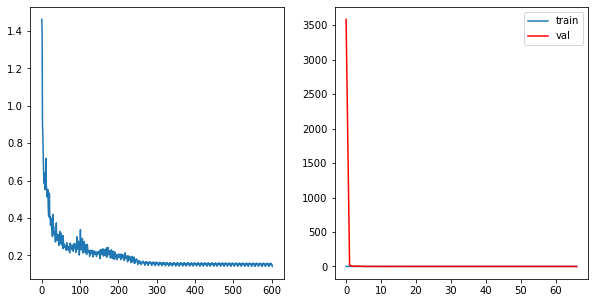

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1587, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "skip_connection with attention with upsample "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/skip_connection_attention_upsample' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(1.3391, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6633, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6143, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.8162819902440216	     Validation Loss:10962.062515096632	 \ LR:0.01


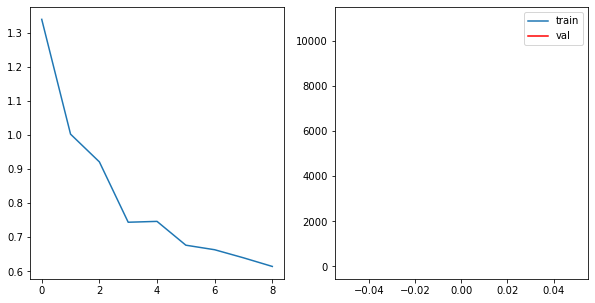

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7050, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6321, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6739, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.6263477025418093	     Validation Loss:60.62041362848603	 \ LR:0.01


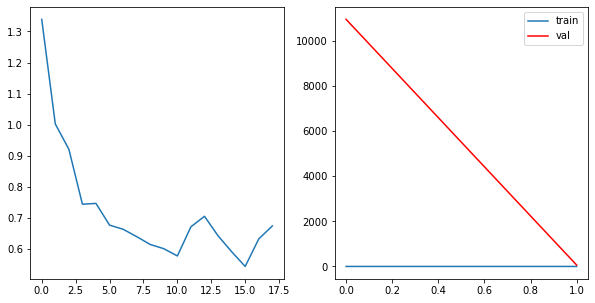

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6519, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5938, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4729, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5013, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5451, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.5581760697330262	     Validation Loss:4.386455227214694	 \ LR:0.01


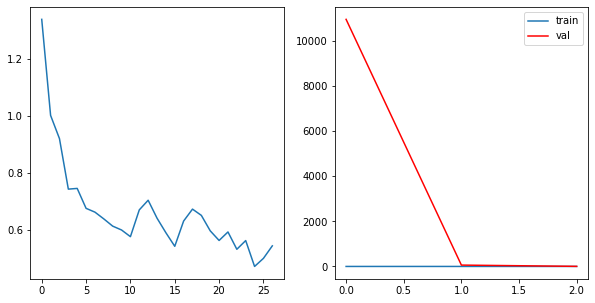

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4182, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4383, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4720, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.4671350020941331	     Validation Loss:1.5987717365481462	 \ LR:0.01


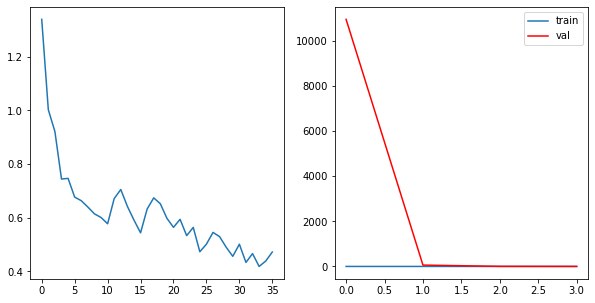

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4391, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3950, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3909, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4352, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.4224599857594622	     Validation Loss:1.0769657400522352	 \ LR:0.01


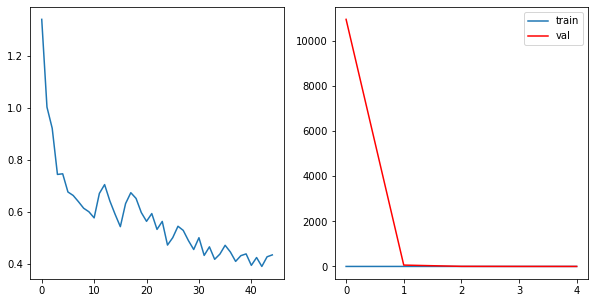

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3872, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4115, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.3954848766459268	     Validation Loss:0.7207439602165597	 \ LR:0.01


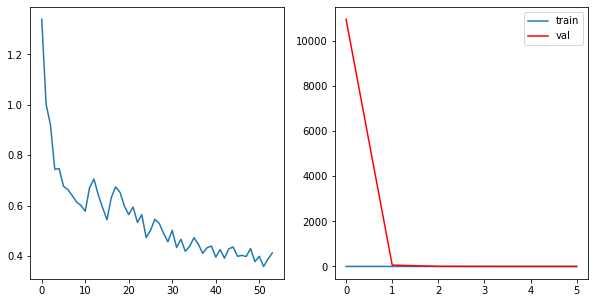

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3877, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3763, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3632, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3748, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.36459487314491135	     Validation Loss:0.9575195731557158	 \ LR:0.01


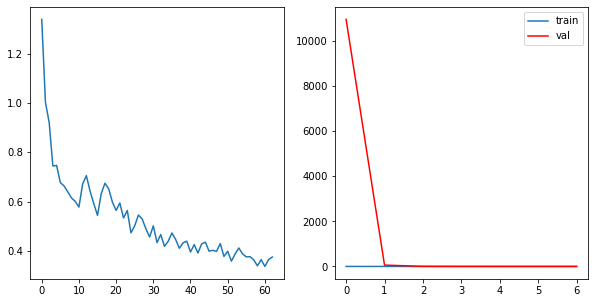

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3578, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3132, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3499, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.3386029226310145	     Validation Loss:1.2638596967335387	 \ LR:0.01


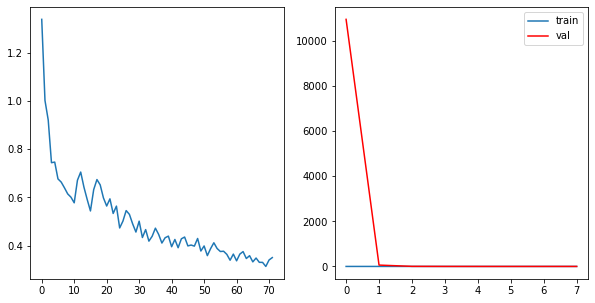

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3188, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2867, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3174, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3392, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.31866884479732605	     Validation Loss:1.510915176293907	 \ LR:0.01


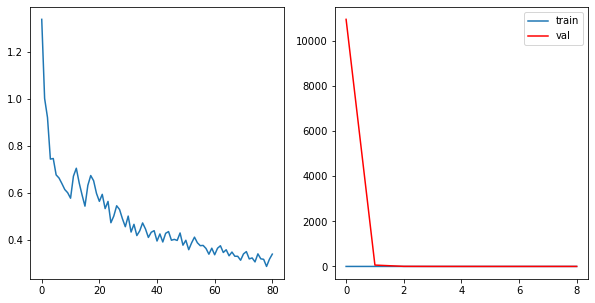

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3161, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3003, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2916, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3283, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.30821831474327577	     Validation Loss:0.8403290549681938	 \ LR:0.01


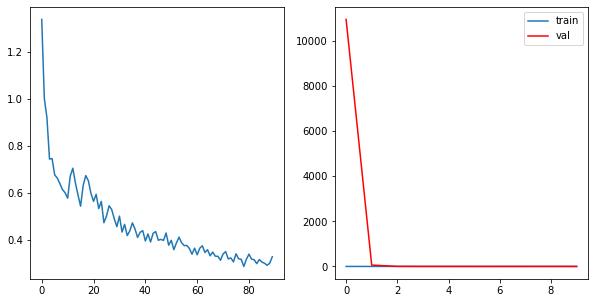

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3001, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2765, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3030, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2764, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2920, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.2926965402558809	     Validation Loss:0.5912220895671471	 \ LR:0.01


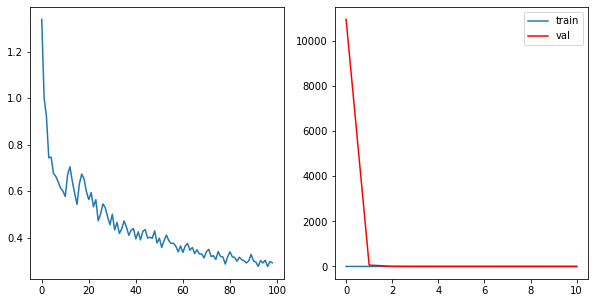

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2886, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2857, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3120, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2827, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2781, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.2801990720267107	     Validation Loss:0.30111858169719447	 \ LR:0.01


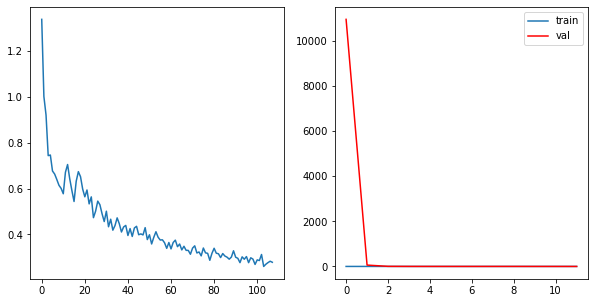

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2875, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2807, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.26273101313738345	     Validation Loss:0.30821843085922934	 \ LR:0.01


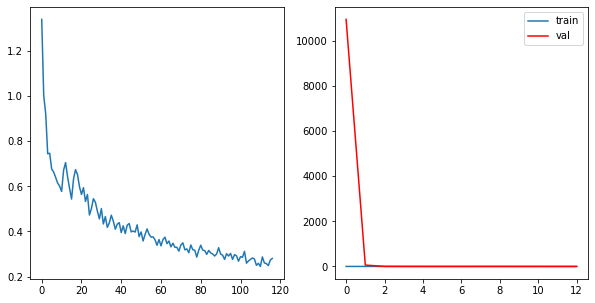

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2320, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2709, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3001, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2825, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2589, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.26238733037541206	     Validation Loss:0.3130233443830048	 \ LR:0.01


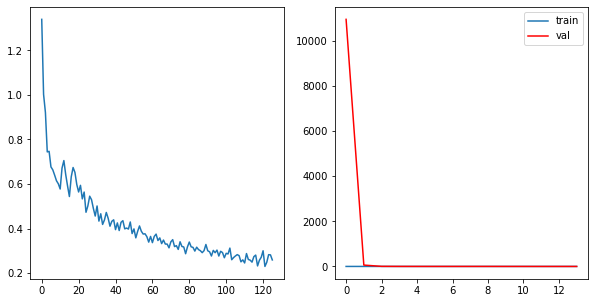

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2781, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3055, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2782, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2809, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.25969173794862505	     Validation Loss:0.3555125733803685	 \ LR:0.01


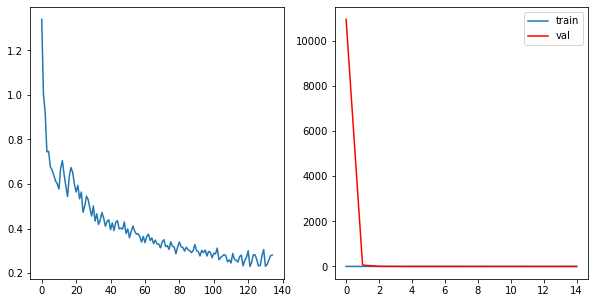

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2655, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2701, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2629, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.25550944754490945	     Validation Loss:0.3691620260104134	 \ LR:0.01


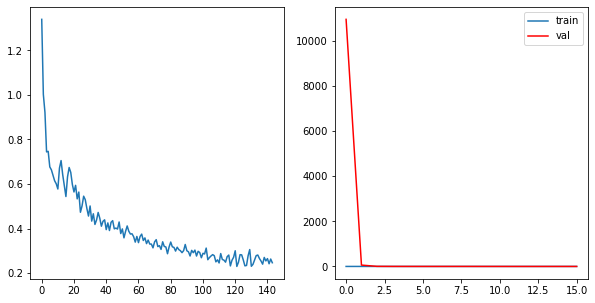

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2348, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2726, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2515, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.2462429958668683	     Validation Loss:0.2722289176509996	 \ LR:0.01


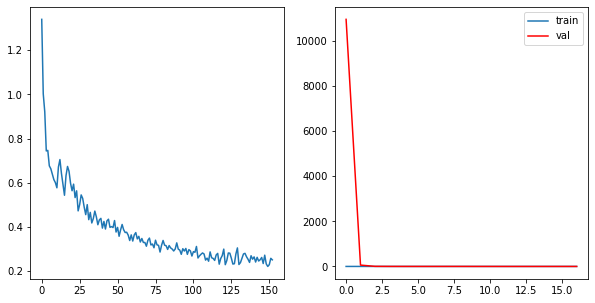

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2272, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2260, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2438, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.22561076841408767	     Validation Loss:0.26064078332925694	 \ LR:0.01


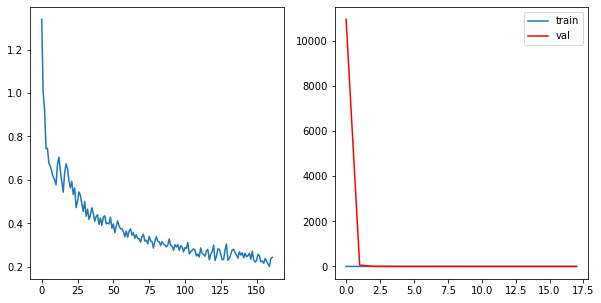

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2158, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2181, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2242, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2080, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2327, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.21963078265393246	     Validation Loss:0.23617619573774642	 \ LR:0.01


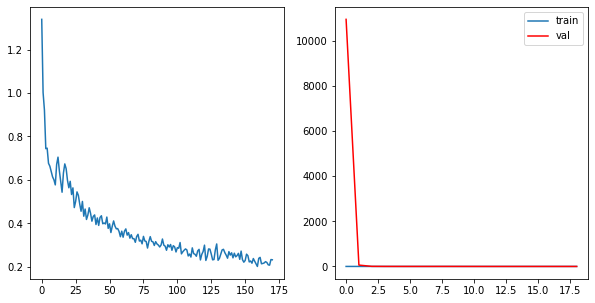

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2128, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2108, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2225, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2127, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2311, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.21818989993999535	     Validation Loss:0.26516855107825604	 \ LR:0.01


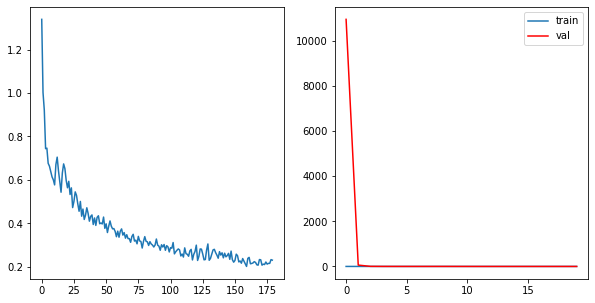

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2113, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2317, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.21666585127002536	     Validation Loss:0.2365116270202745	 \ LR:0.01


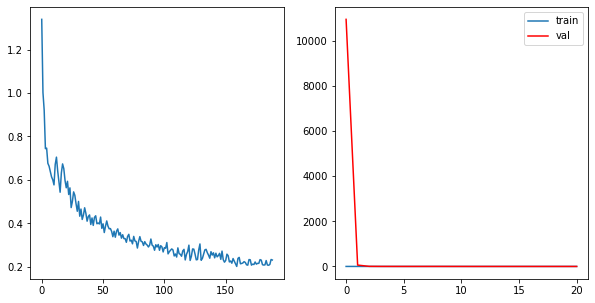

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2099, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2135, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2072, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2143, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.21225905408732174	     Validation Loss:0.2537590516556249	 \ LR:0.01


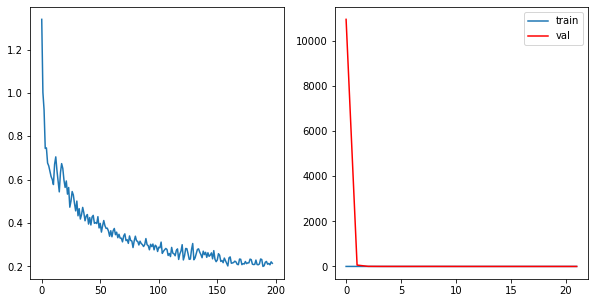

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1927, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2186, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.2086034788761786	     Validation Loss:0.23833340302960596	 \ LR:0.01


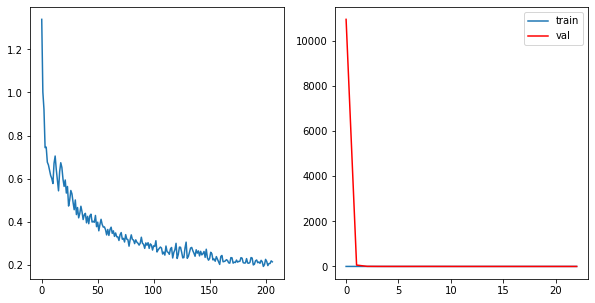

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2209, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.2078994287580767	     Validation Loss:0.2786455336978963	 \ LR:0.01


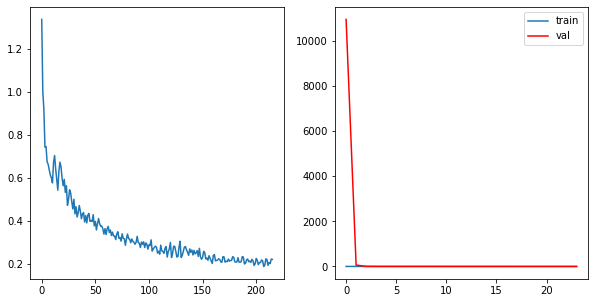

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1872, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2143, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2267, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.20666462371800792	     Validation Loss:0.30302867231947045	 \ LR:0.001


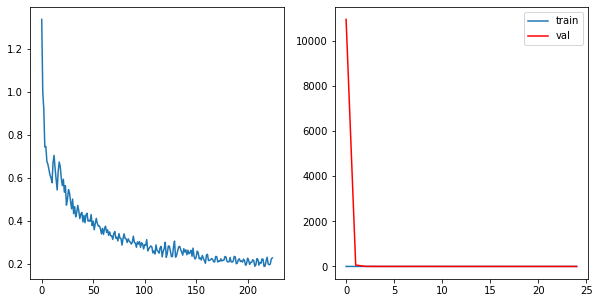

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2036, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2054, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2072, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1905, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1774, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1922, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.19749034891036543	     Validation Loss:0.23391476872214392	 \ LR:0.001


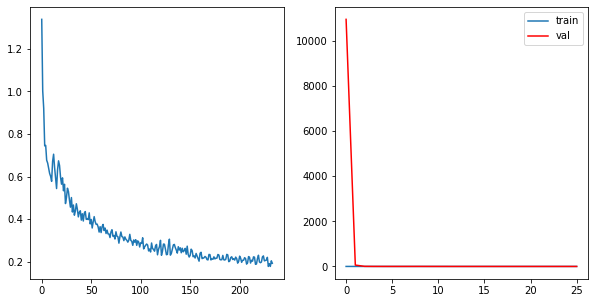

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1840, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1893, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1762, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1769, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1784, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2060, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1904, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.18560701621530887	     Validation Loss:0.21040695719017186	 \ LR:0.001


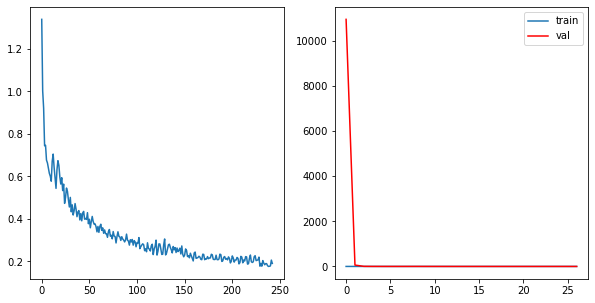

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1780, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1839, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1845, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1751, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.181882060804643	     Validation Loss:0.20293919315593142	 \ LR:0.001


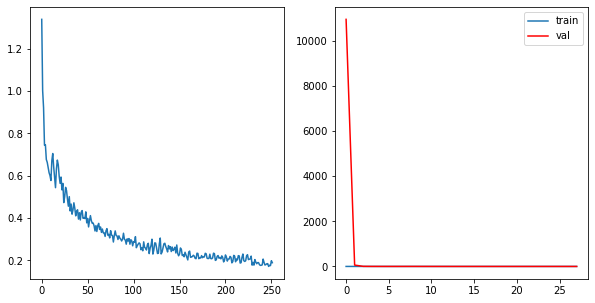

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1715, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1671, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1708, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1857, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.1783804391857963	     Validation Loss:0.20151672392890332	 \ LR:0.001


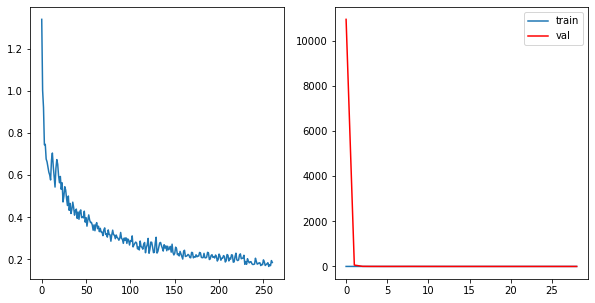

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1750, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1784, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1779, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1694, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1945, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1843, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.17735976987859584	     Validation Loss:0.200681585421866	 \ LR:0.001


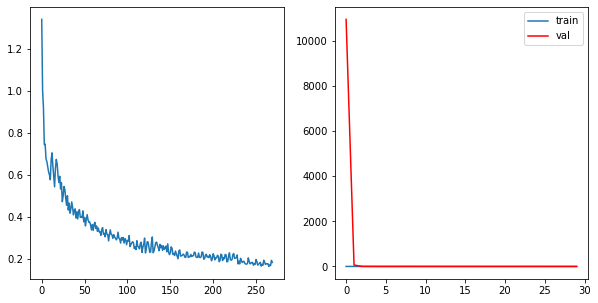

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1739, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1642, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1694, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1930, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1833, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.17620857648463348	     Validation Loss:0.19998538865528007	 \ LR:0.001


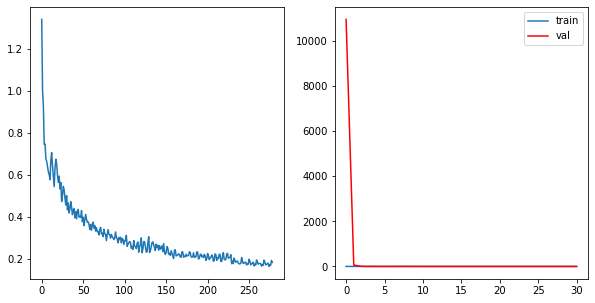

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1699, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1730, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1763, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1632, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1715, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1677, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1916, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1823, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.1748124170207595	     Validation Loss:0.19938450992742252	 \ LR:0.001


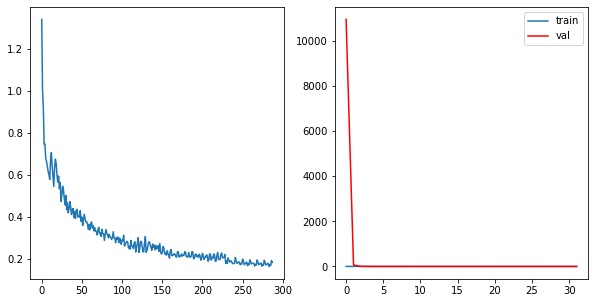

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1700, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1769, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1710, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1906, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1817, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.17420180753102651	     Validation Loss:0.1985668890674149	 \ LR:0.001


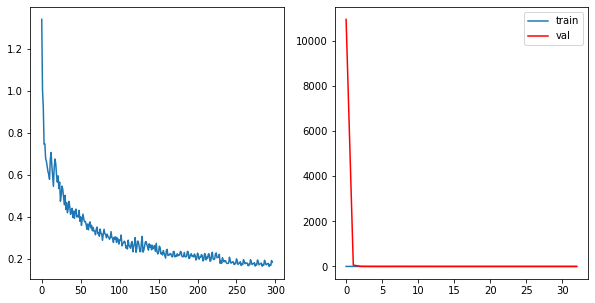

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1684, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1707, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1703, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1666, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1896, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1810, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.17320835869632967	     Validation Loss:0.19821363695966746	 \ LR:0.001


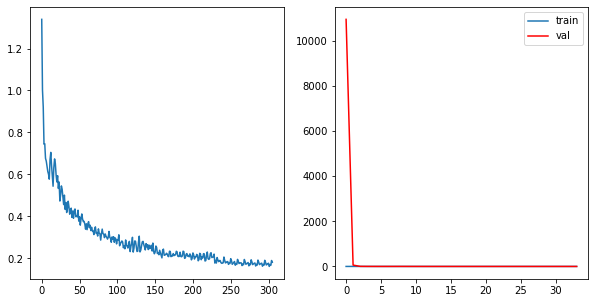

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1701, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1737, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1605, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1803, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.17244339290268093	     Validation Loss:0.19763796602024053	 \ LR:0.001


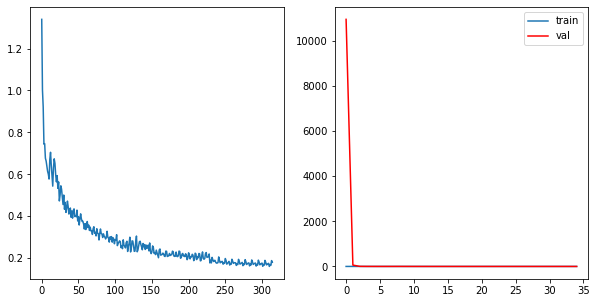

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1690, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1729, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1750, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1690, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1652, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1876, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1796, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.17169919700530614	     Validation Loss:0.19731920442432196	 \ LR:0.001


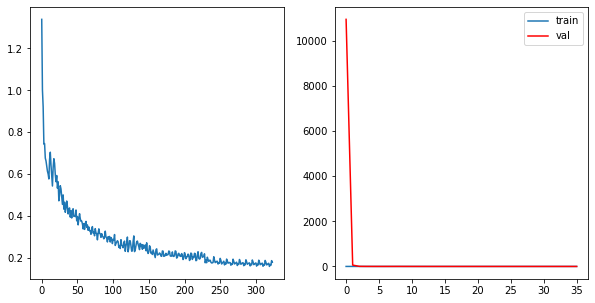

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1664, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1742, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1684, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1867, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1789, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.17094064076420837	     Validation Loss:0.19703527042489108	 \ LR:0.001


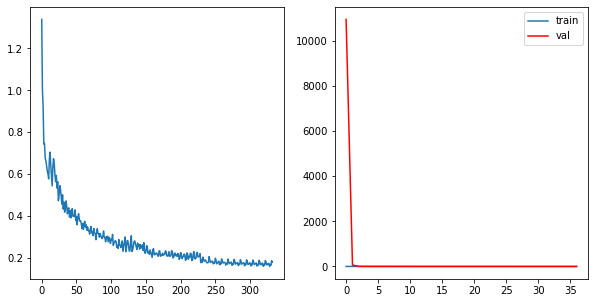

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1715, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1639, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1858, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1783, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.17023060354598407	     Validation Loss:0.19678460902757675	 \ LR:0.001


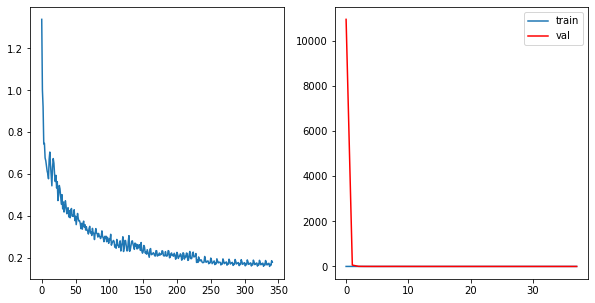

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1652, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1664, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1708, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1671, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1633, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1850, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1776, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.1695075677044606	     Validation Loss:0.19647183342308236	 \ LR:0.001


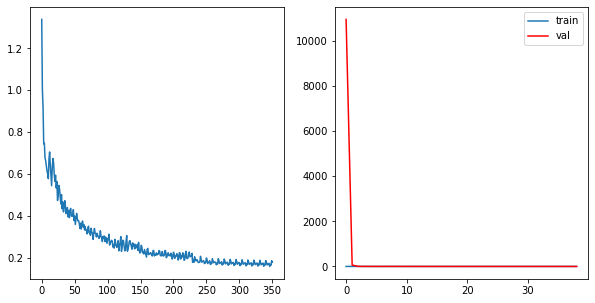

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1701, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1719, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1627, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1842, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1770, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.16878315926545284	     Validation Loss:0.1961144763934508	 \ LR:0.001


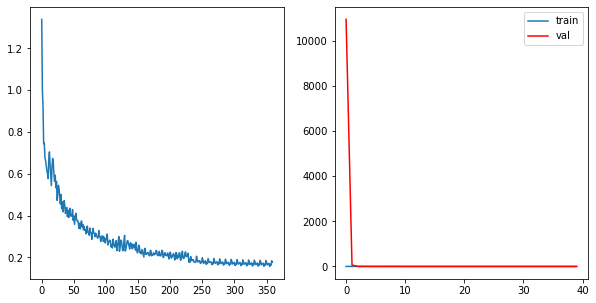

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1694, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1833, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1763, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.1680866291822266	     Validation Loss:0.1957292531828212	 \ LR:0.001


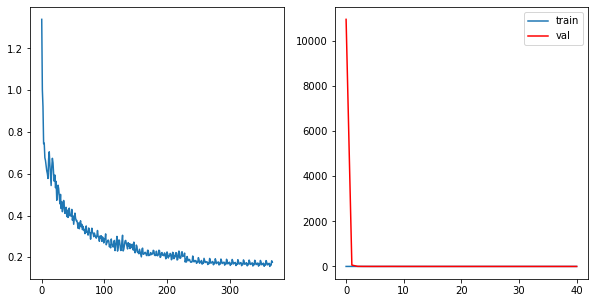

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1632, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1704, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1825, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1757, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.1673686975779155	     Validation Loss:0.1954425648074505	 \ LR:0.001


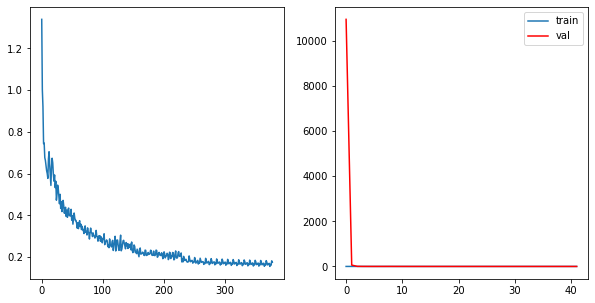

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1626, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1680, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1647, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1817, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1750, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.16666402505443945	     Validation Loss:0.19511314445470093	 \ LR:0.001


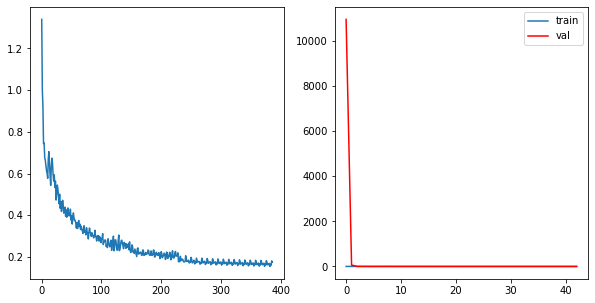

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1674, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1809, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1744, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.16594055476454989	     Validation Loss:0.1946929281703109	 \ LR:0.001


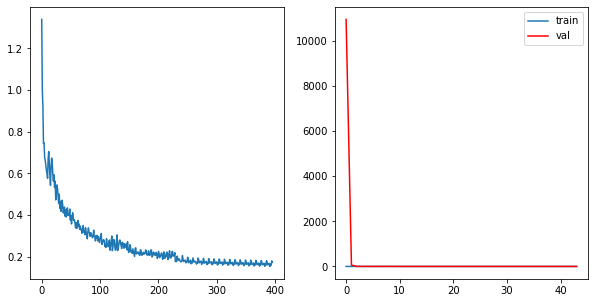

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1613, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1666, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1679, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1634, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1737, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.1652285029410631	     Validation Loss:0.19436967624780666	 \ LR:0.001


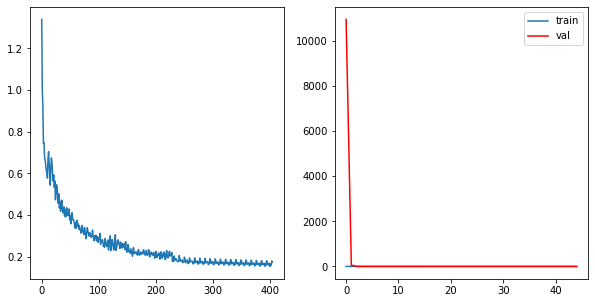

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1627, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1793, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1730, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.1644792613300233	     Validation Loss:0.19400095444834498	 \ LR:0.001


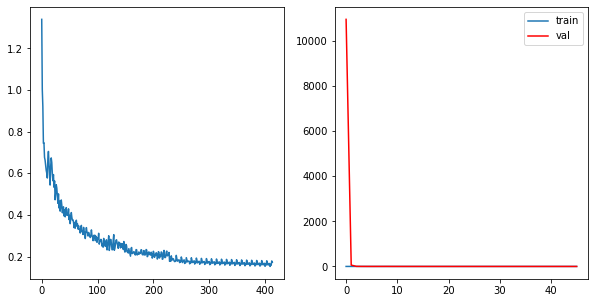

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1663, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1784, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1723, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.16378652858130122	     Validation Loss:0.19371319106780047	 \ LR:0.001


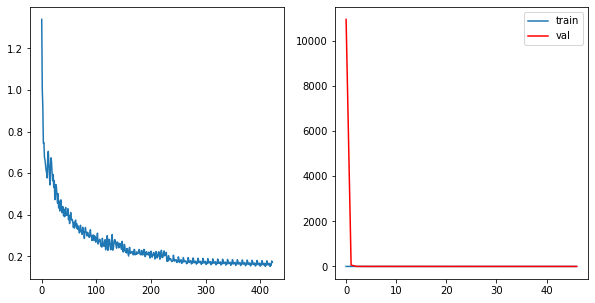

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1717, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.1630434459862957	     Validation Loss:0.19340984640463457	 \ LR:0.001


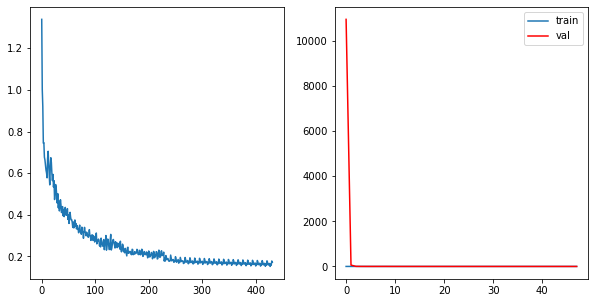

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1587, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1711, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.162341465859035	     Validation Loss:0.1932361653169594	 \ LR:0.001


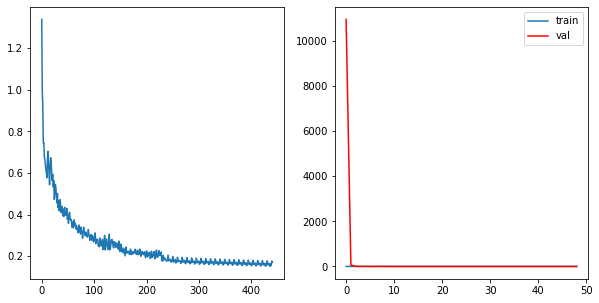

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1759, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1706, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.16161993112839593	     Validation Loss:0.19290714375377016	 \ LR:0.001


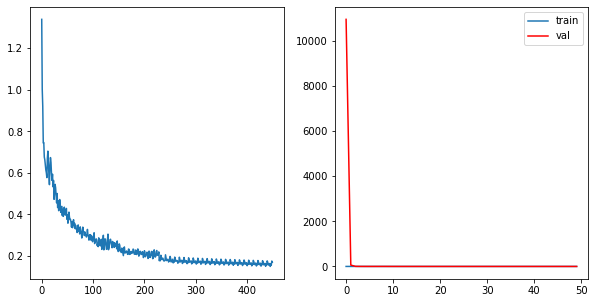

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1698, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.16091142532104363	     Validation Loss:0.19274437720089332	 \ LR:0.001


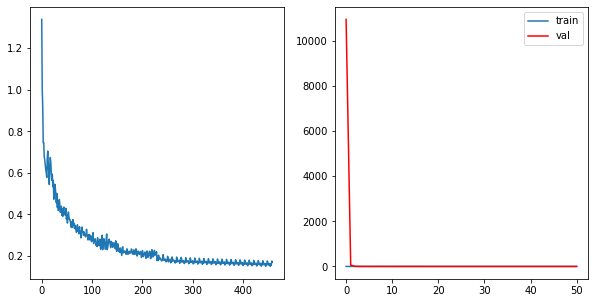

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1616, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1743, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1691, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.16014850882483977	     Validation Loss:0.1925848212294854	 \ LR:0.001


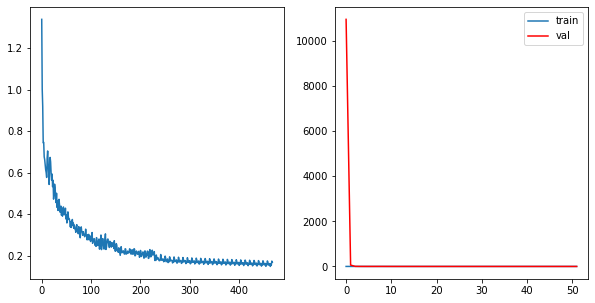

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1684, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.15944425266152418	     Validation Loss:0.19247914735720195	 \ LR:0.001


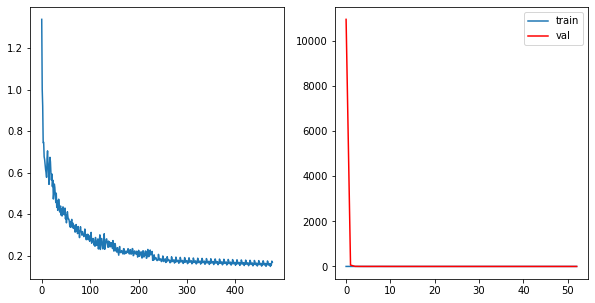

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1605, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1729, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1677, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.15871309361787067	     Validation Loss:0.19222052790751942	 \ LR:0.001


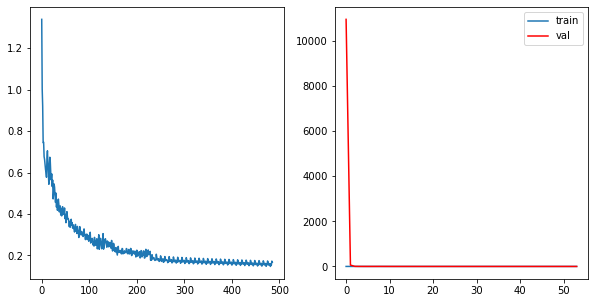

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1719, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1670, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.1579287045124833	     Validation Loss:0.192111632621331	 \ LR:0.001


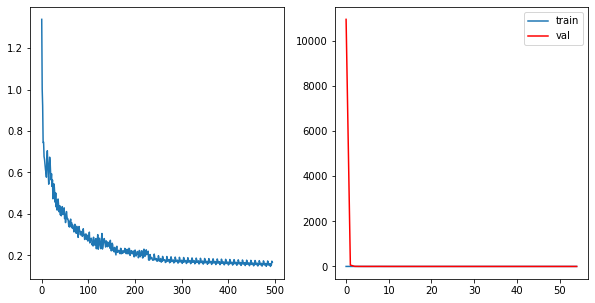

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1587, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1666, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.1572368846308395	     Validation Loss:0.1928731182167546	 \ LR:0.001


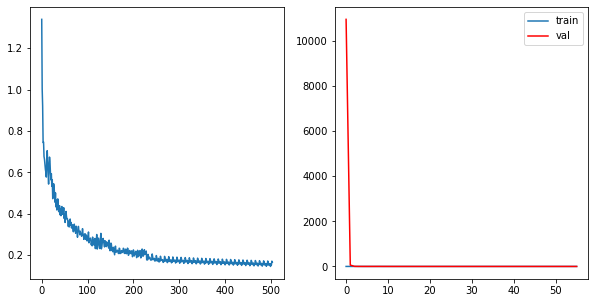

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1519, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1704, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1661, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.15651092494100058	     Validation Loss:0.1925122040665875	 \ LR:0.001


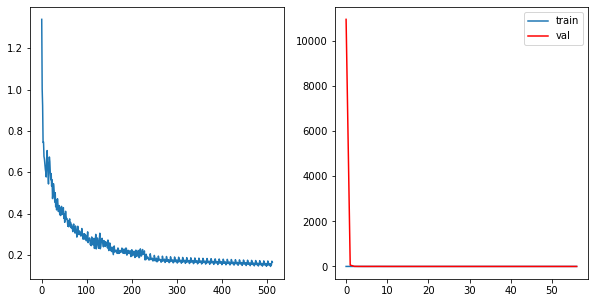

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1525, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "skip_connection with attention "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/skip_connection_attention_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.4736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6878, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6963, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.9859531150987048	     Validation Loss:1835.0411041586324	 \ LR:0.01


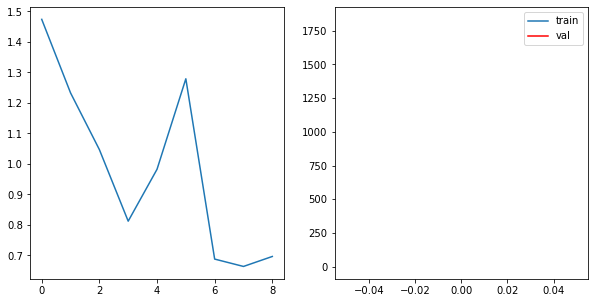

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6176, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5821, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5677, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5038, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.5584556847392347	     Validation Loss:66.70576532499241	 \ LR:0.01


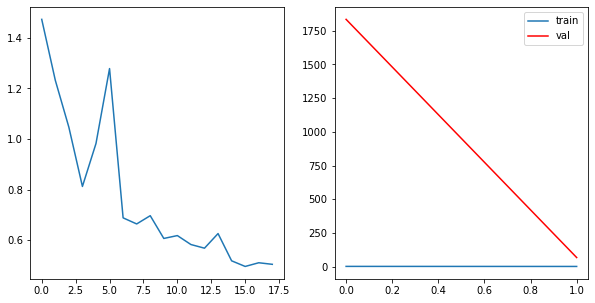

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4904, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3929, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.4258108975931756	     Validation Loss:1.9899474744409964	 \ LR:0.01


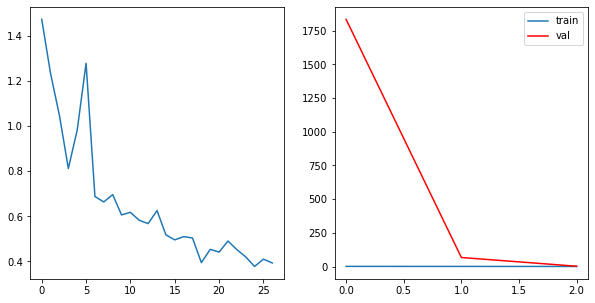

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4119, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3320, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3189, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3042, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.3437425403350319	     Validation Loss:0.6461924422730482	 \ LR:0.01


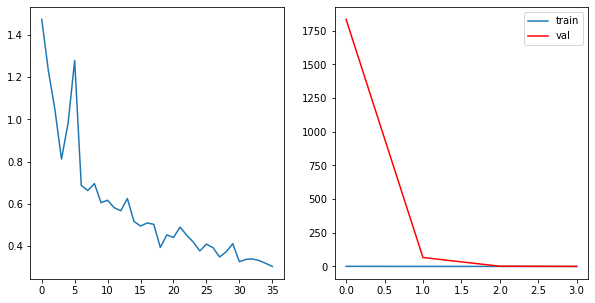

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2935, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2620, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.3059316682610384	     Validation Loss:0.3881451658109036	 \ LR:0.01


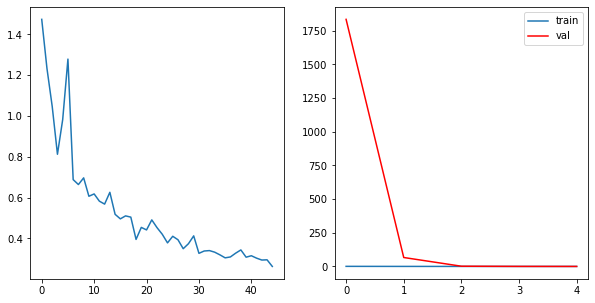

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2804, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2691, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2711, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2558, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.28012807986860694	     Validation Loss:0.3377705824593203	 \ LR:0.01


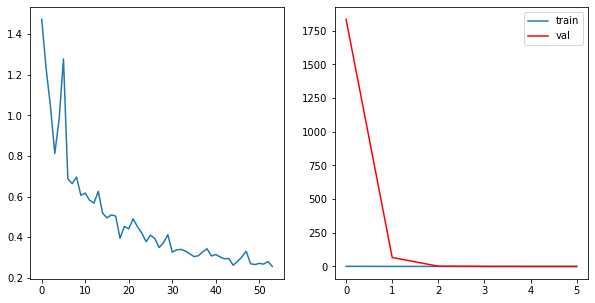

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2710, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2518, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2502, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2349, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.25553591932424563	     Validation Loss:0.32960487213438655	 \ LR:0.01


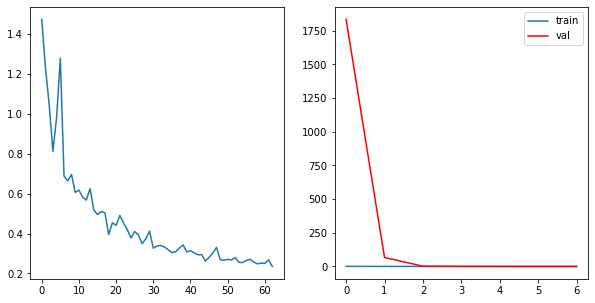

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2456, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2582, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2372, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2385, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.24583001407538946	     Validation Loss:0.32943643672509426	 \ LR:0.01


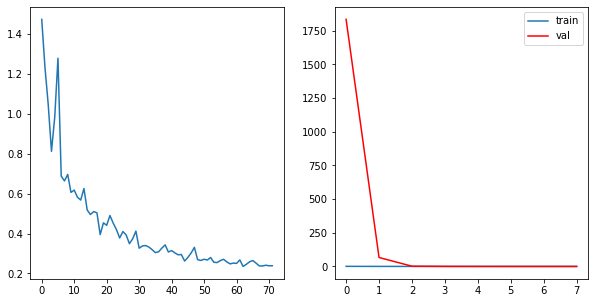

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2309, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2341, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2273, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.23458399171523364	     Validation Loss:0.41592187949654463	 \ LR:0.01


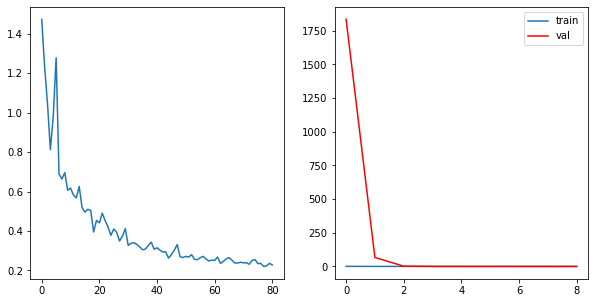

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2367, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2182, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.2333060204207886	     Validation Loss:0.3171653618472922	 \ LR:0.01


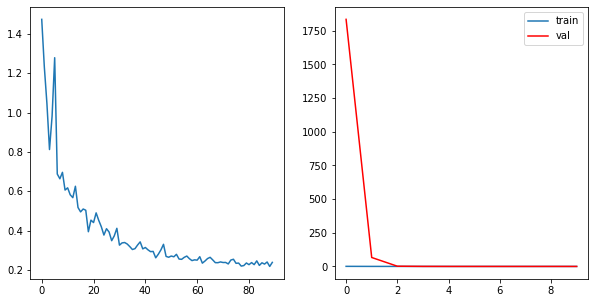

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2232, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2237, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.2316304539133367	     Validation Loss:0.26212249420531947	 \ LR:0.01


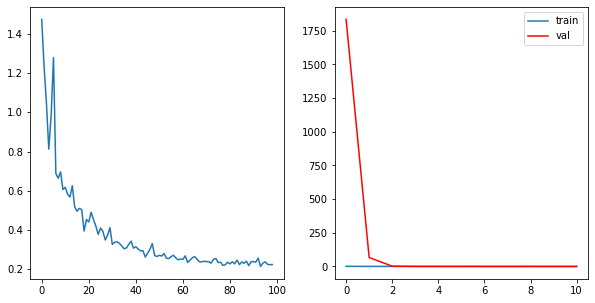

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2088, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2252, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2003, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2183, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.21142292868888724	     Validation Loss:0.2770784891596489	 \ LR:0.01


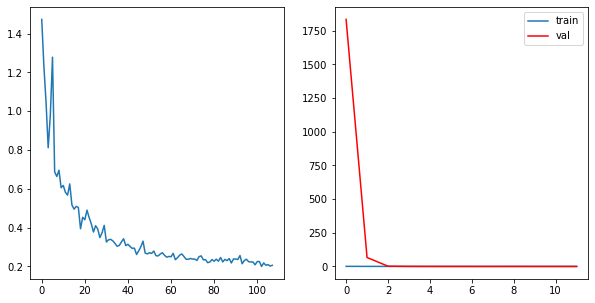

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1927, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1941, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.20428274092646637	     Validation Loss:0.2477882543078959	 \ LR:0.01


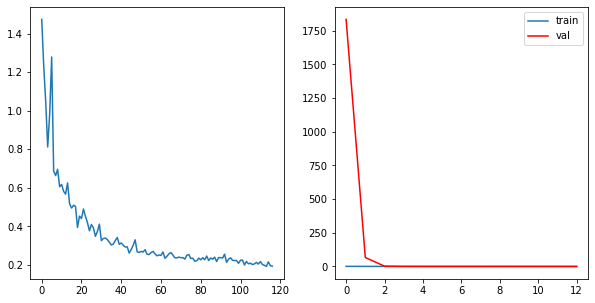

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2083, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2099, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2106, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1934, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1958, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.20009519575158827	     Validation Loss:0.23899712897055622	 \ LR:0.01


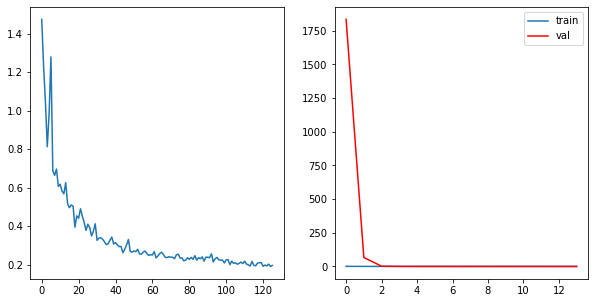

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2056, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1840, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1924, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.19801435709946988	     Validation Loss:0.24417978286680111	 \ LR:0.01


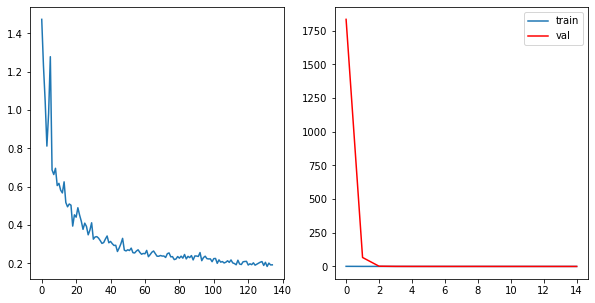

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2091, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1809, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1802, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.1941191101445279	     Validation Loss:0.3304543812993814	 \ LR:0.01


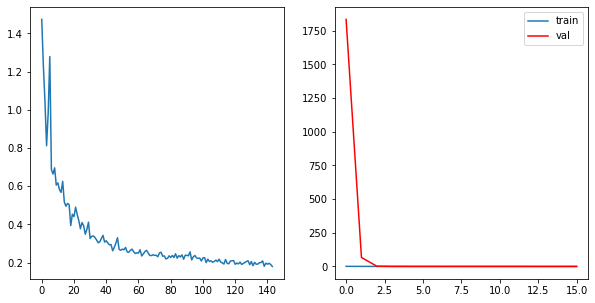

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1846, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1896, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1859, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1872, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.19070138247500604	     Validation Loss:0.30667831127364076	 \ LR:0.01


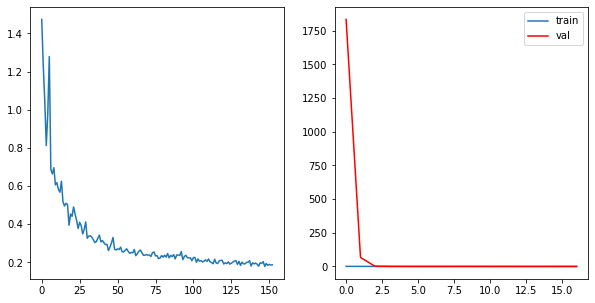

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1853, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1811, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1789, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1772, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1883, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1841, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1946, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.18637342022548425	     Validation Loss:0.2467846239465057	 \ LR:0.01


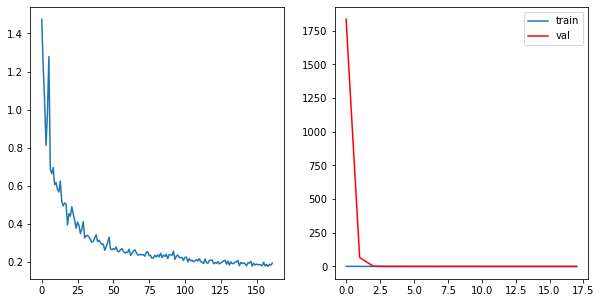

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1803, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1972, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1853, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1871, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1932, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.19080644883067796	     Validation Loss:0.2779666283778676	 \ LR:0.01


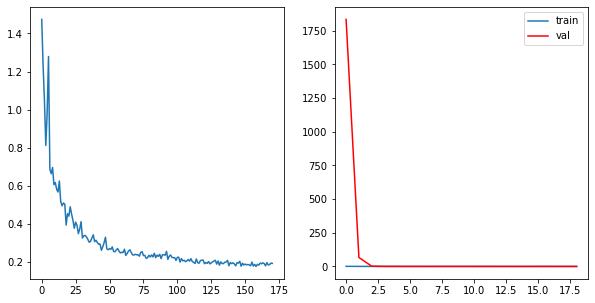

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2056, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1829, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1822, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1873, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1849, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.1909534792096356	     Validation Loss:0.2776757828577105	 \ LR:0.001


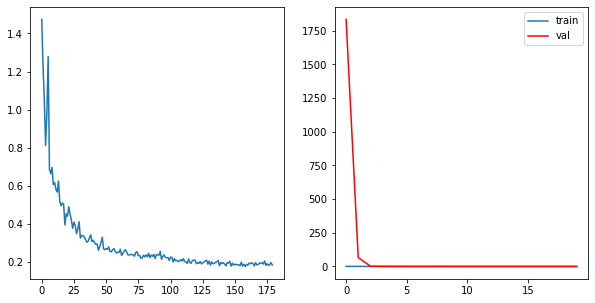

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2080, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1908, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1789, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1815, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1791, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1705, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.186685155586367	     Validation Loss:0.20443012090234128	 \ LR:0.001


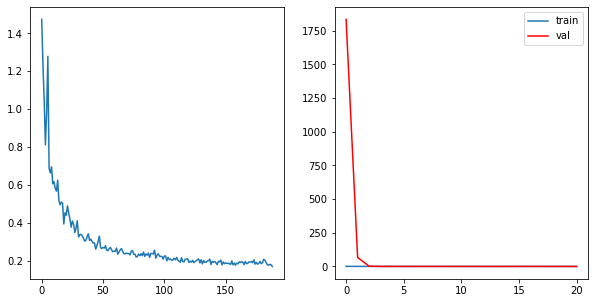

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1848, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1845, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1709, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1633, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.16961178296274726	     Validation Loss:0.18767476160033783	 \ LR:0.001


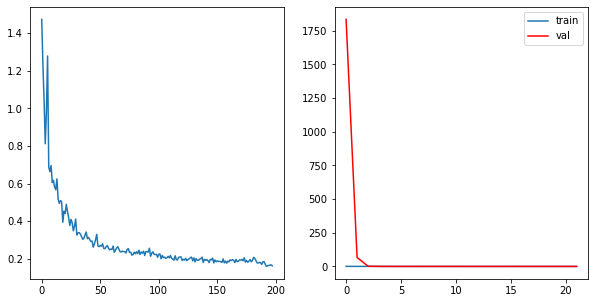

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1715, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1634, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1612, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.16405550719881065	     Validation Loss:0.18890573611991965	 \ LR:0.001


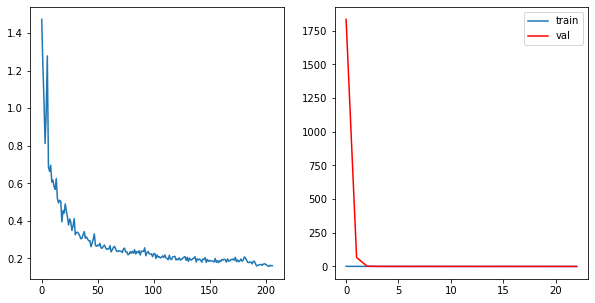

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1702, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1730, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1558, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.16103372805134086	     Validation Loss:0.18179785846861707	 \ LR:0.001


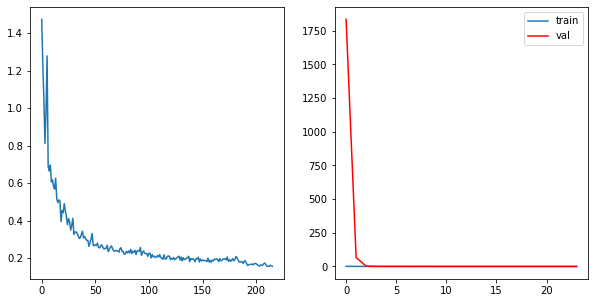

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1630, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1680, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1553, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.15830895534959832	     Validation Loss:0.1803049865676791	 \ LR:0.001


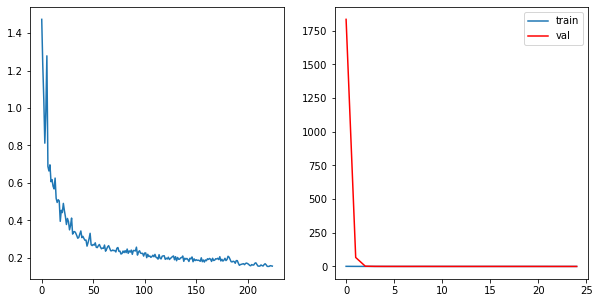

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1519, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.1573304946459327	     Validation Loss:0.17762724796889548	 \ LR:0.001


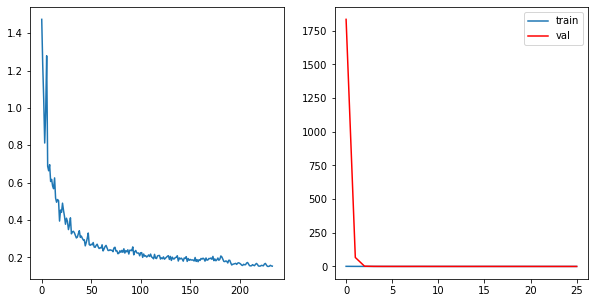

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.15553023945667158	     Validation Loss:0.17937531377151436	 \ LR:0.001


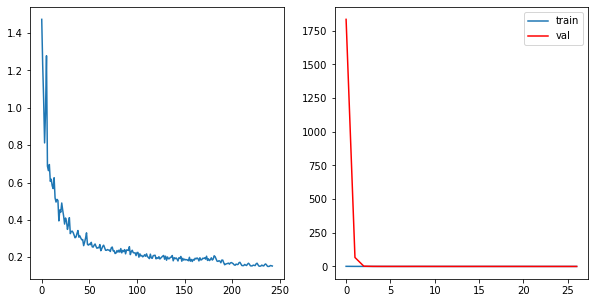

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1516, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.154720067853234	     Validation Loss:0.17848392886822984	 \ LR:0.001


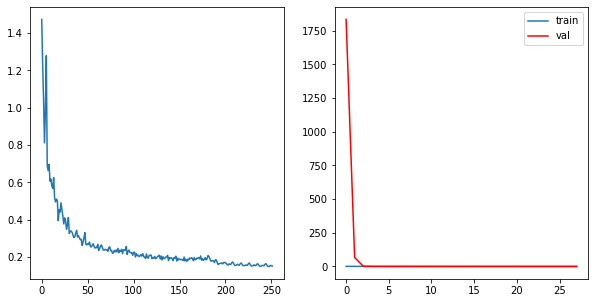

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1592, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.15353685035668782	     Validation Loss:0.17861530189712047	 \ LR:0.001


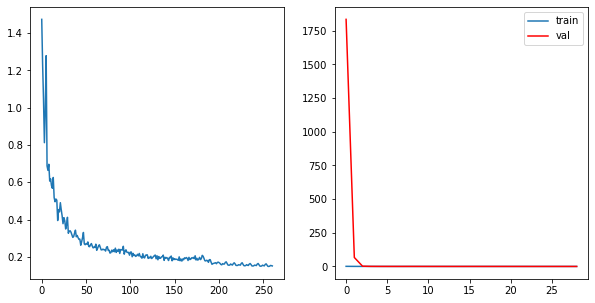

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.15267992910048447	     Validation Loss:0.1786868249664603	 \ LR:0.001


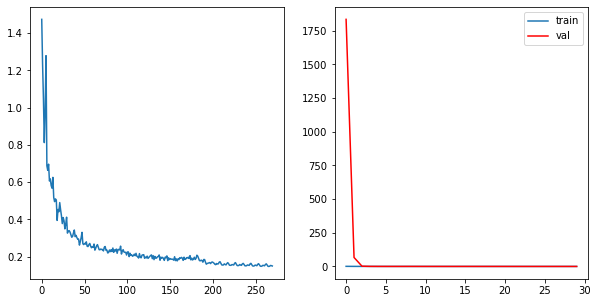

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1604, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.15172782936595688	     Validation Loss:0.1785769862358547	 \ LR:0.001


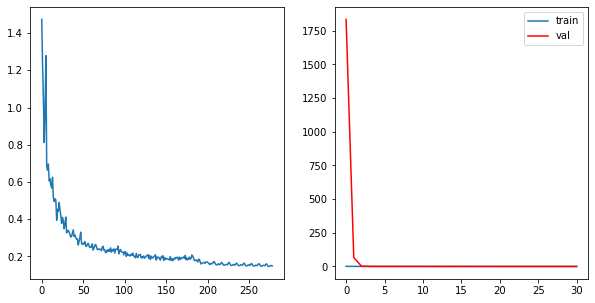

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.15086679270617848	     Validation Loss:0.1788947185362578	 \ LR:0.0001


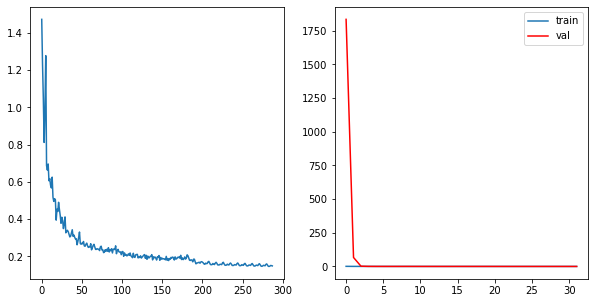

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1479, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.14921317834906744	     Validation Loss:0.17807348174107804	 \ LR:0.0001


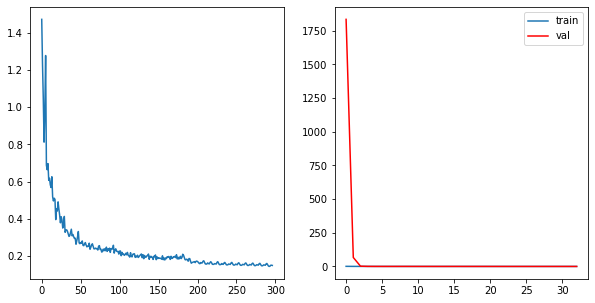

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1474, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.14898050093553572	     Validation Loss:0.1775001160650865	 \ LR:0.0001


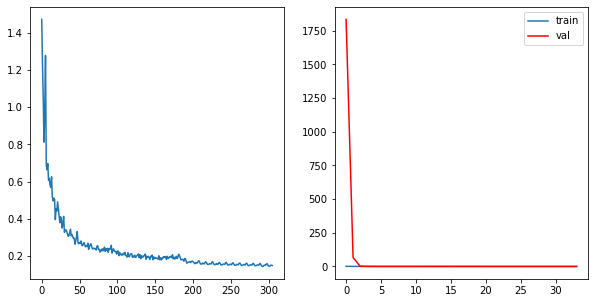

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1473, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.14883043141693056	     Validation Loss:0.17752492166382447	 \ LR:0.0001


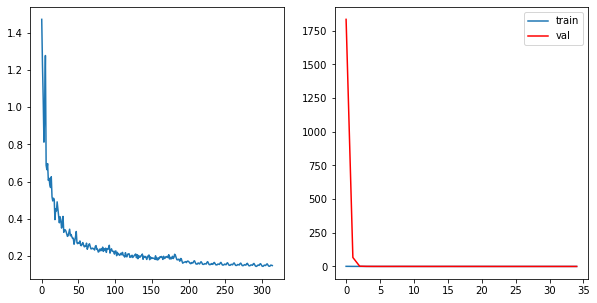

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1473, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.14868539007306236	     Validation Loss:0.17779126126082312	 \ LR:0.0001


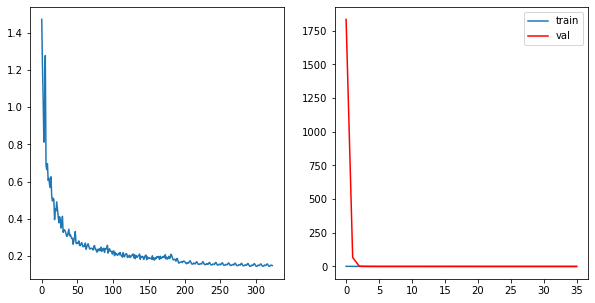

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1506, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.1485668372194094	     Validation Loss:0.1780009417528355	 \ LR:0.0001


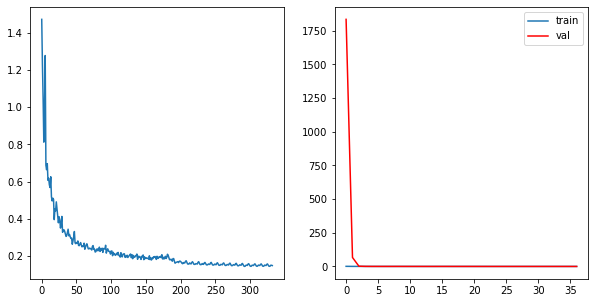

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1485, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.14848158137288273	     Validation Loss:0.1780394593529381	 \ LR:0.0001


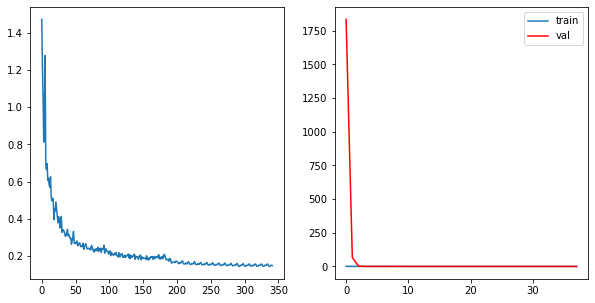

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1470, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.14839715861580227	     Validation Loss:0.17801171460354626	 \ LR:0.0001


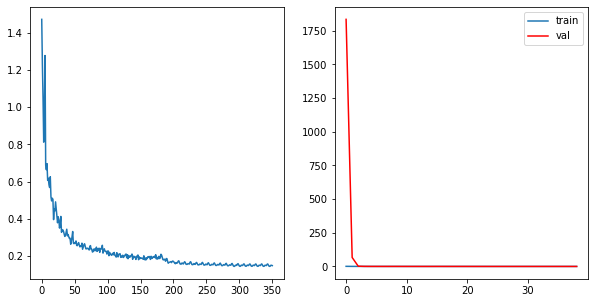

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1502, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1443, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.14830582588430322	     Validation Loss:0.17801346663981774	 \ LR:1e-05


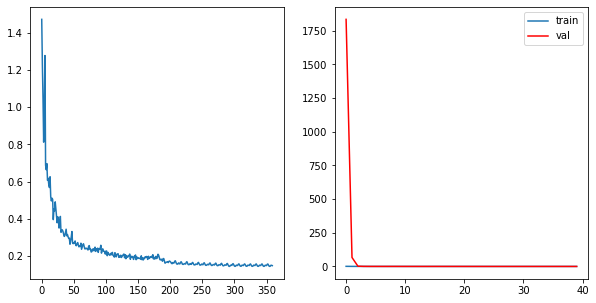

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.14814060318439506	     Validation Loss:0.17803376293197956	 \ LR:1e-05


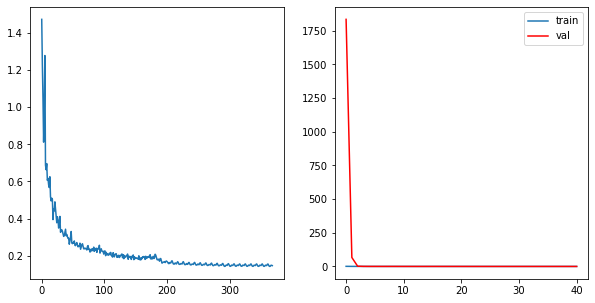

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.14813155827957136	     Validation Loss:0.1780392836347303	 \ LR:1e-05


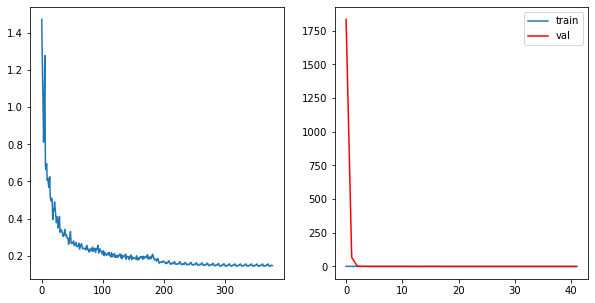

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.14812192177774516	     Validation Loss:0.17803974176655638	 \ LR:1e-05


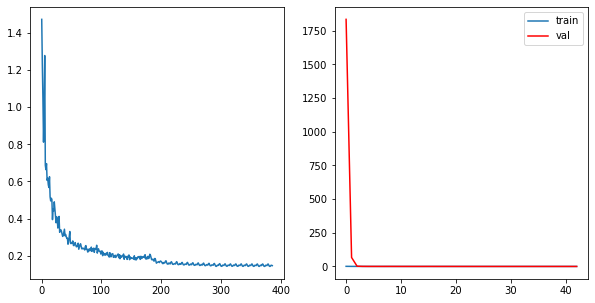

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.14811204800349614	     Validation Loss:0.1780390594059311	 \ LR:1e-05


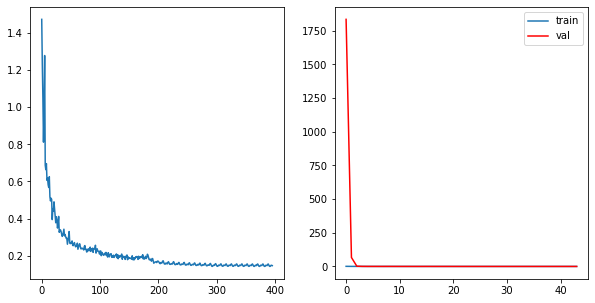

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.14810206428560355	     Validation Loss:0.17803841078474156	 \ LR:1e-05


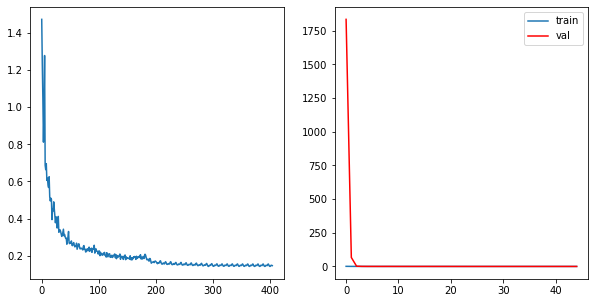

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.14809199959233585	     Validation Loss:0.1780380599964927	 \ LR:1.0000000000000002e-06


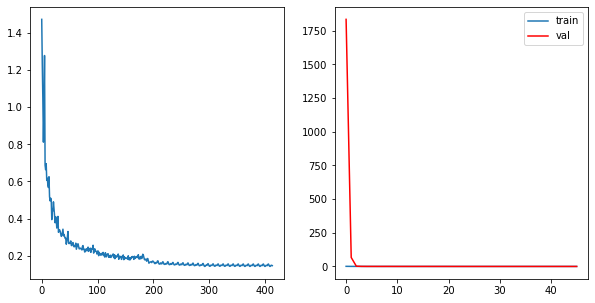

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.14807416618707026	     Validation Loss:0.17804130680722552	 \ LR:1.0000000000000002e-06


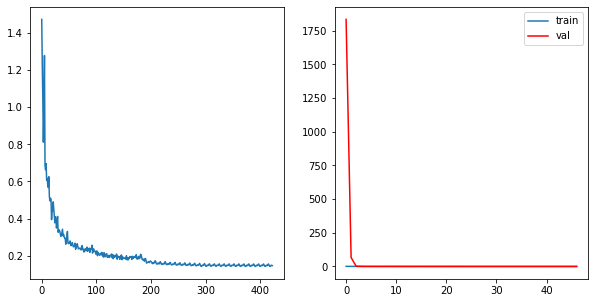

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.14807315831378	     Validation Loss:0.17804253530126188	 \ LR:1.0000000000000002e-06


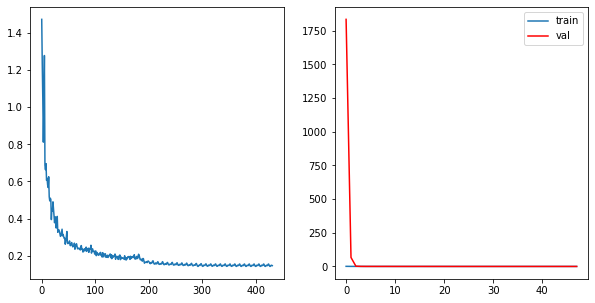

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.14807213776173078	     Validation Loss:0.17804298406894578	 \ LR:1.0000000000000002e-06


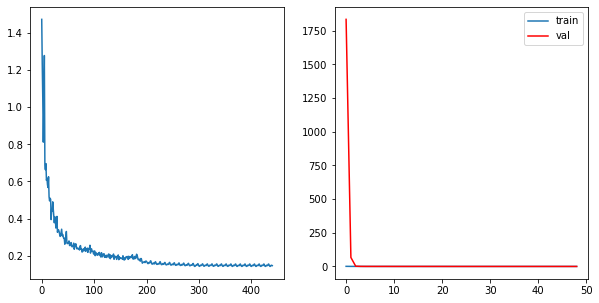

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.1480711124325112	     Validation Loss:0.17804313061921354	 \ LR:1.0000000000000002e-06


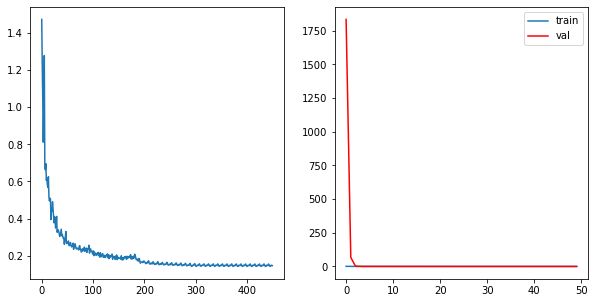

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.14807007264498878	     Validation Loss:0.17804313125183938	 \ LR:1.0000000000000002e-06


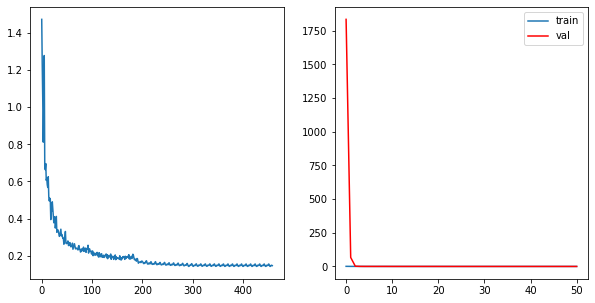

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.14806902622365176	     Validation Loss:0.17804311888980714	 \ LR:1.0000000000000002e-07


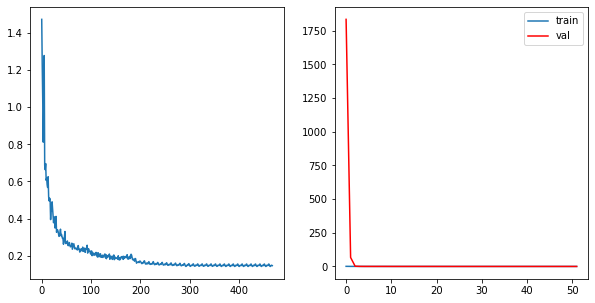

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.14806715669171613	     Validation Loss:0.17804346839345556	 \ LR:1.0000000000000002e-07


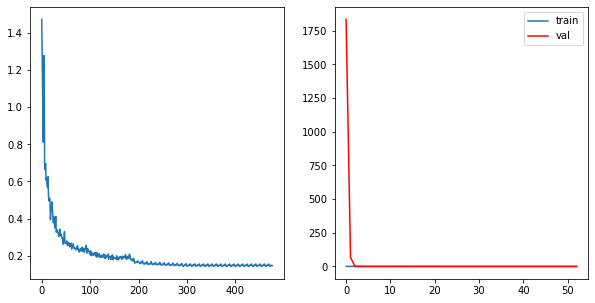

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.1480670549332403	     Validation Loss:0.17804359482775234	 \ LR:1.0000000000000002e-07


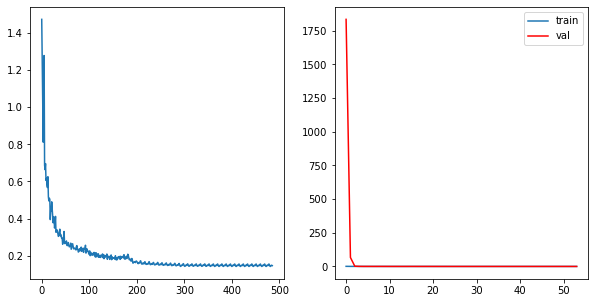

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.14806695301645212	     Validation Loss:0.1780436410180923	 \ LR:1.0000000000000002e-07


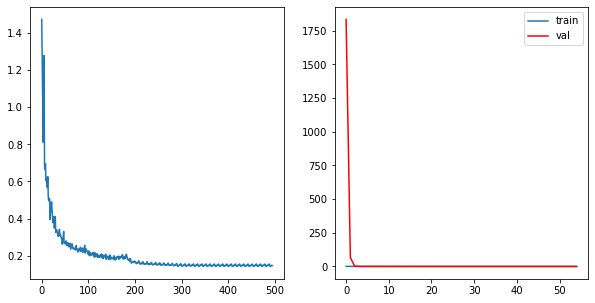

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.14806685157499427	     Validation Loss:0.1780436554626491	 \ LR:1.0000000000000002e-07


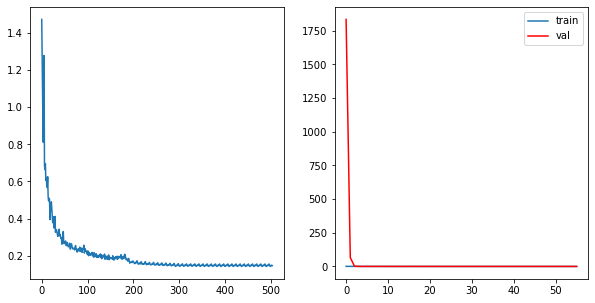

  0%|          | 0/9 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "skip_connection with upsample "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/skip_connection_upsample_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(1.4739, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9059, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7268, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.9987745976265558	     Validation Loss:750.9434020140047	 \ LR:0.01


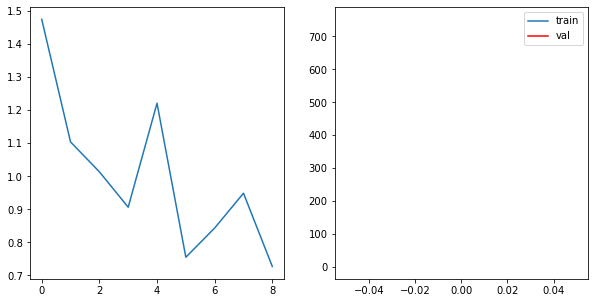

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6935, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6184, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6139, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6671, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5791, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.6512288637503469	     Validation Loss:0.7694547441852501	 \ LR:0.01


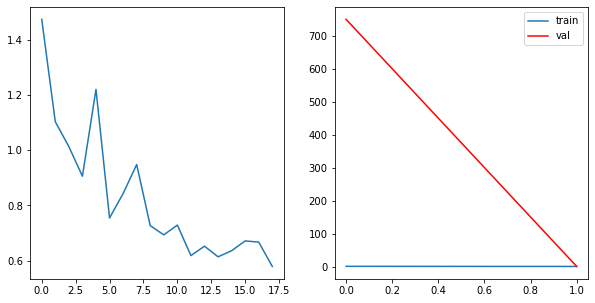

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5795, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5652, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5758, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5013, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.5605715921587457	     Validation Loss:0.5558703445101925	 \ LR:0.01


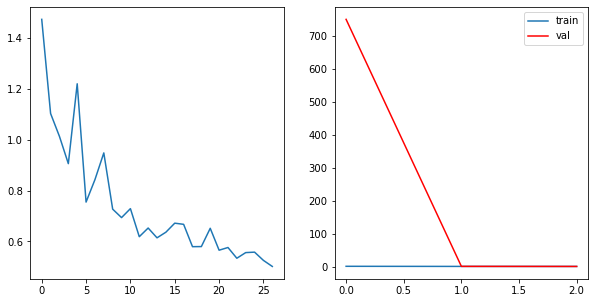

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4372, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3839, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.48152691499389977	     Validation Loss:2.832147016403459	 \ LR:0.01


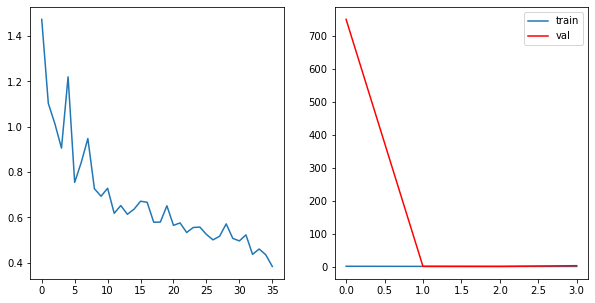

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3871, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4159, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3704, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4137, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3924, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3367, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.39665963822480826	     Validation Loss:0.42610693586212234	 \ LR:0.01


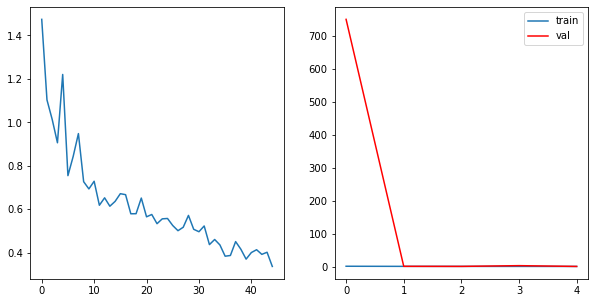

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3701, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3203, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.3538768452491421	     Validation Loss:0.7216449361958888	 \ LR:0.01


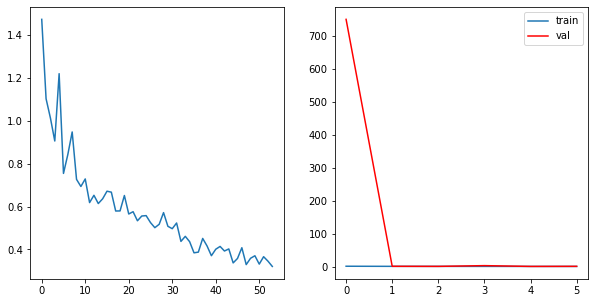

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3147, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3747, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3195, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3182, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3046, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2802, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.31879772470204204	     Validation Loss:0.4071133315110731	 \ LR:0.01


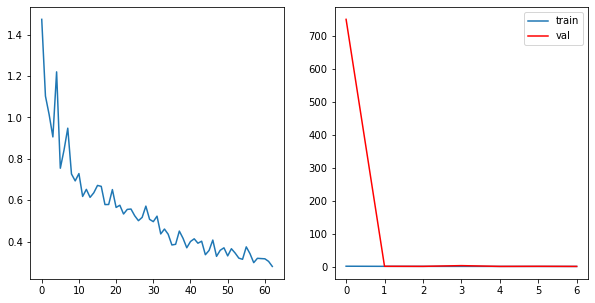

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2888, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2689, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2668, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3001, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2688, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2473, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.28346288647646467	     Validation Loss:0.2895980622582341	 \ LR:0.01


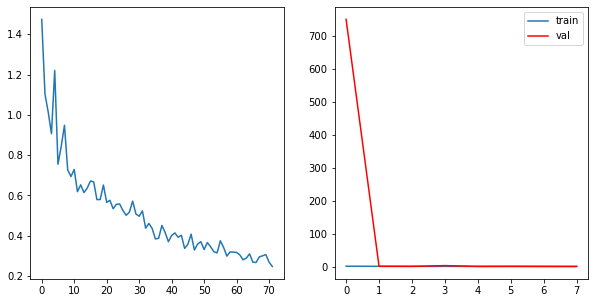

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2553, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2834, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2287, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.2588082638964646	     Validation Loss:0.2870254356117454	 \ LR:0.01


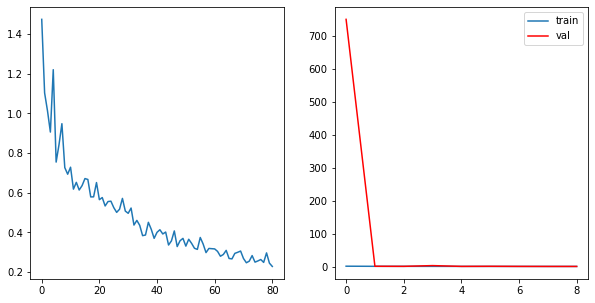

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2213, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2586, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2703, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2216, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.24484806561891947	     Validation Loss:0.24276889139484456	 \ LR:0.01


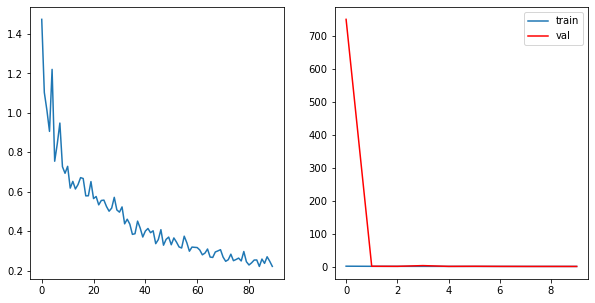

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2376, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2148, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2266, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2182, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.23304670450595688	     Validation Loss:0.2536498842666044	 \ LR:0.01


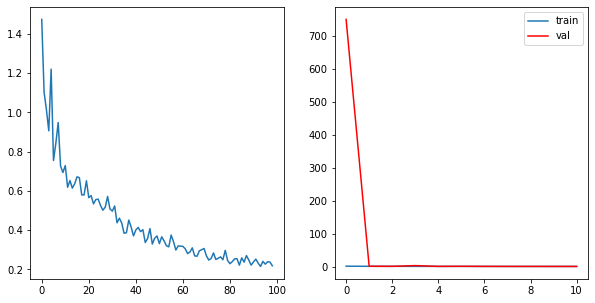

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2308, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2194, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2222, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2161, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.22665252228349056	     Validation Loss:0.2472317369704279	 \ LR:0.01


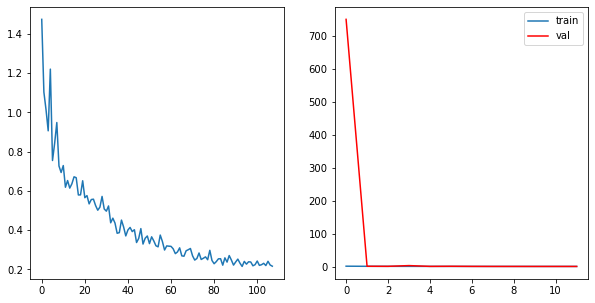

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2006, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2161, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2135, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.21919960816757	     Validation Loss:0.26478139365420456	 \ LR:0.01


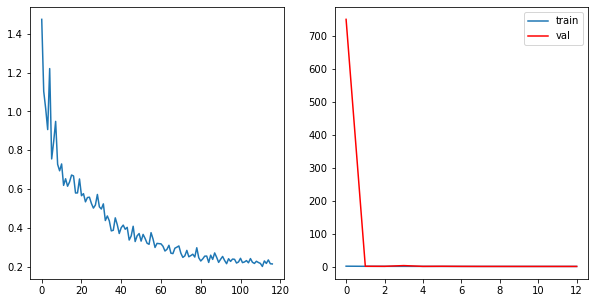

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2080, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2024, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1975, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.20722117934345333	     Validation Loss:0.22639454765583486	 \ LR:0.01


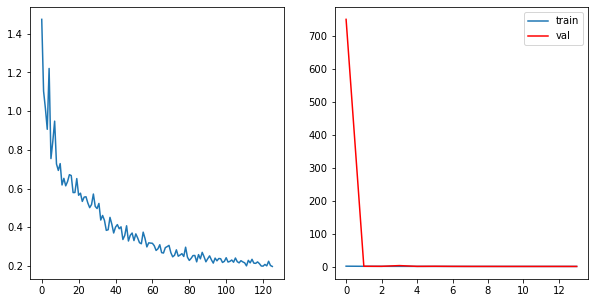

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1929, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2040, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1915, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.2051016344067215	     Validation Loss:0.24806957968545382	 \ LR:0.01


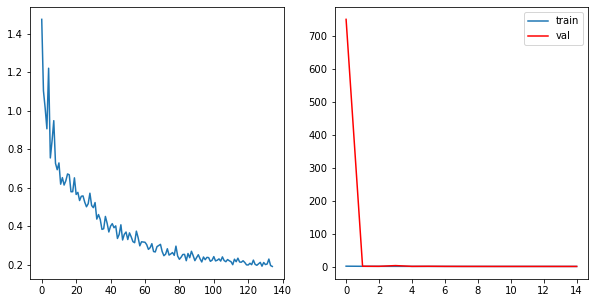

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1972, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2048, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1774, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2112, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1852, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.1982995448435748	     Validation Loss:0.24087176757027443	 \ LR:0.01


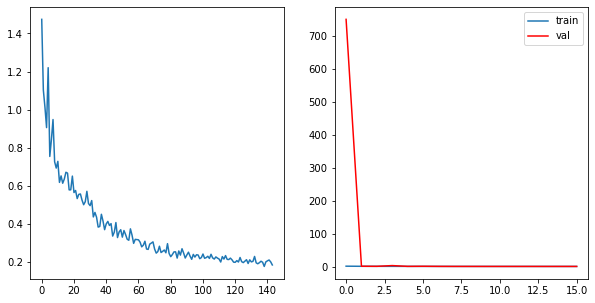

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1876, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1812, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1864, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1841, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2039, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1828, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.19097733584893672	     Validation Loss:0.2006056834941353	 \ LR:0.01


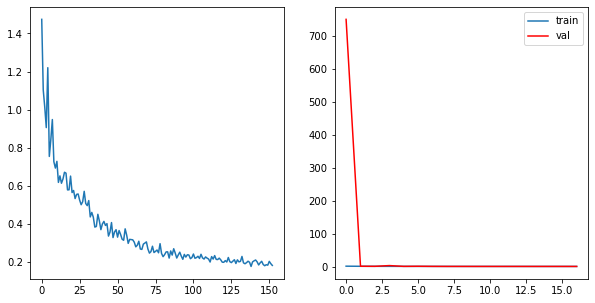

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1879, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1789, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1770, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1840, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1833, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1784, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.184079238405553	     Validation Loss:0.21332099074780378	 \ LR:0.01


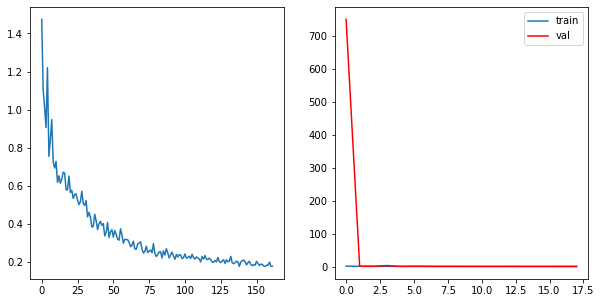

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1728, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1915, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1836, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2054, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1838, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1722, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.18472215986456333	     Validation Loss:0.23390459169252967	 \ LR:0.01


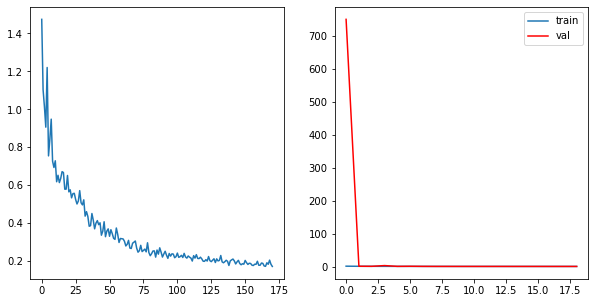

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1845, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1871, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1691, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1758, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1762, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1755, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1690, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.17838409738892885	     Validation Loss:0.19661143322535793	 \ LR:0.01


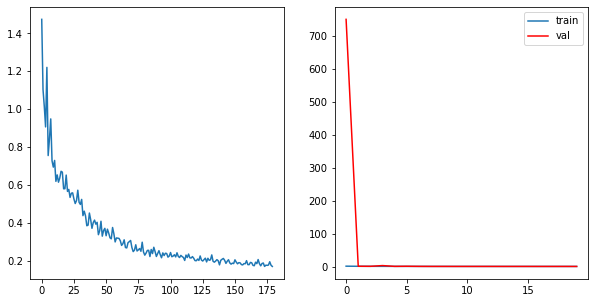

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1763, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1744, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1905, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1688, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1711, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.1739843614724452	     Validation Loss:0.22069623201077979	 \ LR:0.01


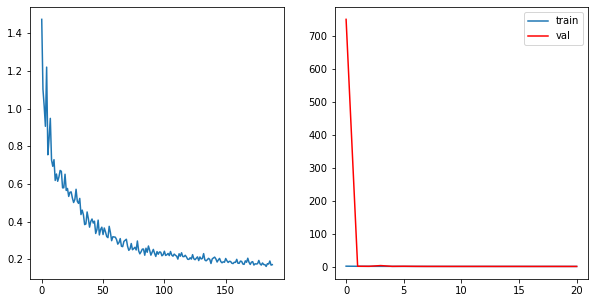

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1779, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1758, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1764, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1718, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.17192355241741367	     Validation Loss:0.21374619129636416	 \ LR:0.01


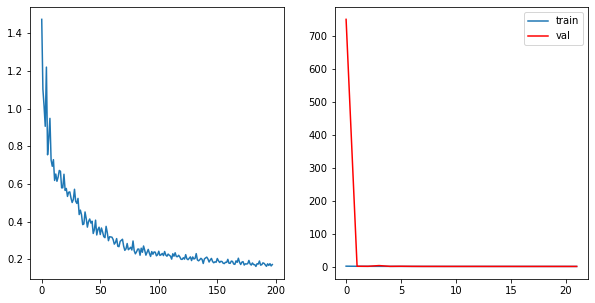

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1686, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1791, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1902, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1866, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1770, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.17562880644677037	     Validation Loss:0.2626085574054492	 \ LR:0.01


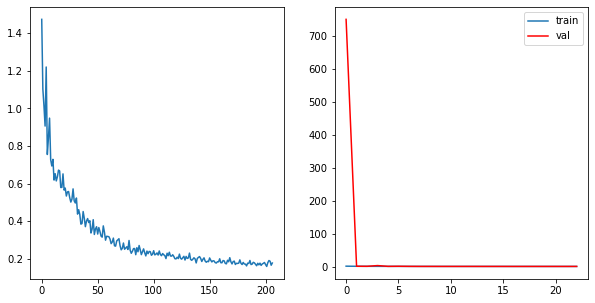

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1842, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1699, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1775, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1895, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1595, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.17141824935599465	     Validation Loss:0.22130995753226404	 \ LR:0.01


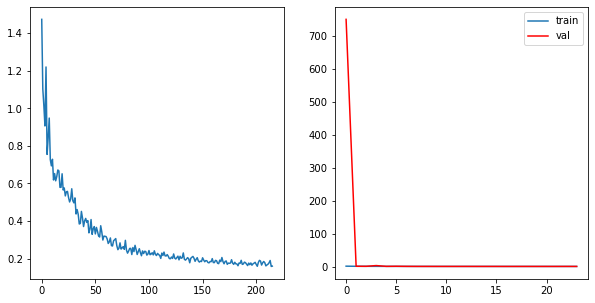

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1702, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1639, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1860, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1561, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.16625329849799	     Validation Loss:0.2614397489111335	 \ LR:0.01


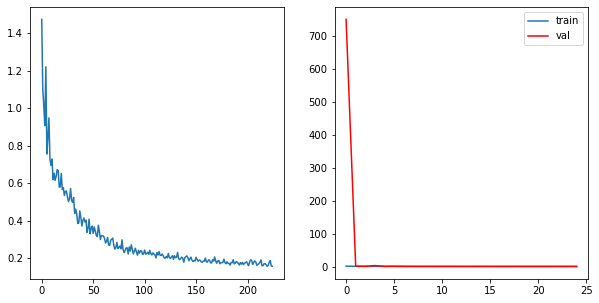

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1869, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1744, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1689, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1592, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.1689930142361111	     Validation Loss:0.19598188020115057	 \ LR:0.01


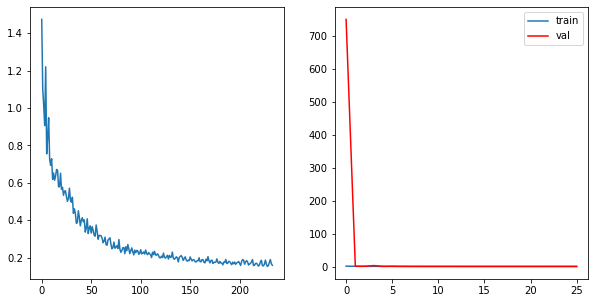

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1749, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1626, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1823, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1723, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.16544399633349663	     Validation Loss:0.18577769560610924	 \ LR:0.01


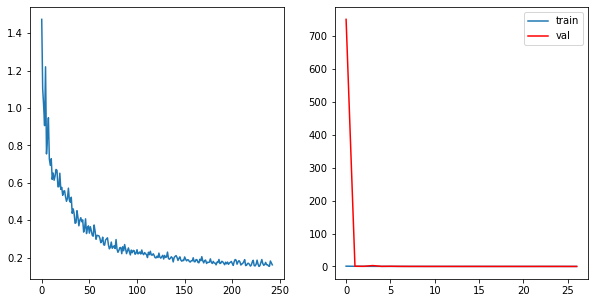

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1761, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1671, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.16351271613415325	     Validation Loss:0.19681186179973387	 \ LR:0.01


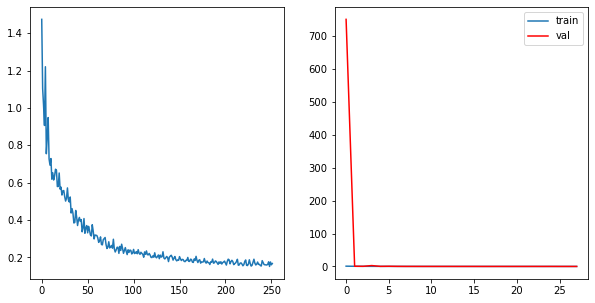

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1717, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1669, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1742, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1597, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.1636034876755263	     Validation Loss:0.21643375284416363	 \ LR:0.01


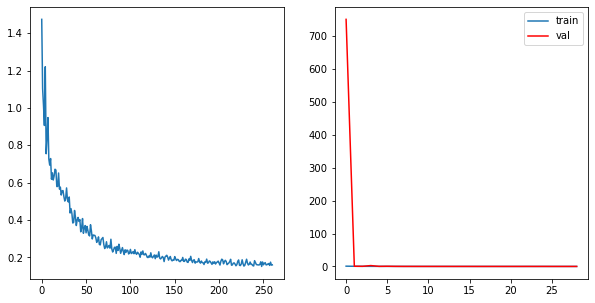

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1743, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1620, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1709, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1652, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1613, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.16337123409464954	     Validation Loss:0.2260414207199001	 \ LR:0.01


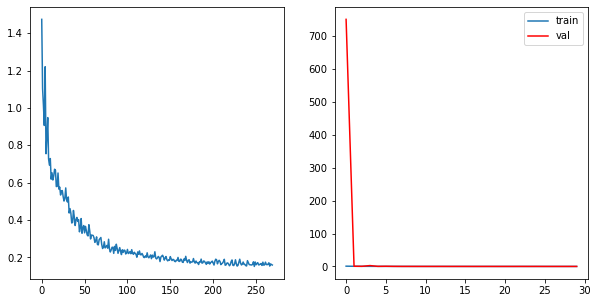

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1550, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.15502739750942857	     Validation Loss:0.20073963602326214	 \ LR:0.01


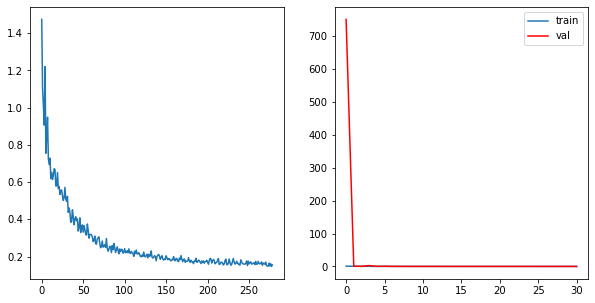

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1466, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1518, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1664, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1488, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.14985896599018872	     Validation Loss:0.19230979307760143	 \ LR:0.01


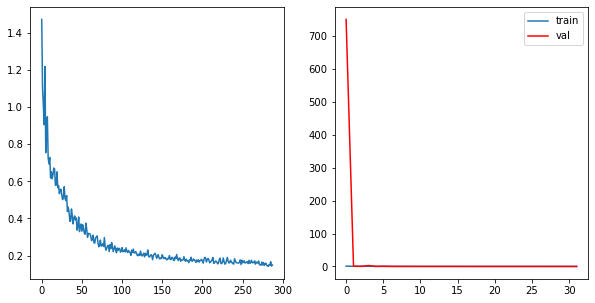

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1477, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.14858342799267307	     Validation Loss:0.18751612146898067	 \ LR:0.001


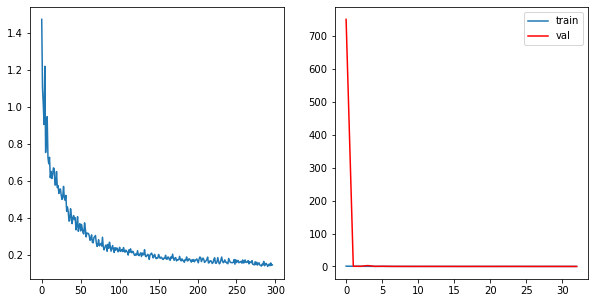

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1407, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1385, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.1436004523958518	     Validation Loss:0.17259593621499933	 \ LR:0.001


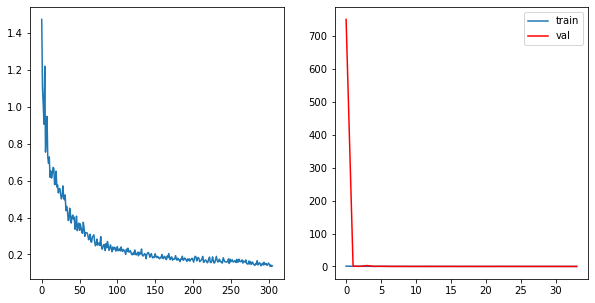

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1266, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1362, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.13382759261820362	     Validation Loss:0.17138533821688764	 \ LR:0.001


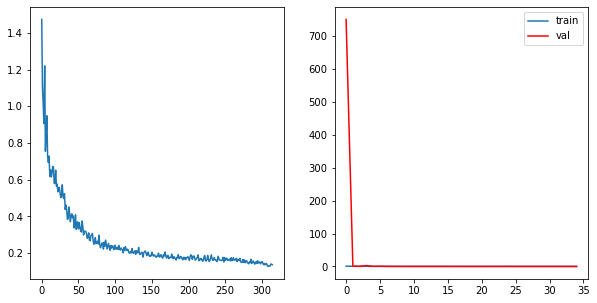

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1253, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1298, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.13020041046540193	     Validation Loss:0.17092597408387666	 \ LR:0.001


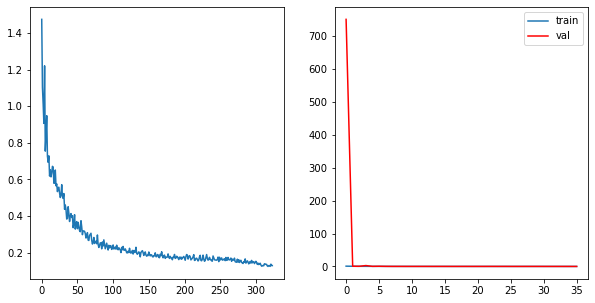

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1359, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1301, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.1284984327550511	     Validation Loss:0.17027124452189965	 \ LR:0.001


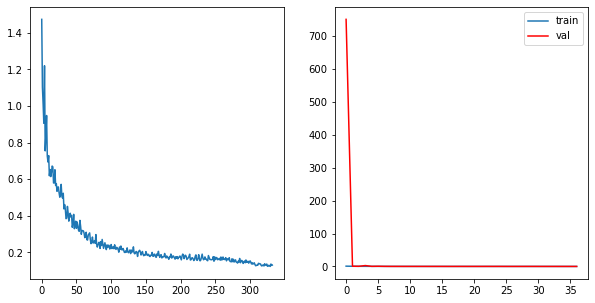

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1213, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1261, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1216, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1346, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.126704482671395	     Validation Loss:0.17049141471989868	 \ LR:0.001


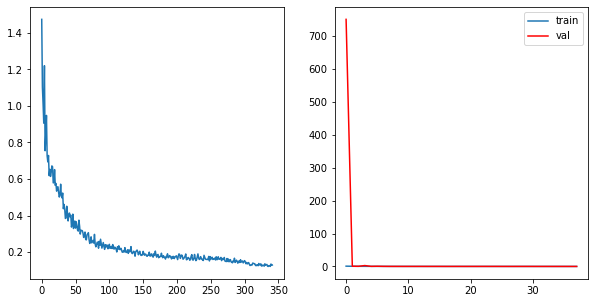

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1207, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1245, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1204, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1273, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.1253817269963561	     Validation Loss:0.17059779418497692	 \ LR:0.001


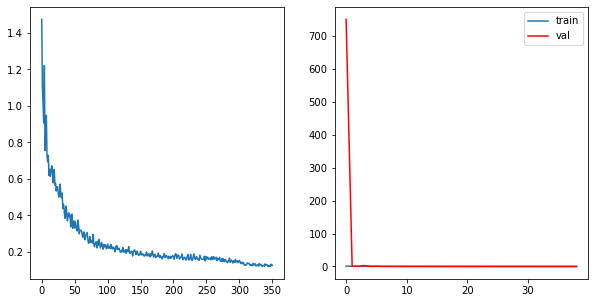

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1246, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1268, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.12456208706836842	     Validation Loss:0.17097343376551935	 \ LR:0.001


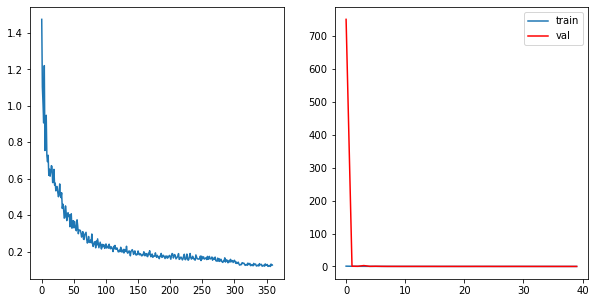

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1187, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1183, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1234, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1256, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.1235067688299922	     Validation Loss:0.17132552808782409	 \ LR:0.001


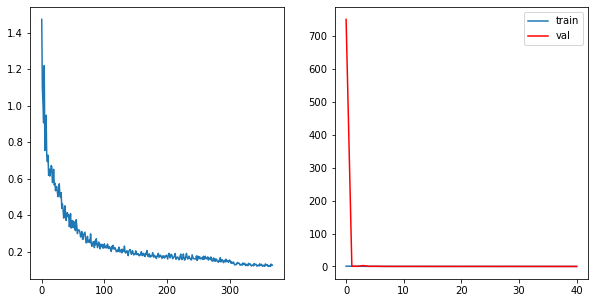

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1184, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1175, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1305, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1249, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.12271241962170214	     Validation Loss:0.17201501008299003	 \ LR:0.001


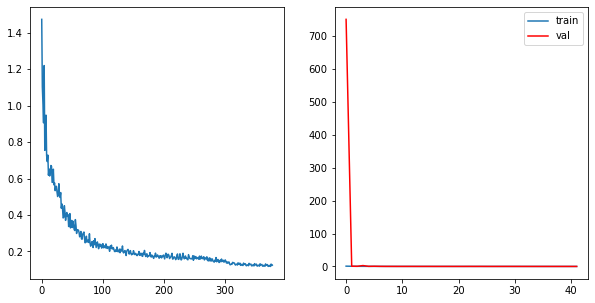

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1266, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1176, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1241, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.12187618670381781	     Validation Loss:0.17262845695576812	 \ LR:0.0001


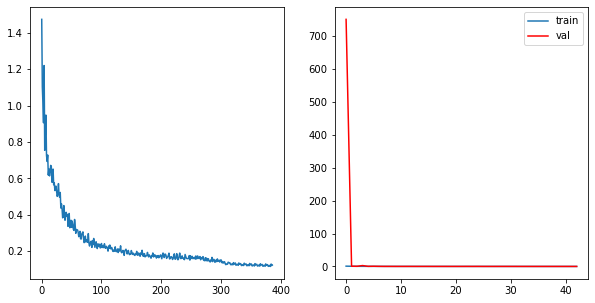

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1258, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1157, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1235, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.12080222125287395	     Validation Loss:0.17302879600911344	 \ LR:0.0001


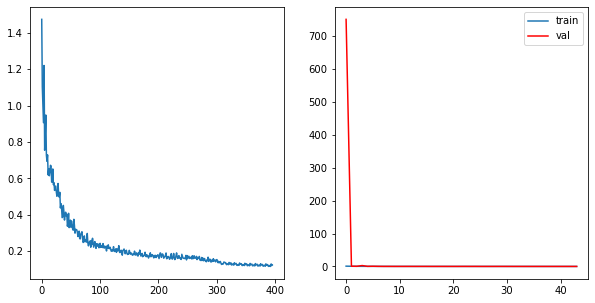

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1254, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1169, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1157, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1195, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.12070501726740537	     Validation Loss:0.17322451487482673	 \ LR:0.0001


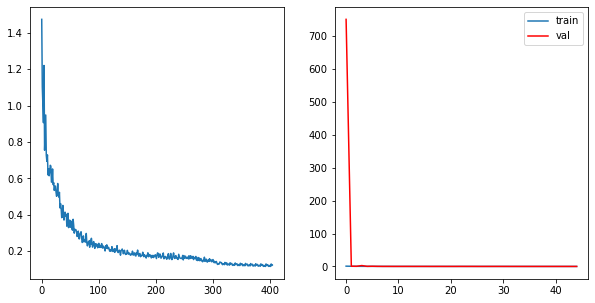

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1249, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1167, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1232, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.1206127783629101	     Validation Loss:0.17332894636470705	 \ LR:0.0001


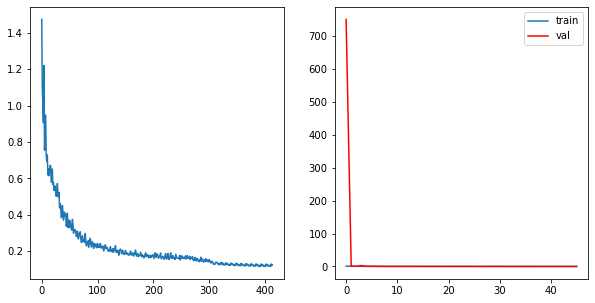

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1246, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1166, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1231, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.12052606042548272	     Validation Loss:0.1733991731684441	 \ LR:0.0001


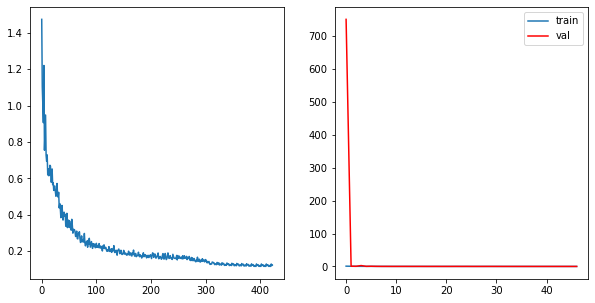

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1245, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1195, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1230, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.12043967804909735	     Validation Loss:0.1734749418274807	 \ LR:0.0001


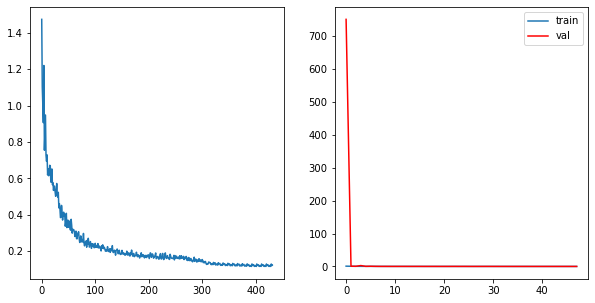

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1244, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1204, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1194, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1153, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1229, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.12035534569506849	     Validation Loss:0.1735714959228383	 \ LR:1e-05


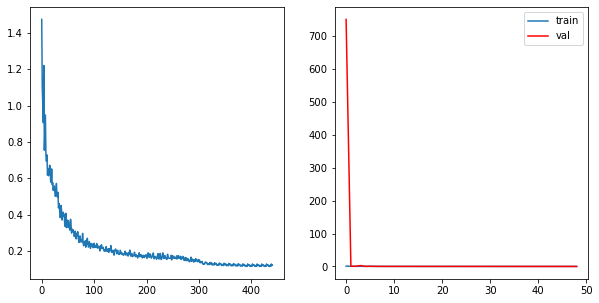

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1229, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.12025420944024923	     Validation Loss:0.1736495828706217	 \ LR:1e-05


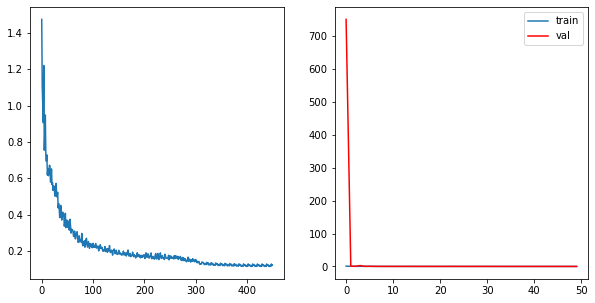

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1229, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.12024607696076789	     Validation Loss:0.17368567976194615	 \ LR:1e-05


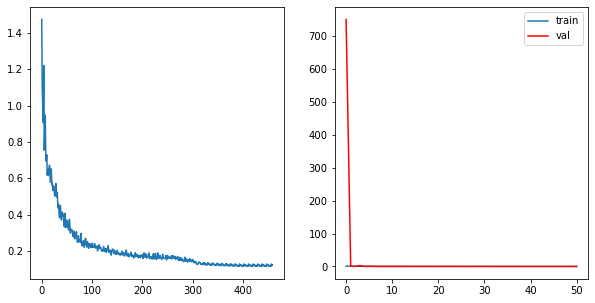

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.12023776862285346	     Validation Loss:0.17370467526764274	 \ LR:1e-05


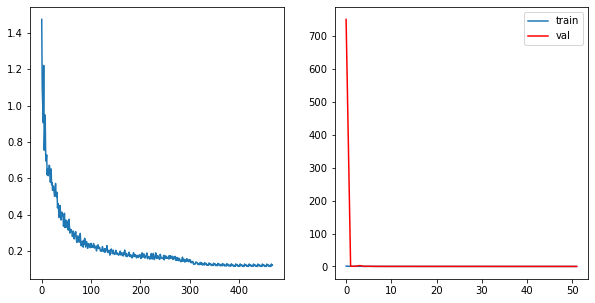

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.120229351766077	     Validation Loss:0.17371671190573892	 \ LR:1e-05


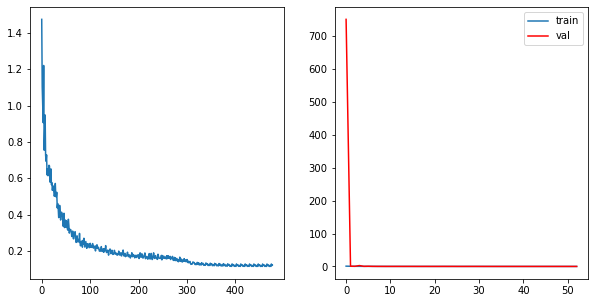

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.1202208832933666	     Validation Loss:0.17372609526777272	 \ LR:1e-05


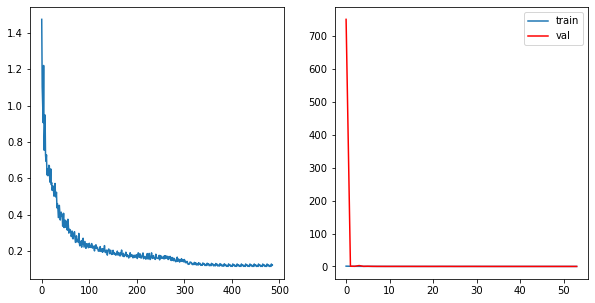

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.12021237197915309	     Validation Loss:0.17373448557844992	 \ LR:1.0000000000000002e-06


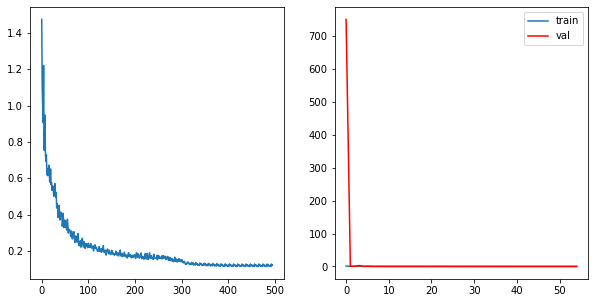

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.12020173826300293	     Validation Loss:0.17374082010805944	 \ LR:1.0000000000000002e-06


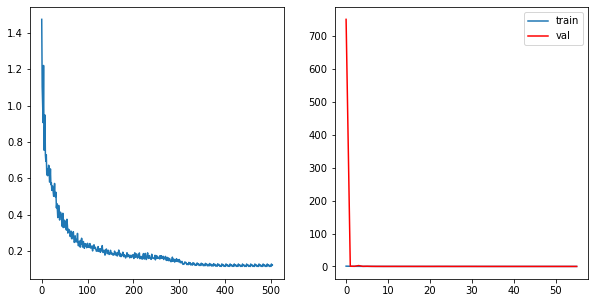

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1200, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1228, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.12020088028187526	     Validation Loss:0.17374375577837076	 \ LR:1.0000000000000002e-06


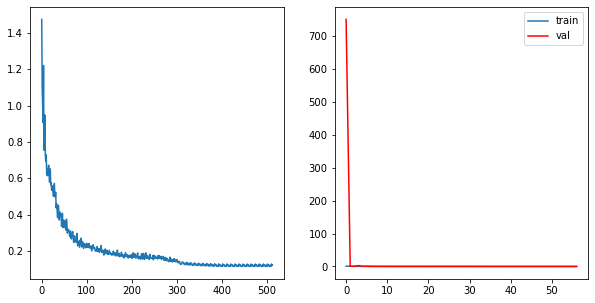

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1152, dtype=torch.float64, grad_fn=<DivBackward1>)


KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "skip_connection "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/skip_connection' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2968, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.9857, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(2.7442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0028, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8906, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7864, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 1.1668725376168707	     Validation Loss:30.93997196848402	 \ LR:0.01


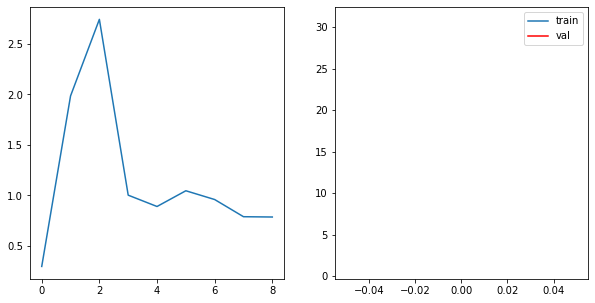

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6767, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6771, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6213, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5925, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5612, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.5953787115496078	     Validation Loss:23.277038371311587	 \ LR:0.01


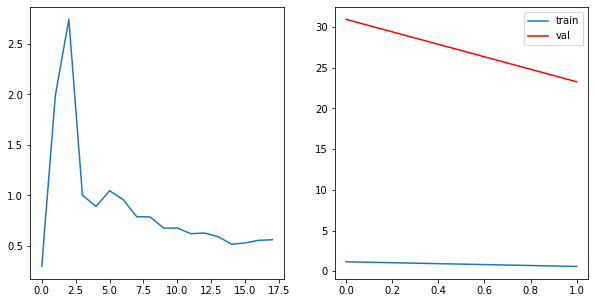

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4655, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4649, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4913, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.4868470312088816	     Validation Loss:20.769704147425212	 \ LR:0.01


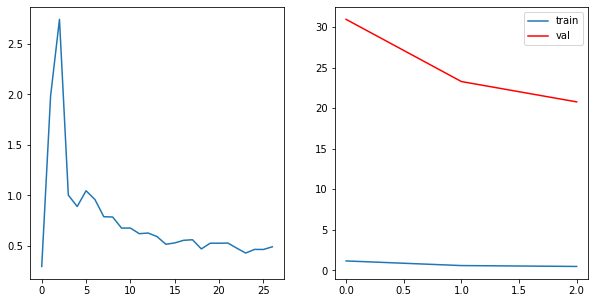

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4343, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4769, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3828, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4503, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.43814120163957154	     Validation Loss:6.911132920449248	 \ LR:0.01


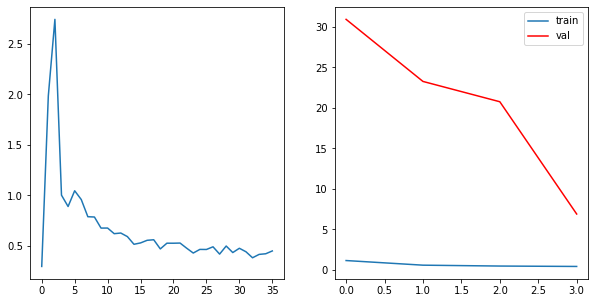

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4018, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3808, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4092, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4076, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.41191787904424315	     Validation Loss:2.0851949805084797	 \ LR:0.01


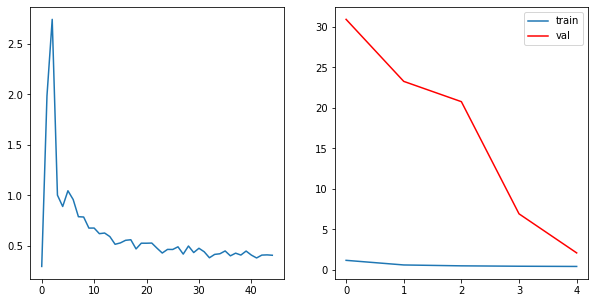

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3902, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3730, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3890, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.3928389964084728	     Validation Loss:0.9102716990077878	 \ LR:0.01


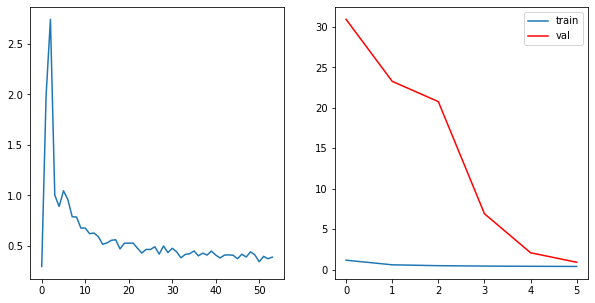

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4076, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3578, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3934, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3859, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.3879887833473834	     Validation Loss:0.7293282414238812	 \ LR:0.01


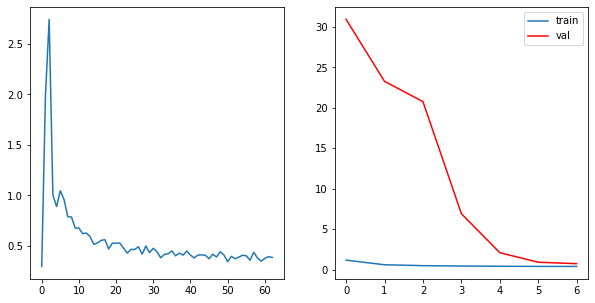

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3677, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3719, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3669, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3225, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3425, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.35004573258725735	     Validation Loss:0.5062988182658735	 \ LR:0.01


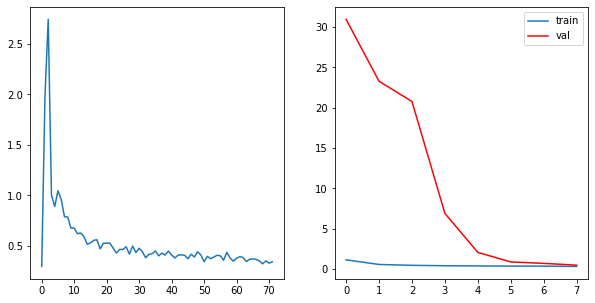

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3134, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3086, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.3315715321260095	     Validation Loss:0.5311616432196362	 \ LR:0.01


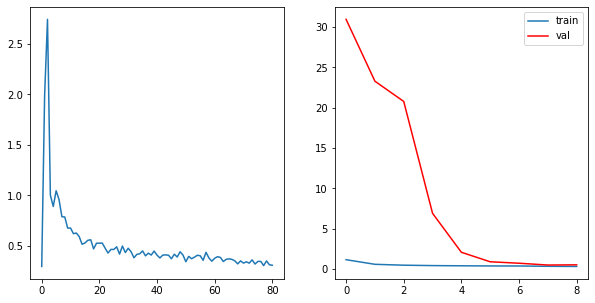

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3117, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3125, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3070, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2948, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2841, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3036, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.30769471521318625	     Validation Loss:0.43630024639622844	 \ LR:0.01


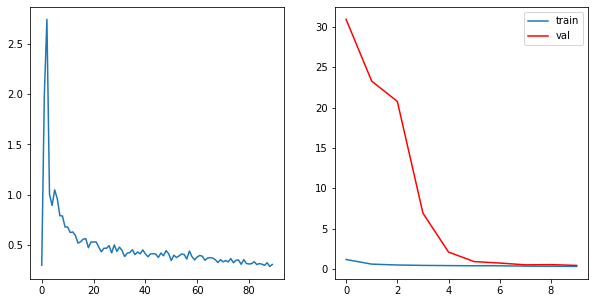

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3076, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3022, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.3085374464905939	     Validation Loss:0.4404485136353627	 \ LR:0.01


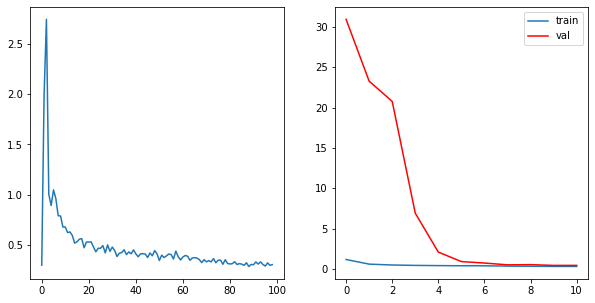

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2850, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2852, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2867, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3091, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2837, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2928, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.29791875351064195	     Validation Loss:0.3790961535348883	 \ LR:0.01


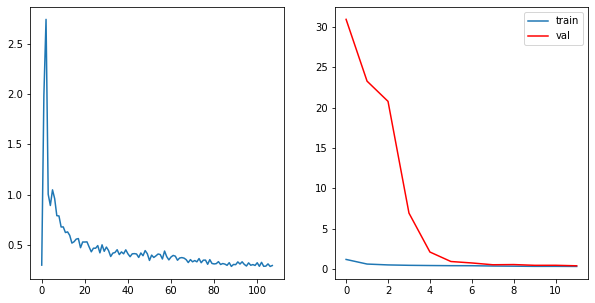

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2865, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2915, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2718, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3258, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2983, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.2955224566366369	     Validation Loss:0.4380490191523048	 \ LR:0.01


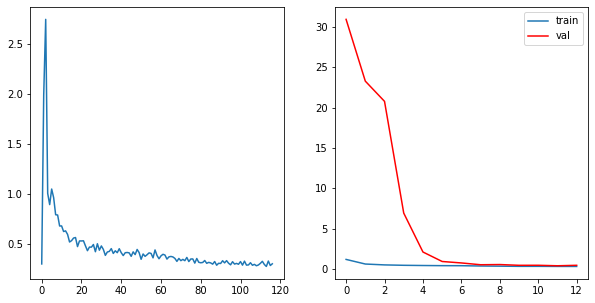

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2893, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3236, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3119, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3246, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3229, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3214, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.30567884955558344	     Validation Loss:0.39173216493573704	 \ LR:0.01


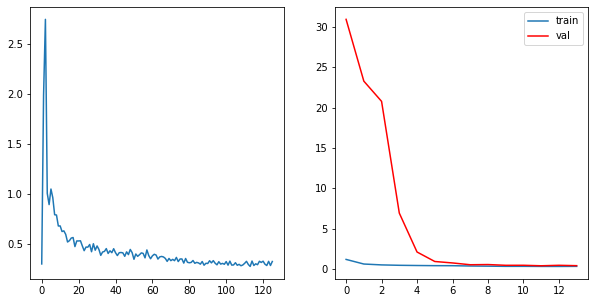

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2916, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3225, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2809, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3182, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2809, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2873, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.2956301846575662	     Validation Loss:0.3617411977485658	 \ LR:0.01


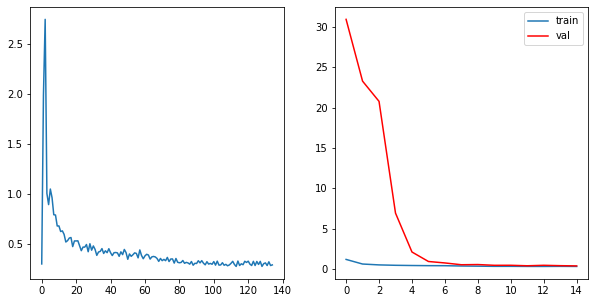

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3089, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3120, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2864, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2956, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2786, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.29530994302614005	     Validation Loss:0.36449851161383745	 \ LR:0.01


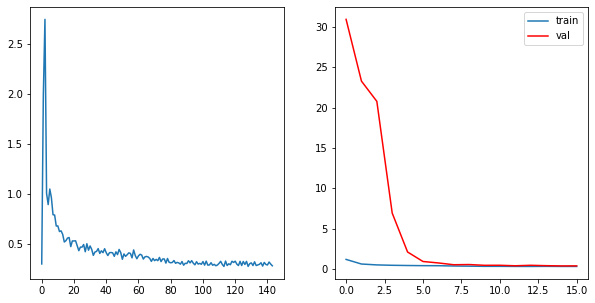

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2915, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2915, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2804, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3195, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2605, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.2867874950677919	     Validation Loss:0.345707821582043	 \ LR:0.01


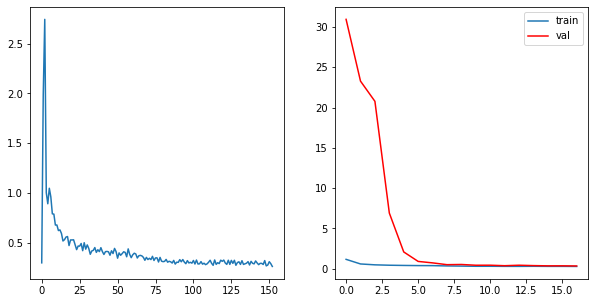

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2843, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2932, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2795, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2718, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2748, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.28087302015098087	     Validation Loss:0.39292302830758846	 \ LR:0.01


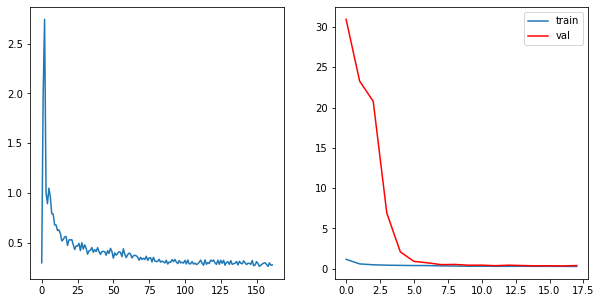

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2886, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2698, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2696, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2848, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2694, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.2777538984586719	     Validation Loss:0.3592496444439897	 \ LR:0.01


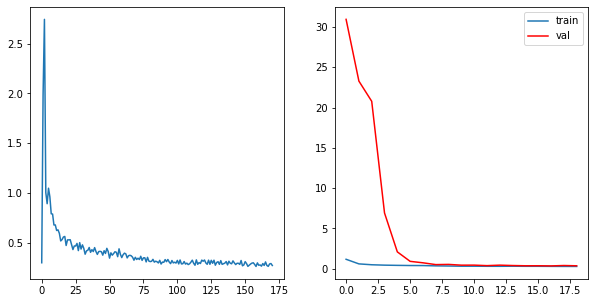

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2774, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2649, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2932, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2703, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2612, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2721, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2698, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.2762834735311149	     Validation Loss:0.37316485036618924	 \ LR:0.01


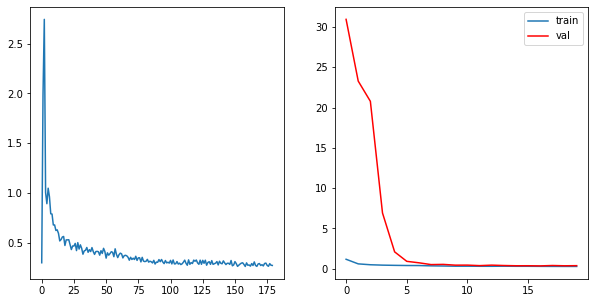

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2826, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3764, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3412, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2860, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3182, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2897, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.30917440559342013	     Validation Loss:0.6057787656872895	 \ LR:0.001


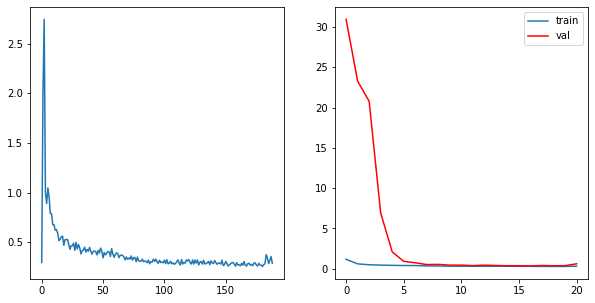

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3352, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2812, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3083, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3024, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2797, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2863, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.2984086793092077	     Validation Loss:0.3823113848523898	 \ LR:0.001


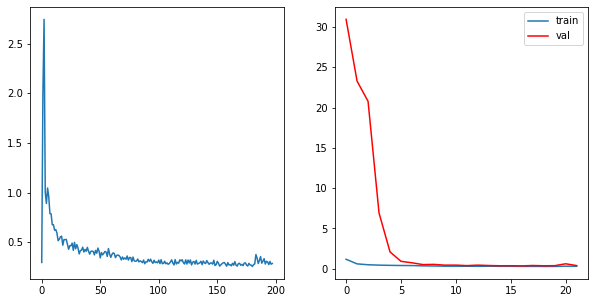

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2821, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2651, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3137, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2831, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2680, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.283398485301225	     Validation Loss:0.33479837364515647	 \ LR:0.001


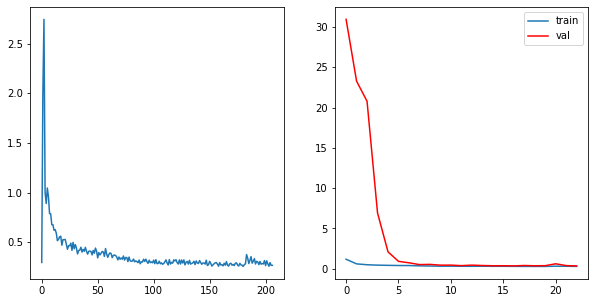

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2723, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2913, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2663, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2850, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2808, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2599, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.26842972997731096	     Validation Loss:0.32628356932641306	 \ LR:0.001


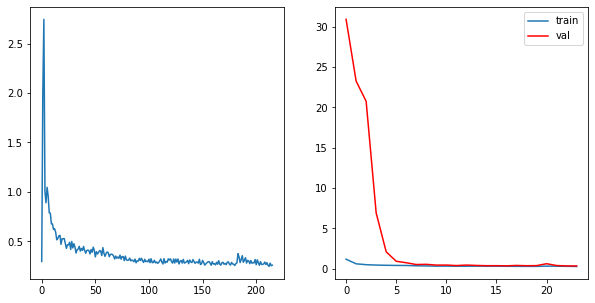

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2833, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2733, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2586, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2495, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.2601176858428482	     Validation Loss:0.3231091618823379	 \ LR:0.001


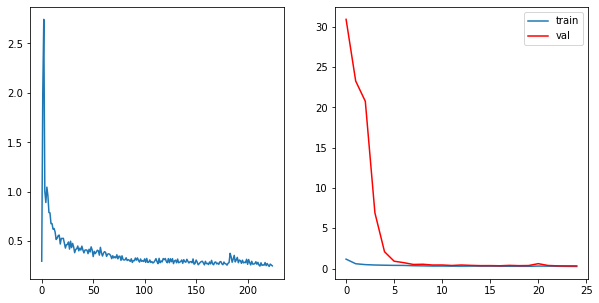

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2733, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2634, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2734, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2515, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.2555914262102704	     Validation Loss:0.3254699668309929	 \ LR:0.001


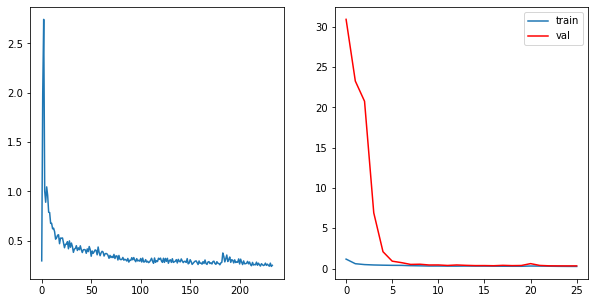

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2419, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2742, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.252387010059529	     Validation Loss:0.3203616953428943	 \ LR:0.001


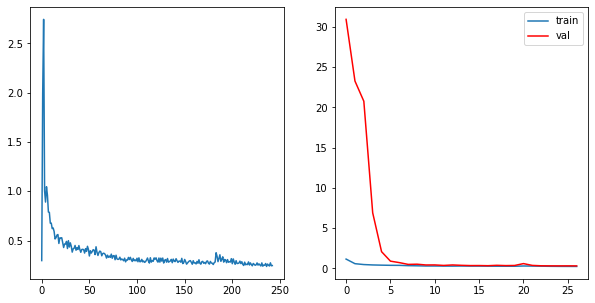

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2452, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2622, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2465, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.2508673091841391	     Validation Loss:0.3223782928981081	 \ LR:0.001


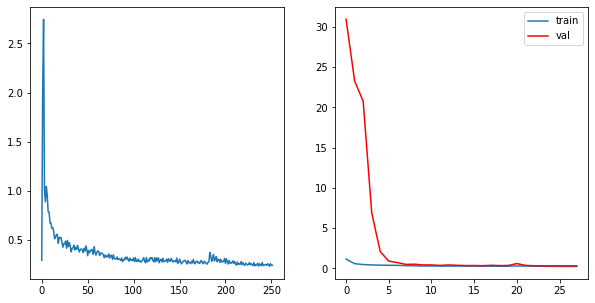

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2420, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2439, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.2468147860492857	     Validation Loss:0.31426497340531395	 \ LR:0.001


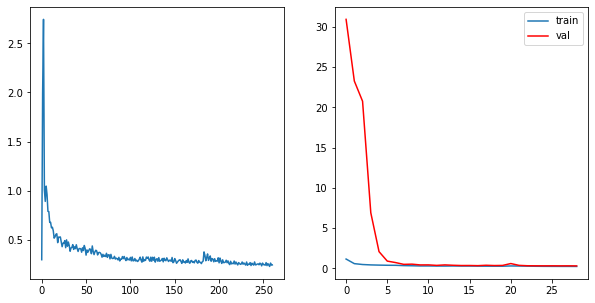

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2339, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2366, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2367, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2411, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.24608292955880934	     Validation Loss:0.30997935646918723	 \ LR:0.001


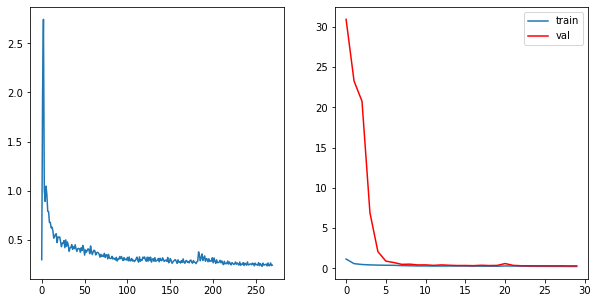

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2445, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2415, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2337, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2691, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.24528570914743916	     Validation Loss:0.31512118268952966	 \ LR:0.001


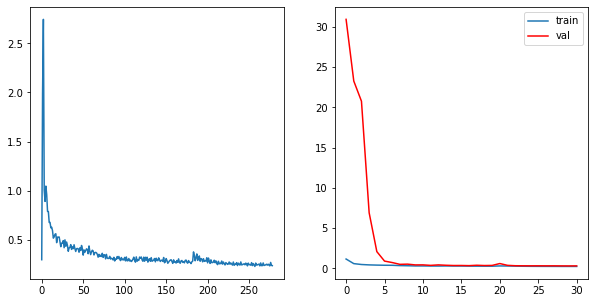

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2393, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.2443873872335043	     Validation Loss:0.3166344571979512	 \ LR:0.001


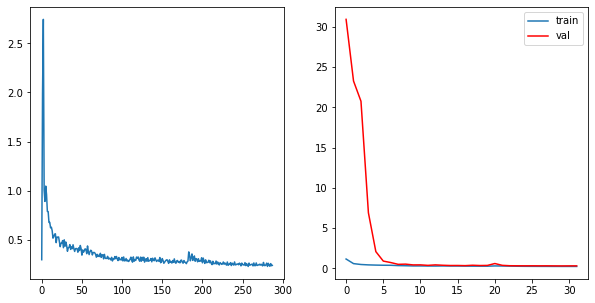

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2323, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.24350108415167437	     Validation Loss:0.3155781290624556	 \ LR:0.001


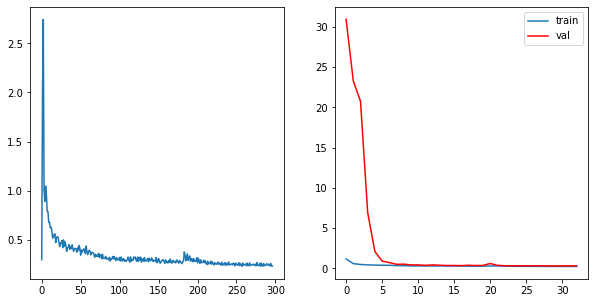

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2371, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2316, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2275, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2416, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.24220666803119315	     Validation Loss:0.317404727757119	 \ LR:0.0001


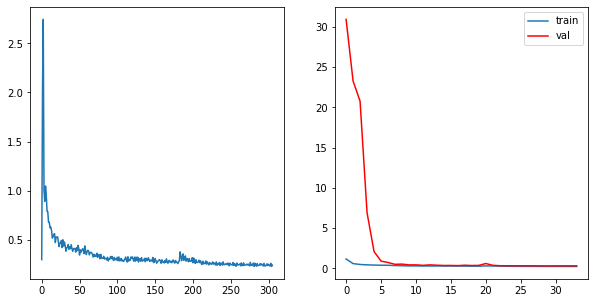

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2262, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2367, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.23908630760876745	     Validation Loss:0.31530453642820283	 \ LR:0.0001


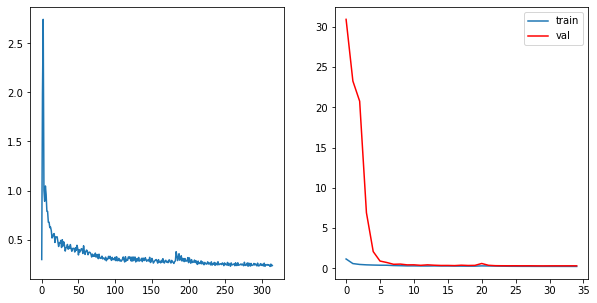

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2343, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.23994281987055086	     Validation Loss:0.3180372024787153	 \ LR:0.0001


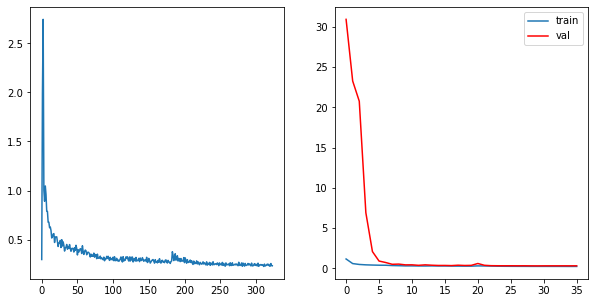

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2240, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2360, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.23924569544492913	     Validation Loss:0.3075353275098846	 \ LR:0.0001


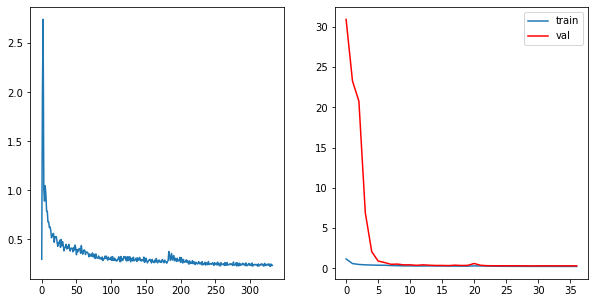

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2506, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2311, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2350, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.23895062872775819	     Validation Loss:0.3172823997370708	 \ LR:0.0001


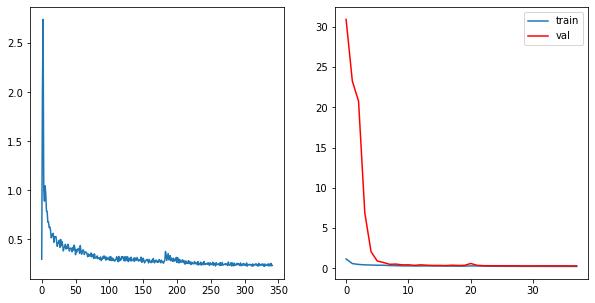

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.23842108891053307	     Validation Loss:0.31332838970664506	 \ LR:0.0001


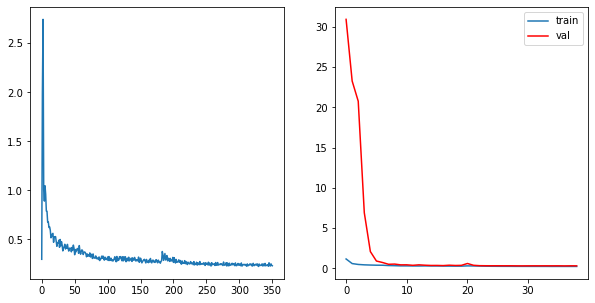

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.23896564308785676	     Validation Loss:0.3157571183734159	 \ LR:0.0001


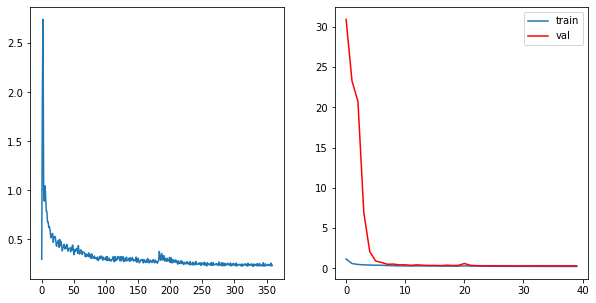

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2445, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2322, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.2392672294989805	     Validation Loss:0.31549423234598684	 \ LR:1e-05


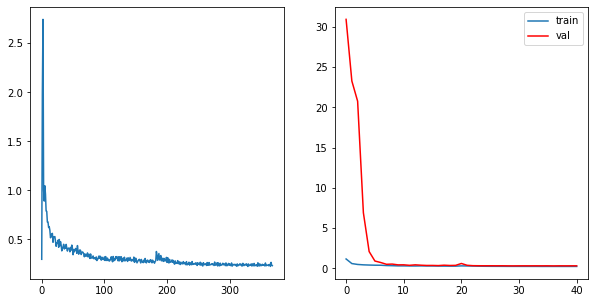

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2371, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2578, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2307, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2349, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.23989229325627826	     Validation Loss:0.3156595492749618	 \ LR:1e-05


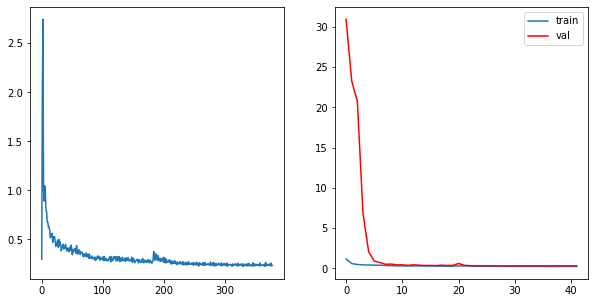

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2420, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2336, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.2377688460231887	     Validation Loss:0.3174759083757663	 \ LR:1e-05


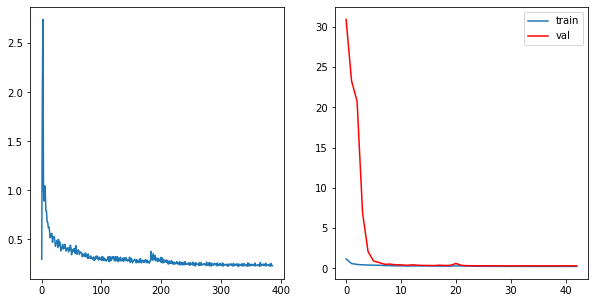

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2341, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.23929018081632508	     Validation Loss:0.3144472087588052	 \ LR:1e-05


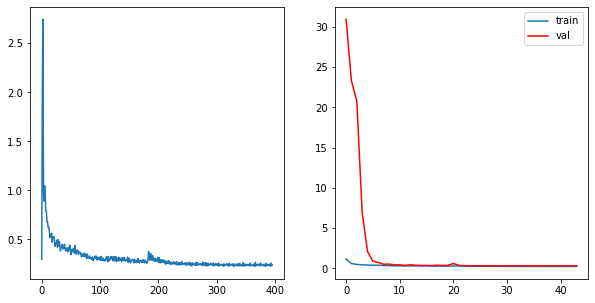

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2359, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2531, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2275, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2402, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.24135753532193227	     Validation Loss:0.3160043877763577	 \ LR:1.0000000000000002e-06


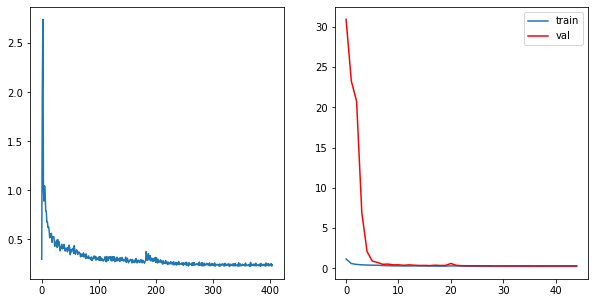

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2466, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2272, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2394, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.24075412591722178	     Validation Loss:0.315069367916431	 \ LR:1.0000000000000002e-06


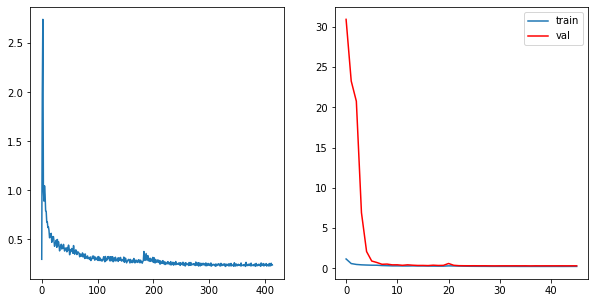

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2352, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2316, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2390, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.23886228388304748	     Validation Loss:0.3130726414606228	 \ LR:1.0000000000000002e-06


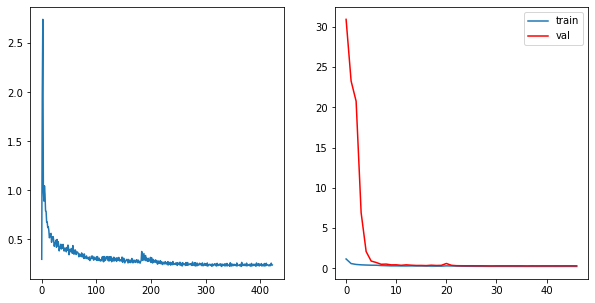

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2582, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2337, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.23972887074689705	     Validation Loss:0.30839376428682413	 \ LR:1.0000000000000002e-06


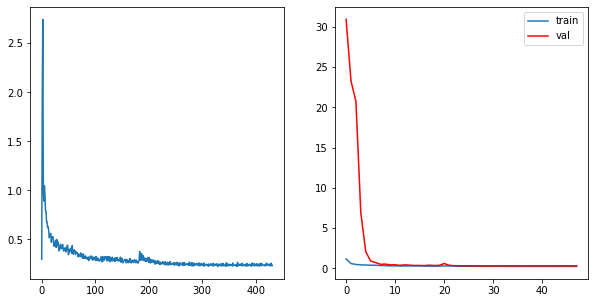

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2307, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2295, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2384, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.23974012713045484	     Validation Loss:0.3171568837700556	 \ LR:1.0000000000000002e-07


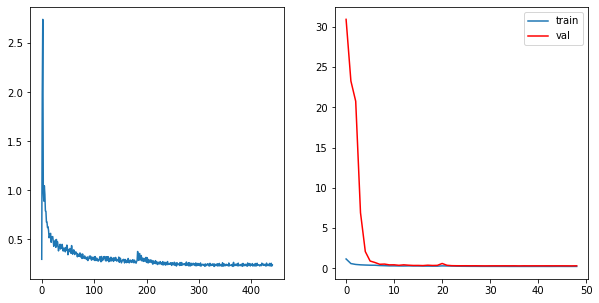

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2378, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.2397343531473434	     Validation Loss:0.31399645727762454	 \ LR:1.0000000000000002e-07


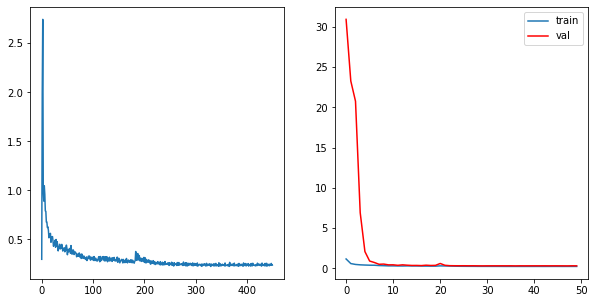

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2373, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2337, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2390, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.240833824297525	     Validation Loss:0.31882930809648724	 \ LR:1.0000000000000002e-07


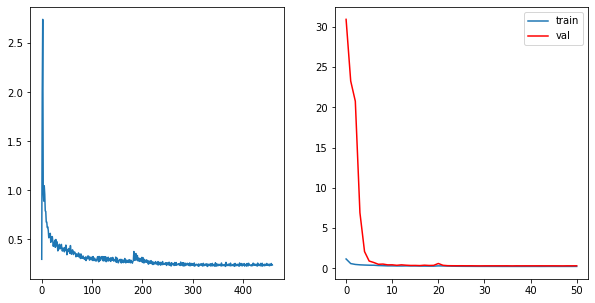

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2351, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2308, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.23861401550266173	     Validation Loss:0.3160359645132273	 \ LR:1.0000000000000002e-07


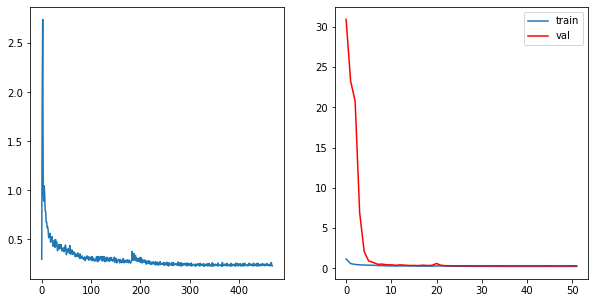

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2348, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2355, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.24142051188898986	     Validation Loss:0.3107057509179552	 \ LR:1.0000000000000004e-08


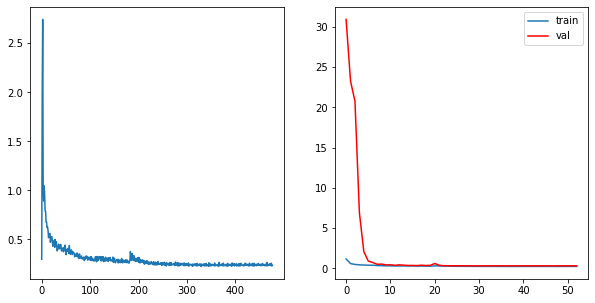

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2242, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2367, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2287, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.23874908874851475	     Validation Loss:0.3155087549031243	 \ LR:1.0000000000000004e-08


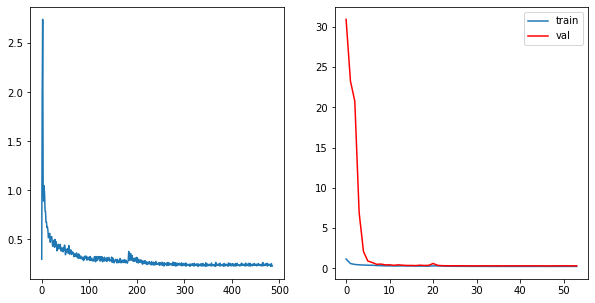

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2327, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2308, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':  "аугументация + HSV "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_HSV_with_aug_epoch_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()


  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(7.3199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(3.9158, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(2.3604, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.6971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8888, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7516, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 2.2713143231315542	     Validation Loss:0.8343713612160109	 \ LR:0.001


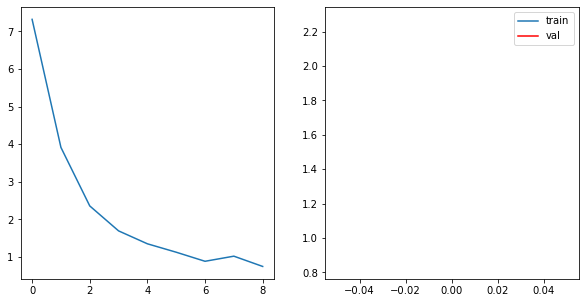

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6806, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6864, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6048, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5462, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.6437932049131194	     Validation Loss:0.5768633669932358	 \ LR:0.001


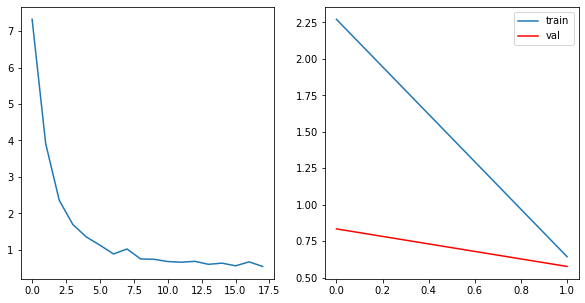

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5346, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4924, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5076, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4437, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.49942988918090286	     Validation Loss:0.4508069931644673	 \ LR:0.001


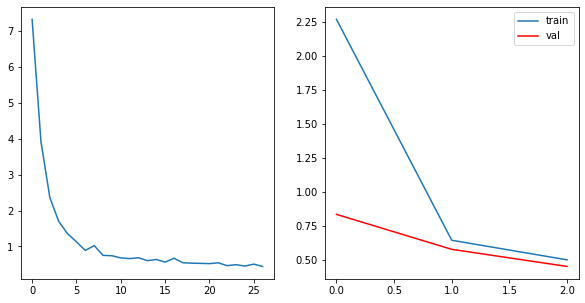

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4458, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3797, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3864, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.42064953136616196	     Validation Loss:0.3928302908781984	 \ LR:0.001


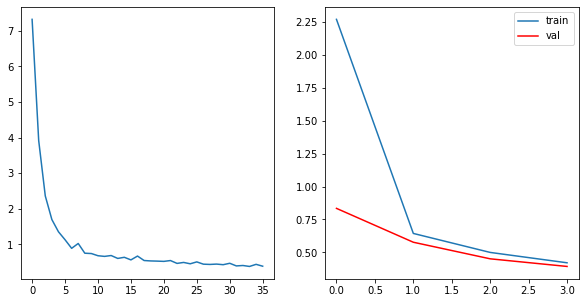

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3826, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3859, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3682, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3686, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3358, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.37215910853917983	     Validation Loss:0.3480286171651726	 \ LR:0.001


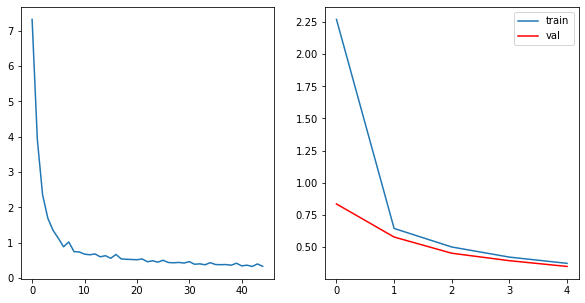

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3372, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3858, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3632, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3078, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.33556854785597434	     Validation Loss:0.3239922806403966	 \ LR:0.001


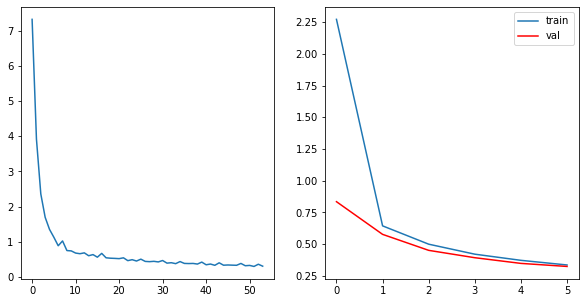

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3148, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3600, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2952, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3058, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2919, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.31047069782309206	     Validation Loss:0.30266285197043	 \ LR:0.001


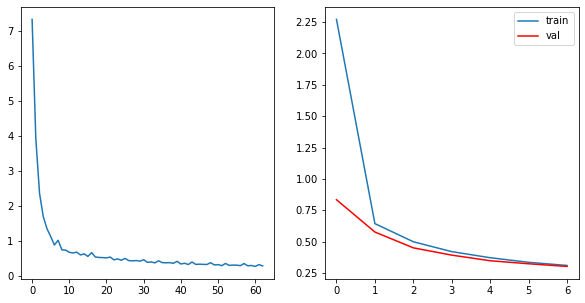

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2912, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2926, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2810, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2834, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2808, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.28878407132111716	     Validation Loss:0.29523459665312335	 \ LR:0.001


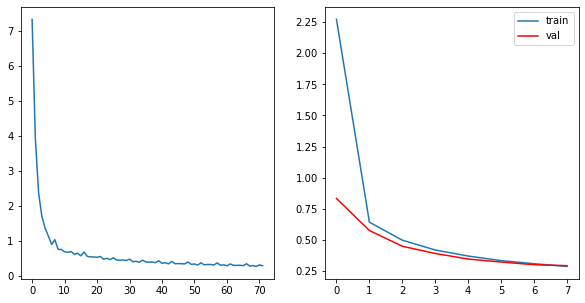

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2786, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2666, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3213, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2680, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.27357098239232575	     Validation Loss:0.291203722492562	 \ LR:0.001


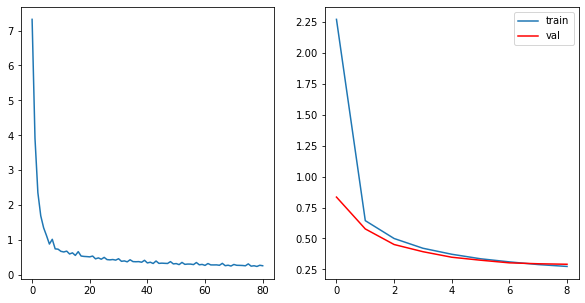

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2533, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.2601742668354341	     Validation Loss:0.28023443312952173	 \ LR:0.001


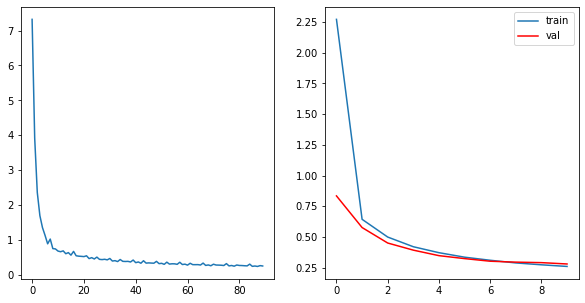

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2952, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.2504049247218474	     Validation Loss:0.26968582361166343	 \ LR:0.001


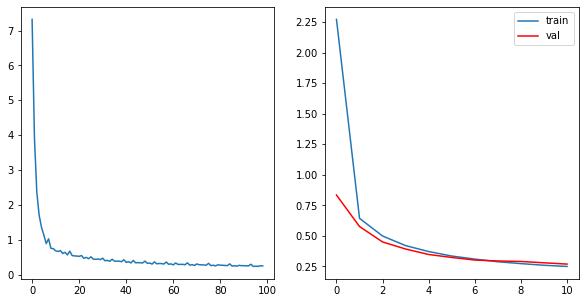

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2495, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.24285236722525566	     Validation Loss:0.2666520886928073	 \ LR:0.001


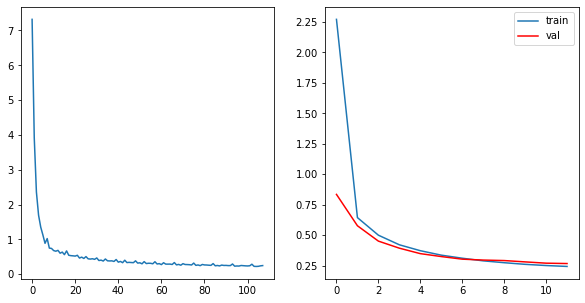

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2359, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2827, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2134, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2557, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.23767300295225466	     Validation Loss:0.29216708668817626	 \ LR:0.001


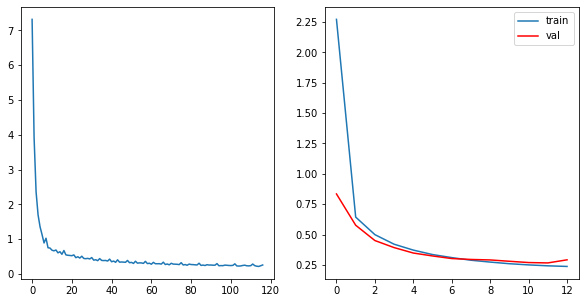

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2689, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2364, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.2330252350391724	     Validation Loss:0.3182911152066437	 \ LR:0.001


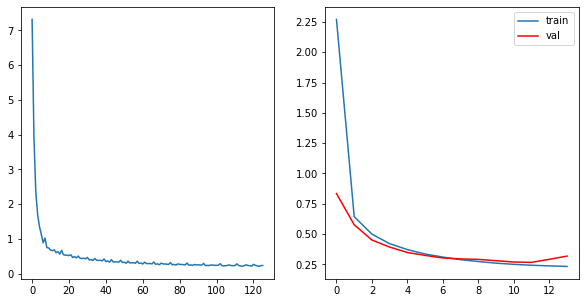

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2122, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2198, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2177, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.23099366423844062	     Validation Loss:0.2725790952968922	 \ LR:0.001


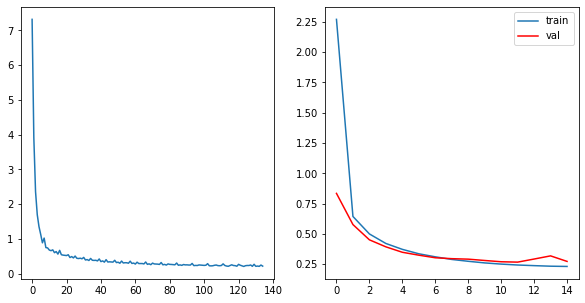

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2091, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2759, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2010, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2071, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.22012248855151345	     Validation Loss:0.25106828103333356	 \ LR:0.001


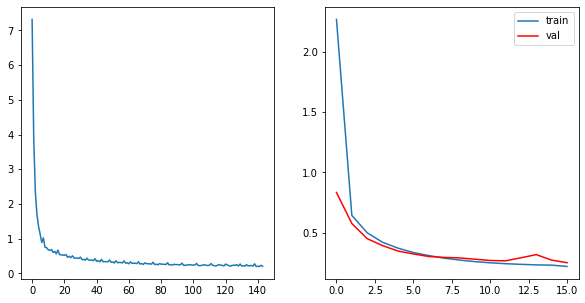

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2110, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1927, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2111, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2010, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.21511269009685866	     Validation Loss:0.23847549586162872	 \ LR:0.001


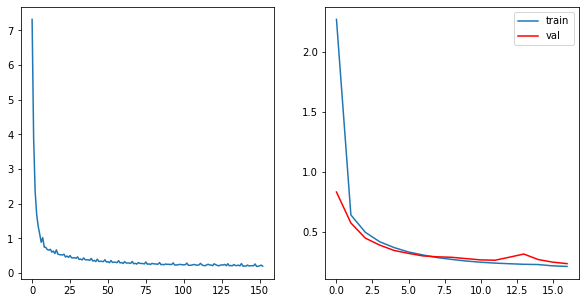

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2073, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2028, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1913, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2195, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2036, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.20799552428955054	     Validation Loss:0.23634105482182785	 \ LR:0.001


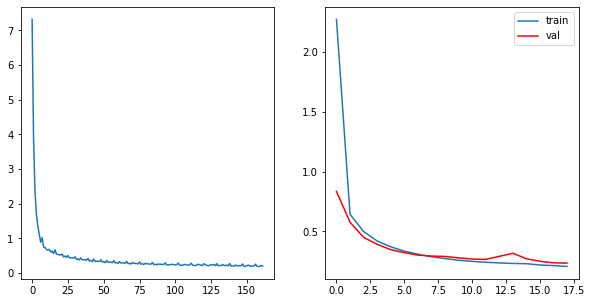

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2016, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1923, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1974, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.2060126675756313	     Validation Loss:0.2292104147240411	 \ LR:0.001


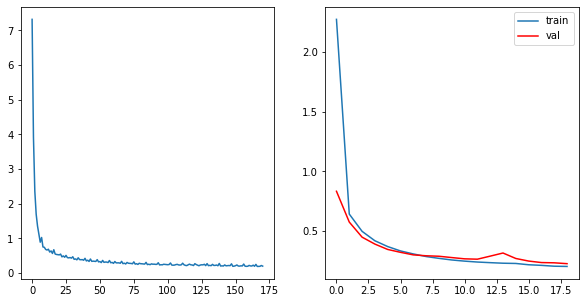

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1917, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1857, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1828, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1830, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2097, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1977, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.19861019365139881	     Validation Loss:0.21722414105435908	 \ LR:0.001


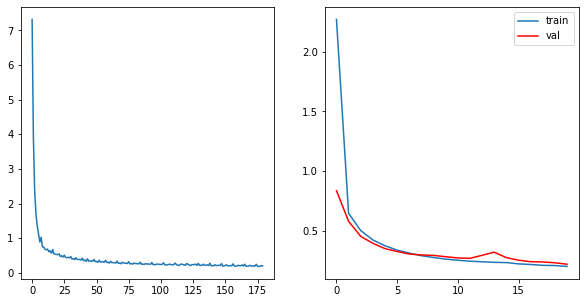

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1854, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1826, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1796, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1911, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.1942178890994261	     Validation Loss:0.2181321852411355	 \ LR:0.001


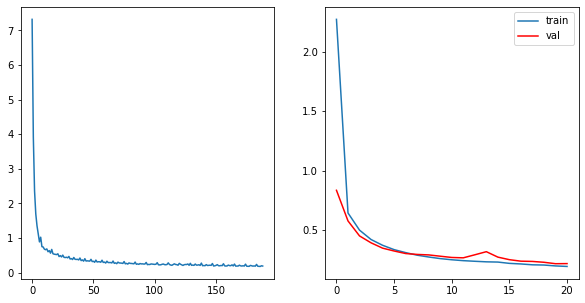

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1876, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2309, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1875, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1797, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1772, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1906, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1888, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.1904671636002962	     Validation Loss:0.22695176382234616	 \ LR:0.001


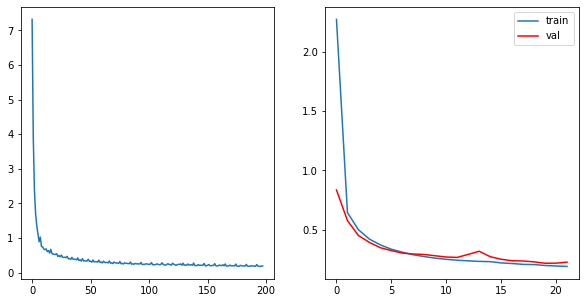

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1831, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1788, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1923, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1852, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.1882018521695149	     Validation Loss:0.2265920149931302	 \ LR:0.001


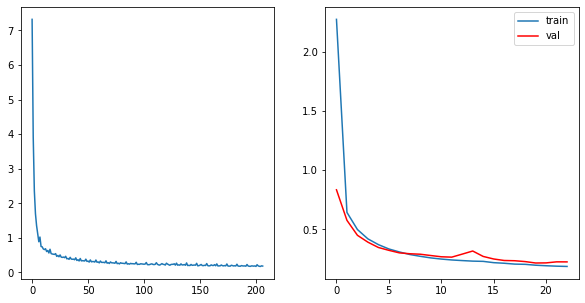

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1829, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1925, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1748, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1859, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1799, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1892, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1740, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.18588032593777284	     Validation Loss:0.23662411405565234	 \ LR:0.0001


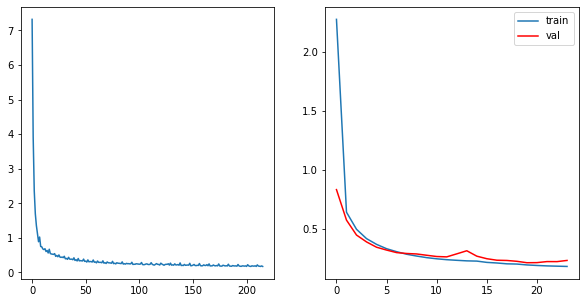

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1830, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2215, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1664, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1671, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1769, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1687, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.1825899387311124	     Validation Loss:0.20817859187834195	 \ LR:0.0001


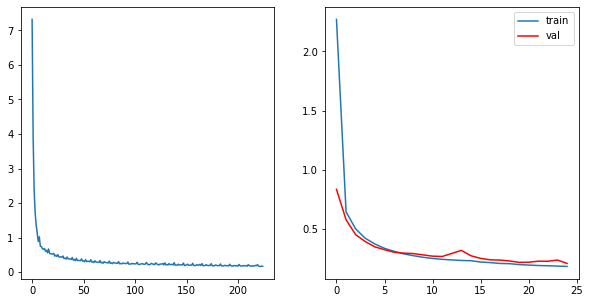

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1759, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2025, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1611, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1649, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1826, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1708, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.17352837246922498	     Validation Loss:0.20867100341959835	 \ LR:0.0001


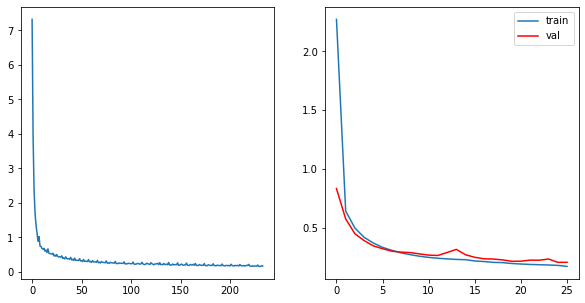

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1957, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1617, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1771, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1658, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.17049238710990433	     Validation Loss:0.20979156617400596	 \ LR:0.0001


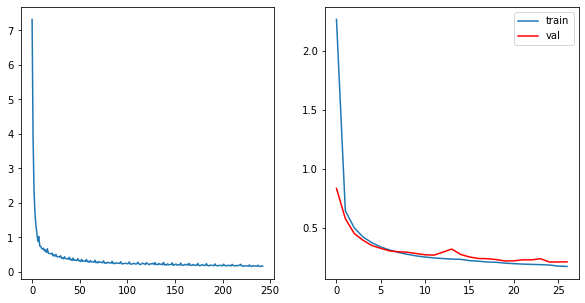

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1697, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1667, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1644, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.16906608808892518	     Validation Loss:0.2087669084916285	 \ LR:0.0001


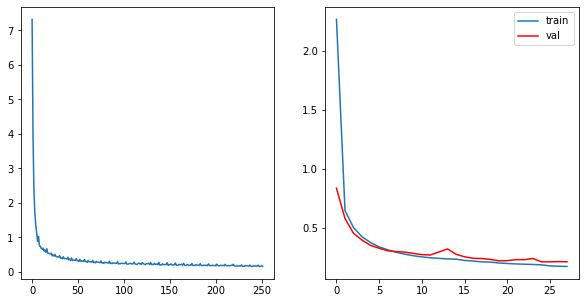

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1667, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1744, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1635, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.1677391056218801	     Validation Loss:0.2085389396999251	 \ LR:1e-05


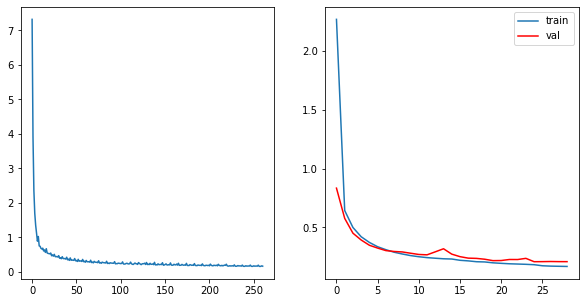

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1677, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1924, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1738, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.1670379816287714	     Validation Loss:0.20889072074482803	 \ LR:1e-05


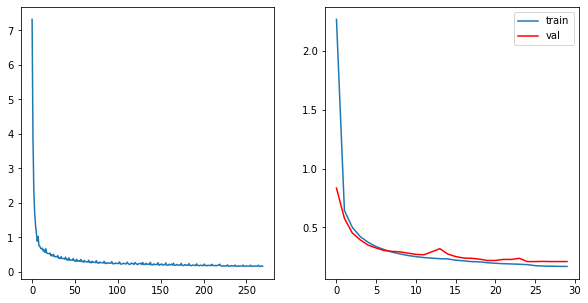

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1669, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1675, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1922, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1626, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.16691102035393107	     Validation Loss:0.20906356891033898	 \ LR:1e-05


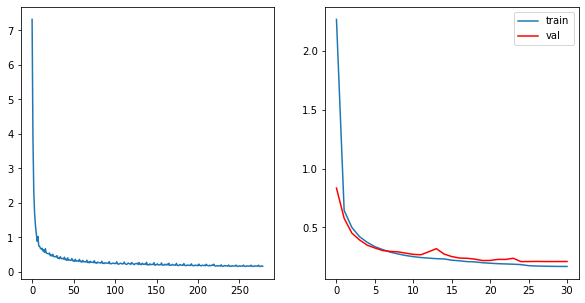

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1666, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1675, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1600, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1734, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1624, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.16679679636686462	     Validation Loss:0.20914650949060606	 \ LR:1e-05


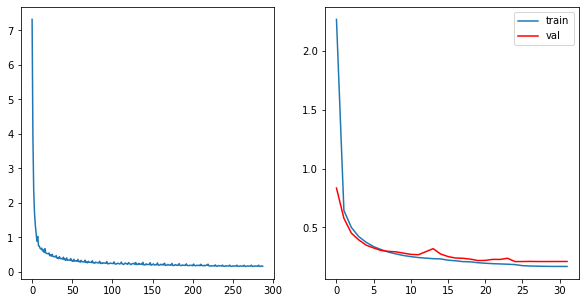

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1664, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1674, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1629, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1733, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1623, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.16670378471559433	     Validation Loss:0.20919382014078433	 \ LR:1.0000000000000002e-06


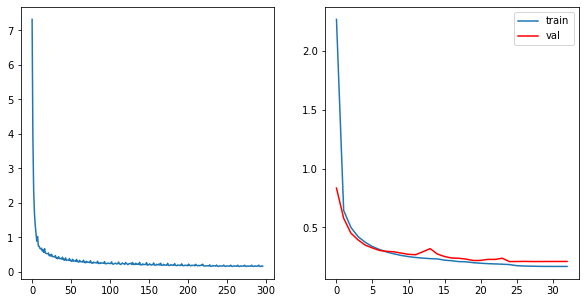

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.16663159527911253	     Validation Loss:0.2092139772775239	 \ LR:1.0000000000000002e-06


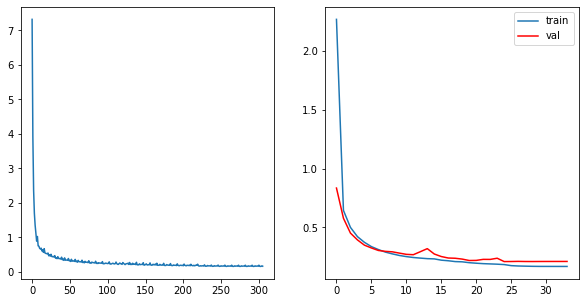

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.16662352334503786	     Validation Loss:0.20922300125995966	 \ LR:1.0000000000000002e-06


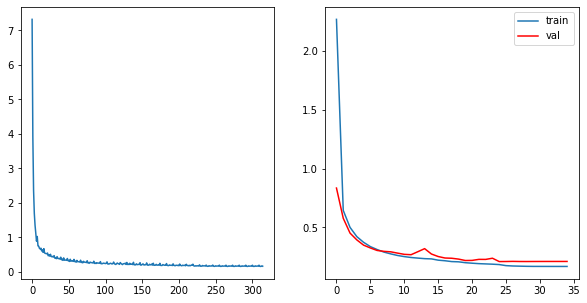

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.16661539622916763	     Validation Loss:0.20922773701642072	 \ LR:1.0000000000000002e-06


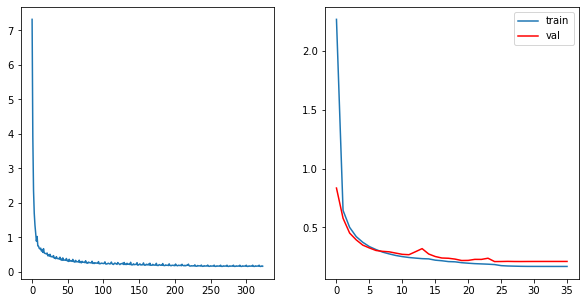

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.16660720875080415	     Validation Loss:0.2092308186516808	 \ LR:1.0000000000000002e-07


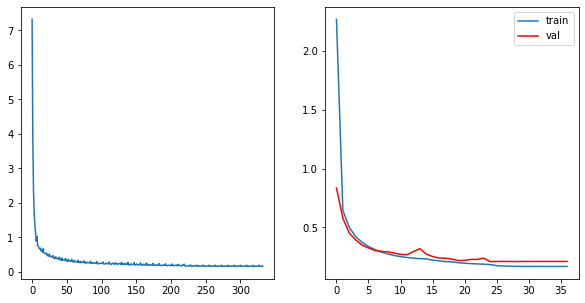

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.1665997487401384	     Validation Loss:0.2092330533944059	 \ LR:1.0000000000000002e-07


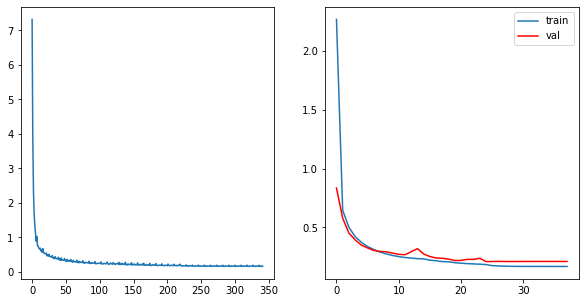

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.16659891553294606	     Validation Loss:0.2092340681246502	 \ LR:1.0000000000000002e-07


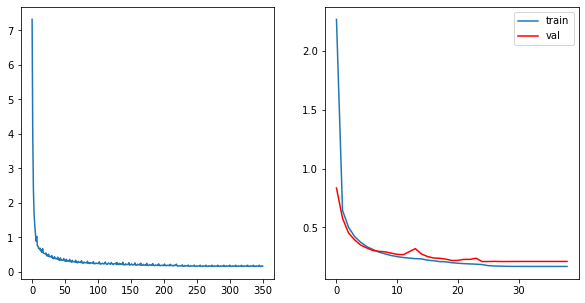

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.1665980784502984	     Validation Loss:0.2092345819583553	 \ LR:1.0000000000000002e-07


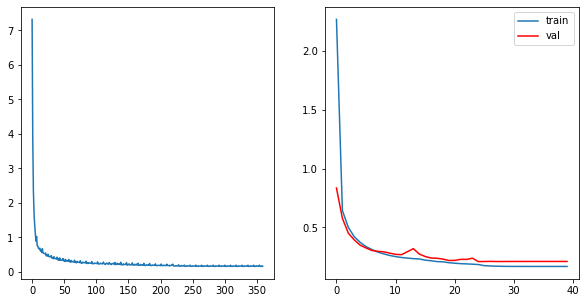

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.16659723152611672	     Validation Loss:0.20923495698503744	 \ LR:1.0000000000000004e-08


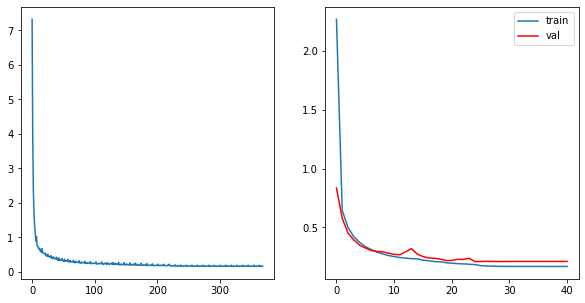

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.16659646097611536	     Validation Loss:0.20923519769307922	 \ LR:1.0000000000000004e-08


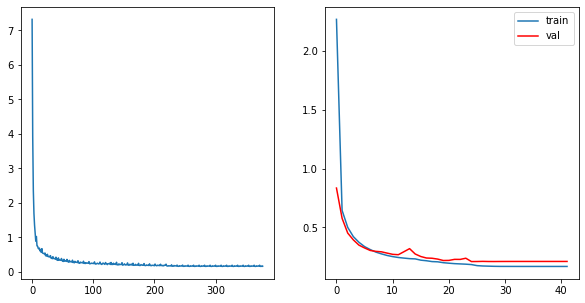

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.1665964030017782	     Validation Loss:0.20923532083081708	 \ LR:1.0000000000000004e-08


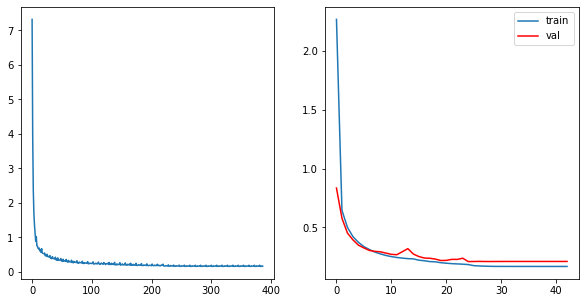

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.1665963448201847	     Validation Loss:0.2092353809021563	 \ LR:1.0000000000000004e-08


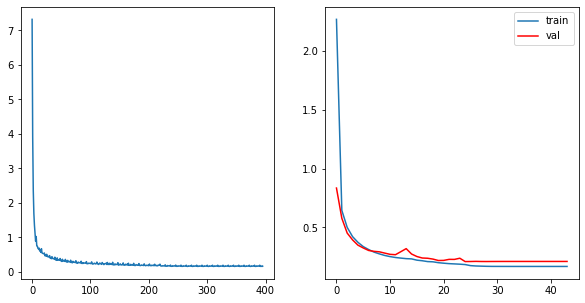

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.16659628643642876	     Validation Loss:0.20923542423479832	 \ LR:1.0000000000000004e-08


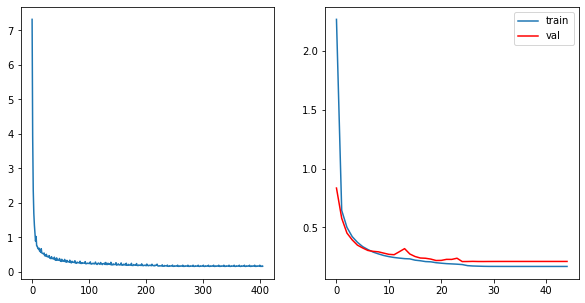

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.16659622754971404	     Validation Loss:0.20923544775800876	 \ LR:1.0000000000000004e-08


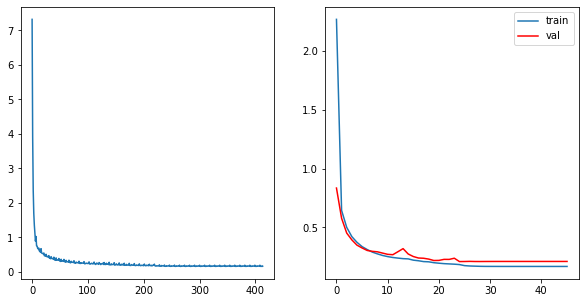

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.16659616755247617	     Validation Loss:0.2092354731347	 \ LR:1.0000000000000004e-08


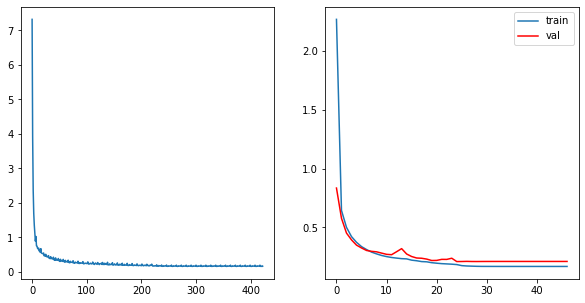

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.16659610504353284	     Validation Loss:0.20923550686607753	 \ LR:1.0000000000000004e-08


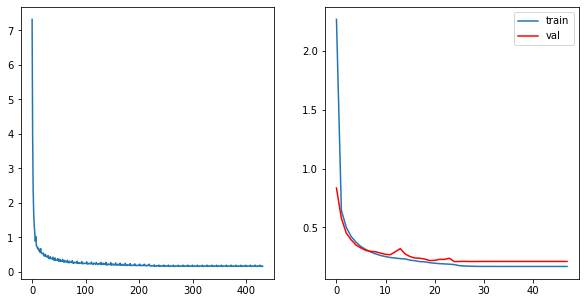

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.16659604274441328	     Validation Loss:0.2092355295982089	 \ LR:1.0000000000000004e-08


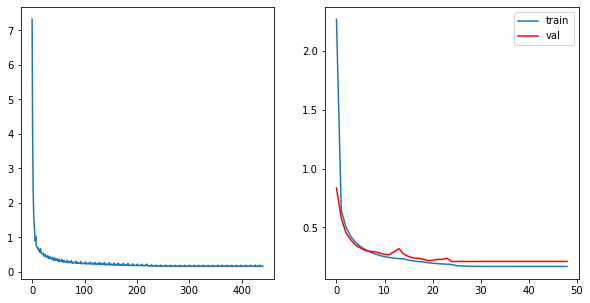

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.16659597953794458	     Validation Loss:0.2092355578892975	 \ LR:1.0000000000000004e-08


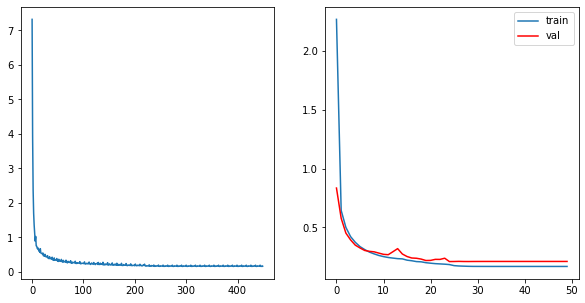

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.16659591529860818	     Validation Loss:0.20923558819816201	 \ LR:1.0000000000000004e-08


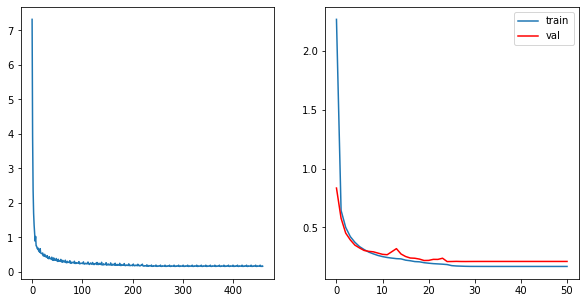

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.16659585038055963	     Validation Loss:0.20923560728669463	 \ LR:1.0000000000000004e-08


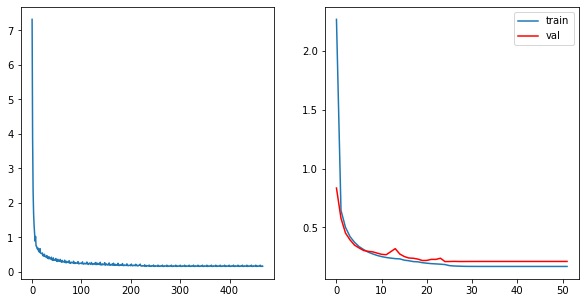

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.1665957861482332	     Validation Loss:0.20923564647863116	 \ LR:1.0000000000000004e-08


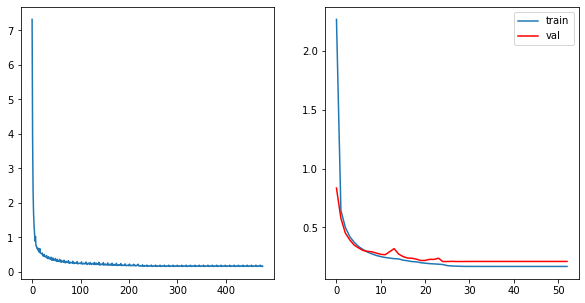

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.16659571959958933	     Validation Loss:0.2092356749232107	 \ LR:1.0000000000000004e-08


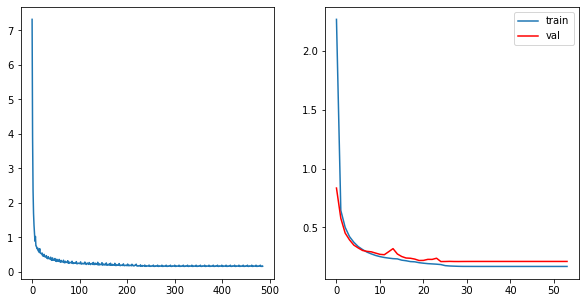

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.16659565078791833	     Validation Loss:0.20923569322549443	 \ LR:1.0000000000000004e-08


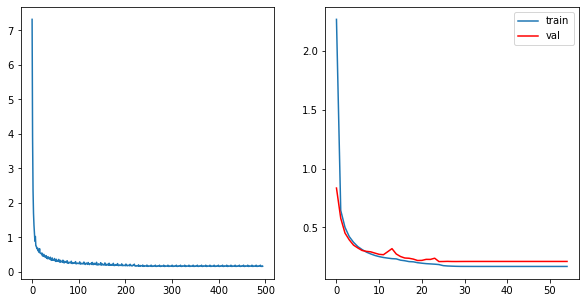

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.16659558257746668	     Validation Loss:0.2092357318071286	 \ LR:1.0000000000000004e-08


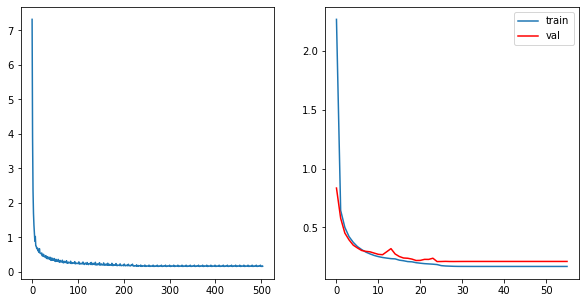

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.1665955125286158	     Validation Loss:0.20923575564627703	 \ LR:1.0000000000000004e-08


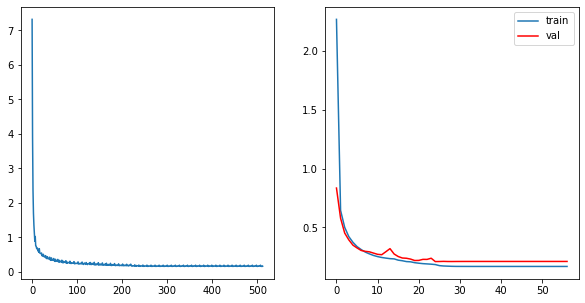

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 57	 \Training Loss: 0.16659544379955044	     Validation Loss:0.20923578787257047	 \ LR:1.0000000000000004e-08


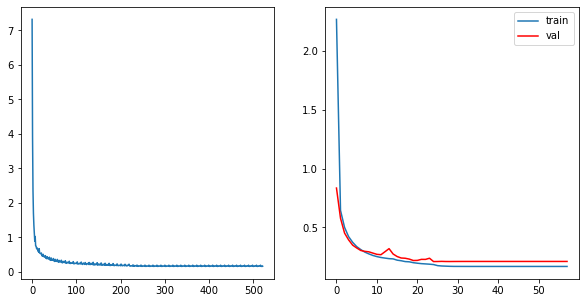

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 58	 \Training Loss: 0.16659537252329681	     Validation Loss:0.20923582284972855	 \ LR:1.0000000000000004e-08


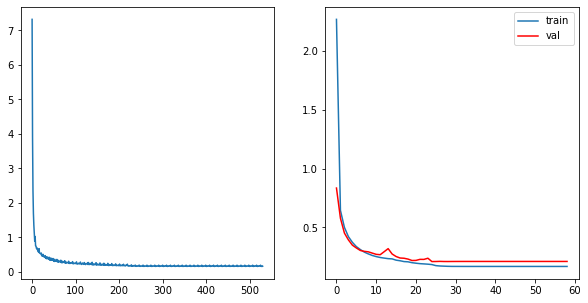

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 59	 \Training Loss: 0.1665953010634264	     Validation Loss:0.2092358518551407	 \ LR:1.0000000000000004e-08


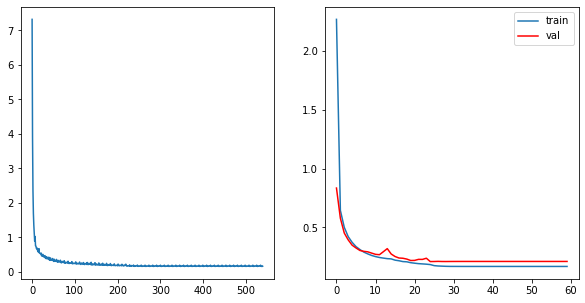

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 60	 \Training Loss: 0.16659522940802038	     Validation Loss:0.20923587149939435	 \ LR:1.0000000000000004e-08


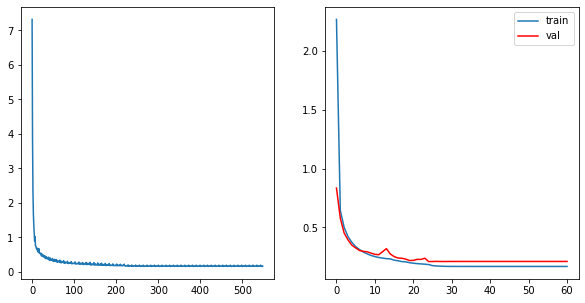

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 61	 \Training Loss: 0.16659515565181768	     Validation Loss:0.20923589950967003	 \ LR:1.0000000000000004e-08


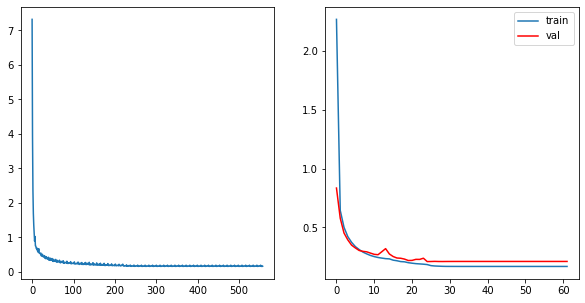

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 62	 \Training Loss: 0.16659508119563343	     Validation Loss:0.20923591783593218	 \ LR:1.0000000000000004e-08


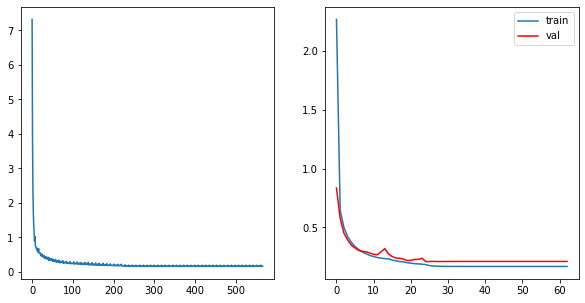

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 63	 \Training Loss: 0.16659500706395725	     Validation Loss:0.2092359622319456	 \ LR:1.0000000000000004e-08


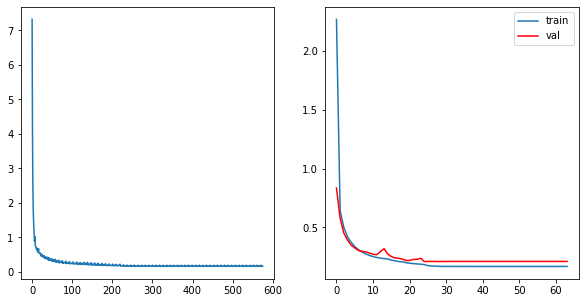

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 64	 \Training Loss: 0.16659493169603404	     Validation Loss:0.2092359949905198	 \ LR:1.0000000000000004e-08


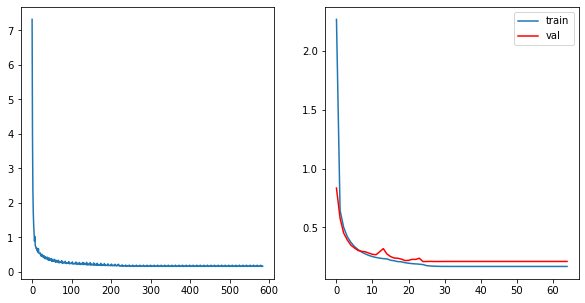

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 65	 \Training Loss: 0.1665948563165593	     Validation Loss:0.20923602382182552	 \ LR:1.0000000000000004e-08


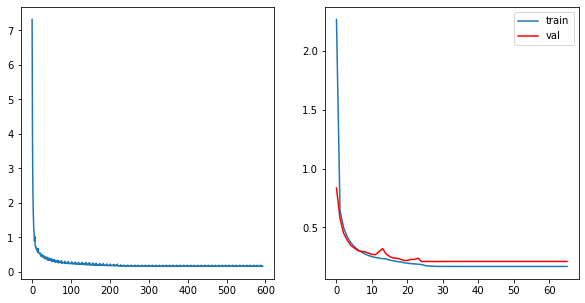

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 66	 \Training Loss: 0.16659477921901333	     Validation Loss:0.20923604963776846	 \ LR:1.0000000000000004e-08


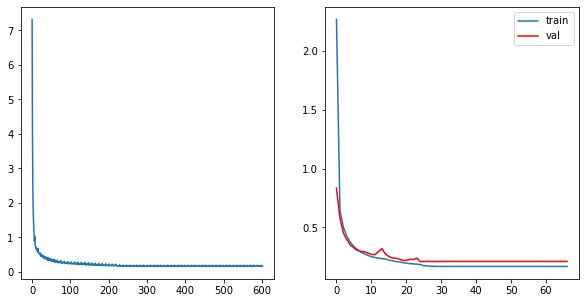

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 67	 \Training Loss: 0.16659470214444203	     Validation Loss:0.20923609351856245	 \ LR:1.0000000000000004e-08


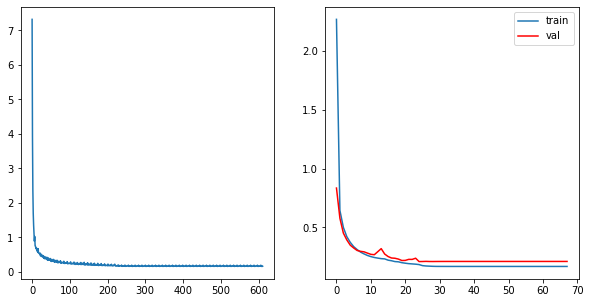

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 68	 \Training Loss: 0.1665946232993425	     Validation Loss:0.2092361280696127	 \ LR:1.0000000000000004e-08


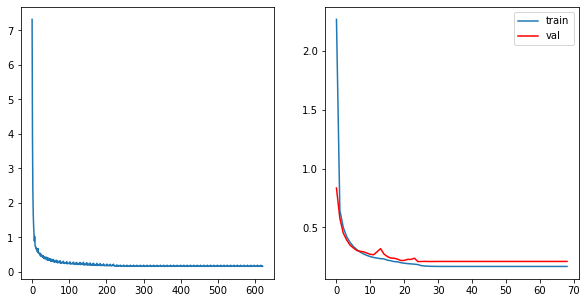

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 69	 \Training Loss: 0.1665945442704108	     Validation Loss:0.20923617049845786	 \ LR:1.0000000000000004e-08


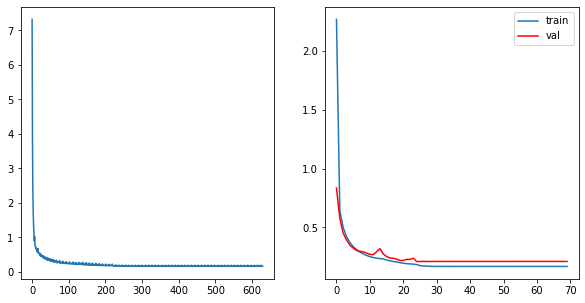

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 70	 \Training Loss: 0.16659446292255686	     Validation Loss:0.20923620569926302	 \ LR:1.0000000000000004e-08


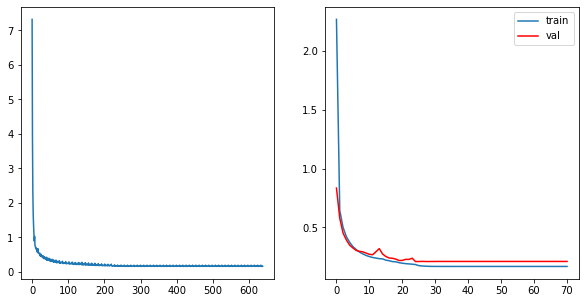

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 71	 \Training Loss: 0.166594381443243	     Validation Loss:0.20923622925728913	 \ LR:1.0000000000000004e-08


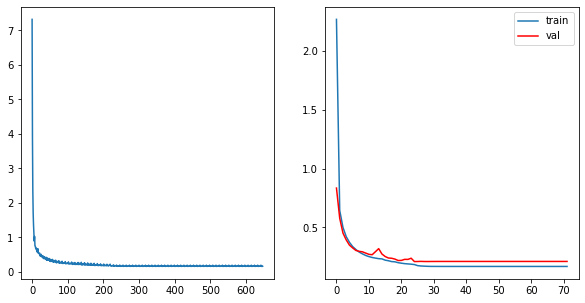

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 72	 \Training Loss: 0.16659430030357886	     Validation Loss:0.20923626074985383	 \ LR:1.0000000000000004e-08


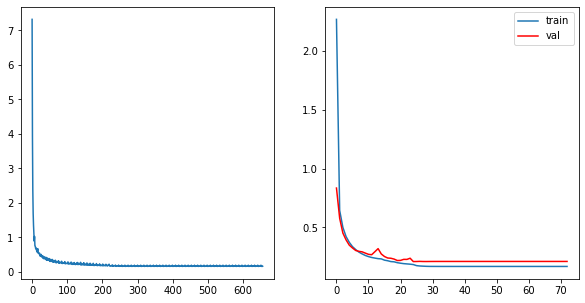

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 73	 \Training Loss: 0.1665942165432136	     Validation Loss:0.20923630692677878	 \ LR:1.0000000000000004e-08


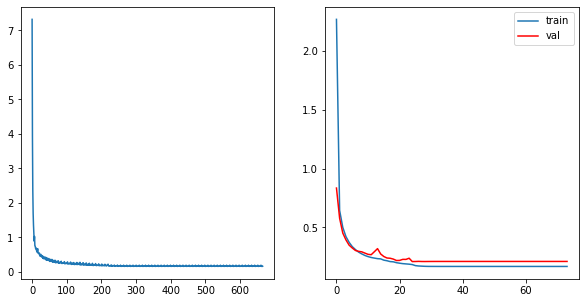

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 74	 \Training Loss: 0.16659413383582933	     Validation Loss:0.2092363425116943	 \ LR:1.0000000000000004e-08


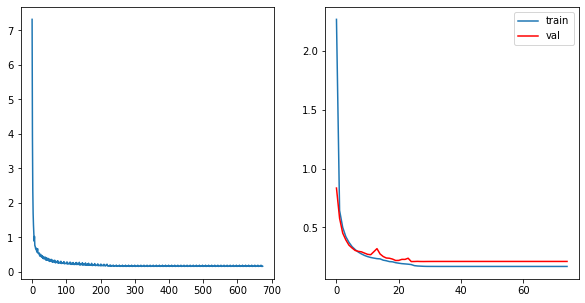

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 75	 \Training Loss: 0.16659404928372332	     Validation Loss:0.20923638470654252	 \ LR:1.0000000000000004e-08


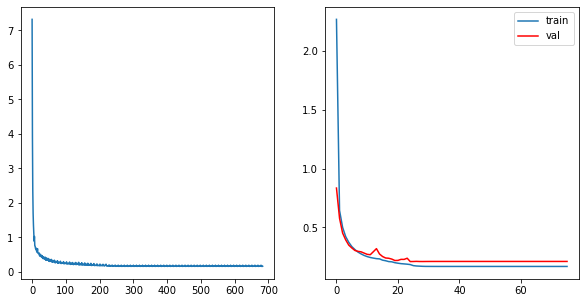

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1628, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 5 == 0:
        state = {'info':      "HSV "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_HSV_epoch_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    0.20923620569926302
    0.16659446292255686

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(6.8228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(3.9798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(2.1660, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3854, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0152, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8093, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 2.1337344965173126	     Validation Loss:2.2913008764967753	 \ LR:0.001


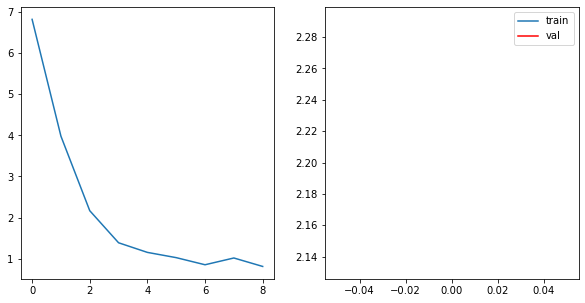

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.8104, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6343, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5958, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.6630717038146771	     Validation Loss:0.7144378103267748	 \ LR:0.001


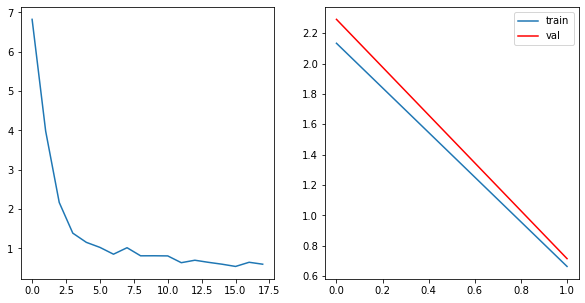

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5895, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5262, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4844, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4892, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.5436117083284573	     Validation Loss:0.5691897929059776	 \ LR:0.001


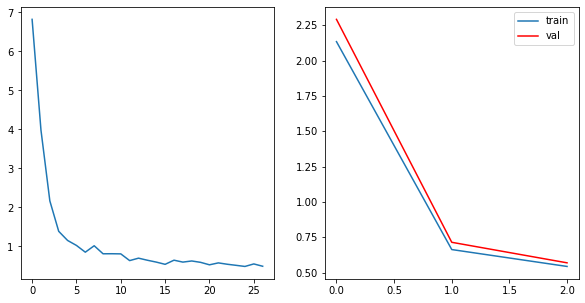

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5085, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4922, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4842, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4417, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.4745294933709302	     Validation Loss:0.5120514108732714	 \ LR:0.001


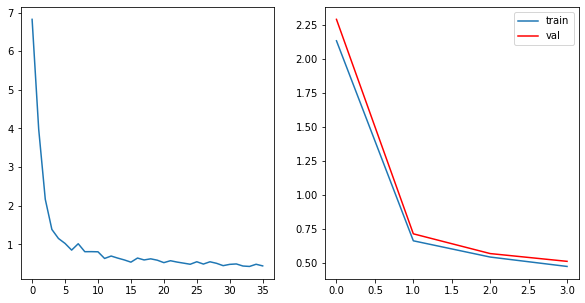

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4789, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3855, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4240, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.44031862989074516	     Validation Loss:0.5063233867515435	 \ LR:0.001


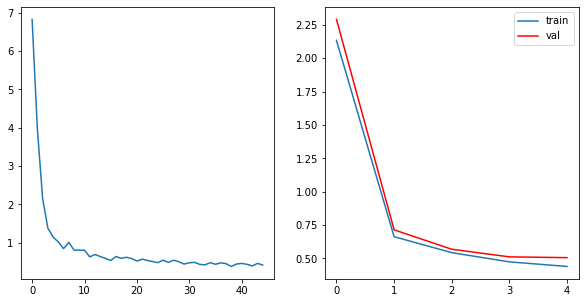

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4366, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3765, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4174, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3840, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3818, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.4080757775158427	     Validation Loss:0.4083699331478285	 \ LR:0.001


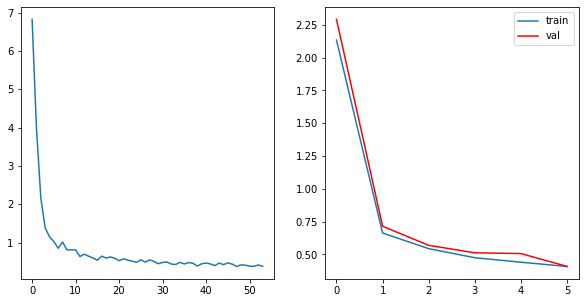

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3858, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3693, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.3860221825792326	     Validation Loss:0.40231875659111377	 \ LR:0.001


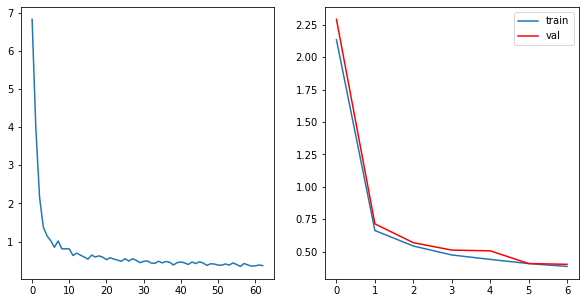

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3737, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3817, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3412, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3862, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3589, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.36693457114671957	     Validation Loss:0.3873363845569964	 \ LR:0.001


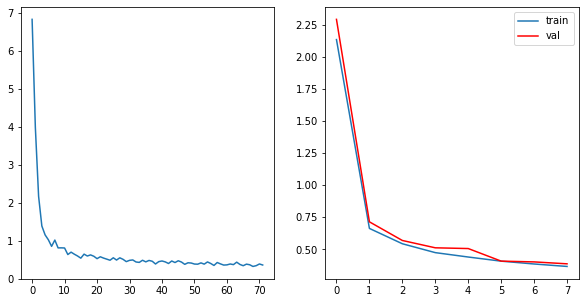

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4342, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3887, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3250, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3456, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3443, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.35926117379648326	     Validation Loss:0.38772584499666823	 \ LR:0.001


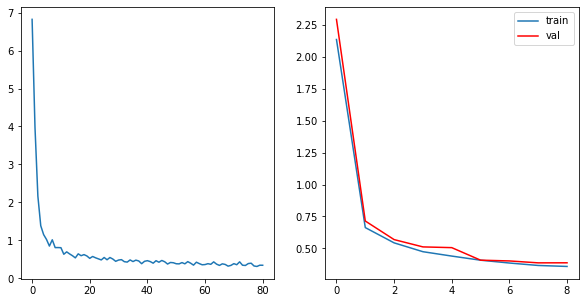

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3178, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3017, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3081, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.340239971282203	     Validation Loss:0.407177807263207	 \ LR:0.001


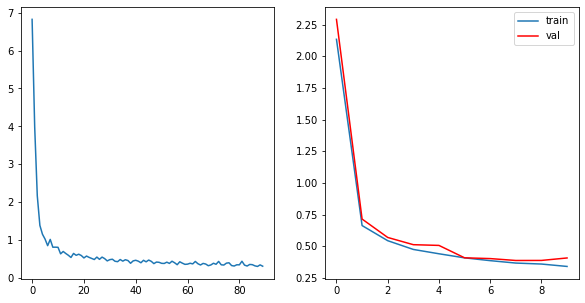

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3176, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2968, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3003, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3348, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2795, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.32604325468779727	     Validation Loss:0.3201269926093436	 \ LR:0.001


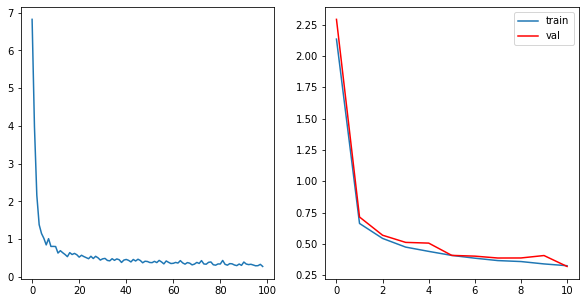

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3878, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3128, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3135, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2869, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3031, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.31628578853879064	     Validation Loss:0.2986839096575151	 \ LR:0.001


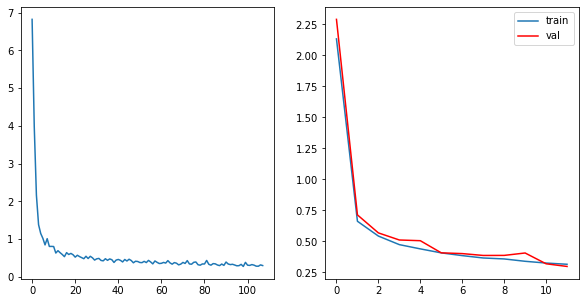

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2844, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3099, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2965, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.32050294686476277	     Validation Loss:0.3182658598674017	 \ LR:0.001


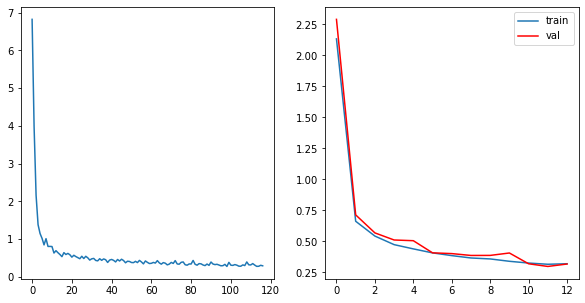

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2870, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3010, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2799, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.32684617097594143	     Validation Loss:0.3535876927493254	 \ LR:0.001


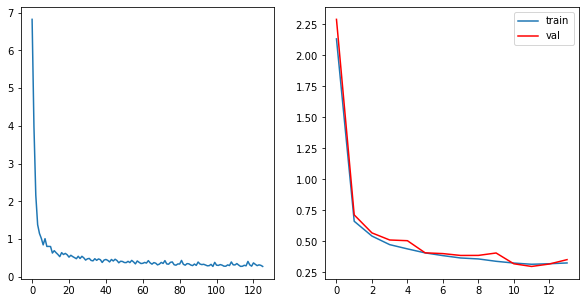

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4184, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3317, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2848, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2836, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3092, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.32700784349542306	     Validation Loss:0.3391805758327302	 \ LR:0.001


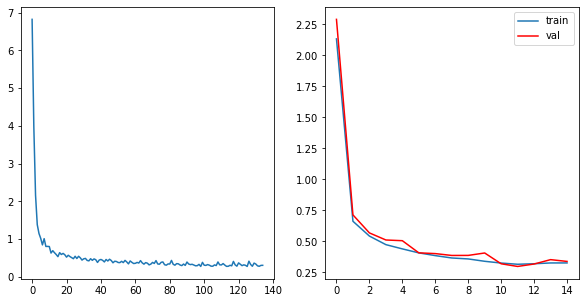

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2916, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3109, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.33409072469336043	     Validation Loss:0.4044400664712506	 \ LR:0.001


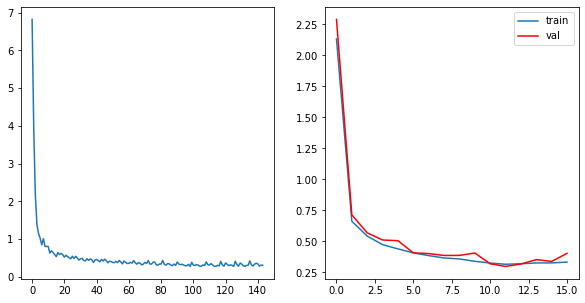

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3094, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2814, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.327138286182729	     Validation Loss:0.3249640378829929	 \ LR:0.001


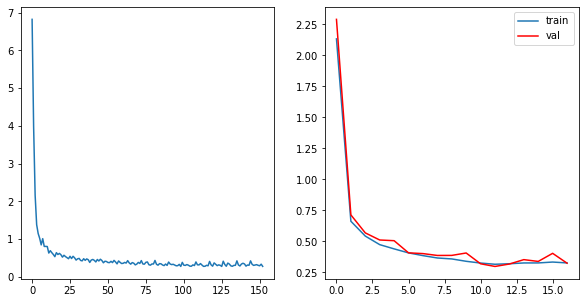

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3976, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3033, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2785, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2699, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2890, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2835, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.30359723783446513	     Validation Loss:0.316359099897282	 \ LR:0.0001


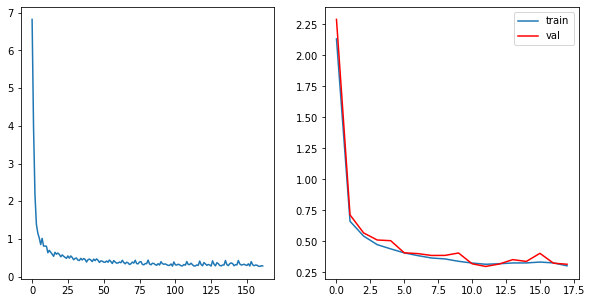

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3109, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2843, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2837, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2708, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2534, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.2850156788960116	     Validation Loss:0.27041747918326703	 \ LR:0.0001


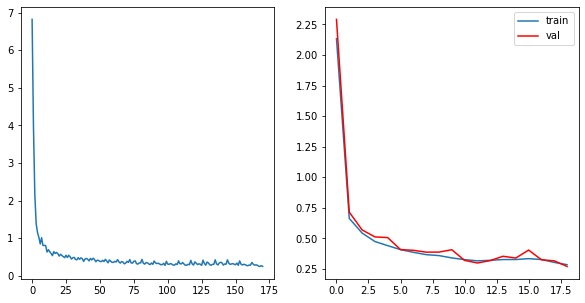

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2786, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2709, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2706, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2591, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.27140688293992654	     Validation Loss:0.2661604518464393	 \ LR:0.0001


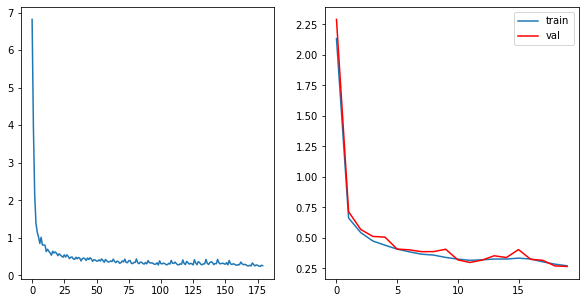

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2763, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2620, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.264457354246342	     Validation Loss:0.2612906361900533	 \ LR:0.0001


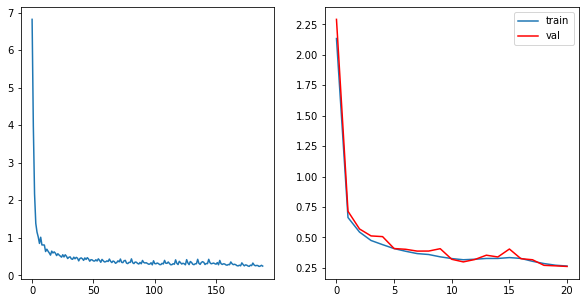

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2679, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2399, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.26191300783778704	     Validation Loss:0.26039428491669203	 \ LR:0.0001


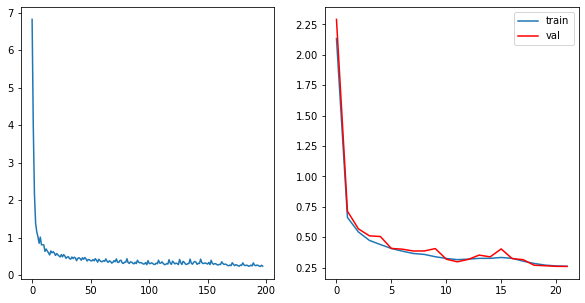

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2680, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2334, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2406, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.25947899204518804	     Validation Loss:0.2644634798969261	 \ LR:0.0001


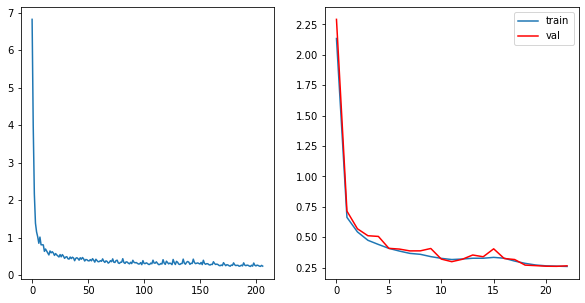

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2391, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.25472179372055825	     Validation Loss:0.26100739765843833	 \ LR:0.0001


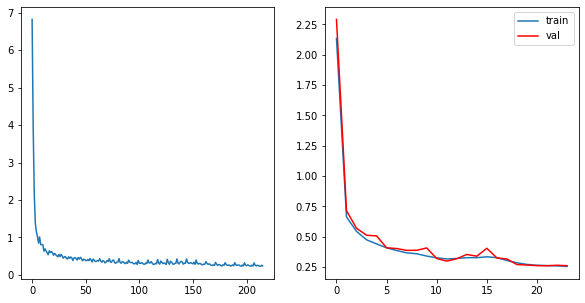

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2262, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.255224529921393	     Validation Loss:0.25410164292071	 \ LR:0.0001


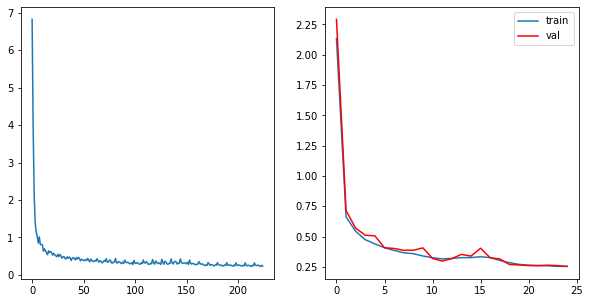

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2297, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2586, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2393, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.2540536270386353	     Validation Loss:0.25325636353825337	 \ LR:0.0001


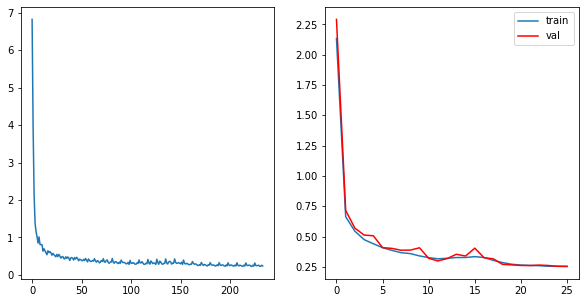

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3173, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2250, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2347, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.25153979487971045	     Validation Loss:0.2520365388142399	 \ LR:0.0001


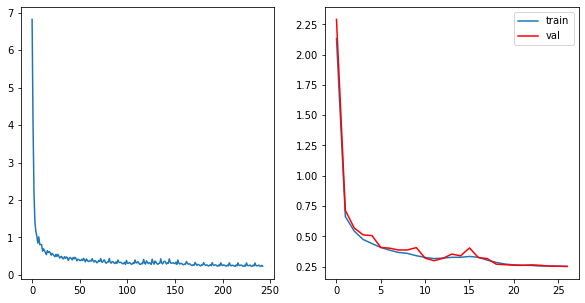

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2336, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.24958435377085042	     Validation Loss:0.2539121726684323	 \ LR:0.0001


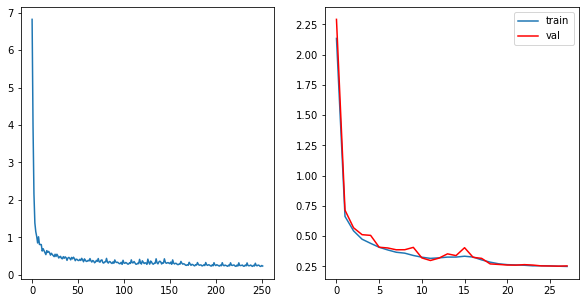

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3080, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2301, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.24763719485378452	     Validation Loss:0.2525803076017527	 \ LR:0.0001


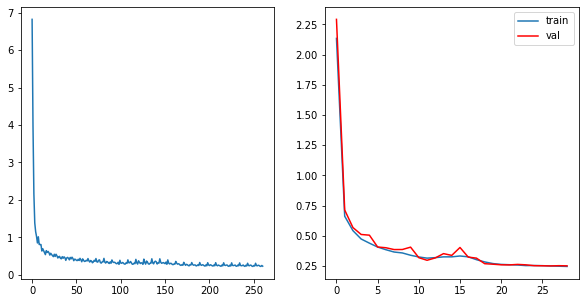

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3173, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2329, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.2478424938597141	     Validation Loss:0.2545409061455695	 \ LR:0.0001


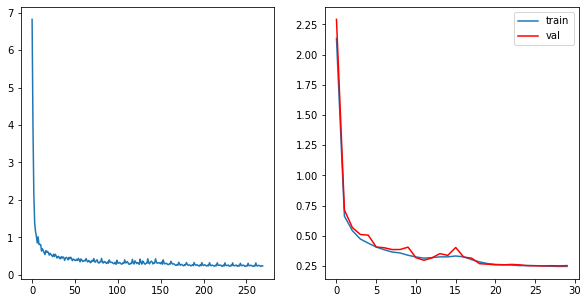

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2225, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2246, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.2487389982552498	     Validation Loss:0.2495997973915615	 \ LR:0.0001


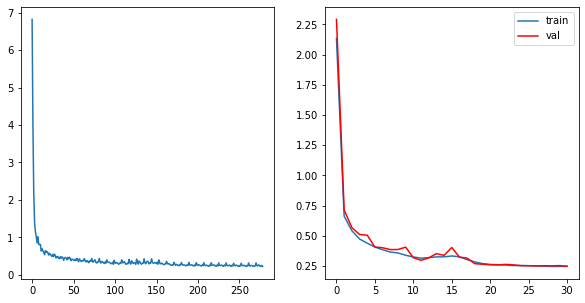

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3122, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2343, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2242, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2317, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.248646762398132	     Validation Loss:0.25173318483379953	 \ LR:0.0001


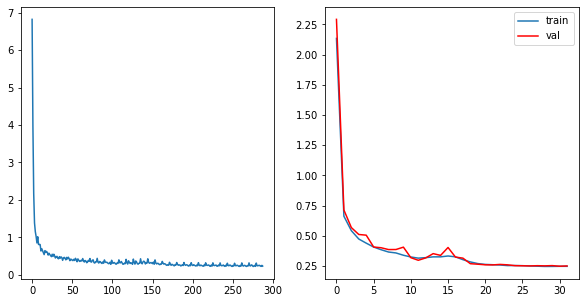

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2309, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2289, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.2453344733498162	     Validation Loss:0.2522167860389161	 \ LR:0.0001


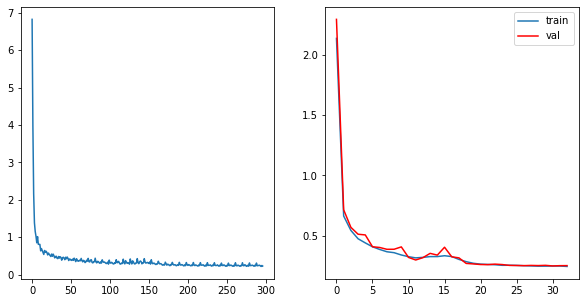

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3073, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2183, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.2454906038642852	     Validation Loss:0.2520829354963157	 \ LR:0.0001


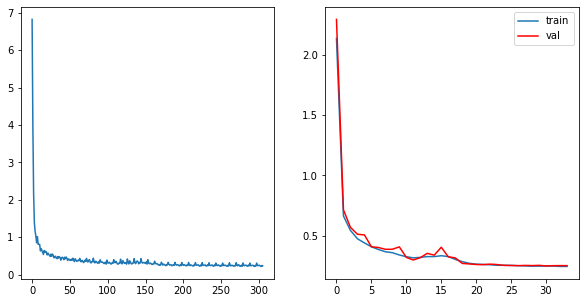

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3083, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2443, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.24446181560956168	     Validation Loss:0.24842752170884572	 \ LR:0.0001


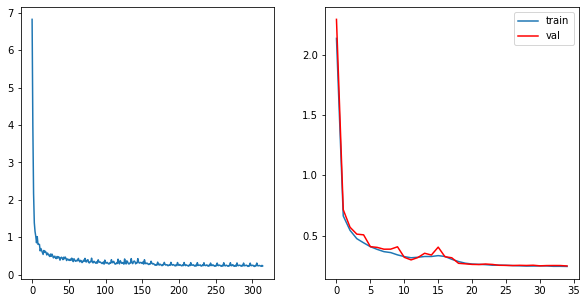

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2337, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2305, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2336, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.24502454856114358	     Validation Loss:0.24709093568340648	 \ LR:0.0001


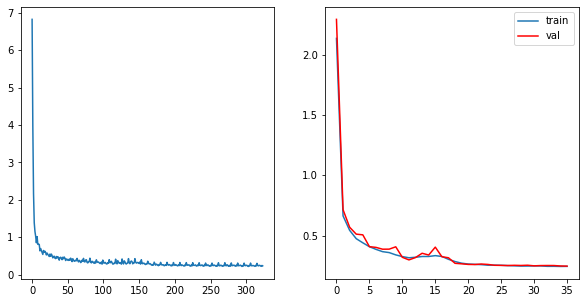

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2337, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2268, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.24102238227792208	     Validation Loss:0.24837434498421787	 \ LR:0.0001


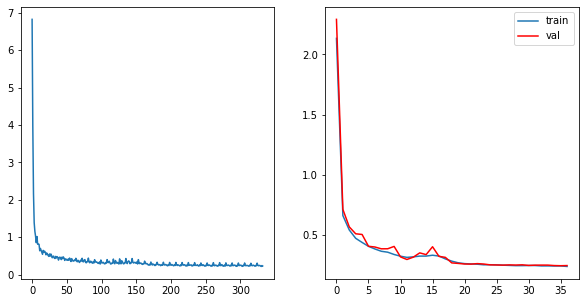

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2281, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2260, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.2396429060004787	     Validation Loss:0.2470473182424949	 \ LR:0.0001


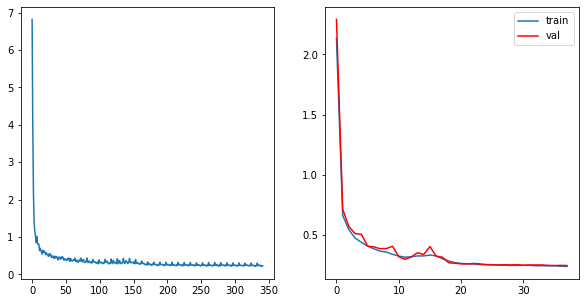

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3073, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2209, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2376, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2225, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.23984101490044804	     Validation Loss:0.24419002967543757	 \ LR:0.0001


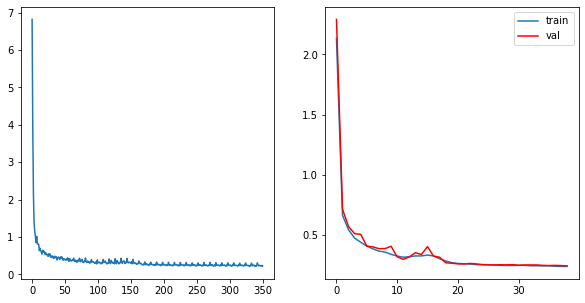

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2222, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2263, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.23888692429785946	     Validation Loss:0.24636911343938764	 \ LR:0.0001


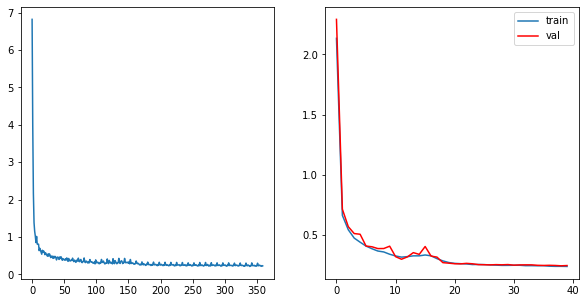

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2917, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2334, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2111, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2213, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.23614833373341806	     Validation Loss:0.24122090112665054	 \ LR:0.0001


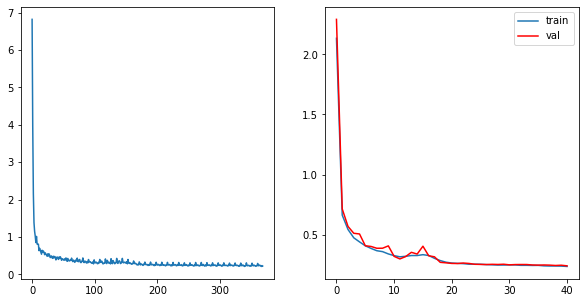

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2853, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.23594161322515214	     Validation Loss:0.24426295598067146	 \ LR:0.0001


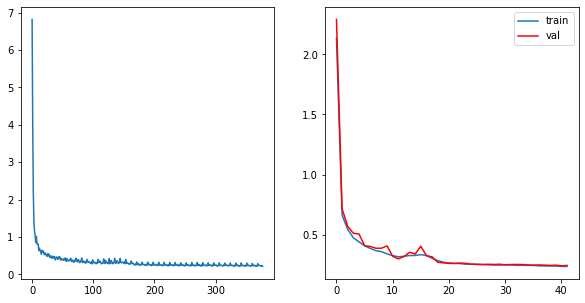

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2168, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2119, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.23615619066077242	     Validation Loss:0.24426374137242476	 \ LR:0.0001


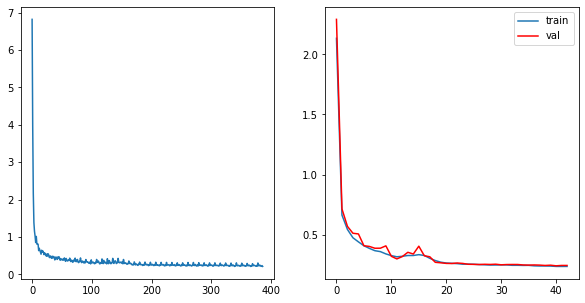

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2194, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2159, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2346, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2211, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.23685374861877928	     Validation Loss:0.24329934582347343	 \ LR:0.0001


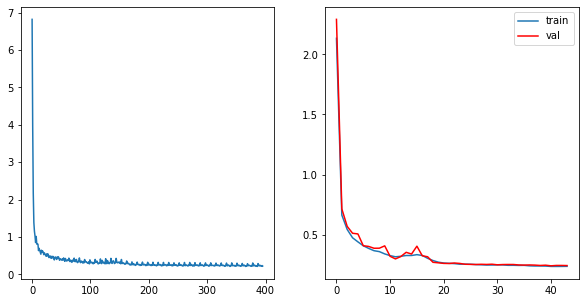

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2923, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2366, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2207, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.23540669268890435	     Validation Loss:0.23822941980845883	 \ LR:0.0001


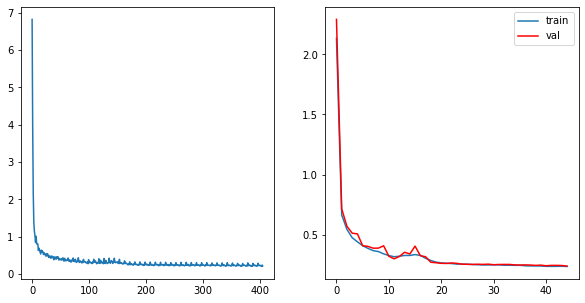

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2883, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2320, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.2352370797196084	     Validation Loss:0.2440918839645125	 \ LR:0.0001


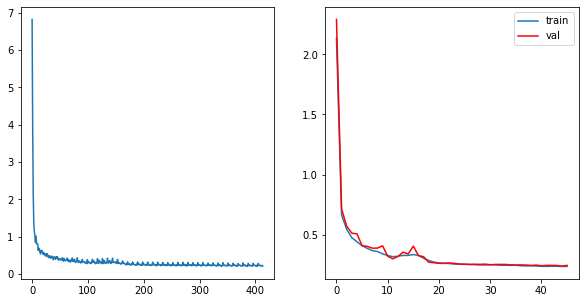

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2857, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2176, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2316, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2176, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2118, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2177, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.23081172532790445	     Validation Loss:0.24148538613775739	 \ LR:0.0001


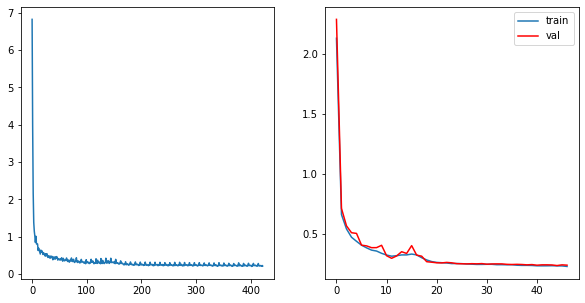

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2132, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2334, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2226, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.23459496953156997	     Validation Loss:0.23765837312389948	 \ LR:0.0001


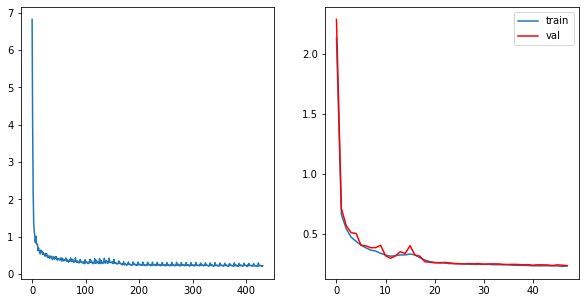

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2923, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2261, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2140, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2189, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2242, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.23304002210993843	     Validation Loss:0.23708514880741816	 \ LR:0.0001


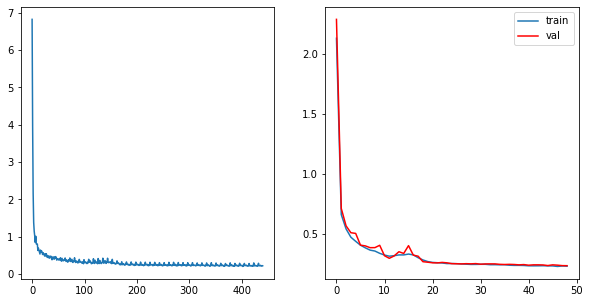

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2815, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2084, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2222, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.22910536559352274	     Validation Loss:0.24261104620950893	 \ LR:0.0001


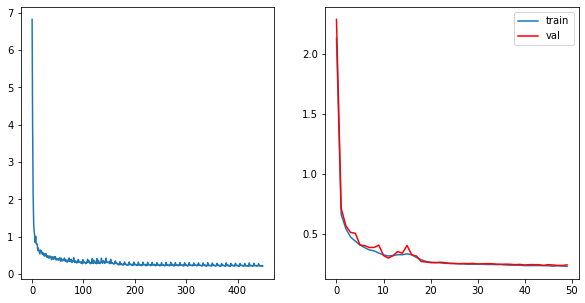

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2826, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2254, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2181, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "вертикальный и горизонтальный флип, рандомный шум, HSV "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_randomBLUR_HSV_epoch_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(0.3066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3349, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3073, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3101, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.32120929700502276	     Validation Loss:0.32567762964306207	 \ LR:1e-05


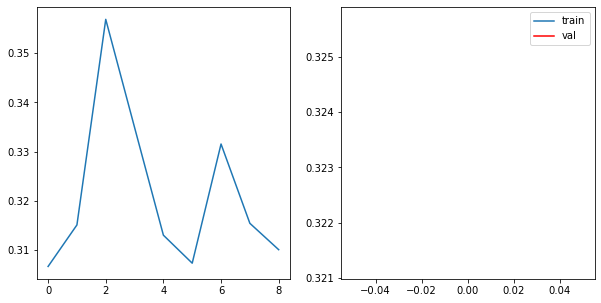

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3040, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3050, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3234, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3032, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.3152610179175934	     Validation Loss:0.3167186801356388	 \ LR:1e-05


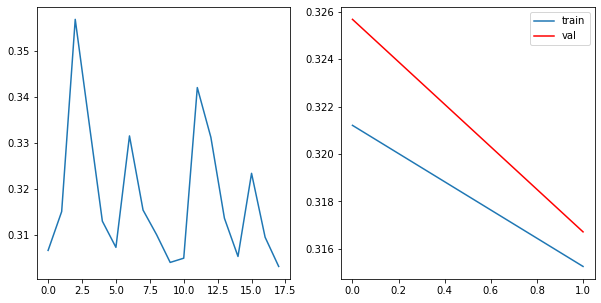

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3081, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.310431452278248	     Validation Loss:0.31811493791010187	 \ LR:1e-05


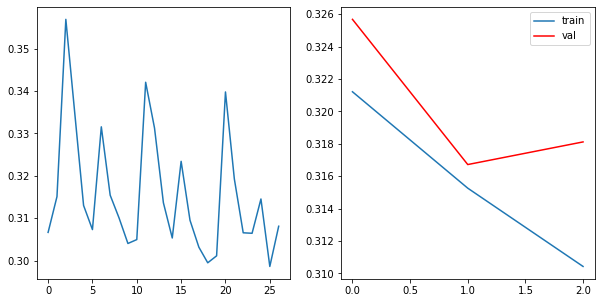

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3350, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3073, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2934, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.30755866025955386	     Validation Loss:0.31482366455069216	 \ LR:1e-05


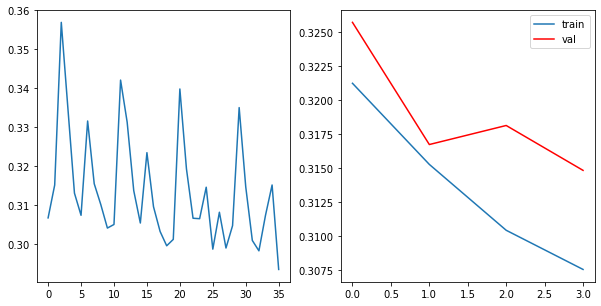

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2959, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3149, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3051, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2926, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.3036473418357808	     Validation Loss:0.3153884852997457	 \ LR:1e-05


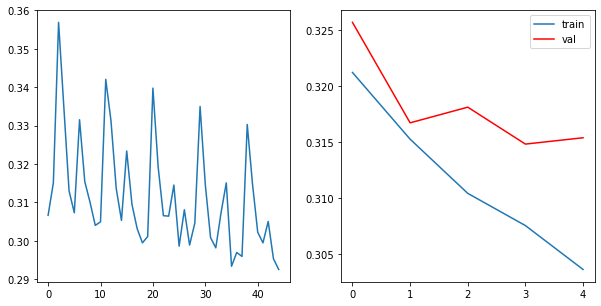

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2904, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2956, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2926, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3043, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2940, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2998, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.3011240992214874	     Validation Loss:0.31040042554795794	 \ LR:1e-05


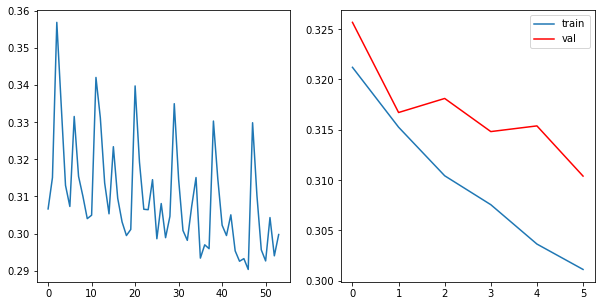

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3019, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2881, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.29785581609393735	     Validation Loss:0.3134260571143758	 \ LR:1e-05


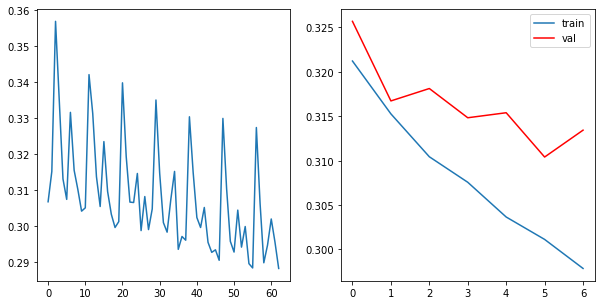

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2870, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2934, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3219, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2887, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2862, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2825, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.2951930223427549	     Validation Loss:0.30575652645530704	 \ LR:1e-05


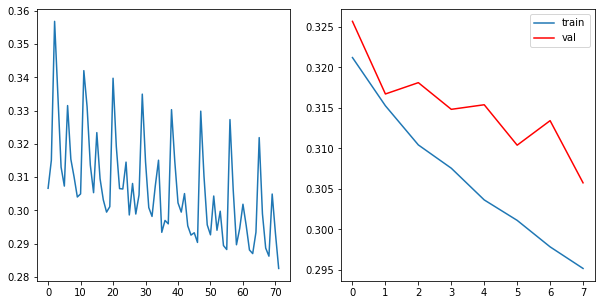

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2832, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3024, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2852, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2927, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.29320570417958236	     Validation Loss:0.303585267890822	 \ LR:1e-05


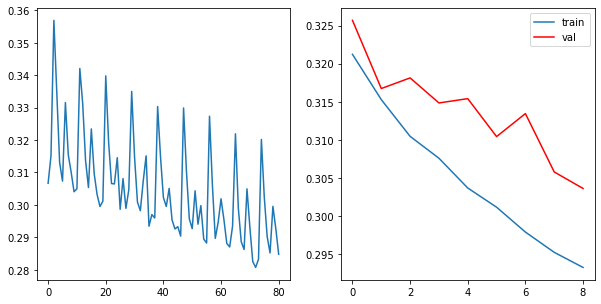

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2826, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2833, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3212, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2866, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2843, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2967, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2819, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2861, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.2920972021056451	     Validation Loss:0.305459766330846	 \ LR:1e-05


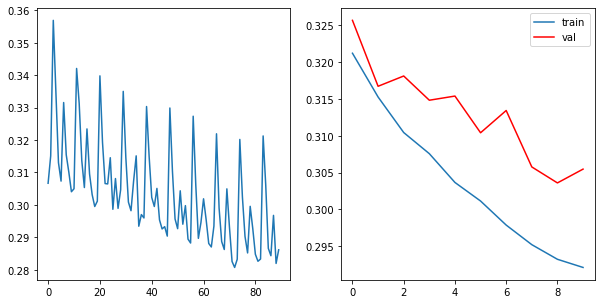

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2824, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2929, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2868, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2784, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.28712350079570254	     Validation Loss:0.30107347765287384	 \ LR:1e-05


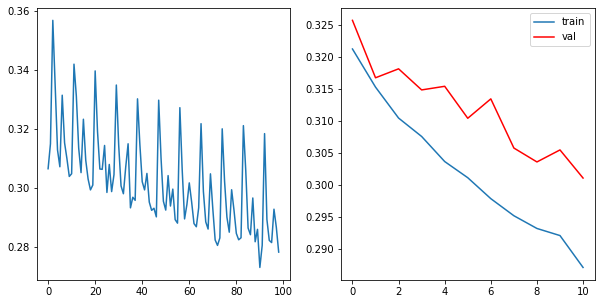

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2772, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3195, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2862, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2796, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2820, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.28741988556162207	     Validation Loss:0.3018623570342395	 \ LR:1e-05


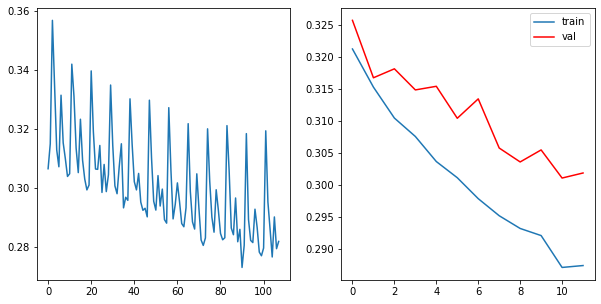

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2740, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2707, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2875, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2830, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2732, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2825, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2762, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.28293569227397525	     Validation Loss:0.2980325587869917	 \ LR:1e-05


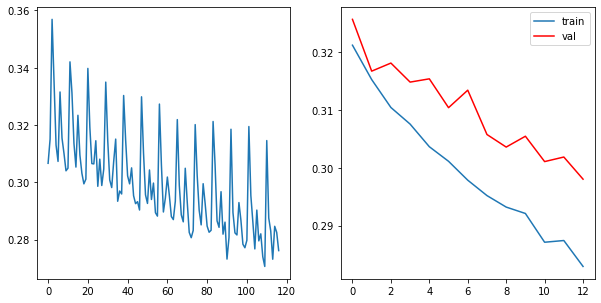

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2697, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2853, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2790, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2812, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2880, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2752, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.2818440604820627	     Validation Loss:0.2970860265512692	 \ LR:1e-05


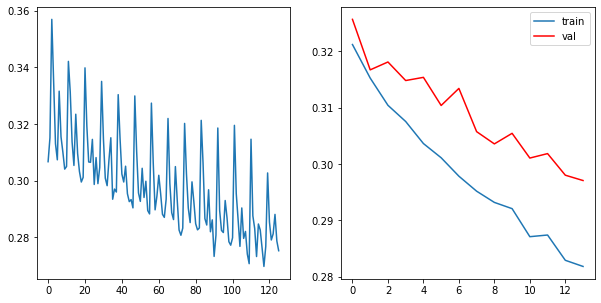

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2728, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2944, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2845, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2774, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2692, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.27922591735674546	     Validation Loss:0.3021828866186264	 \ LR:1e-05


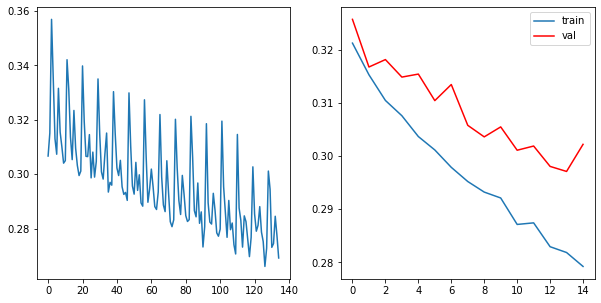

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2700, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3067, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2906, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2688, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2851, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2769, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2690, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.2787111690819429	     Validation Loss:0.2956008441419244	 \ LR:1e-05


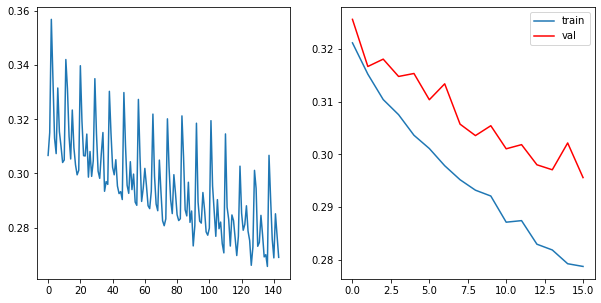

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3017, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2729, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2708, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2670, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.27451892866539424	     Validation Loss:0.29561501432101567	 \ LR:1e-05


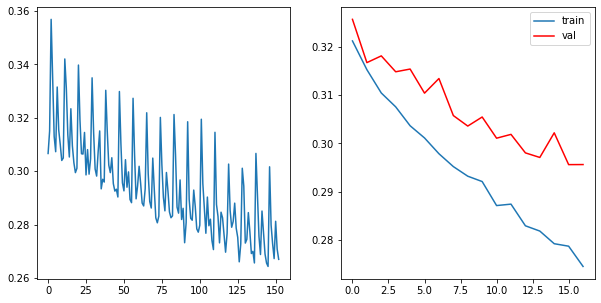

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2999, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2771, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2819, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2696, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.2739514351965411	     Validation Loss:0.29317134794032484	 \ LR:1e-05


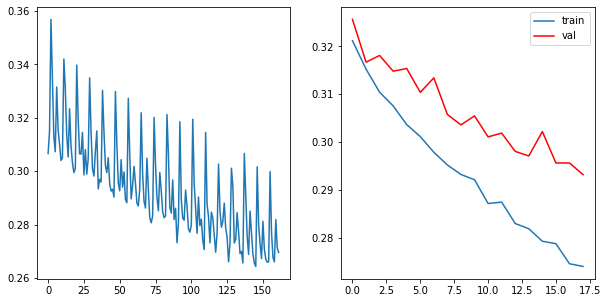

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2728, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2664, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2636, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.27267330845278326	     Validation Loss:0.2902601839655774	 \ LR:1e-05


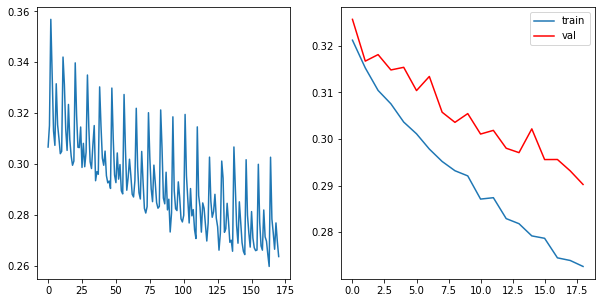

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2649, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2988, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2730, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2666, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.2699697456265318	     Validation Loss:0.29116549473701814	 \ LR:1e-05


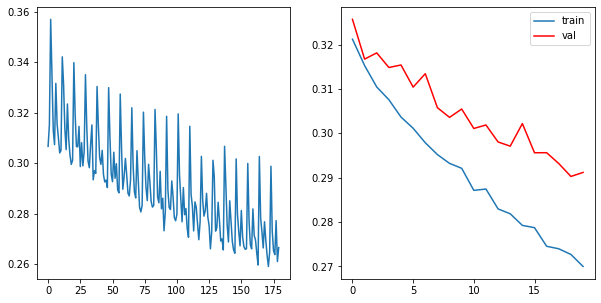

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2924, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2710, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2618, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2726, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2695, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.26727992469444495	     Validation Loss:0.29000655400441605	 \ LR:1e-05


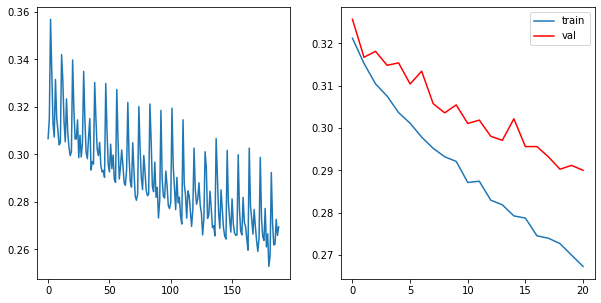

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2592, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2677, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2815, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.26861291880803695	     Validation Loss:0.28766905291769856	 \ LR:1e-05


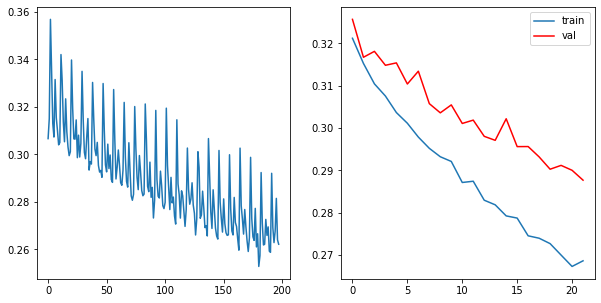

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2888, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2655, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2671, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2551, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.26368330423318076	     Validation Loss:0.2847146629252007	 \ LR:1e-05


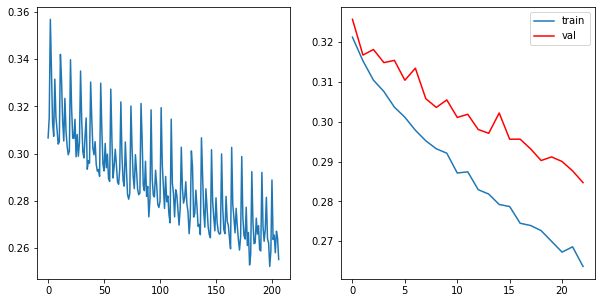

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2926, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2655, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2637, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2544, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.26237329669725057	     Validation Loss:0.28827915547788363	 \ LR:1e-05


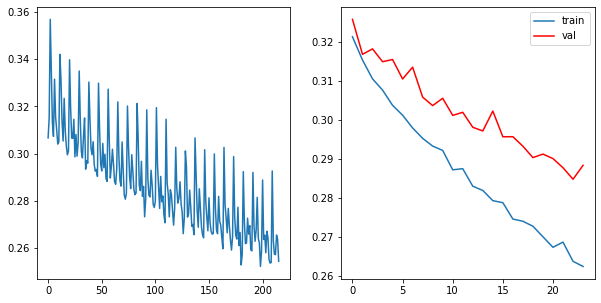

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2858, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2684, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2693, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2543, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.26183954158305683	     Validation Loss:0.2845095595007192	 \ LR:1e-05


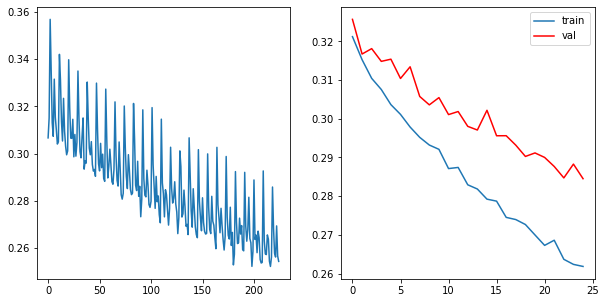

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2611, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2674, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2547, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.25967360150669877	     Validation Loss:0.2788327052889836	 \ LR:1e-05


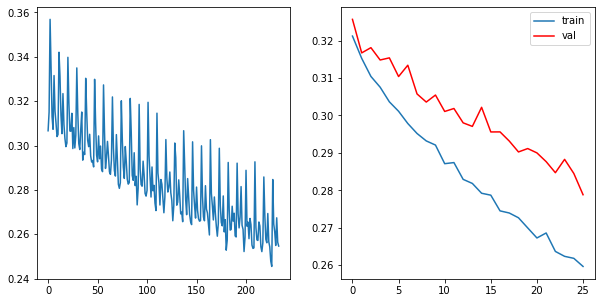

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2637, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2633, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2626, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2491, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.2583311331449361	     Validation Loss:0.27965540456467464	 \ LR:1e-05


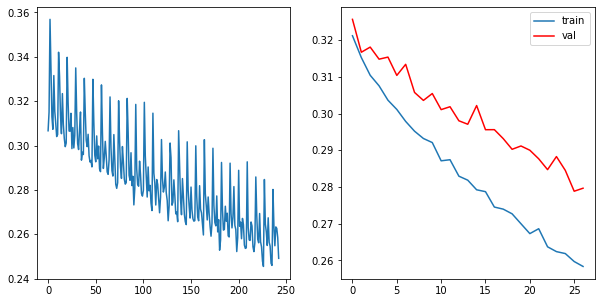

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2759, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.25643507614139815	     Validation Loss:0.2797472925189483	 \ LR:1e-05


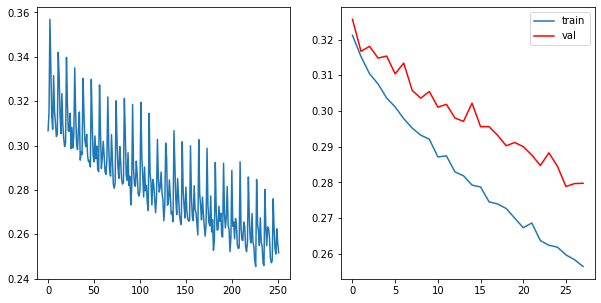

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2622, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2490, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.25635210268990444	     Validation Loss:0.2763032603586189	 \ LR:1e-05


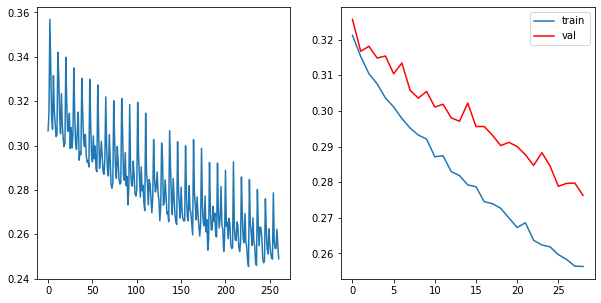

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2718, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2563, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2436, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.25247267255269684	     Validation Loss:0.27814703842482963	 \ LR:1e-05


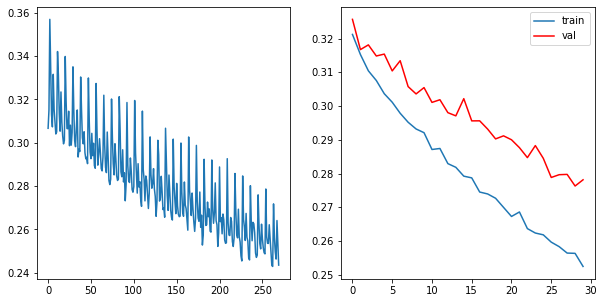

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2415, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.24949103031948086	     Validation Loss:0.2807369663391902	 \ LR:1e-05


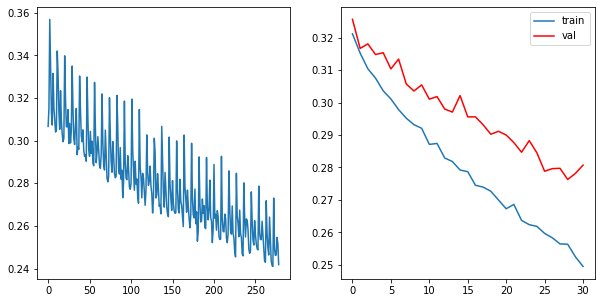

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.25053972882516284	     Validation Loss:0.2759776064298038	 \ LR:1e-05


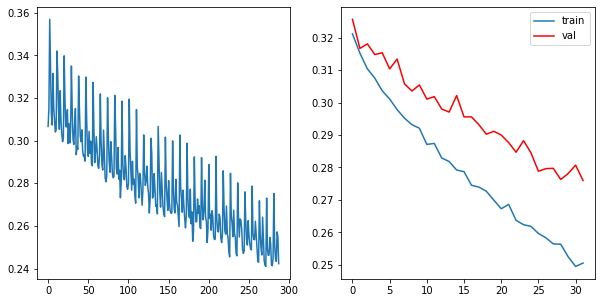

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2412, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2697, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2429, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.2488737700540871	     Validation Loss:0.27395126306264866	 \ LR:1e-05


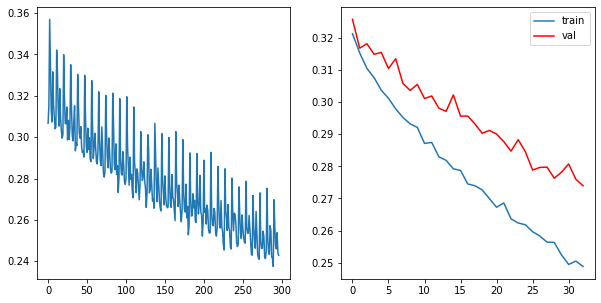

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.24739150117105493	     Validation Loss:0.27470807501720834	 \ LR:1e-05


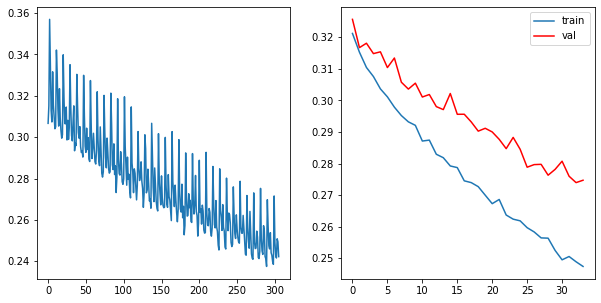

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2518, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2391, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.24703129911997884	     Validation Loss:0.26852233575019463	 \ LR:1e-05


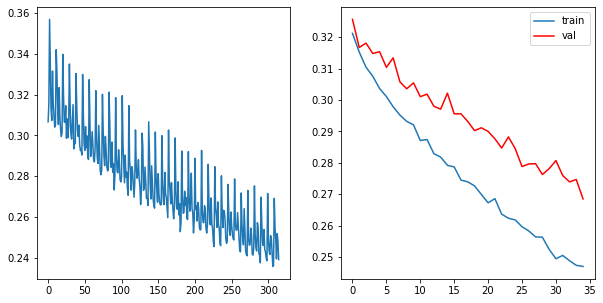

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2376, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.247232499282375	     Validation Loss:0.2735895868738514	 \ LR:1e-05


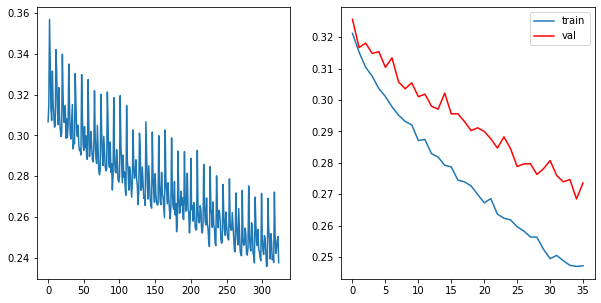

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2372, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2352, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.24495933282346272	     Validation Loss:0.2703562862892189	 \ LR:1e-05


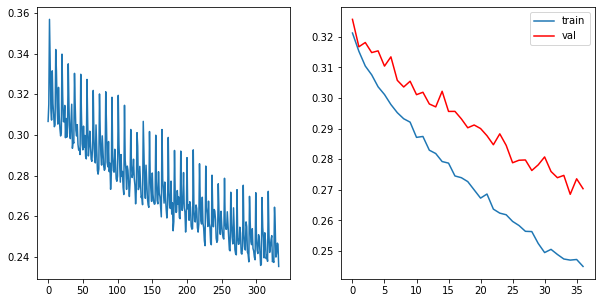

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2325, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2325, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2415, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2397, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.24193616857807396	     Validation Loss:0.2680712571453665	 \ LR:1e-05


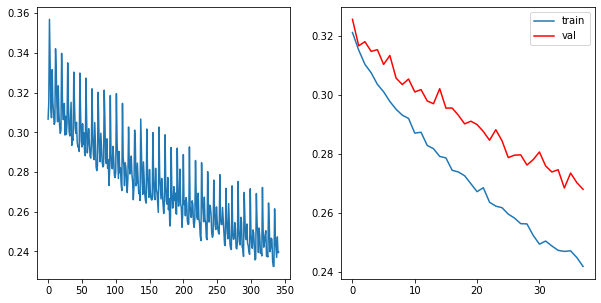

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2617, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.24143066373175534	     Validation Loss:0.2689291865221833	 \ LR:1e-05


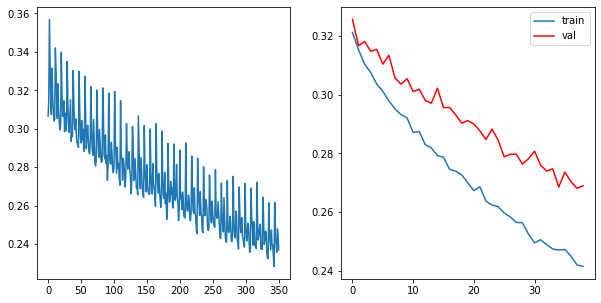

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2309, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2318, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.23947806588187012	     Validation Loss:0.26876702253012835	 \ LR:1e-05


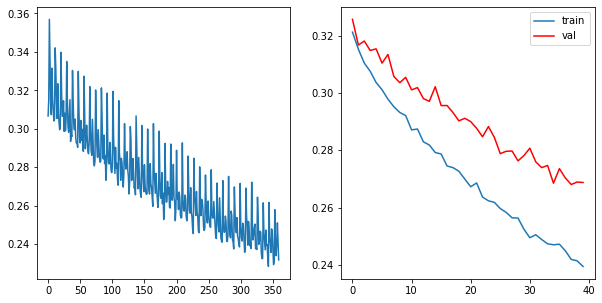

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2350, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2456, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2293, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.23878519282947838	     Validation Loss:0.2646835828519832	 \ LR:1e-05


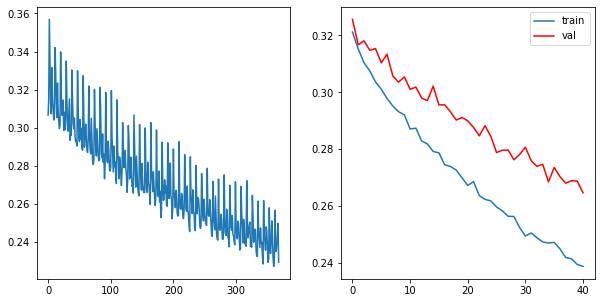

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2295, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2383, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2310, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.2389682617882104	     Validation Loss:0.26547502706366216	 \ LR:1e-05


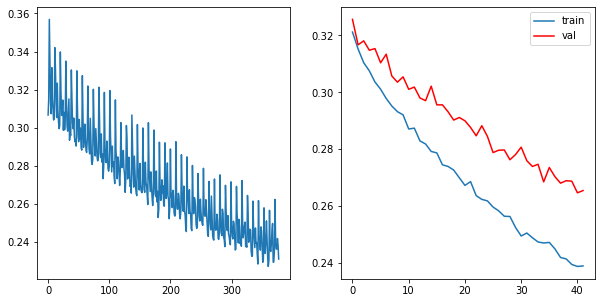

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2630, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.23815112101334257	     Validation Loss:0.2656505133309098	 \ LR:1e-05


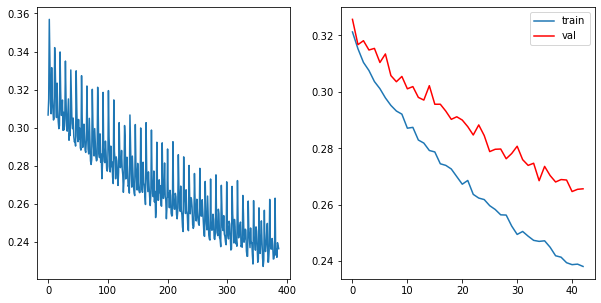

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2341, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2339, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.23705609468362163	     Validation Loss:0.2638303489296201	 \ LR:1e-05


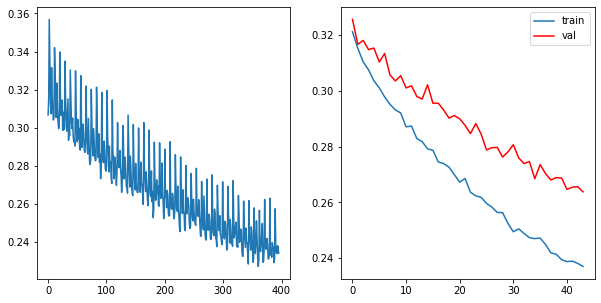

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2253, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2349, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.23440941352675956	     Validation Loss:0.2609035223323673	 \ LR:1e-05


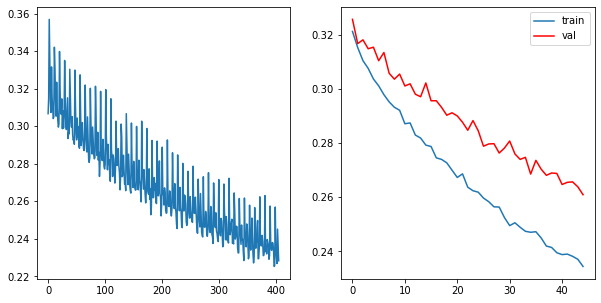

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2250, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2350, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2305, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2240, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.2334465692402047	     Validation Loss:0.26661761261994005	 \ LR:1e-05


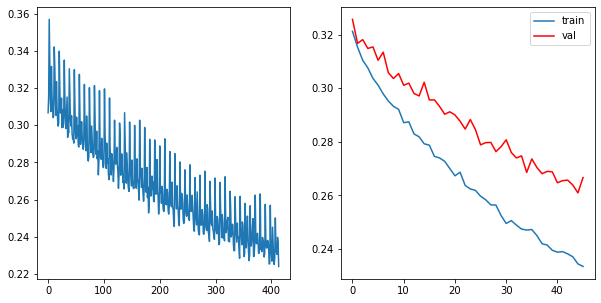

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2306, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2225, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.23068629481408306	     Validation Loss:0.26383639882574866	 \ LR:1e-05


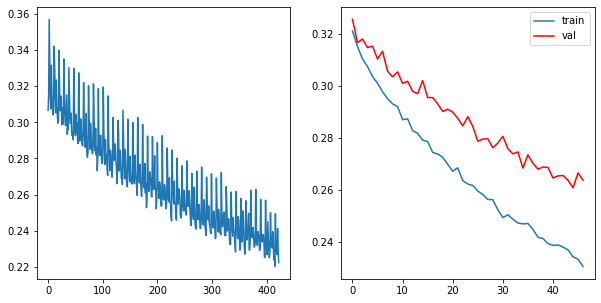

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2318, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2327, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2263, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.2316207384099837	     Validation Loss:0.26334861055340447	 \ LR:1e-05


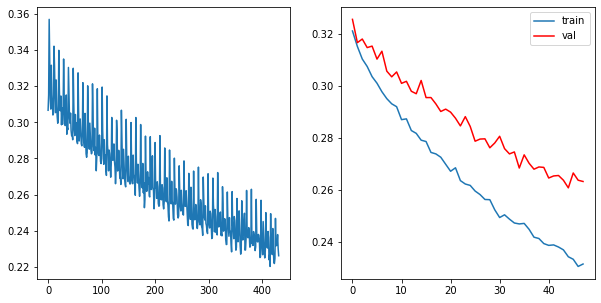

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2266, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2262, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2311, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2277, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.23170258688382683	     Validation Loss:0.2636454785430796	 \ LR:1e-05


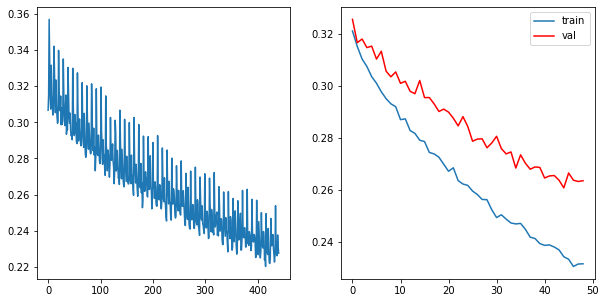

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2236, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2303, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2234, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2256, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.23005274068661472	     Validation Loss:0.2568588904092723	 \ LR:1e-05


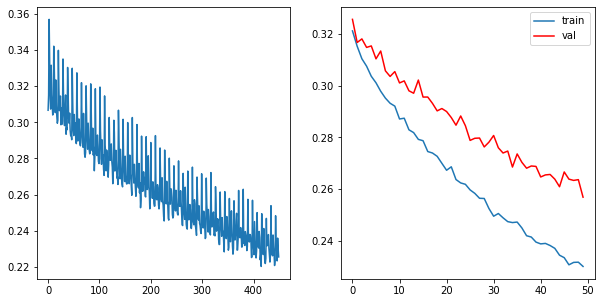

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2204, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2352, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2207, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.2296027782914105	     Validation Loss:0.26230731768625315	 \ LR:1e-05


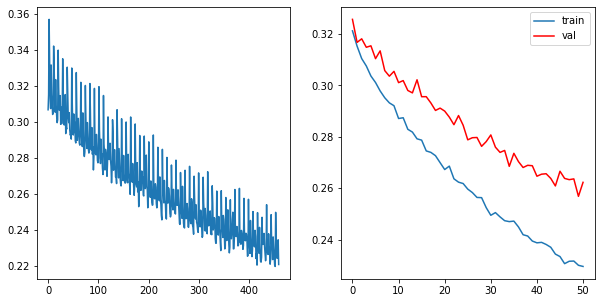

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2317, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2234, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2310, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2188, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.22823937342008754	     Validation Loss:0.2613646553126153	 \ LR:1e-05


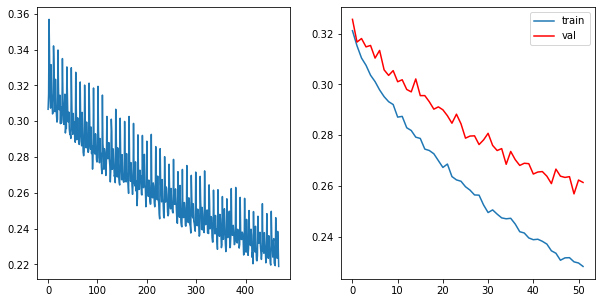

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2240, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2267, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2258, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2199, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.22716898082298798	     Validation Loss:0.2571146962169342	 \ LR:1e-05


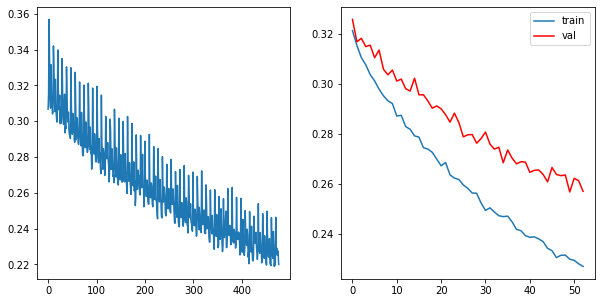

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2239, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2214, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.22530280890278695	     Validation Loss:0.2657648642651197	 \ LR:1e-05


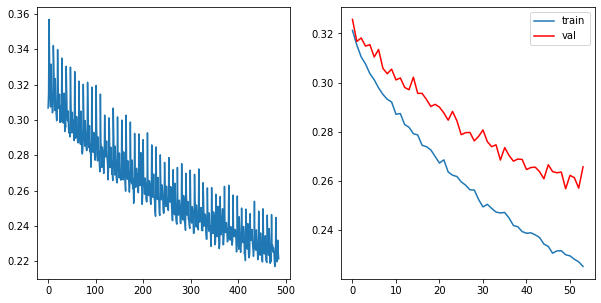

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2184, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2188, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2189, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.2239668142767736	     Validation Loss:0.25471807767735793	 \ LR:1e-05


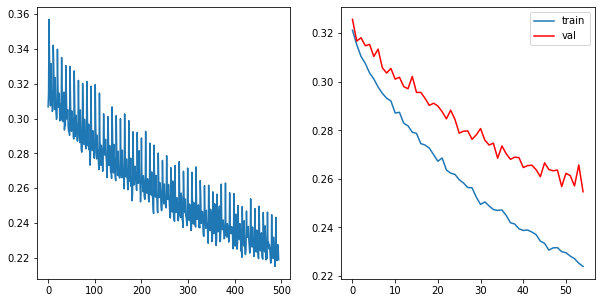

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2138, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2133, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2443, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2317, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2133, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.2219170149378017	     Validation Loss:0.255131812443447	 \ LR:1e-05


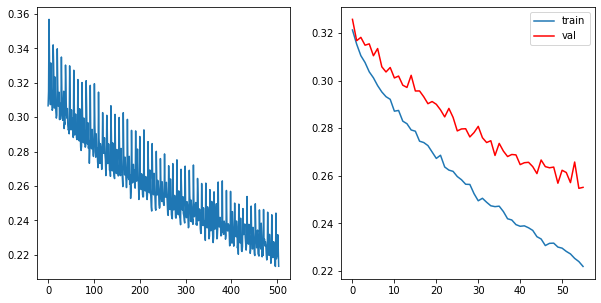

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2158, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2149, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.22362176845592677	     Validation Loss:0.25561242230416154	 \ LR:1e-05


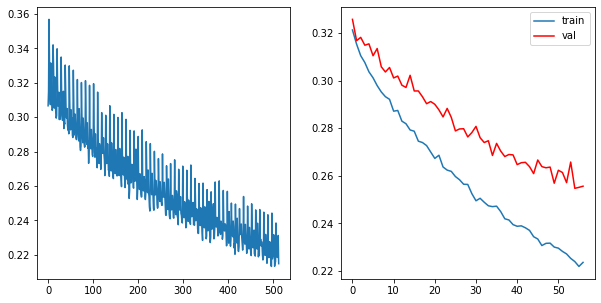

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2131, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2281, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2249, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 57	 \Training Loss: 0.22160171979218896	     Validation Loss:0.2555034498761319	 \ LR:1e-05


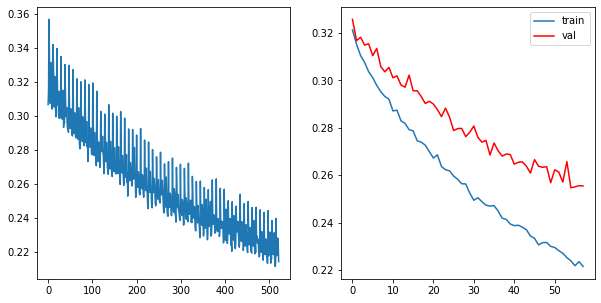

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2128, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2222, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2130, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 58	 \Training Loss: 0.221651432306221	     Validation Loss:0.2539384228357453	 \ LR:1e-05


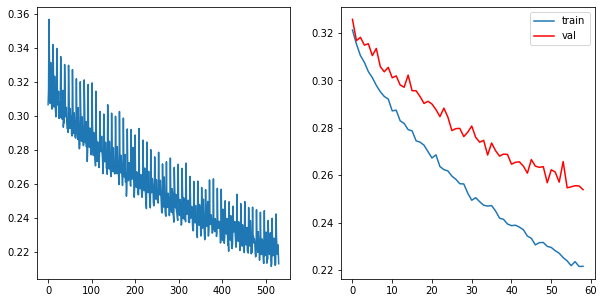

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2127, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2204, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2255, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2144, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 59	 \Training Loss: 0.2209949571311578	     Validation Loss:0.2575866960004278	 \ LR:1e-05


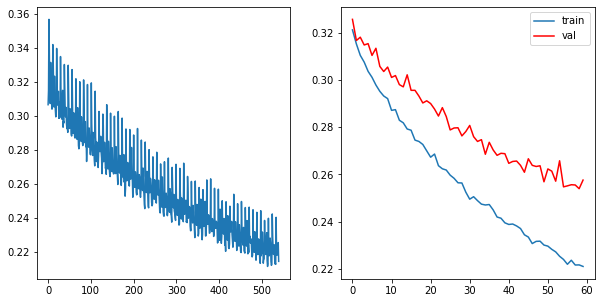

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2097, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2181, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2181, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2267, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2113, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "вертикальный и горизонтальный флип, уменьшение в глубь "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_Min_V_Glub_новый_поиск_дырки_epoch_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.5983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5463, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.5245, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 1.5440173336488385	     Validation Loss:1.3784164109985113	 \ LR:1e-05


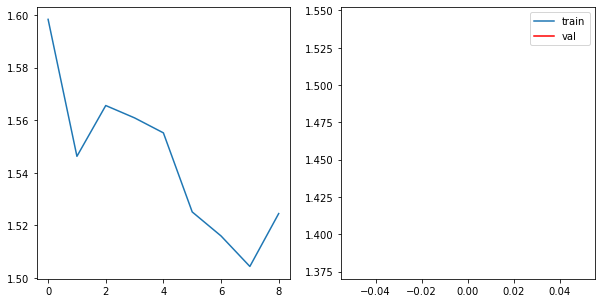

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.4946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4637, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4737, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4372, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4229, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4304, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 1.4514688724107316	     Validation Loss:1.362779194369106	 \ LR:1e-05


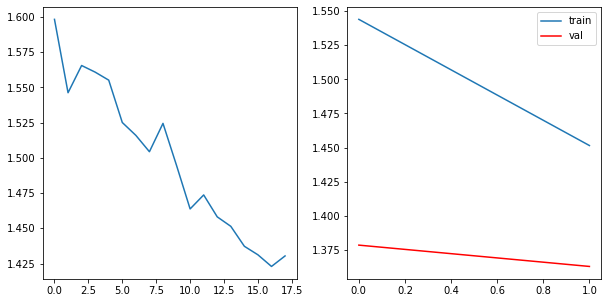

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.4038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3761, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3867, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3788, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3546, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 1.3739660893597463	     Validation Loss:1.338392653619432	 \ LR:1e-05


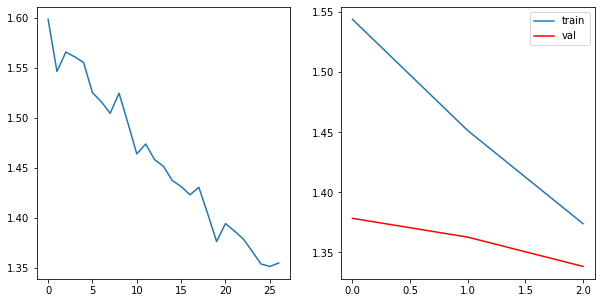

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.3332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3242, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2973, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2959, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3028, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2908, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 1.309463615778443	     Validation Loss:1.2793133454113483	 \ LR:1e-05


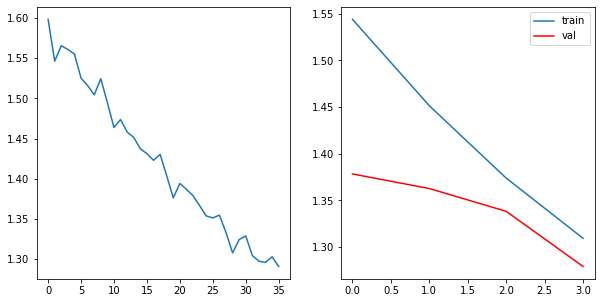

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.2800, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2715, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2734, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2370, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 1.253524627798486	     Validation Loss:1.2060429910768729	 \ LR:1e-05


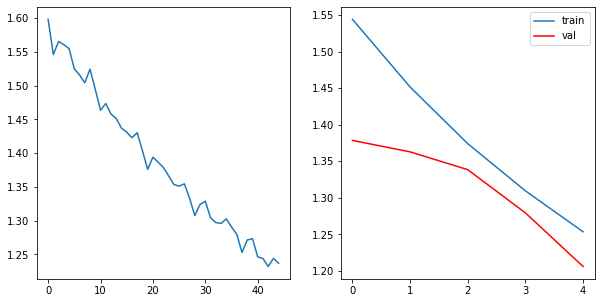

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.2199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2232, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2158, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2036, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1870, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1835, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 1.2030468785681159	     Validation Loss:1.1542712758654876	 \ LR:1e-05


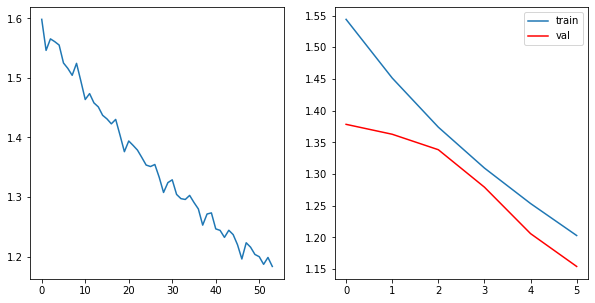

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.1722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1795, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1452, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1435, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 1.155418670028634	     Validation Loss:1.1069463502888397	 \ LR:1e-05


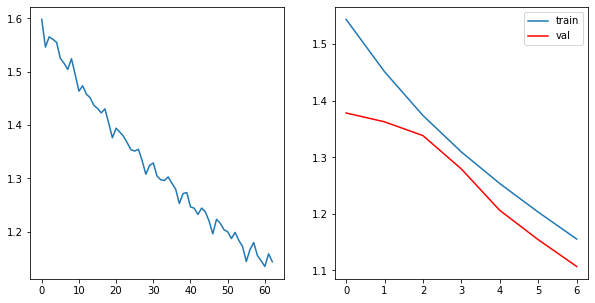

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.1217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1137, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1057, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0929, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1157, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0884, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 1.113331232016386	     Validation Loss:1.065433318177978	 \ LR:1e-05


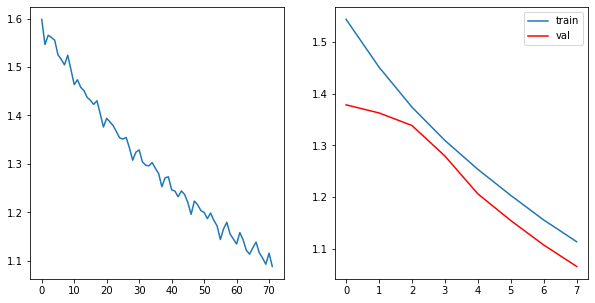

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.0860, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0679, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0947, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1006, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0852, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0567, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 1.0766646731827265	     Validation Loss:1.0234298075919666	 \ LR:1e-05


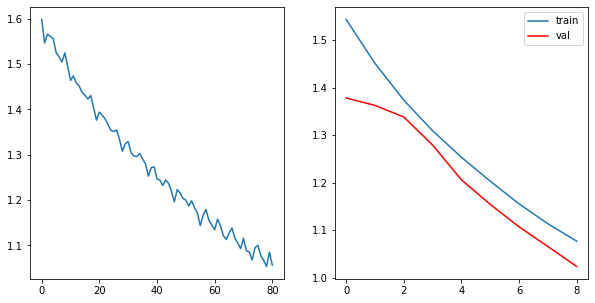

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.0511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0265, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0714, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0222, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 1.0420838681485785	     Validation Loss:0.9831830647363992	 \ LR:1e-05


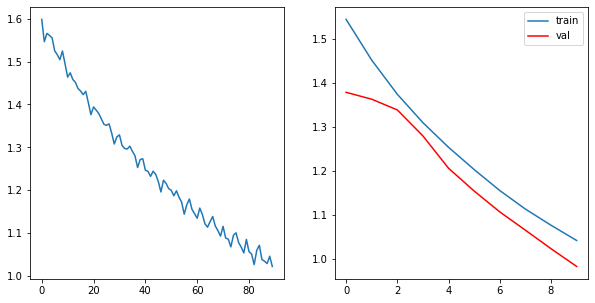

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.0118, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9880, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0148, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0149, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0134, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9926, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9863, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 1.0071935990170153	     Validation Loss:0.9637426911037904	 \ LR:1e-05


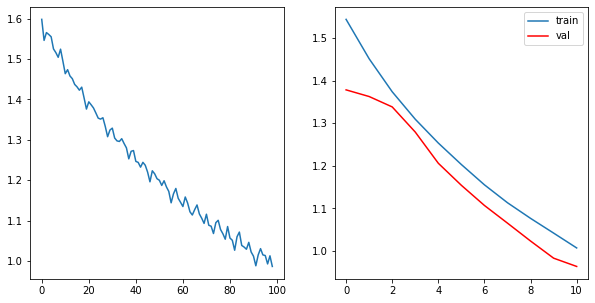

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9917, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9696, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9743, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9466, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9517, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.9711836672821151	     Validation Loss:0.9224918827351457	 \ LR:1e-05


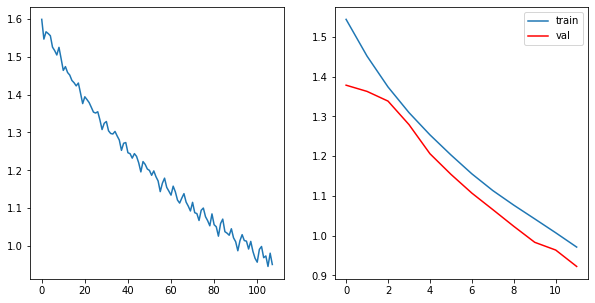

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.9315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9171, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.9364007912319237	     Validation Loss:0.8903626872269831	 \ LR:1e-05


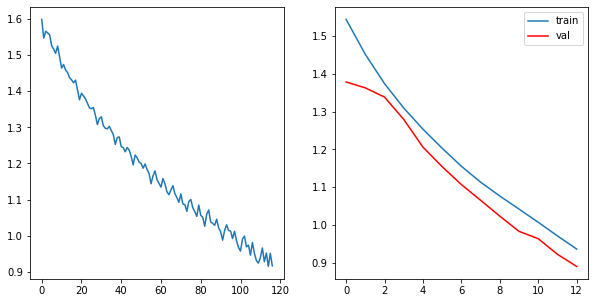

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.9031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9040, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8887, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9131, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9001, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.9035796443432401	     Validation Loss:0.8625541135479343	 \ LR:1e-05


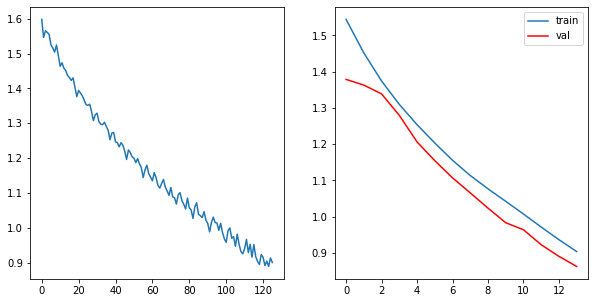

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.8688, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8950, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8944, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8600, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.8727083895813552	     Validation Loss:0.8338810567376361	 \ LR:1e-05


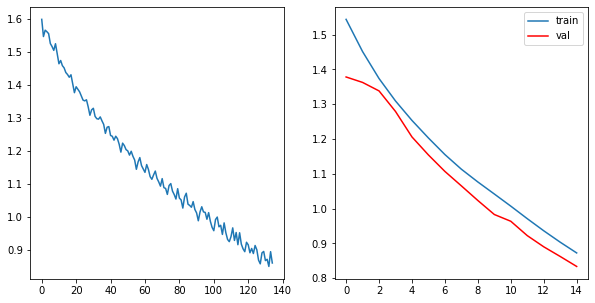

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.8451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8519, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8284, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.8425939765642265	     Validation Loss:0.8098254598548742	 \ LR:1e-05


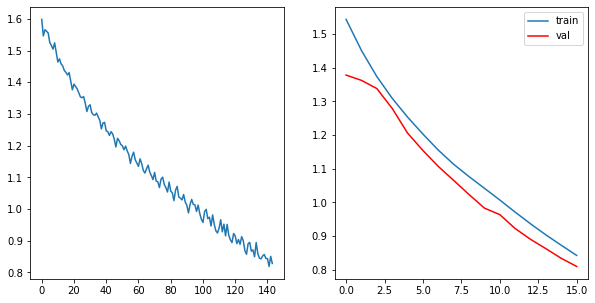

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.8063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8044, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8052, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7905, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.8077134405347988	     Validation Loss:0.7902426539153811	 \ LR:1e-05


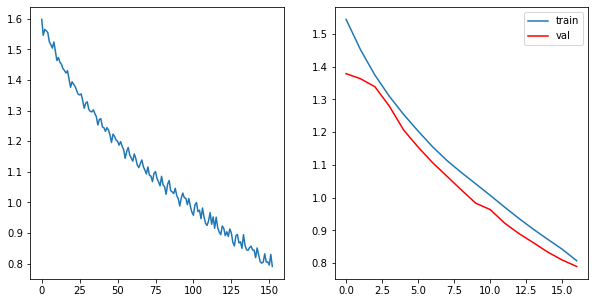

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7850, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7805, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7806, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7617, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8000, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7712, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.7807335039414486	     Validation Loss:0.7319079186665757	 \ LR:1e-05


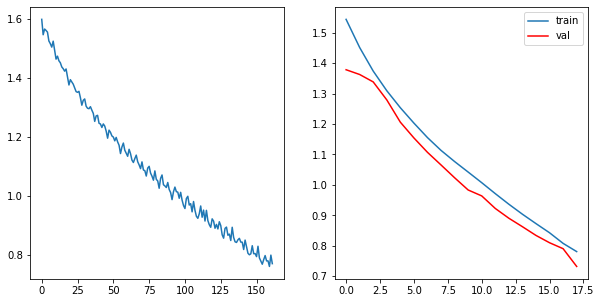

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7819, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7385, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.7494709101135957	     Validation Loss:0.727382645073437	 \ LR:1e-05


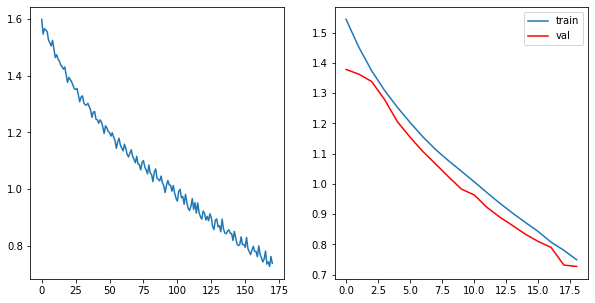

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7275, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7178, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7174, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7122, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.722892705744955	     Validation Loss:0.6922684579737103	 \ LR:1e-05


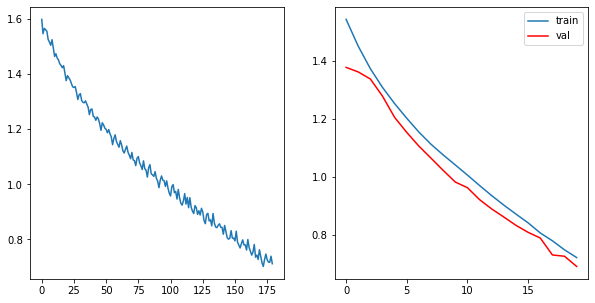

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6800, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6803, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6889, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6874, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7262, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6830, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.6953119252805889	     Validation Loss:0.6683534476271031	 \ LR:1e-05


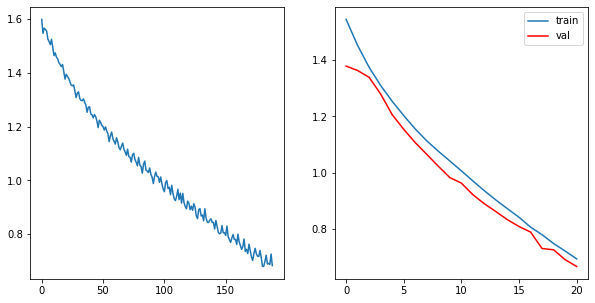

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6777, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6611, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6644, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.6760573795229037	     Validation Loss:0.6448175223252935	 \ LR:1e-05


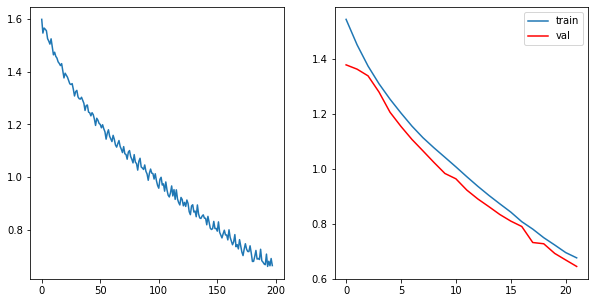

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6359, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6682, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6419, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.6464415819186966	     Validation Loss:0.6299265576598025	 \ LR:1e-05


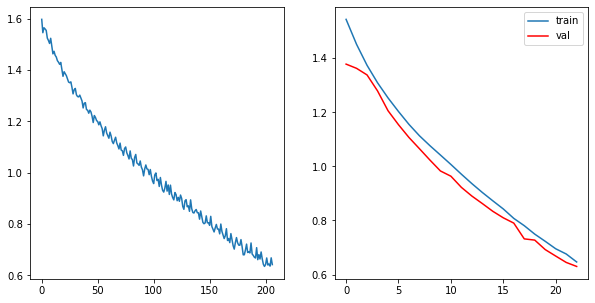

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6116, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6181, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6119, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6255, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.6248463953785903	     Validation Loss:0.6028223329001575	 \ LR:1e-05


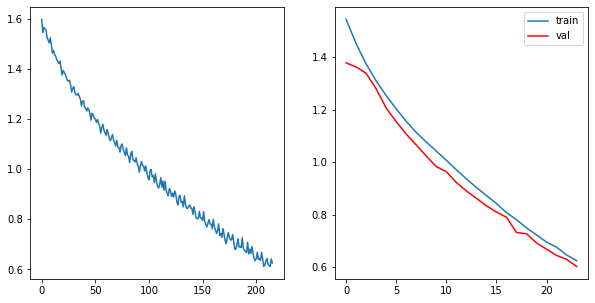

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6233, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6055, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5929, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6254, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6081, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.6051951328070483	     Validation Loss:0.5918306932566265	 \ LR:1e-05


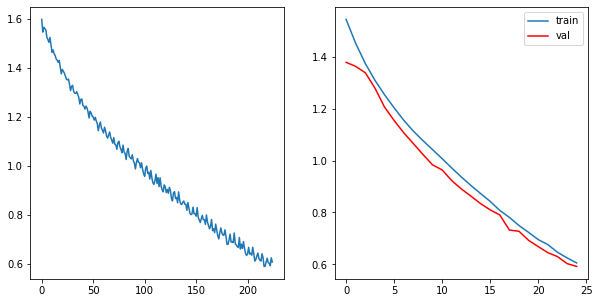

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5750, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5797, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5881, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.5862241950427961	     Validation Loss:0.5736407664042963	 \ LR:1e-05


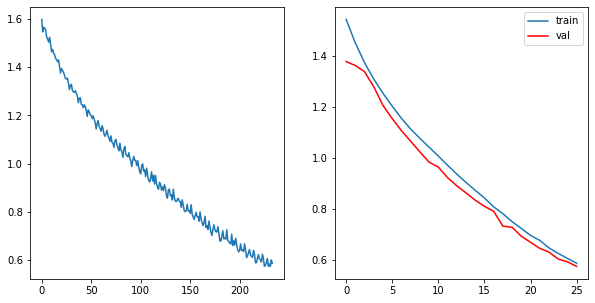

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5760, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5762, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5792, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.5742387667431875	     Validation Loss:0.5588530721905182	 \ LR:1e-05


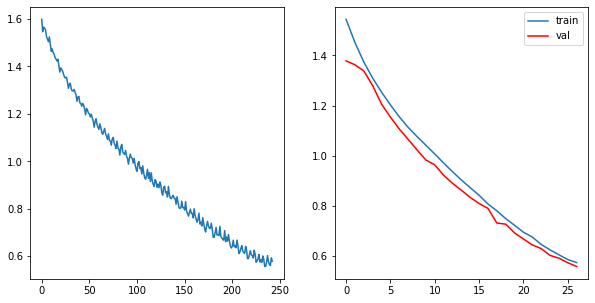

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5458, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5796, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5443, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5765, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5551, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.5563130322289501	     Validation Loss:0.5465486333048081	 \ LR:1e-05


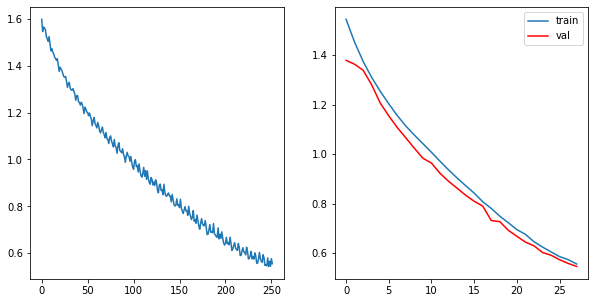

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5261, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5476, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.5403053019015611	     Validation Loss:0.5236576478400122	 \ LR:1e-05


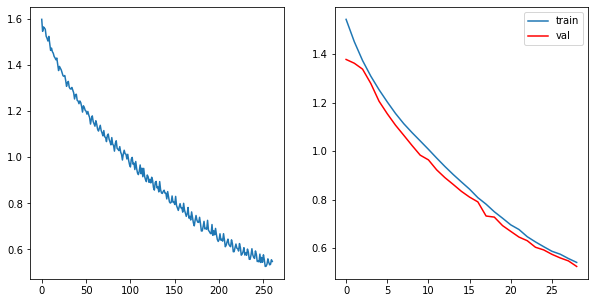

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5030, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5225, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5134, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5278, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.5266203350244404	     Validation Loss:0.5208377662705049	 \ LR:1e-05


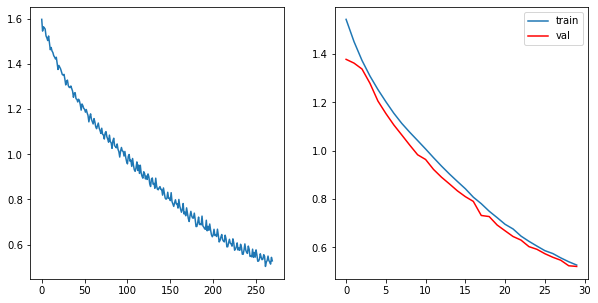

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4932, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5051, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5050, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5302, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.514371638435582	     Validation Loss:0.49904912269453955	 \ LR:1e-05


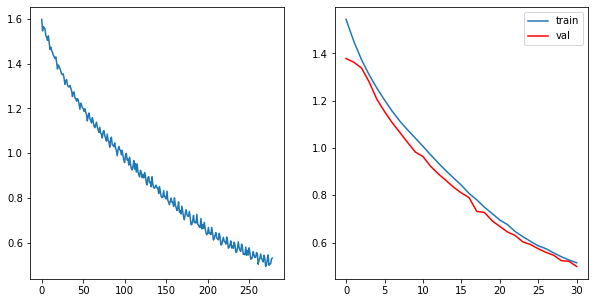

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4838, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4934, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4848, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5041, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5085, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.5021778727958748	     Validation Loss:0.4938017174209966	 \ LR:1e-05


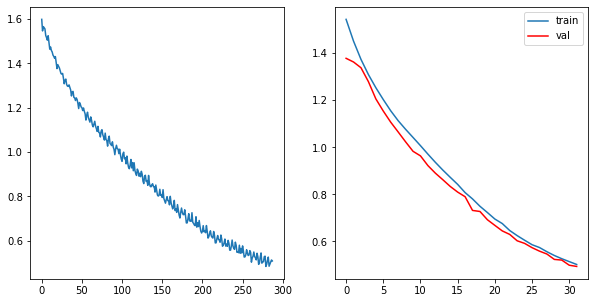

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4777, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4898, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5147, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4835, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4974, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.4906093144186687	     Validation Loss:0.4831905279180659	 \ LR:1e-05


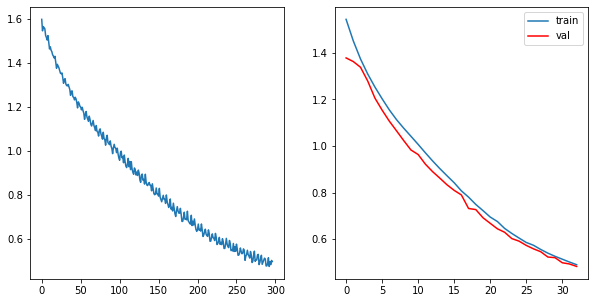

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4748, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4685, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4861, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4846, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4884, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4887, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.4795570880316592	     Validation Loss:0.46136060054420547	 \ LR:1e-05


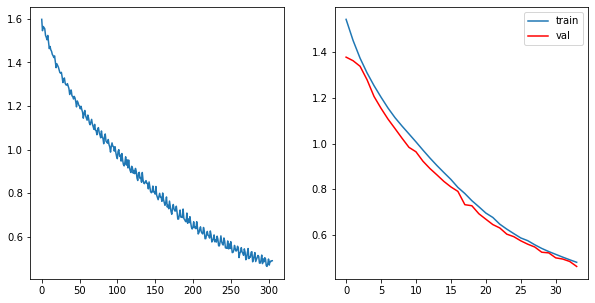

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4684, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4686, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.46713298350233845	     Validation Loss:0.46384057436217024	 \ LR:1e-05


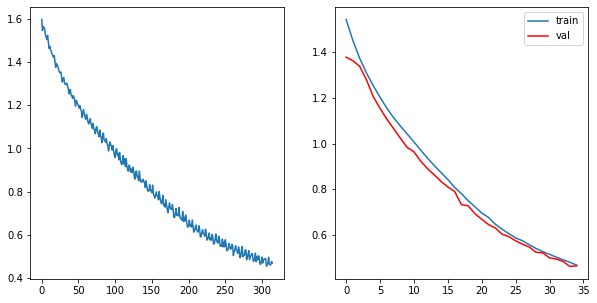

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4366, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4808, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4623, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4613, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4733, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.4579171265756641	     Validation Loss:0.45637529132544036	 \ LR:1e-05


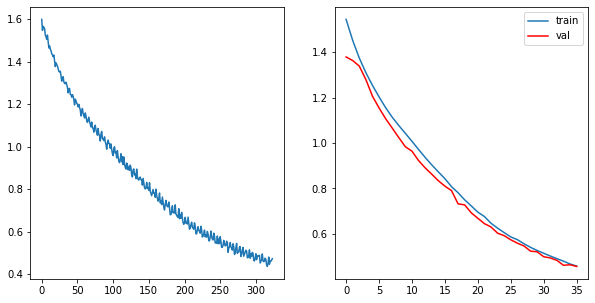

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4327, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4739, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4549, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.4477937078990759	     Validation Loss:0.4490157401939796	 \ LR:1e-05


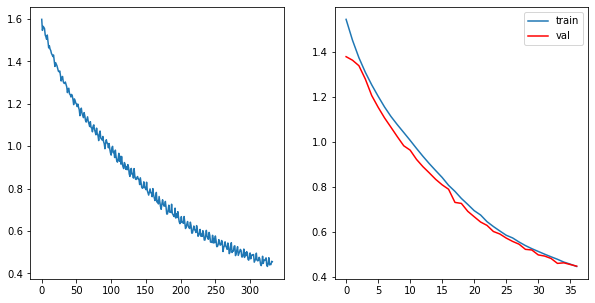

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4310, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4342, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4573, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4492, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.43965284019483436	     Validation Loss:0.44514818123363825	 \ LR:1e-05


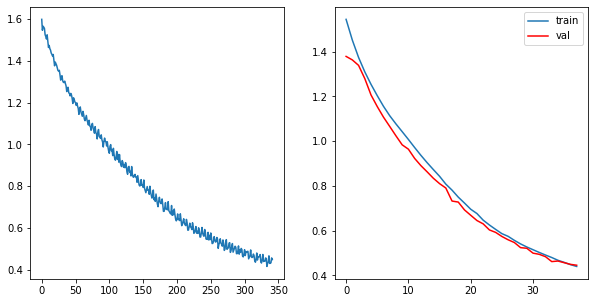

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4209, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4204, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4329, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4265, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4327, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4389, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.43316741207342685	     Validation Loss:0.4289924625026629	 \ LR:1e-05


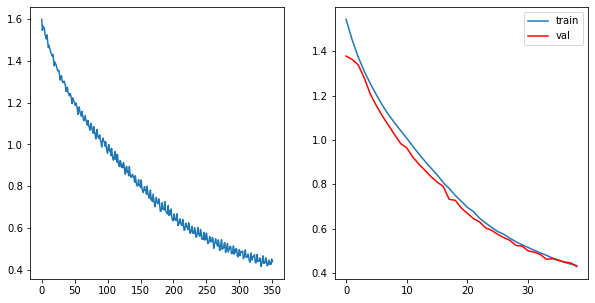

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4244, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4116, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4276, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.4219974154990439	     Validation Loss:0.4223761606065716	 \ LR:1e-05


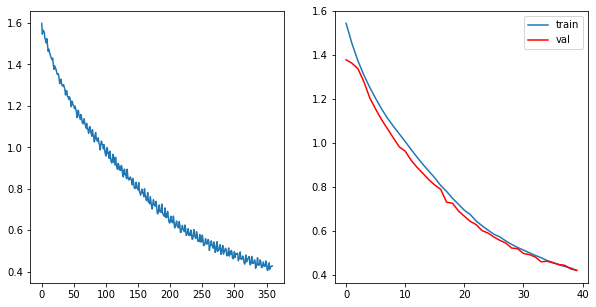

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4052, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4178, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4140, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4172, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4298, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.41911152060486645	     Validation Loss:0.4134616373584407	 \ LR:1e-05


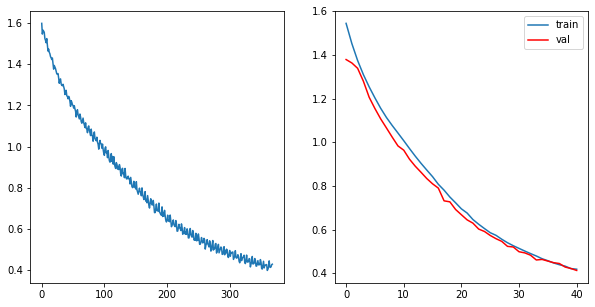

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3887, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4158, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4015, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4212, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.4086835885209189	     Validation Loss:0.4023390870826038	 \ LR:1e-05


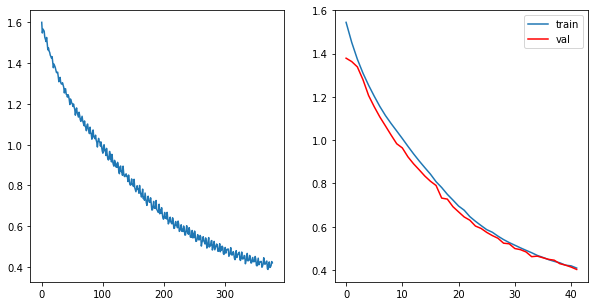

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3854, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3846, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3879, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4133, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.40101676083361293	     Validation Loss:0.3958843548651247	 \ LR:1e-05


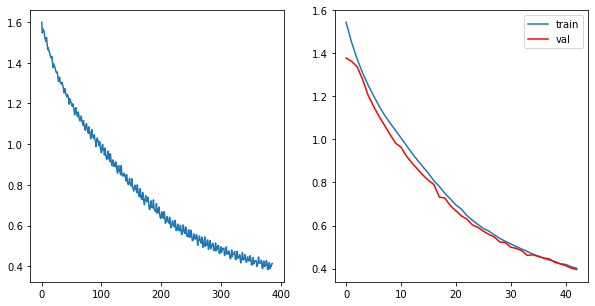

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3810, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3824, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3909, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4001, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.3925146393036053	     Validation Loss:0.3905195280206873	 \ LR:1e-05


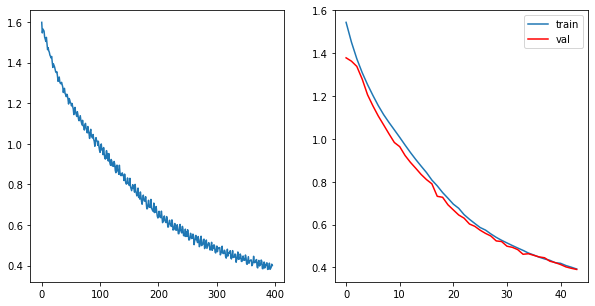

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3704, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3846, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3922, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3915, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3959, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.38842201660688064	     Validation Loss:0.38641330160019344	 \ LR:1e-05


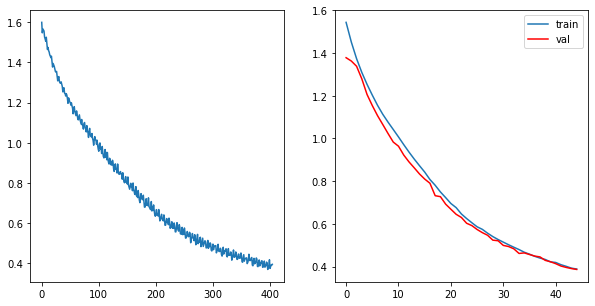

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3693, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3702, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3957, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3770, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3781, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3820, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3874, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3892, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.380644548970917	     Validation Loss:0.38618040156223543	 \ LR:1e-05


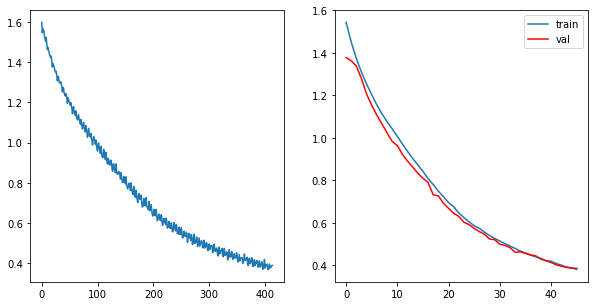

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3702, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3738, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3825, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3814, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.37520502232516534	     Validation Loss:0.37269477386222327	 \ LR:1e-05


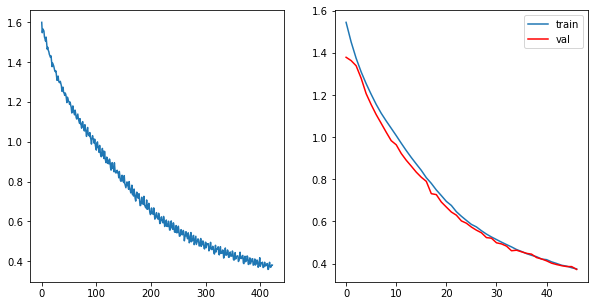

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3652, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3784, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3823, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.36912591985301635	     Validation Loss:0.37221370935858616	 \ LR:1e-05


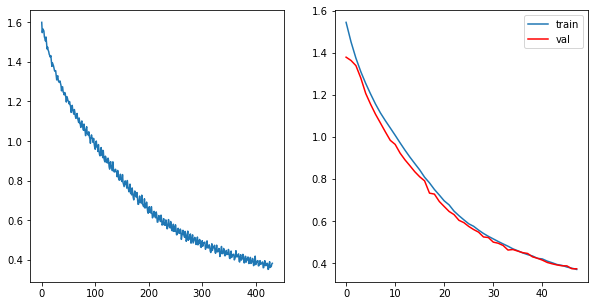

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3630, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3846, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3743, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.3618642369416495	     Validation Loss:0.36329878375941743	 \ LR:1e-05


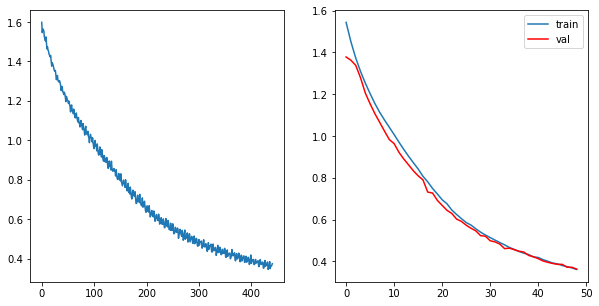

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3609, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3835, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3502, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3670, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.36154102939213484	     Validation Loss:0.36150599664619953	 \ LR:1e-05


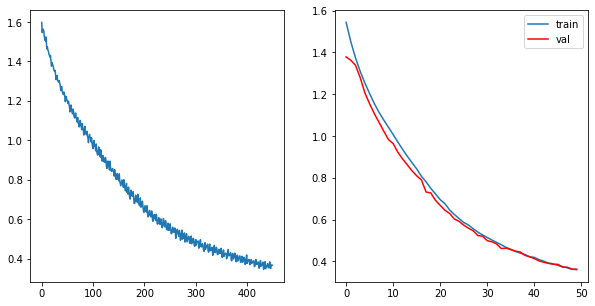

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3654, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.35666531471788665	     Validation Loss:0.36445236508504664	 \ LR:1e-05


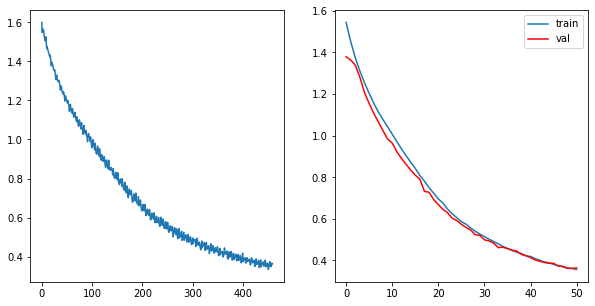

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3351, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3336, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3693, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3502, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3592, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.3494511364941506	     Validation Loss:0.35026152018908124	 \ LR:1e-05


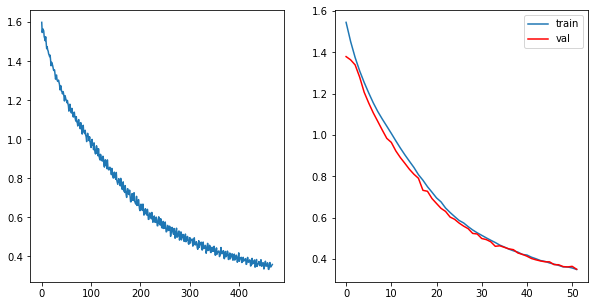

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3647, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3552, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.34478238968106933	     Validation Loss:0.34800292822043827	 \ LR:1e-05


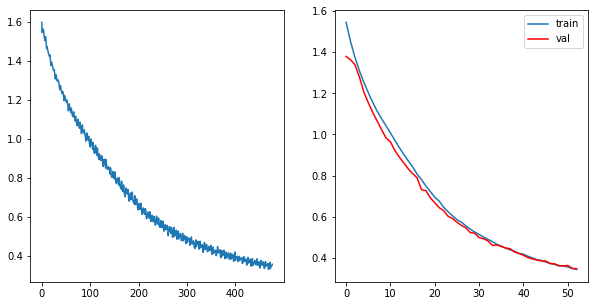

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3233, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3342, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3467, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.3397603556237109	     Validation Loss:0.34396367085657403	 \ LR:1e-05


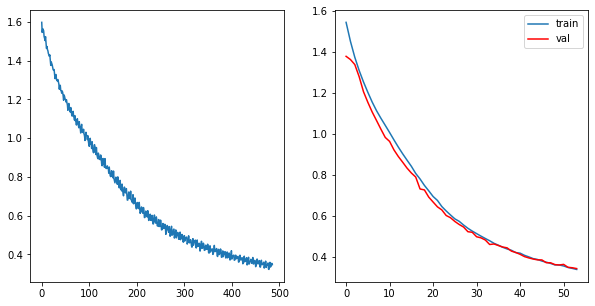

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3482, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.3362580929065314	     Validation Loss:0.3409585394522174	 \ LR:1e-05


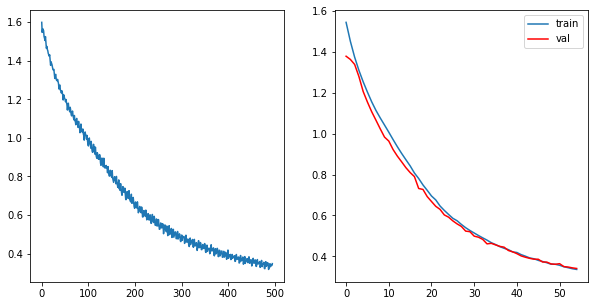

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3153, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3181, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3305, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3458, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3456, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.33219827135459323	     Validation Loss:0.33994298049360044	 \ LR:1e-05


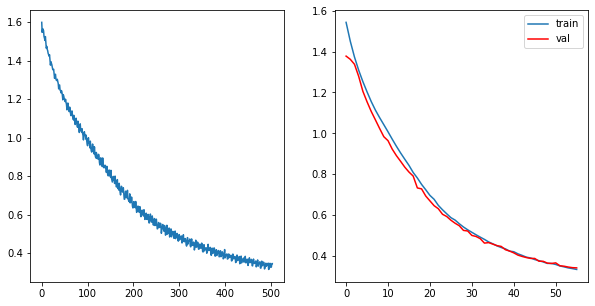

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3135, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3173, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3211, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3366, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.32670404067753567	     Validation Loss:0.330006337624775	 \ LR:1e-05


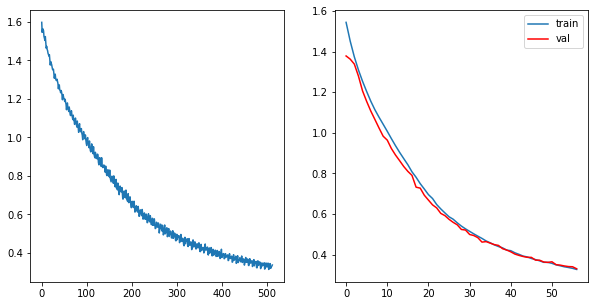

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3106, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3376, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3254, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3334, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3357, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 57	 \Training Loss: 0.3247971994675228	     Validation Loss:0.33666404187373683	 \ LR:1e-05


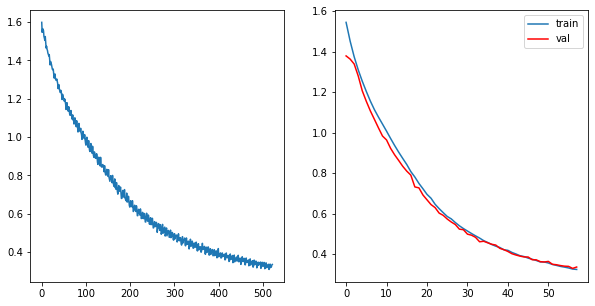

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3137, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3215, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3153, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3244, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3285, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3276, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 58	 \Training Loss: 0.32143874526392024	     Validation Loss:0.32872222046817196	 \ LR:1e-05


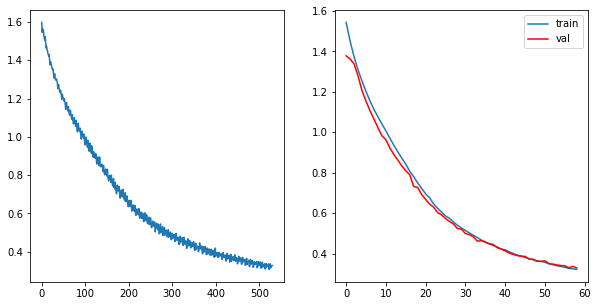

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2999, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3204, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3106, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3166, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3264, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3308, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 59	 \Training Loss: 0.3173272357259317	     Validation Loss:0.3288433720219152	 \ LR:1e-05


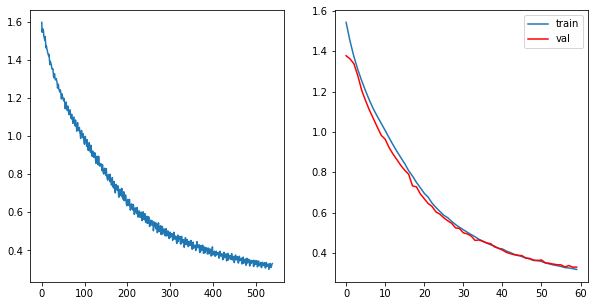

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3137, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3085, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3225, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 60	 \Training Loss: 0.31440639817694305	     Validation Loss:0.3244888731526277	 \ LR:1e-05


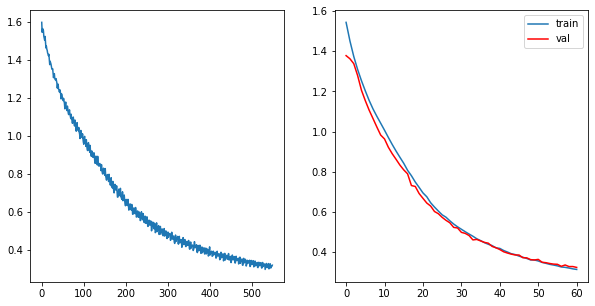

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3188, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3080, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3124, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3206, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 61	 \Training Loss: 0.3117914034043335	     Validation Loss:0.3205414410781217	 \ LR:1e-05


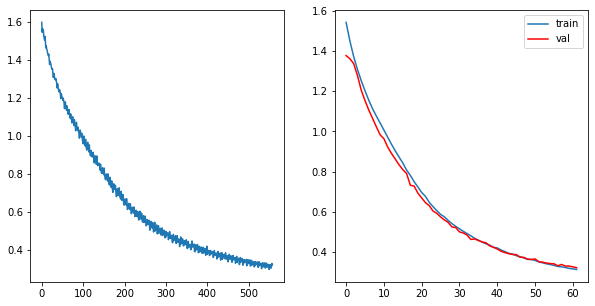

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3087, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3078, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3066, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3237, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 62	 \Training Loss: 0.30947579504589945	     Validation Loss:0.31962971961546377	 \ LR:1e-05


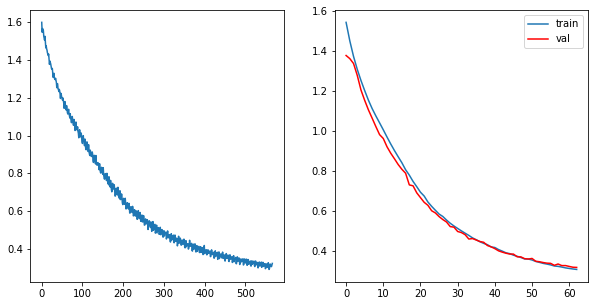

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3002, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3054, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3125, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 63	 \Training Loss: 0.30546745649610174	     Validation Loss:0.3149702499461322	 \ LR:1e-05


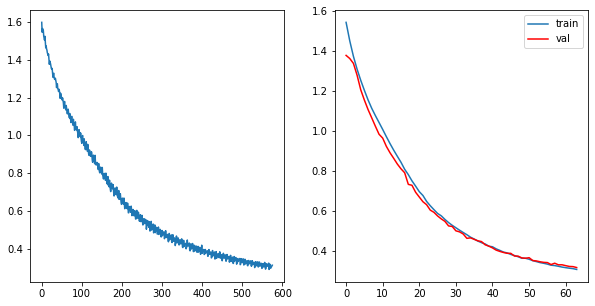

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2893, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2943, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3034, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3071, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3123, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 64	 \Training Loss: 0.30189867472199744	     Validation Loss:0.3158260462321252	 \ LR:1e-05


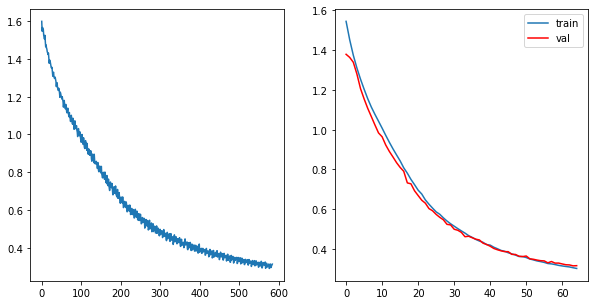

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2881, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3093, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 65	 \Training Loss: 0.30046646126628024	     Validation Loss:0.3131734951282758	 \ LR:1e-05


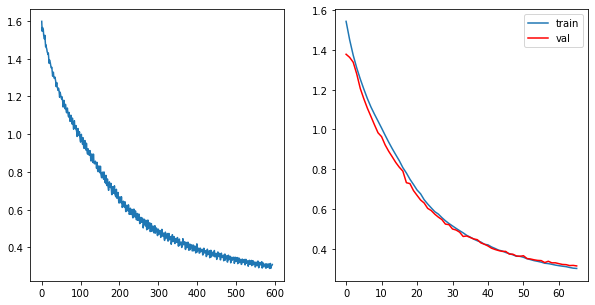

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2839, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2987, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3087, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2996, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3092, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3095, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 66	 \Training Loss: 0.2978836212212611	     Validation Loss:0.31305338921676357	 \ LR:1e-05


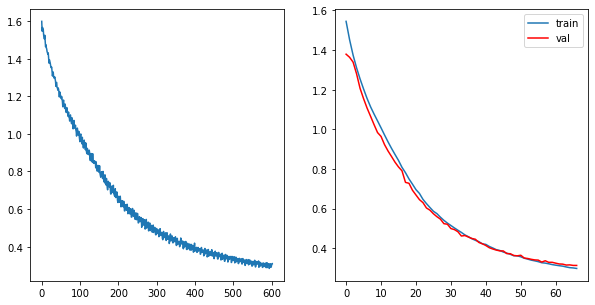

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2877, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2828, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3059, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2885, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2935, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3068, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 67	 \Training Loss: 0.2945816366776113	     Validation Loss:0.30834234624732926	 \ LR:1e-05


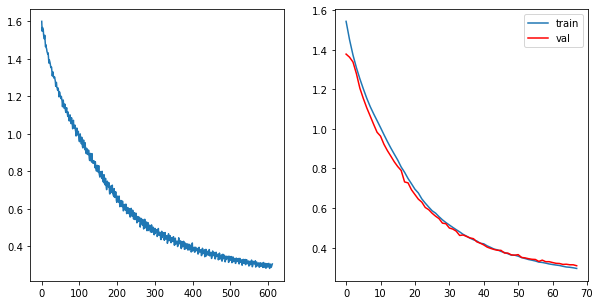

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2744, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2822, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3102, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "вертикальный и горизонтальный флип, уменьшение в глубь "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_Min_V_Glub_поиск_дырки_epoch_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(0.1785, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2341, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1842, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1921, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2205, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1909, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2468, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 0	 \Training Loss: 0.21145350689929962	     Validation Loss:0.22872640071753958	 \ LR:0.001


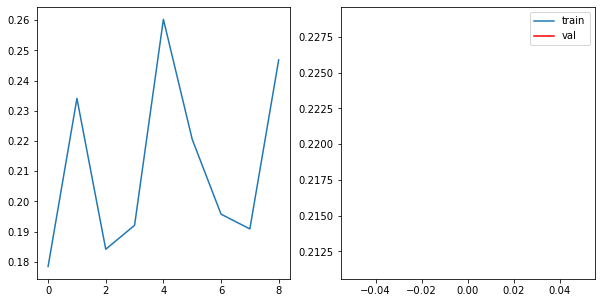

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2264, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1798, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2029, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1815, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2071, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1	 \Training Loss: 0.20155863862474643	     Validation Loss:0.1942247622407516	 \ LR:0.001


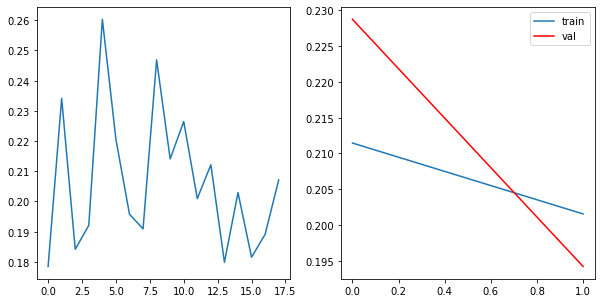

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1790, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1674, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1725, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1822, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1772, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1804, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1841, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 2	 \Training Loss: 0.18453859707478737	     Validation Loss:0.20601899581284844	 \ LR:0.001


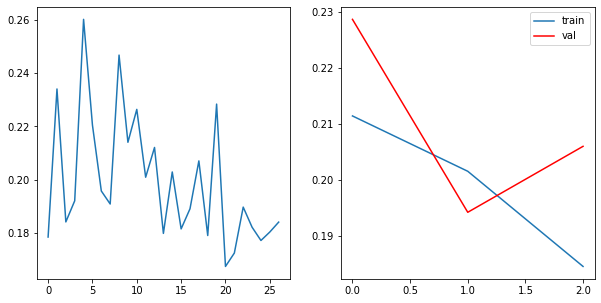

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1853, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1913, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1764, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1786, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1741, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 3	 \Training Loss: 0.17933989491736696	     Validation Loss:0.18948361143115197	 \ LR:0.001


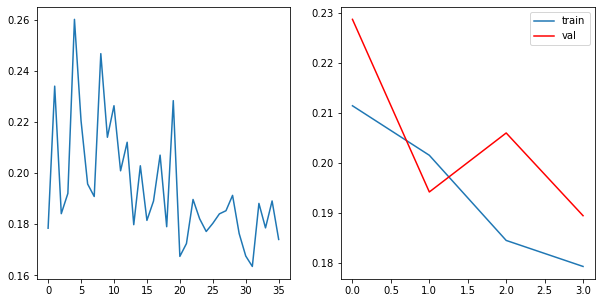

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1686, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1879, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1775, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1721, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1667, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1688, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1773, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 4	 \Training Loss: 0.1725967534687421	     Validation Loss:0.17623214571097412	 \ LR:0.001


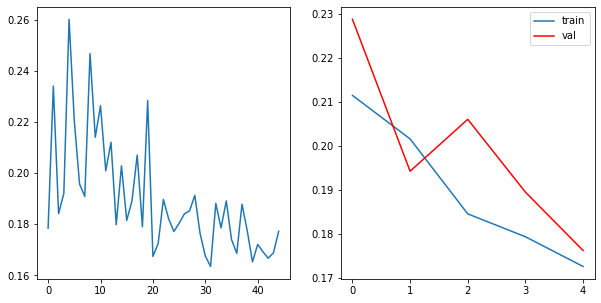

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1794, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1627, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1710, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1671, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1665, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 5	 \Training Loss: 0.16514318056842658	     Validation Loss:0.17677375283933797	 \ LR:0.001


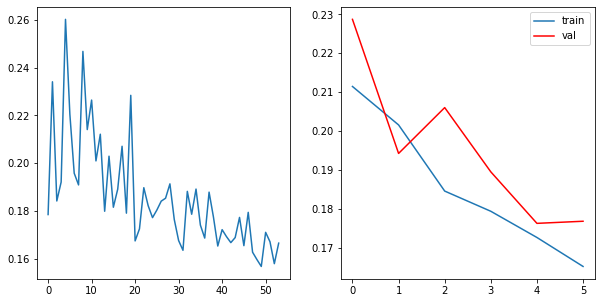

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1758, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1591, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1590, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1636, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 6	 \Training Loss: 0.16210882444704963	     Validation Loss:0.17250879836913421	 \ LR:0.001


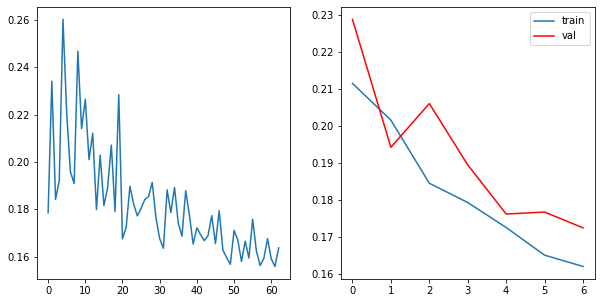

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1706, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1796, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 7	 \Training Loss: 0.16406044183662377	     Validation Loss:0.17129517682628895	 \ LR:0.001


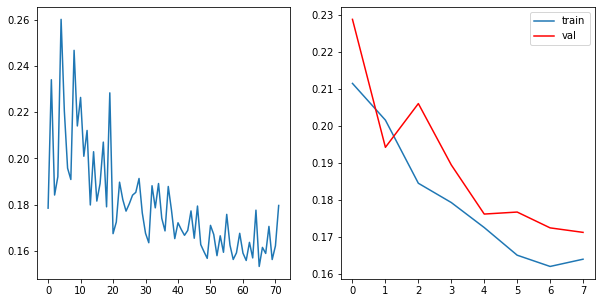

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1596, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1667, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1637, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1698, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 8	 \Training Loss: 0.16242461488566728	     Validation Loss:0.17549469391715725	 \ LR:0.001


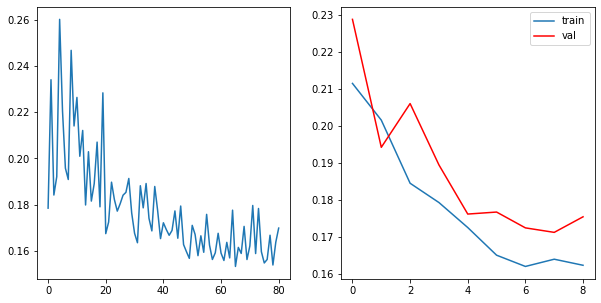

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1553, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1723, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1553, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 9	 \Training Loss: 0.15687388436822433	     Validation Loss:0.17225430298091746	 \ LR:0.001


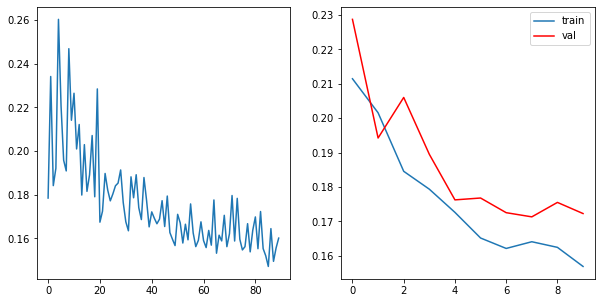

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1688, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1592, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1682, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 10	 \Training Loss: 0.16005553158220404	     Validation Loss:0.17318859367600034	 \ LR:0.001


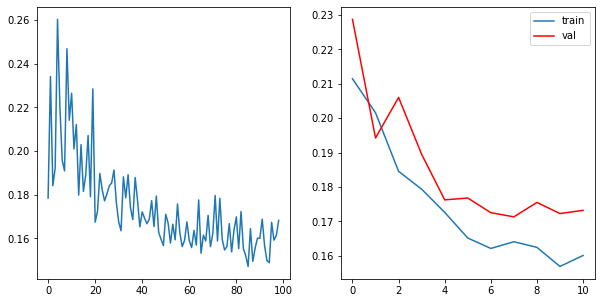

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1765, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1568, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1613, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1676, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 11	 \Training Loss: 0.16106137073048002	     Validation Loss:0.17290558284027932	 \ LR:0.001


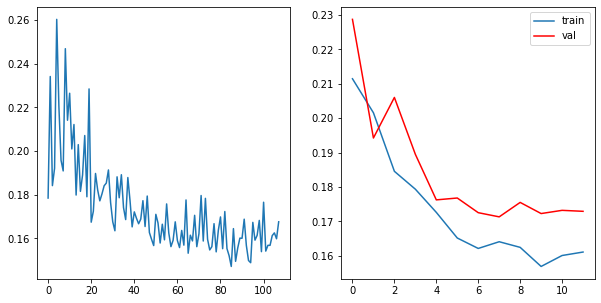

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1615, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1601, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 12	 \Training Loss: 0.15520510624231443	     Validation Loss:0.17236548544413974	 \ LR:0.001


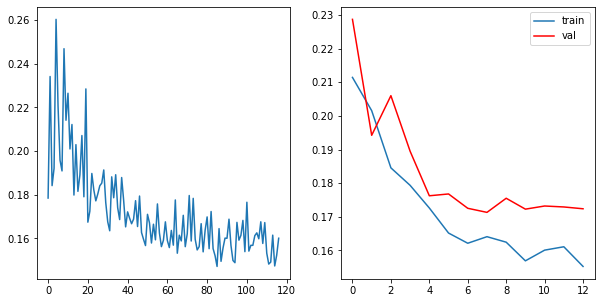

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1673, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1583, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1649, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 13	 \Training Loss: 0.15645836240968805	     Validation Loss:0.1716475382164954	 \ LR:0.0001


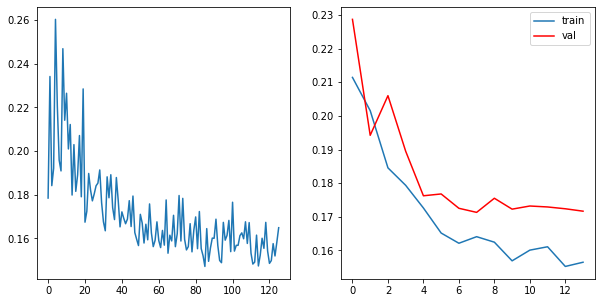

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1456, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 14	 \Training Loss: 0.1520971947643184	     Validation Loss:0.1688449792983647	 \ LR:0.0001


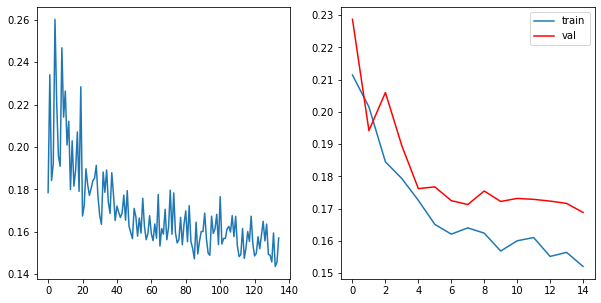

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 15	 \Training Loss: 0.1470019183351411	     Validation Loss:0.16602352665163703	 \ LR:0.0001


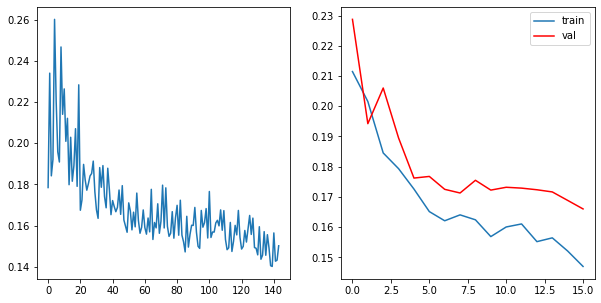

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1574, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1415, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 16	 \Training Loss: 0.14751636401109536	     Validation Loss:0.16922373448782155	 \ LR:0.0001


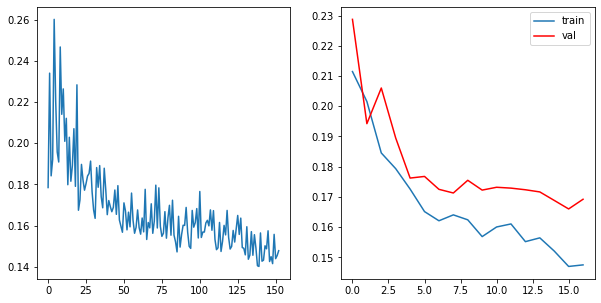

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1445, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 17	 \Training Loss: 0.1474462547902398	     Validation Loss:0.16790431628056204	 \ LR:0.0001


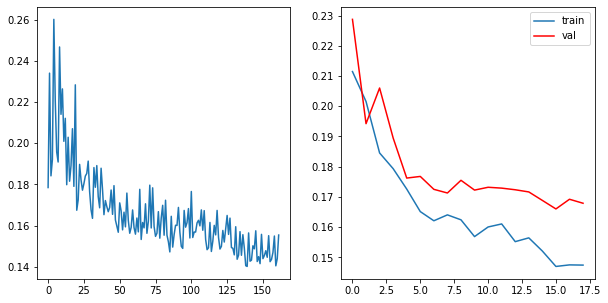

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1549, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1531, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 18	 \Training Loss: 0.14682354065710432	     Validation Loss:0.16828871607837584	 \ LR:0.0001


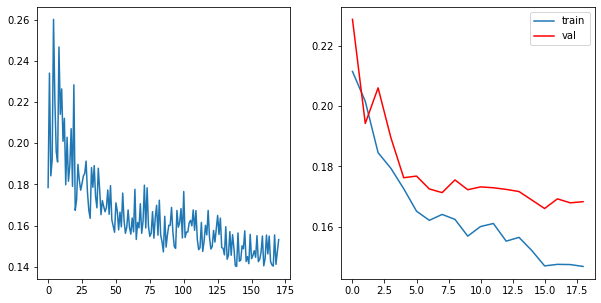

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 19	 \Training Loss: 0.1468937260036497	     Validation Loss:0.1672643371082255	 \ LR:0.0001


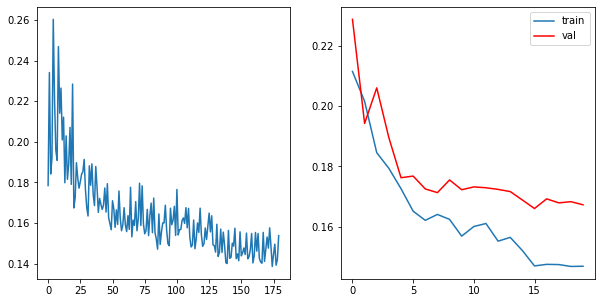

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 20	 \Training Loss: 0.14638213267295896	     Validation Loss:0.16647395265217146	 \ LR:0.0001


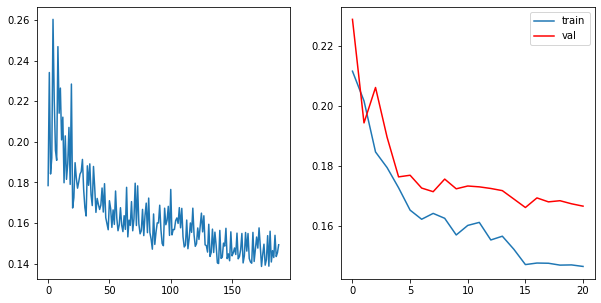

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1536, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1586, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 21	 \Training Loss: 0.14773123200984983	     Validation Loss:0.16572843177010263	 \ LR:0.0001


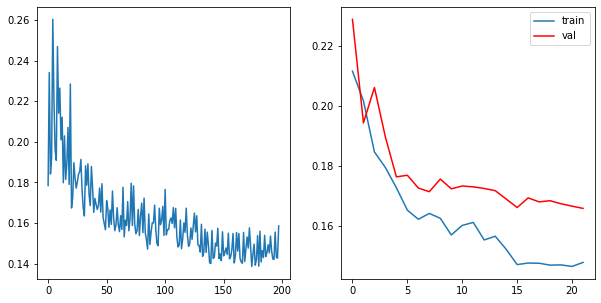

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1453, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1516, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 22	 \Training Loss: 0.1459412448375409	     Validation Loss:0.16572729426237554	 \ LR:0.0001


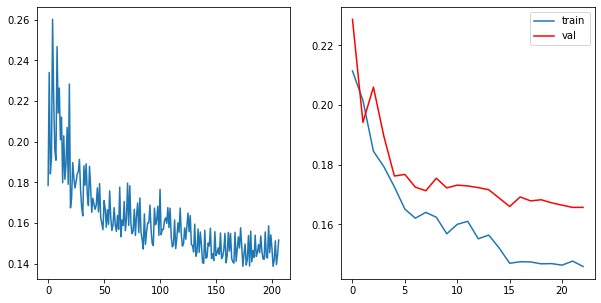

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1562, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1391, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 23	 \Training Loss: 0.1459648203760091	     Validation Loss:0.16510132533542596	 \ LR:0.0001


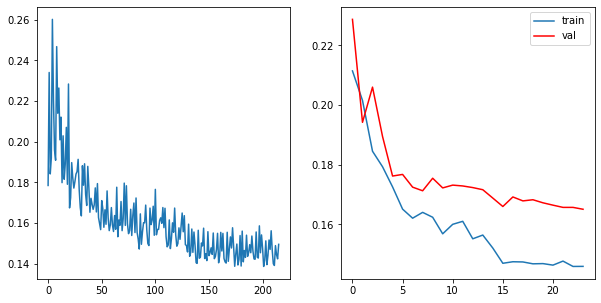

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1519, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 24	 \Training Loss: 0.14689500346329068	     Validation Loss:0.16848196556661255	 \ LR:0.0001


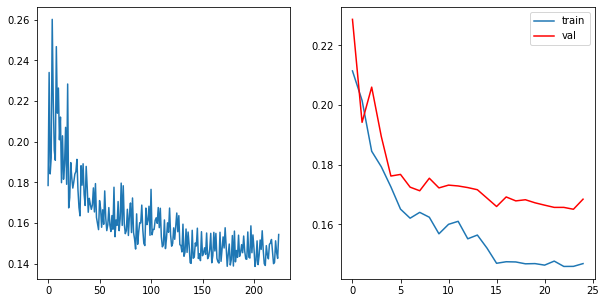

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1391, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1415, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1488, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 25	 \Training Loss: 0.14645479031182743	     Validation Loss:0.16547032798766545	 \ LR:0.0001


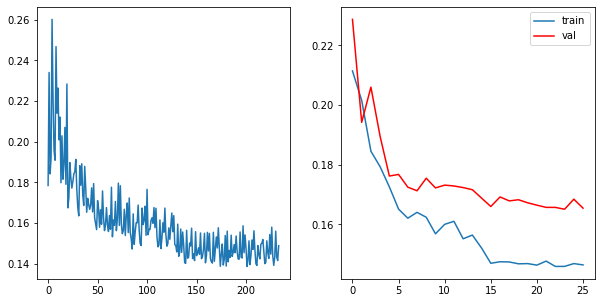

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1407, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 26	 \Training Loss: 0.14503027655908457	     Validation Loss:0.16729522136930522	 \ LR:0.0001


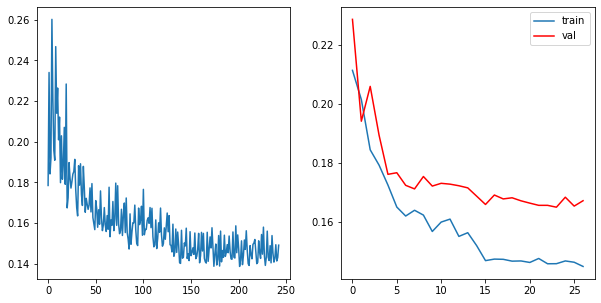

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1527, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 27	 \Training Loss: 0.14568749497267858	     Validation Loss:0.16490764185430948	 \ LR:0.0001


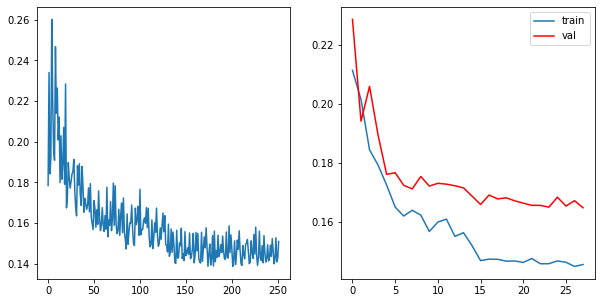

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1515, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 28	 \Training Loss: 0.14600404980796455	     Validation Loss:0.16730024664464693	 \ LR:0.0001


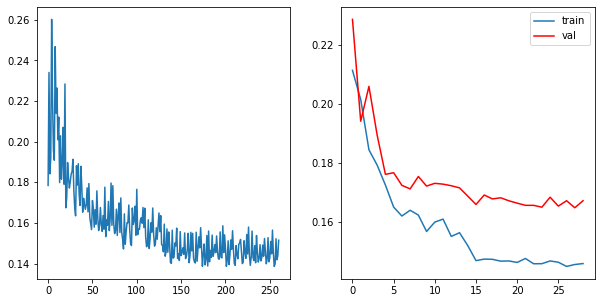

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 29	 \Training Loss: 0.14533214457556817	     Validation Loss:0.16855886607580295	 \ LR:0.0001


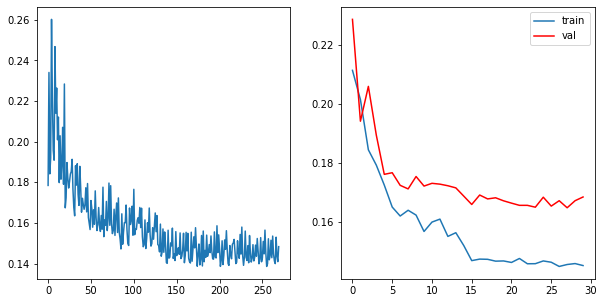

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1412, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 30	 \Training Loss: 0.14456824757932032	     Validation Loss:0.16477940946990996	 \ LR:0.0001


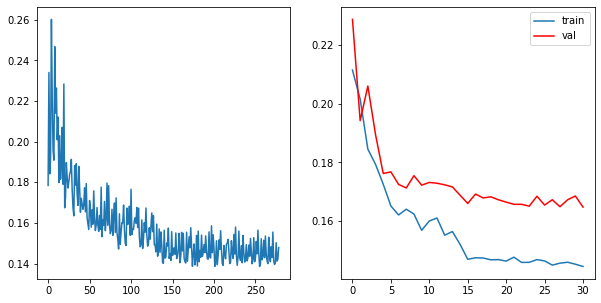

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1467, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1494, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 31	 \Training Loss: 0.14455017421274505	     Validation Loss:0.16785717319475202	 \ LR:0.0001


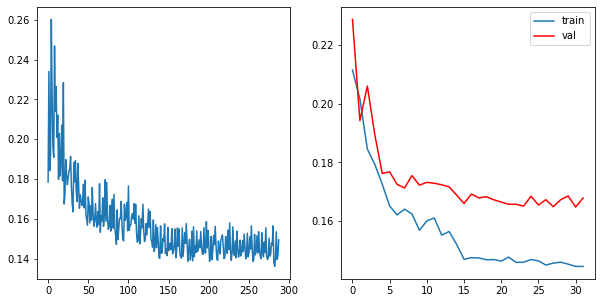

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1453, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 32	 \Training Loss: 0.14355015881161004	     Validation Loss:0.1648262216056109	 \ LR:0.0001


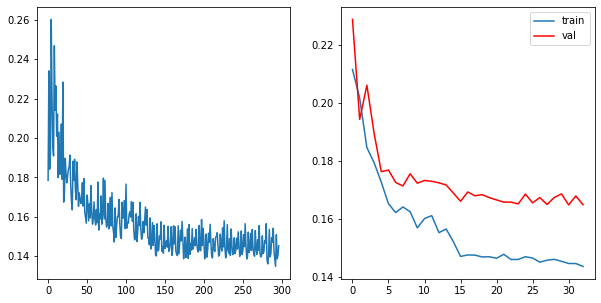

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1505, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 33	 \Training Loss: 0.14471779628942416	     Validation Loss:0.16456972976694104	 \ LR:0.0001


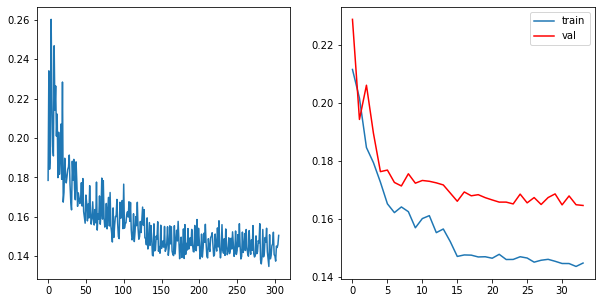

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1534, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 34	 \Training Loss: 0.14559241162037864	     Validation Loss:0.16500240386465356	 \ LR:0.0001


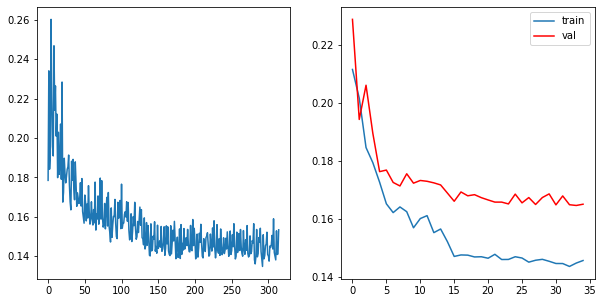

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1415, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1419, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1457, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 35	 \Training Loss: 0.14386233143932164	     Validation Loss:0.16439023427256297	 \ LR:0.0001


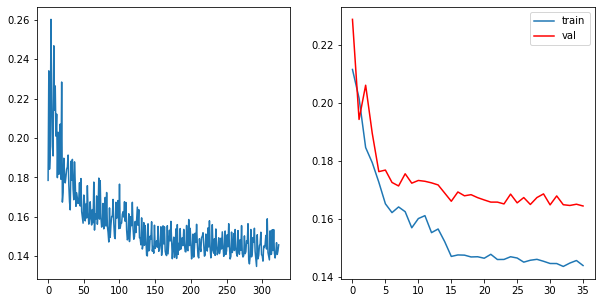

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 36	 \Training Loss: 0.1444419526545673	     Validation Loss:0.16600717207827334	 \ LR:0.0001


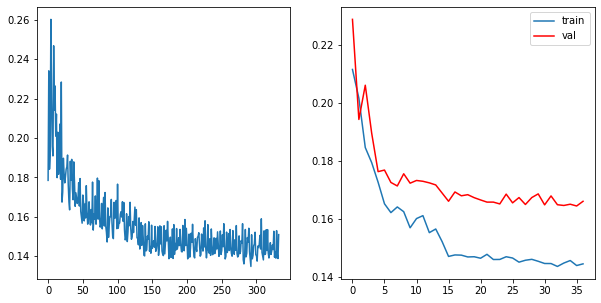

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1407, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1371, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1543, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 37	 \Training Loss: 0.14396658602678292	     Validation Loss:0.1652503704459529	 \ LR:0.0001


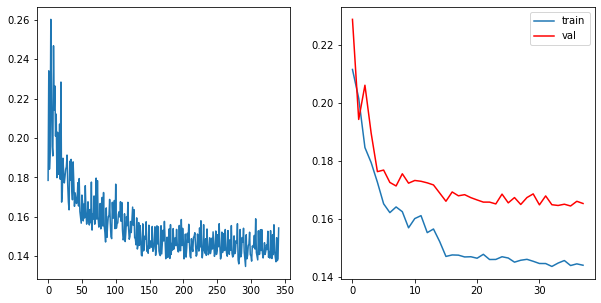

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1532, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1464, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 38	 \Training Loss: 0.14408875367425156	     Validation Loss:0.16216167116907673	 \ LR:0.0001


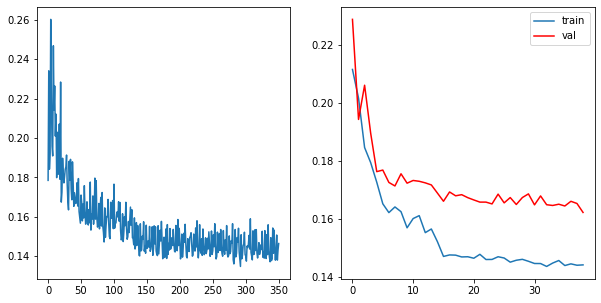

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1372, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1487, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 39	 \Training Loss: 0.14417285824029344	     Validation Loss:0.1665140442042379	 \ LR:0.0001


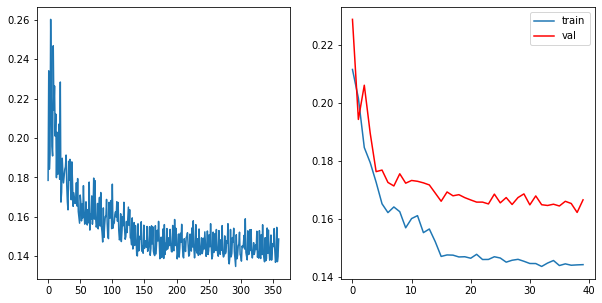

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1420, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 40	 \Training Loss: 0.14402240186975812	     Validation Loss:0.16653212997783035	 \ LR:0.0001


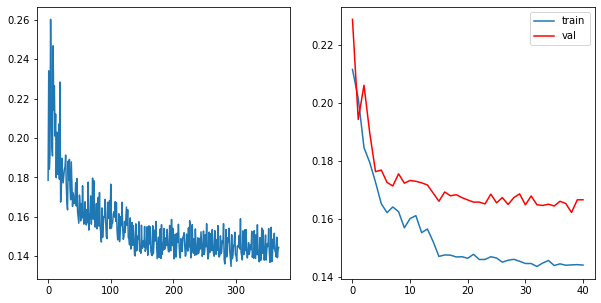

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1351, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 41	 \Training Loss: 0.1424452190928952	     Validation Loss:0.16420969309019204	 \ LR:0.0001


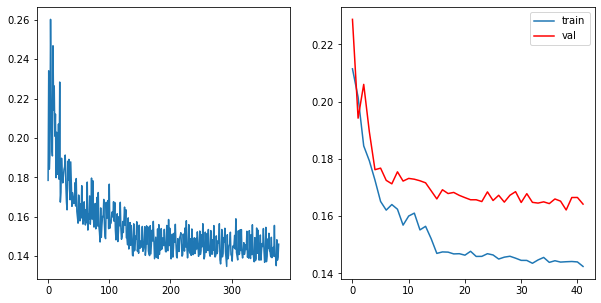

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1348, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1506, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 42	 \Training Loss: 0.1426689049626867	     Validation Loss:0.16413371592394196	 \ LR:0.0001


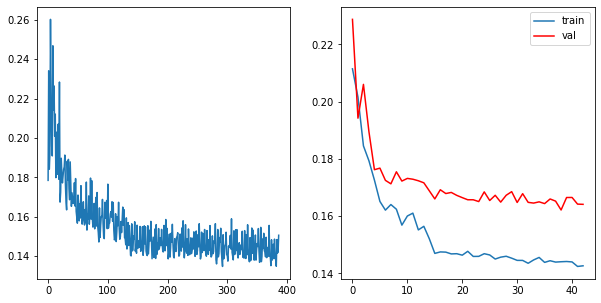

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1458, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 43	 \Training Loss: 0.14310949235612044	     Validation Loss:0.1633152684467171	 \ LR:0.0001


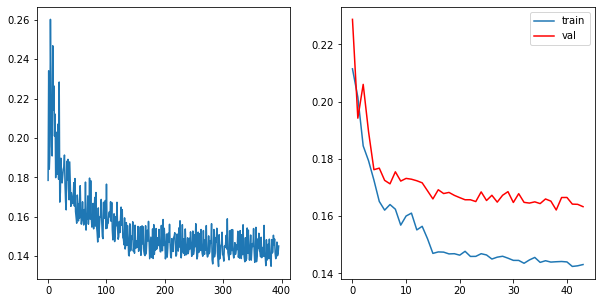

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1409, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1339, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 44	 \Training Loss: 0.1419648479873203	     Validation Loss:0.1654432321359385	 \ LR:1e-05


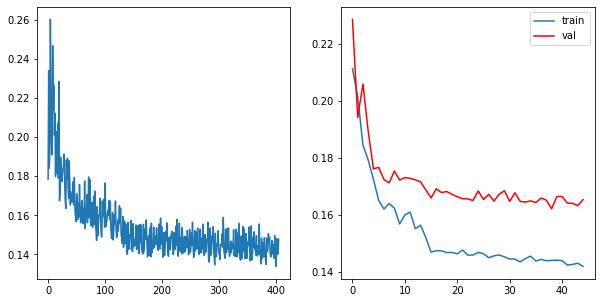

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1430, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 45	 \Training Loss: 0.14306224546870347	     Validation Loss:0.1657673266036371	 \ LR:1e-05


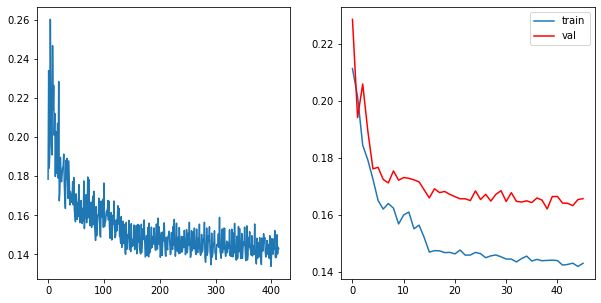

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1519, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 46	 \Training Loss: 0.14299649907205872	     Validation Loss:0.16690718026973203	 \ LR:1e-05


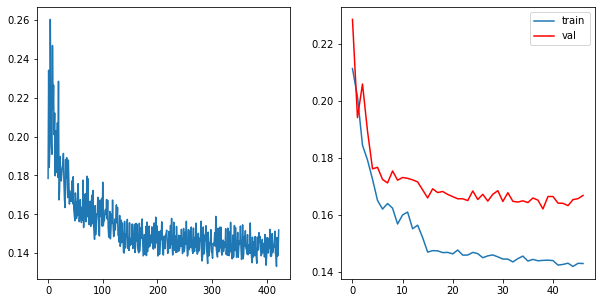

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1458, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1452, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 47	 \Training Loss: 0.14235286707942055	     Validation Loss:0.1641062616886997	 \ LR:1e-05


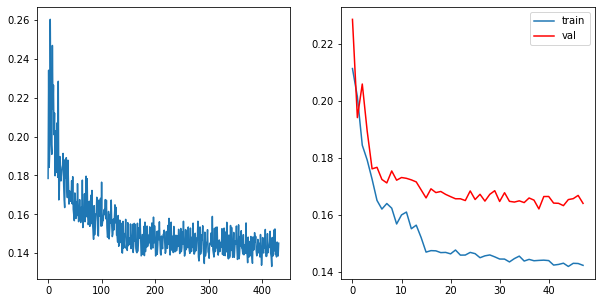

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1511, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1512, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 48	 \Training Loss: 0.14412989740365276	     Validation Loss:0.16489402815170875	 \ LR:1e-05


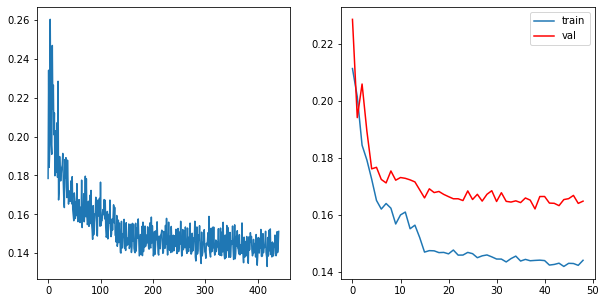

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1473, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 49	 \Training Loss: 0.1413852823875512	     Validation Loss:0.16443377290790331	 \ LR:1e-05


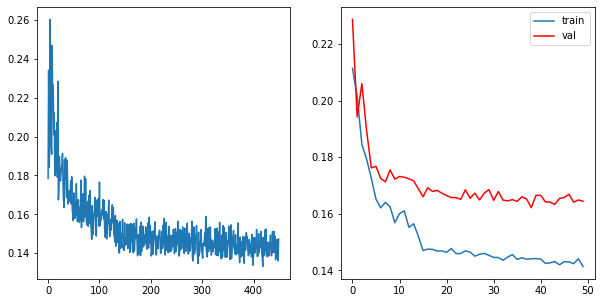

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1466, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1367, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1464, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 50	 \Training Loss: 0.14199932708735327	     Validation Loss:0.16508104054088246	 \ LR:1.0000000000000002e-06


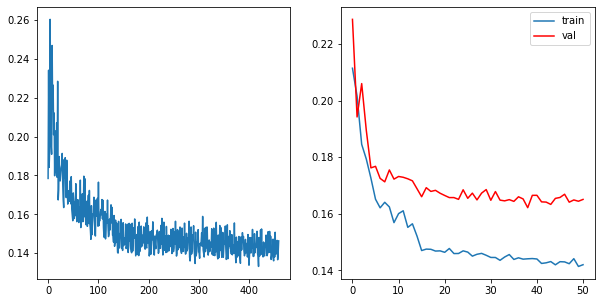

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 51	 \Training Loss: 0.14256625949361185	     Validation Loss:0.1651778331292762	 \ LR:1.0000000000000002e-06


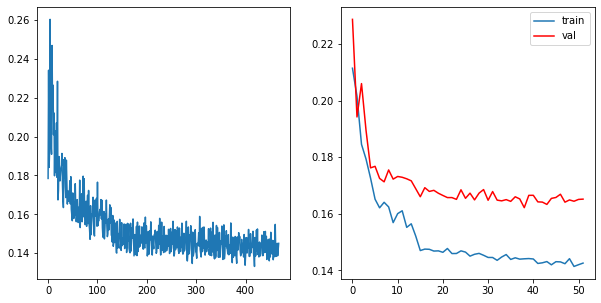

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1348, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1510, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 52	 \Training Loss: 0.14173536764603373	     Validation Loss:0.16051952048303073	 \ LR:1.0000000000000002e-06


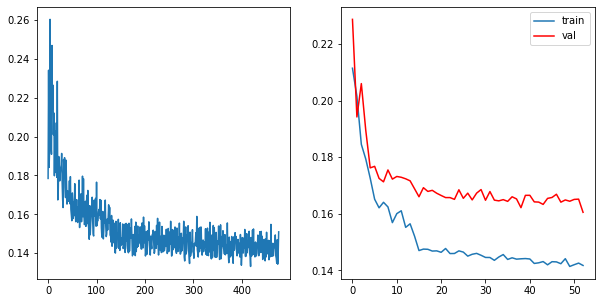

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1480, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1352, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1436, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1497, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 53	 \Training Loss: 0.14271431526944042	     Validation Loss:0.1668971529701	 \ LR:1.0000000000000002e-06


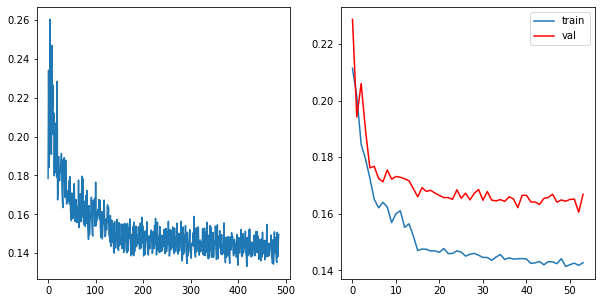

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1383, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 54	 \Training Loss: 0.14233519906306186	     Validation Loss:0.1643402314108108	 \ LR:1.0000000000000002e-06


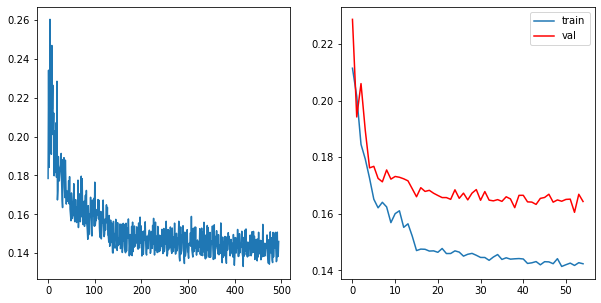

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1355, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1489, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 55	 \Training Loss: 0.1422930837101074	     Validation Loss:0.16569750843745887	 \ LR:1.0000000000000002e-06


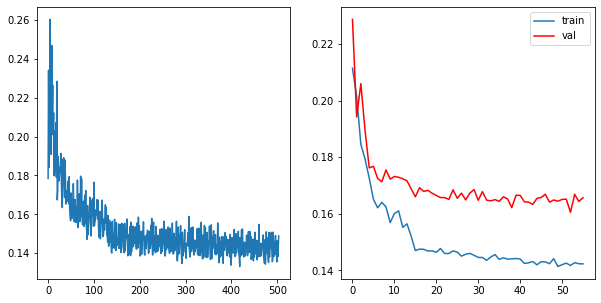

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 56	 \Training Loss: 0.14313220614992916	     Validation Loss:0.16473385451827385	 \ LR:1.0000000000000002e-06


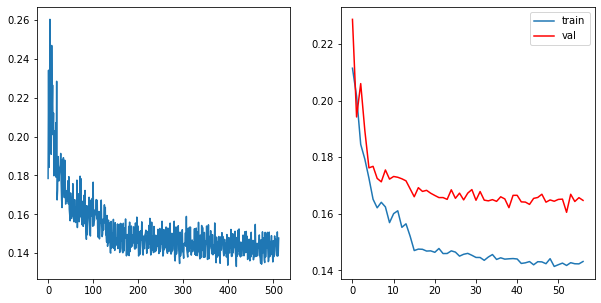

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1459, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 57	 \Training Loss: 0.14224245085894088	     Validation Loss:0.16473794358754287	 \ LR:1.0000000000000002e-06


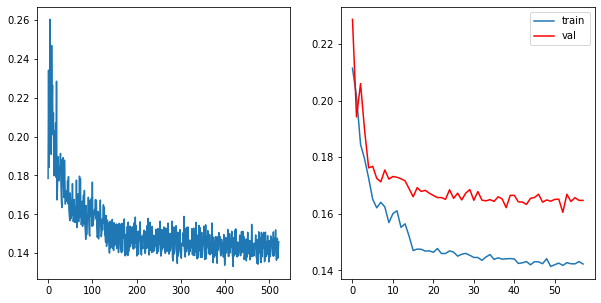

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1519, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1376, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1346, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1434, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 58	 \Training Loss: 0.1421409762041859	     Validation Loss:0.16500166772491162	 \ LR:1.0000000000000002e-07


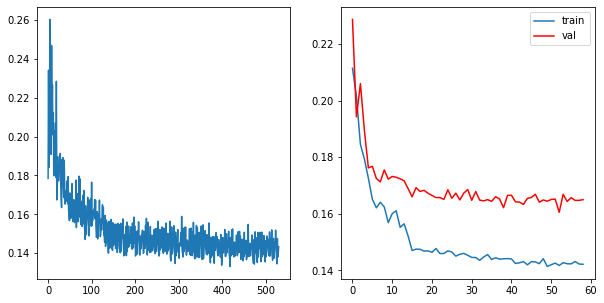

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1475, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 59	 \Training Loss: 0.1427462210982756	     Validation Loss:0.1636218105748345	 \ LR:1.0000000000000002e-07


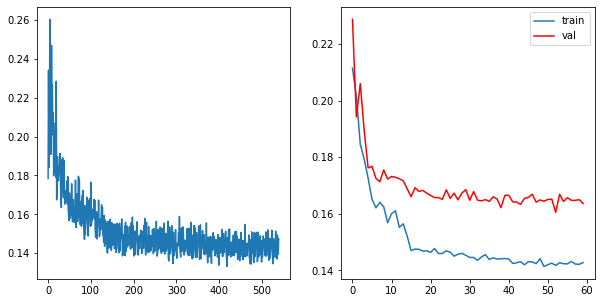

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1404, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1494, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1373, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 60	 \Training Loss: 0.14157315012839655	     Validation Loss:0.1649015135055888	 \ LR:1.0000000000000002e-07


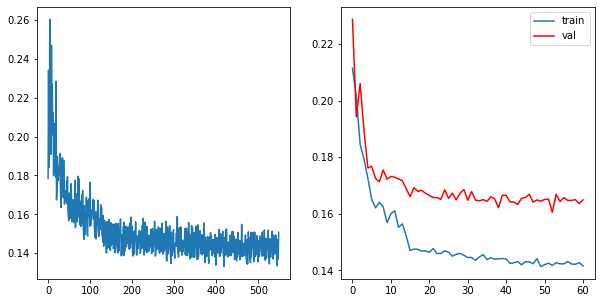

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1439, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 61	 \Training Loss: 0.14256966291144638	     Validation Loss:0.16625935017377705	 \ LR:1.0000000000000002e-07


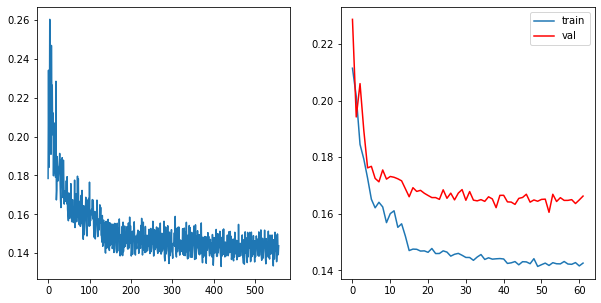

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1373, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1341, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1342, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 62	 \Training Loss: 0.14087067009747034	     Validation Loss:0.16416381753292877	 \ LR:1.0000000000000002e-07


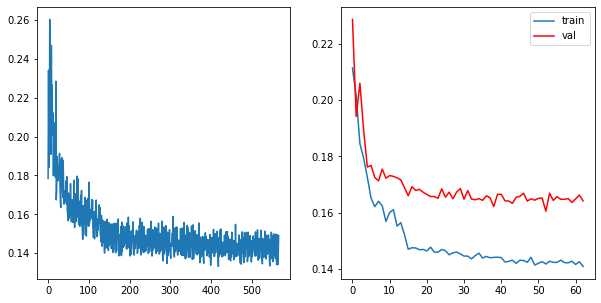

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1419, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1537, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1498, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 63	 \Training Loss: 0.1433227207579829	     Validation Loss:0.16561597293216734	 \ LR:1.0000000000000002e-07


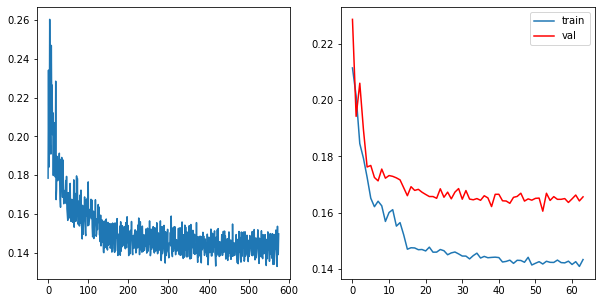

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1444, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 64	 \Training Loss: 0.14117610623819093	     Validation Loss:0.16150964831916428	 \ LR:1.0000000000000004e-08


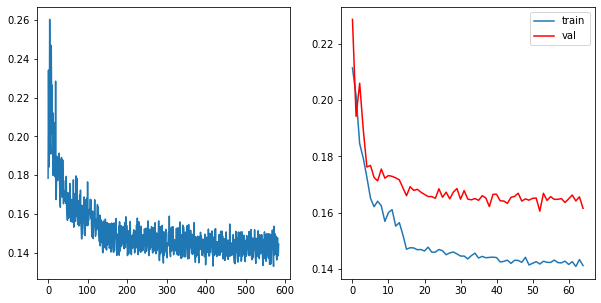

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1369, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1451, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 65	 \Training Loss: 0.14179106511382375	     Validation Loss:0.16594440122127216	 \ LR:1.0000000000000004e-08


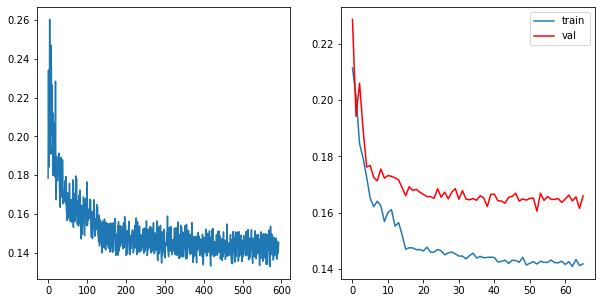

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.1390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1518, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1391, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1544, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "вертикальный и горизонтальный флип, начало с  весов state_130 "+str(optimizer.param_groups[0]['lr']),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_epoch_' + str(epoch)+ '.pth')
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    scheduler.step(epoch_loss_test/len(data_loader_test))
    curr_lr = optimizer.param_groups[0]['lr']
  
    print(f'Epoch {epoch}\t \Training Loss: {epoch_loss/len(data_loader)}\t \
    Validation Loss:{epoch_loss_test/len(data_loader_test)}\t \ LR:{curr_lr}')
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.3755, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0264, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6849, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6781, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6769, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6781, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5615, dtype=torch.float64, grad_fn=<DivBackward1>)
Введите 1 если изменить и 0 если нет: 0


  0%|          | 0/3 [00:00<?, ?it/s]

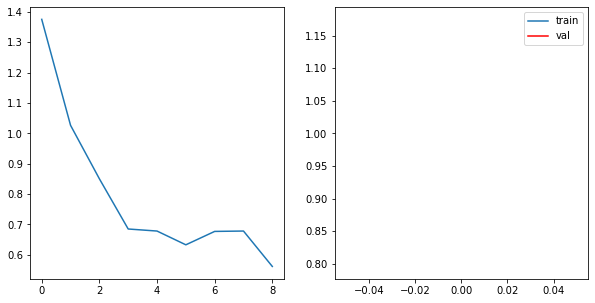

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.2063, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2127, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9634, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9620, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8891, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8503, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

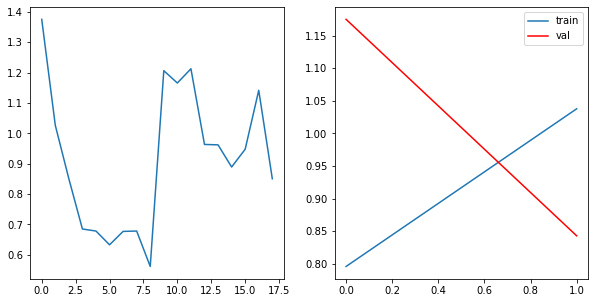

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.8534, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7719, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6600, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9278, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7593, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7439, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

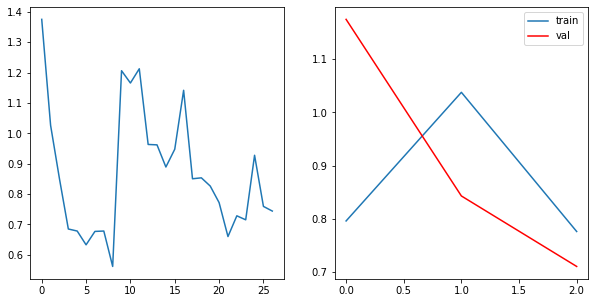

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7546, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5752, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6863, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6458, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7106, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6542, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

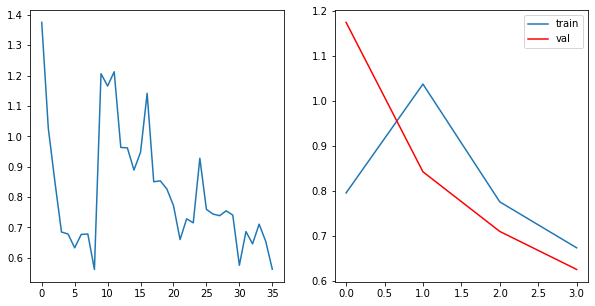

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6010, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5890, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9105, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6741, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

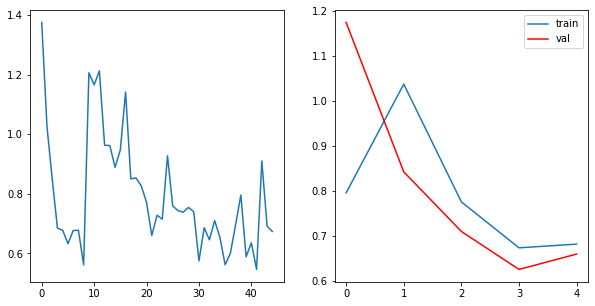

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6814, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6729, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6261, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5867, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6005, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5631, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

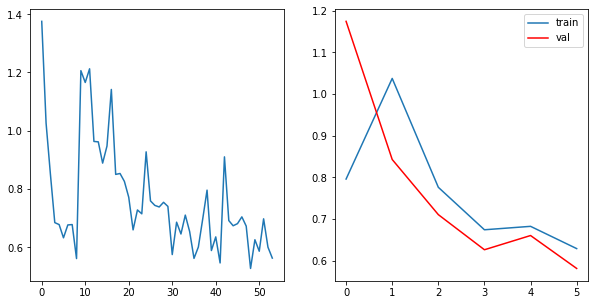

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5297, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5663, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6129, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4273, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5206, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6083, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5216, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4715, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

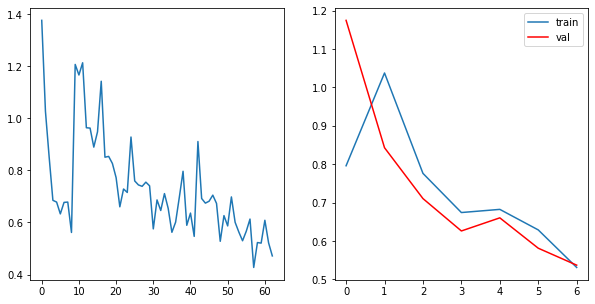

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5130, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5250, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4711, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

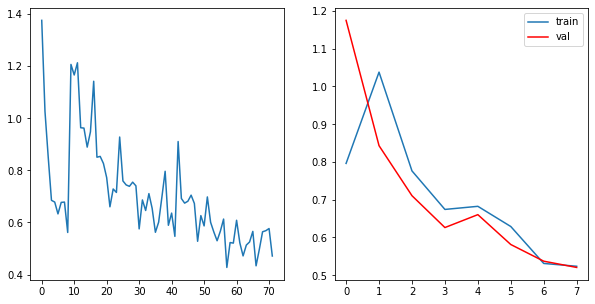

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5114, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5339, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4594, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5149, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4649, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

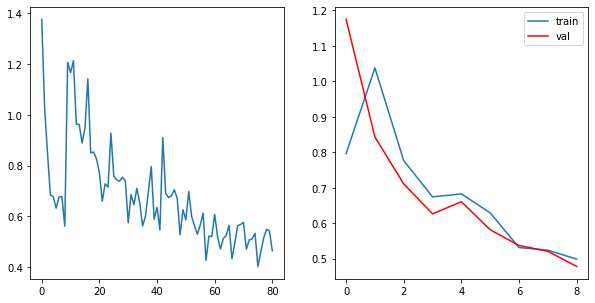

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4742, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5592, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4041, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4888, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5118, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4897, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4354, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

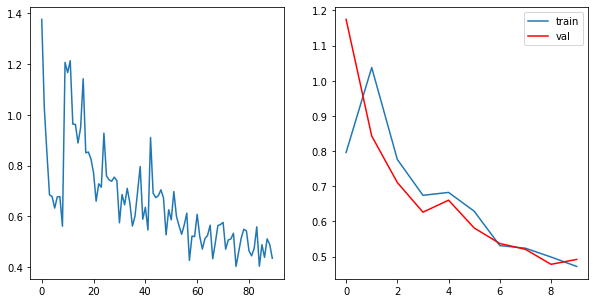

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4496, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4969, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4859, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4064, dtype=torch.float64, grad_fn=<DivBackward1>)
Введите 1 если изменить и 0 если нет: 1
На что умножить LR: 10


  0%|          | 0/3 [00:00<?, ?it/s]

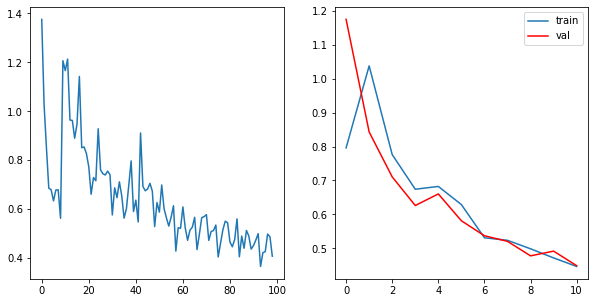

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4175, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.8186, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.4324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(3.3645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(230.0408, dtype=torch.float64, grad_fn=<DivBackward1>)


In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "вертикальный и горизонтальный флип, начало с рандомных  весов "+str(LR),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_epoch_' + str(epoch)+ '.pth')
    if epoch % 10 == 0: 
        answer = int(input("Введите 1 если изменить и 0 если нет: "))
        if answer==1:
            l = int(input("На что умножить LR: "))
            LR=LR*l
            state = torch.load('/state_randomflip_epoch_' + str(epoch)+ '.pth', map_location=torch.device('cpu'))
            state['optimizer']['param_groups'][0]['lr'] = LR
            optimizer.load_state_dict(state['optimizer'])
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(1.4484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9188, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8105, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6667, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5768, dtype=torch.float64, grad_fn=<DivBackward1>)
Введите 1 если уменьшать и 0 если нет: 0


  0%|          | 0/3 [00:00<?, ?it/s]

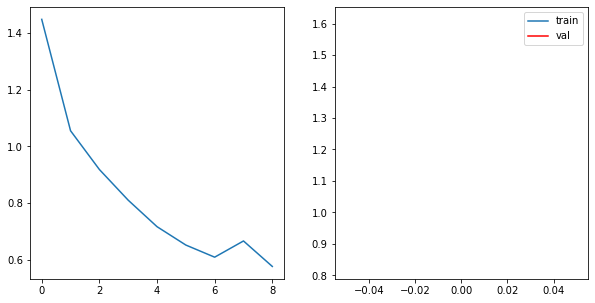

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.5556, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1246, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1860, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1121, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9488, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8777, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9751, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

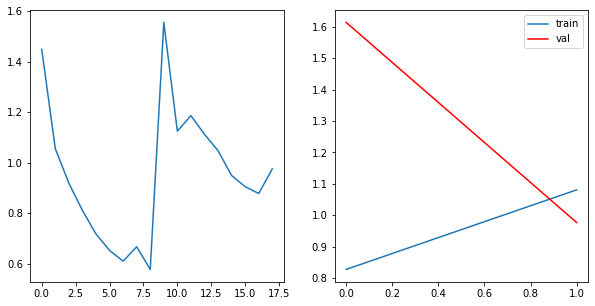

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.9649, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7787, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9883, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8085, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7630, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7941, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

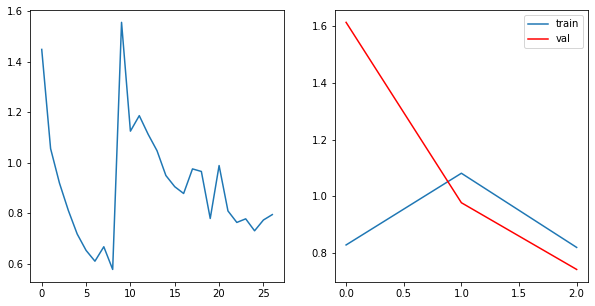

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6714, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6861, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6276, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6699, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6614, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

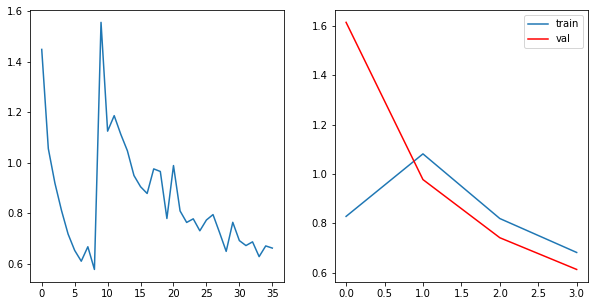

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7307, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6473, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6321, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6397, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6959, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

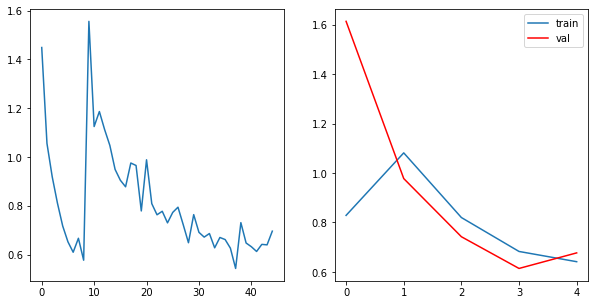

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5886, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5829, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6794, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6691, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

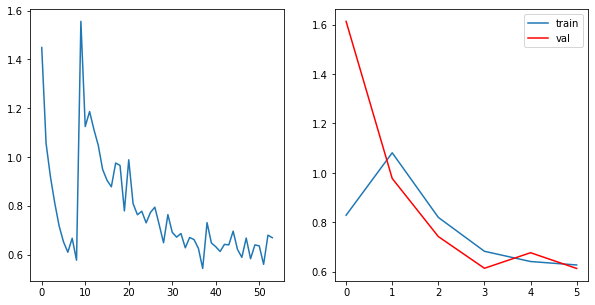

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5452, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6391, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6854, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

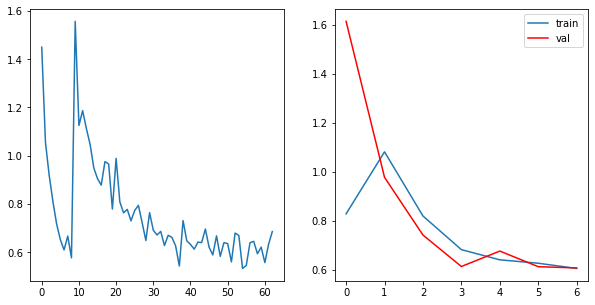

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5150, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6655, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5755, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6090, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5811, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6502, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

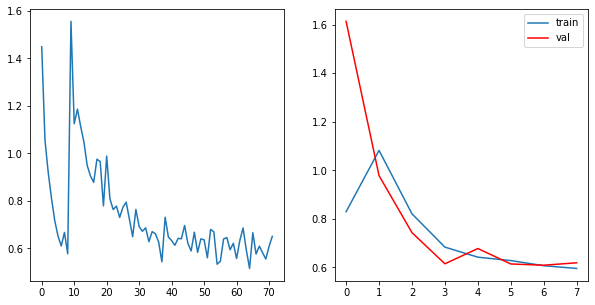

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5953, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4838, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6324, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6331, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

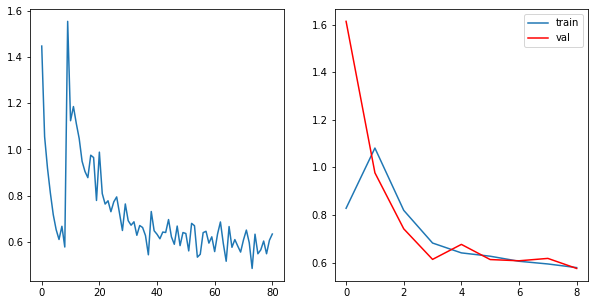

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5080, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6113, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4845, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5822, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6320, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

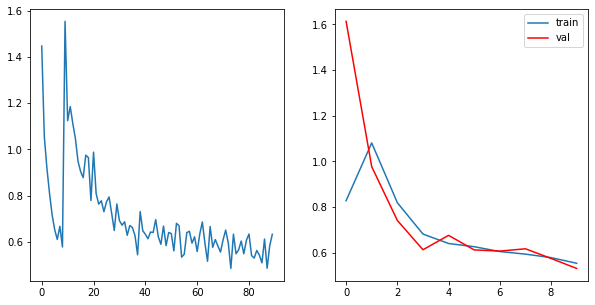

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4748, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4718, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5178, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5246, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5190, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

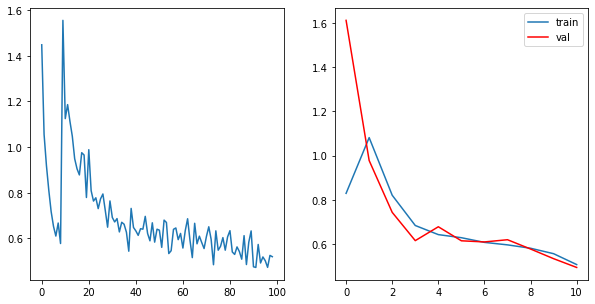

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4295, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4178, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4642, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4576, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

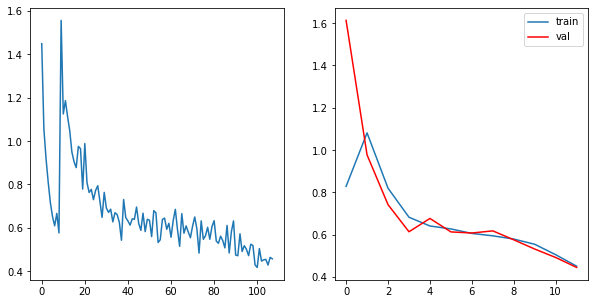

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4459, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4724, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5875, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

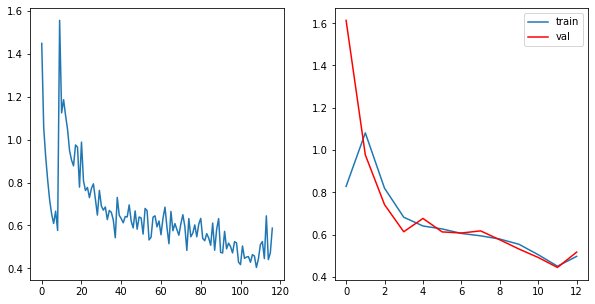

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4935, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4869, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4788, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4741, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4816, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

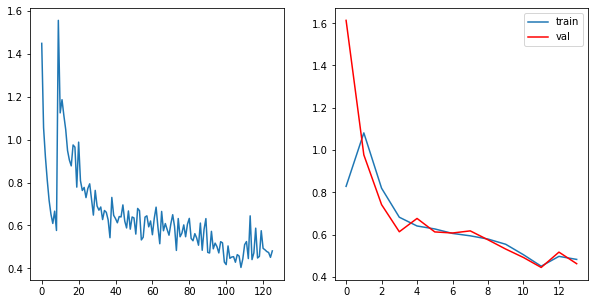

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4051, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4809, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3923, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3782, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4348, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

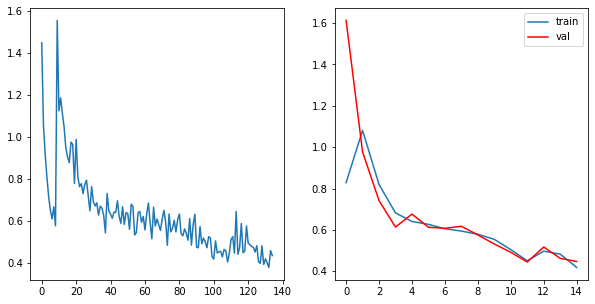

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3791, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3743, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3818, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4277, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

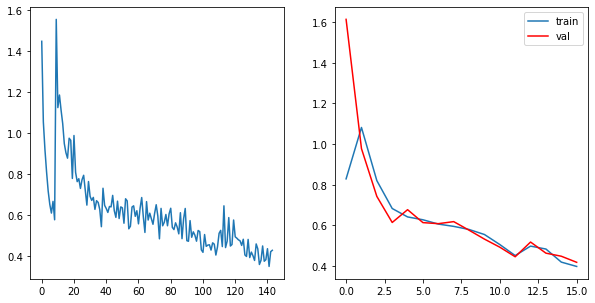

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3420, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3892, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4506, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4046, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3800, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

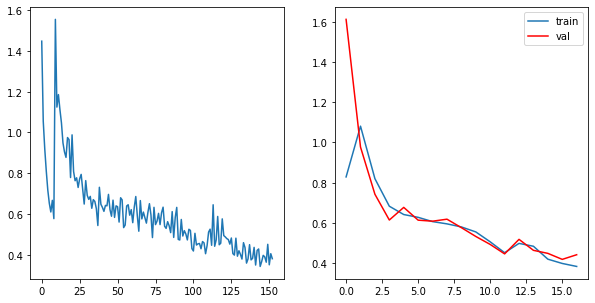

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3760, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3693, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3366, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3587, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3758, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3608, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

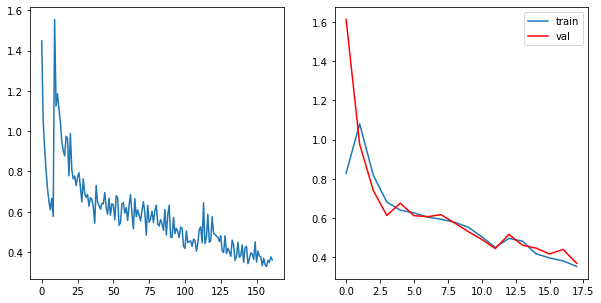

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3565, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3604, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3674, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3675, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4376, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

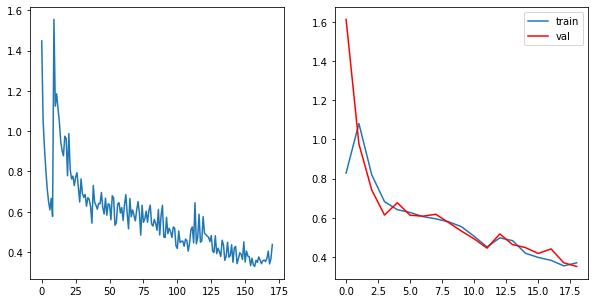

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2848, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3864, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3681, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

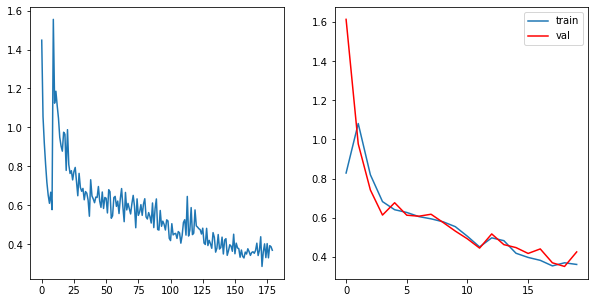

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3883, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3964, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3213, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3420, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3721, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3625, dtype=torch.float64, grad_fn=<DivBackward1>)
Введите 1 если уменьшать и 0 если нет: 1


  0%|          | 0/3 [00:00<?, ?it/s]

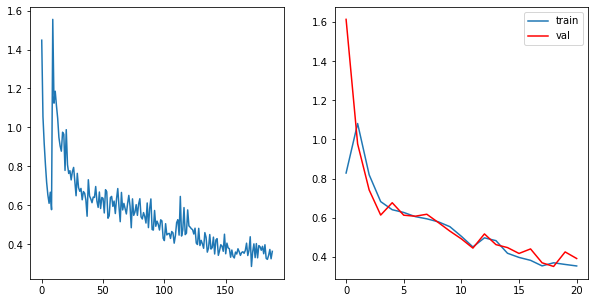

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3087, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2819, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3136, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3139, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3282, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3188, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

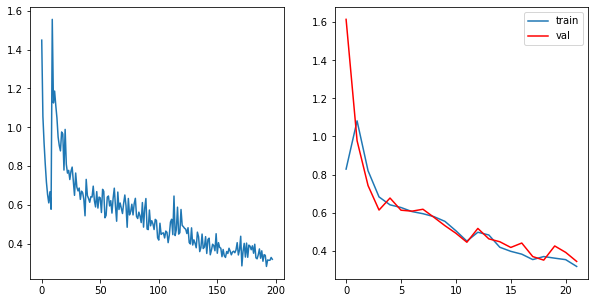

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2844, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3004, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2765, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2906, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2954, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3015, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

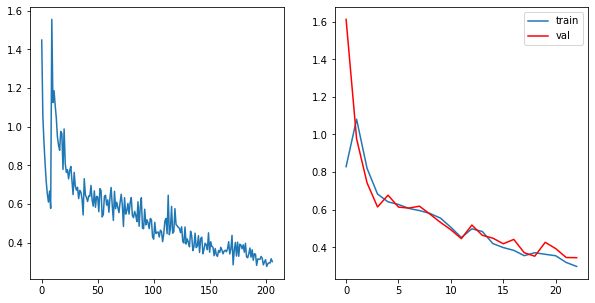

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2799, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2928, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2791, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2779, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2852, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3065, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2918, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

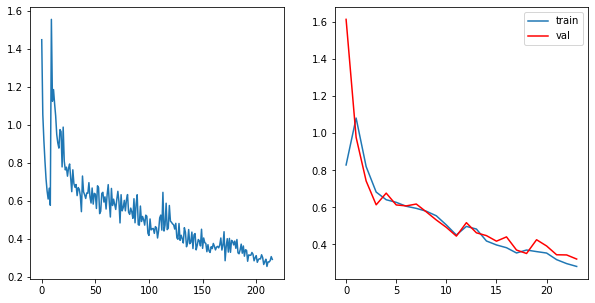

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2700, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2928, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2610, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2702, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2782, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2832, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

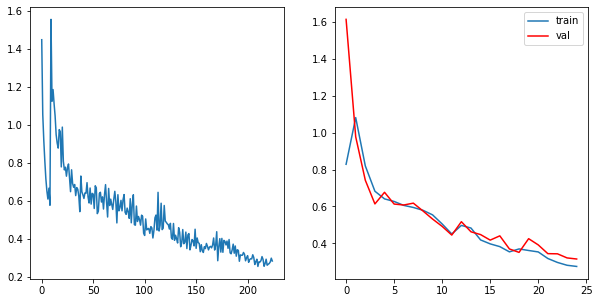

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2829, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2760, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2743, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2805, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2977, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2774, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

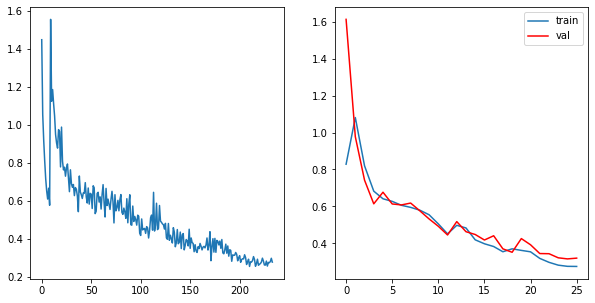

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2530, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2739, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2734, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2525, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2666, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2653, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2715, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

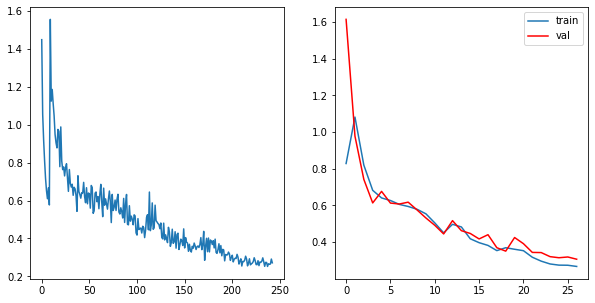

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2586, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2647, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2717, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

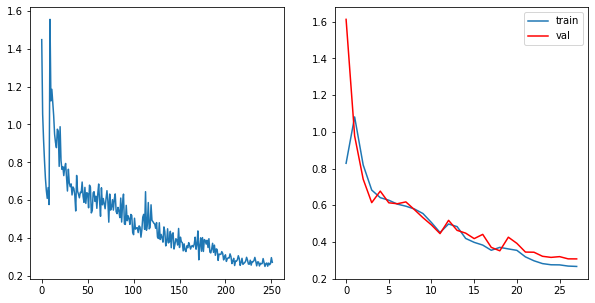

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2618, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2680, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2817, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2634, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

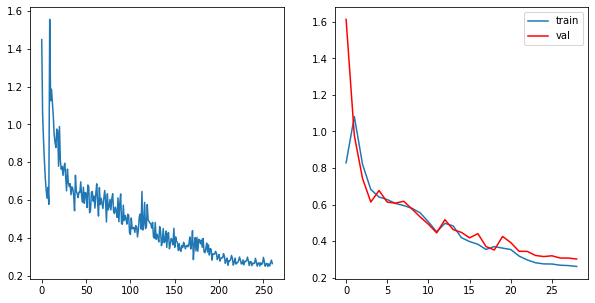

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2541, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2571, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2869, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

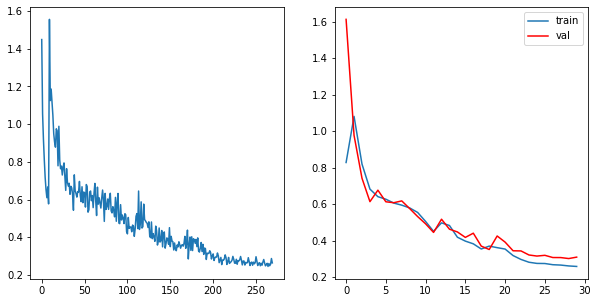

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2406, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2569, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2611, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

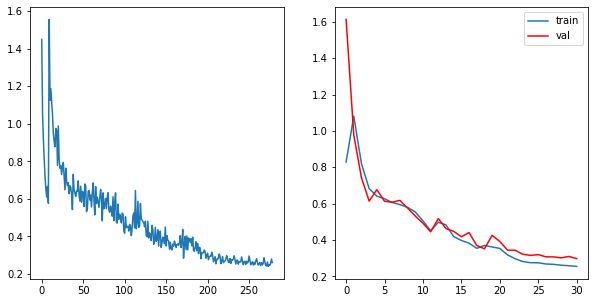

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2476, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2706, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2600, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

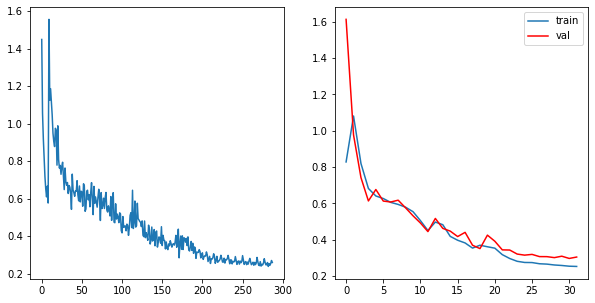

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2535, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

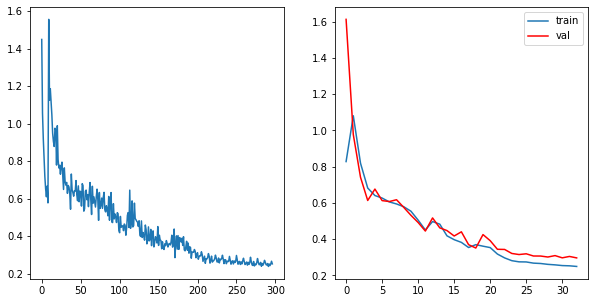

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2504, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2414, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2491, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

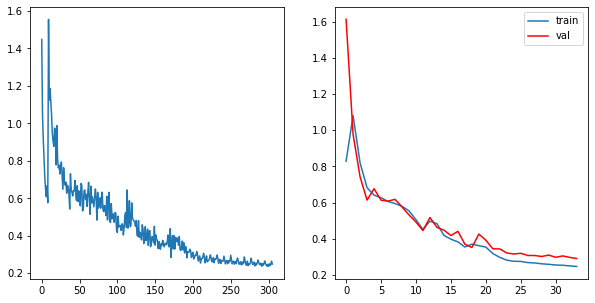

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2408, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2411, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2455, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2317, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2459, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

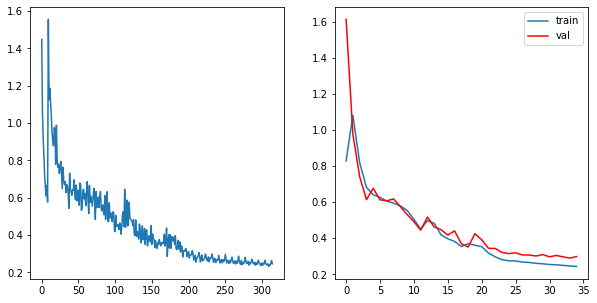

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2381, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2394, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2321, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

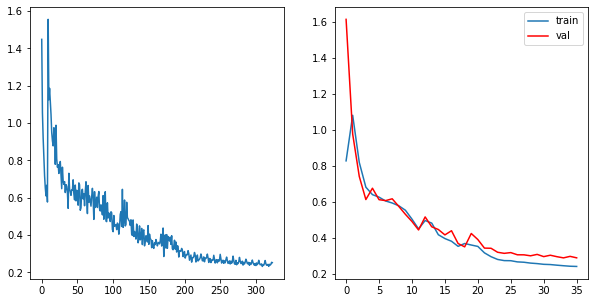

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2441, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2320, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2458, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

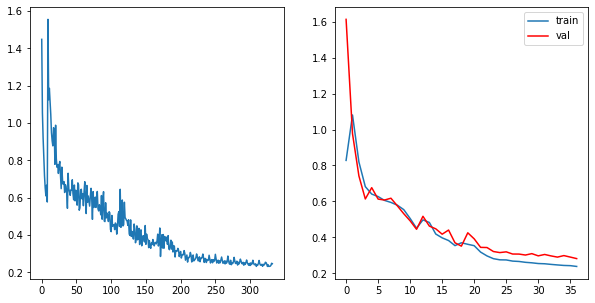

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2378, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2252, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2431, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

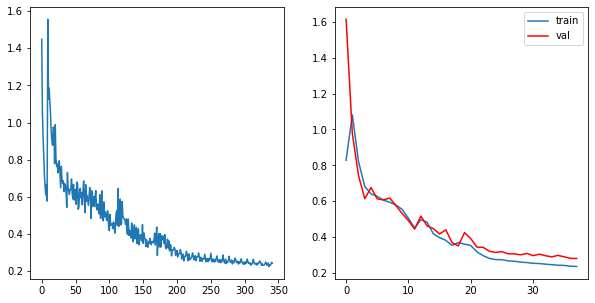

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2319, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2410, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

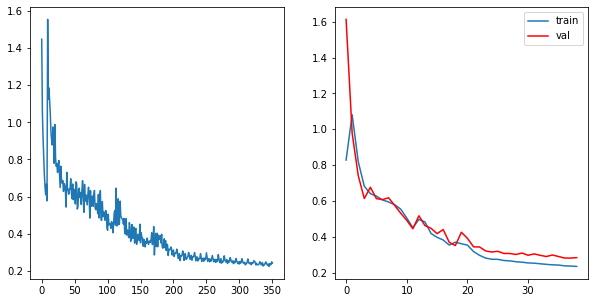

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2270, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2346, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2265, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2330, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

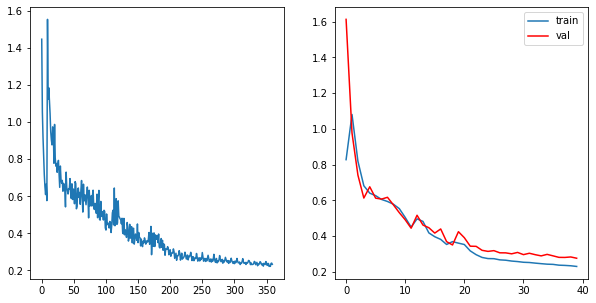

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2300, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2342, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2266, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2329, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2378, dtype=torch.float64, grad_fn=<DivBackward1>)
Введите 1 если уменьшать и 0 если нет: 1


  0%|          | 0/3 [00:00<?, ?it/s]

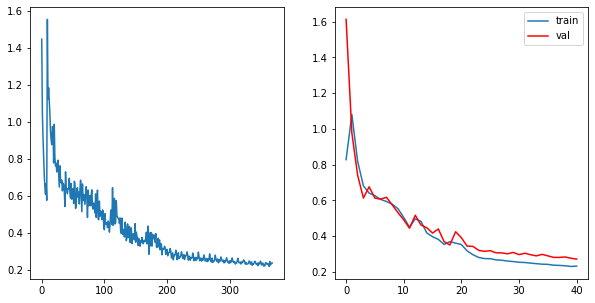

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2282, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2281, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2272, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2293, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

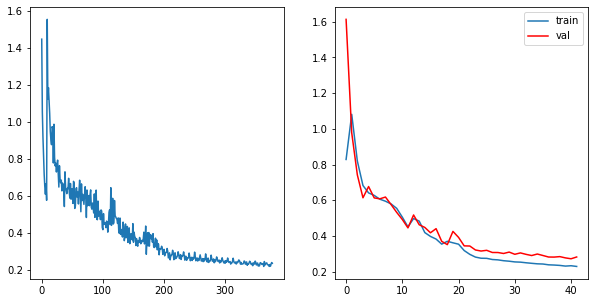

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2249, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2250, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2355, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

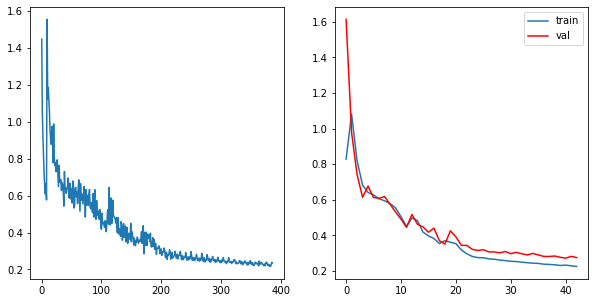

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2158, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2240, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2149, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2383, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2343, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

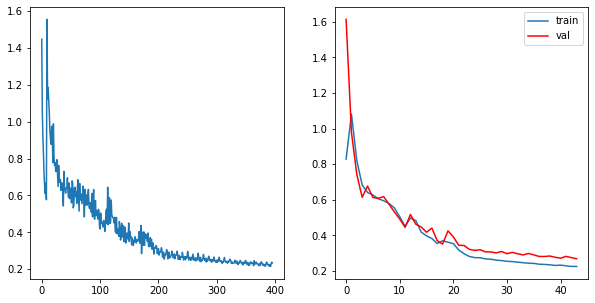

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2248, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2198, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2212, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2126, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2285, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

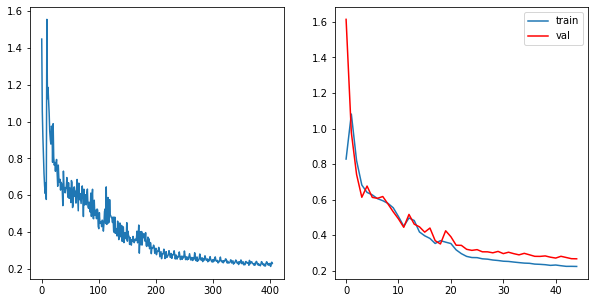

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2239, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2260, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2164, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2246, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2351, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

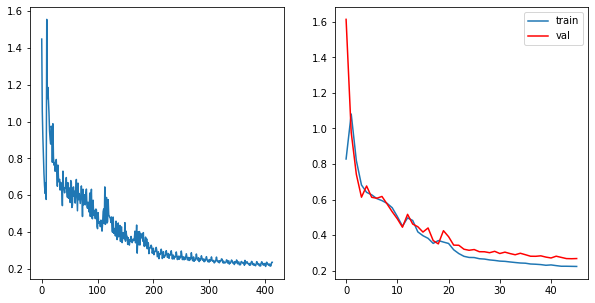

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2245, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2193, dtype=torch.float64, grad_fn=<DivBackward1>)


KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader)):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "Это моя сеть "+str(LR),            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_epoch_' + str(epoch)+ '.pth')
    if epoch % 10 == 0: 
        answer = int(input("Введите 1 если изменить и 0 если нет: "))
        if answer==1:
            l = int(input("На что умножить LR: "))
            LR=LR*l
            state = torch.load('/state_randomflip_epoch_' + str(epoch)+ '.pth', map_location=torch.device('cpu'))
            state['optimizer']['param_groups'][0]['lr'] = LR
            optimizer.load_state_dict(state['optimizer'])
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.4318, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7800, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6977, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7039, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7056, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5840, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

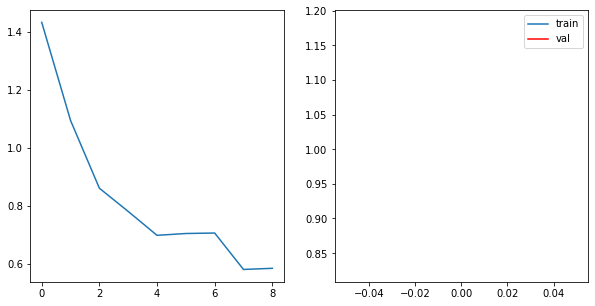

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.2054, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1703, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3945, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9229, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8117, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8144, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

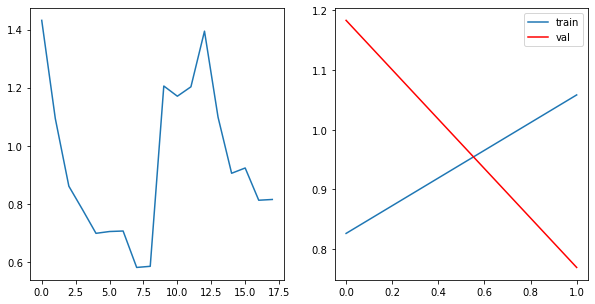

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7631, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7905, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8679, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7509, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6775, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6810, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

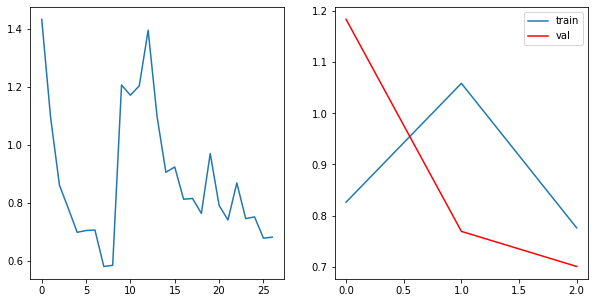

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7286, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7698, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7008, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6461, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6566, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

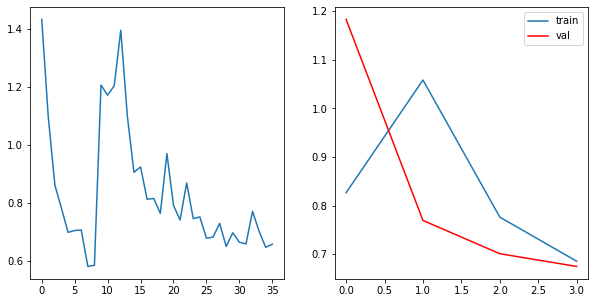

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6742, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5975, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6229, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6042, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

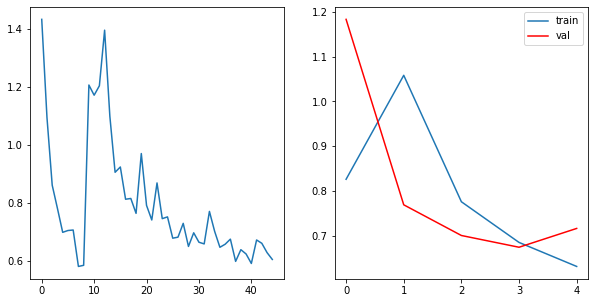

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7111, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7793, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6045, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6805, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6629, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6230, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6276, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

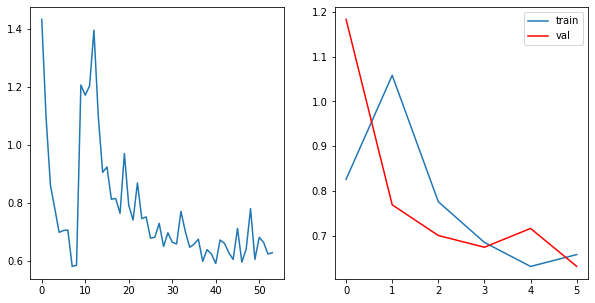

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6642, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5977, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6073, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5984, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6644, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5820, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6168, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

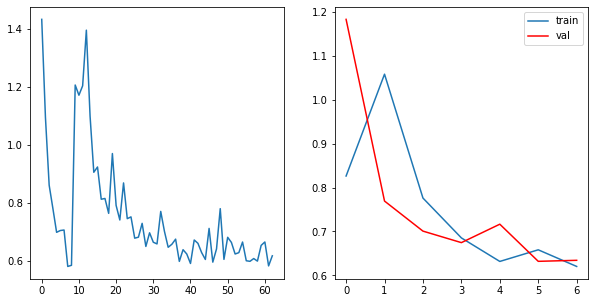

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5761, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5854, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5871, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

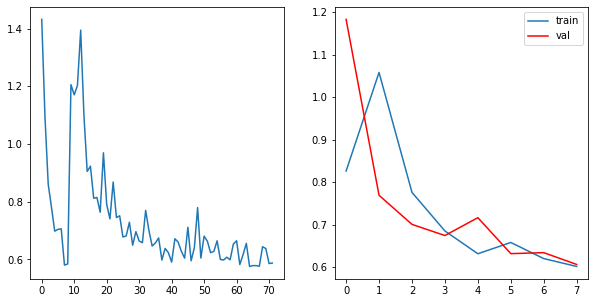

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6260, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5759, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5836, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5728, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5578, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5926, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

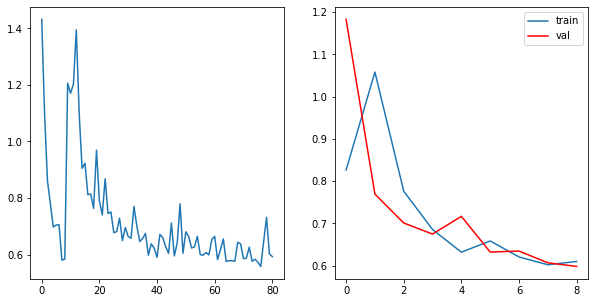

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6187, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5618, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5553, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8896, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5808, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5988, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

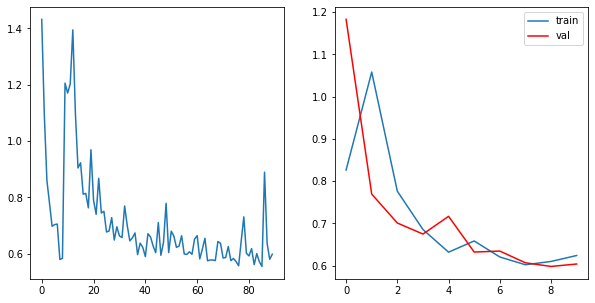

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6249, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5744, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5837, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5754, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6251, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5755, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5440, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

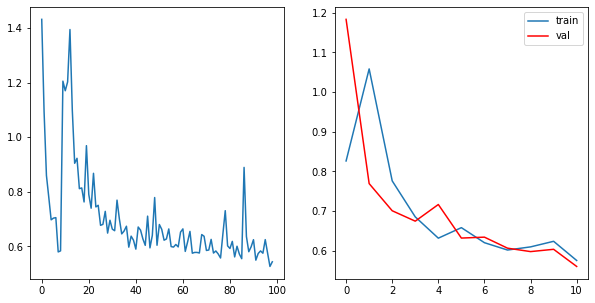

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5456, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5244, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

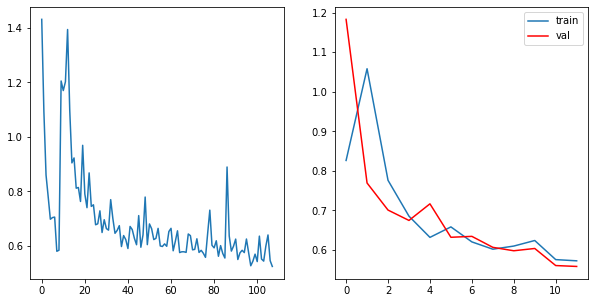

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5795, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5030, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5148, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5355, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5431, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5359, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

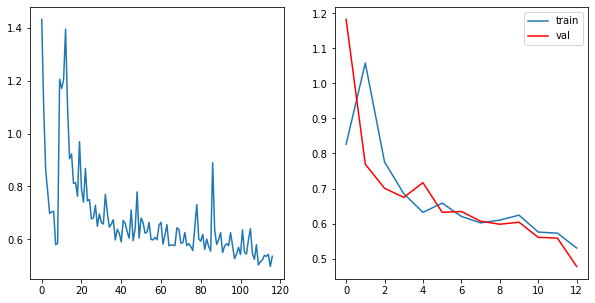

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4949, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4624, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4430, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4625, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

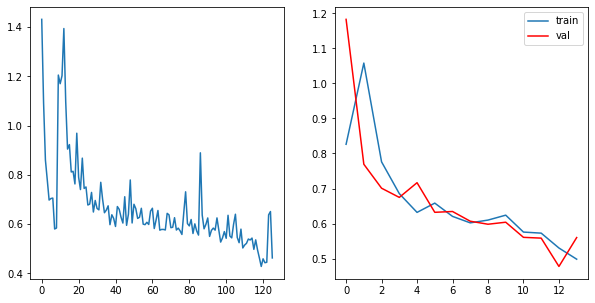

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4295, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4635, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4965, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4967, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4274, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

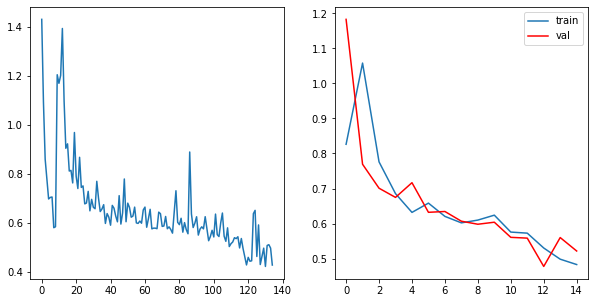

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4265, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4989, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4478, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5172, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4177, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4515, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

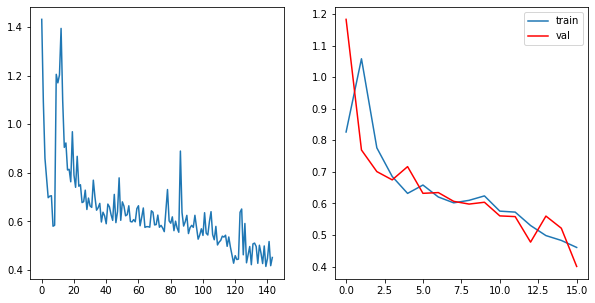

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3820, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5027, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3862, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4240, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

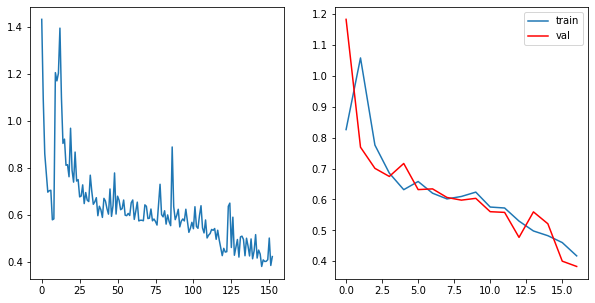

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3961, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3911, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3937, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3455, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

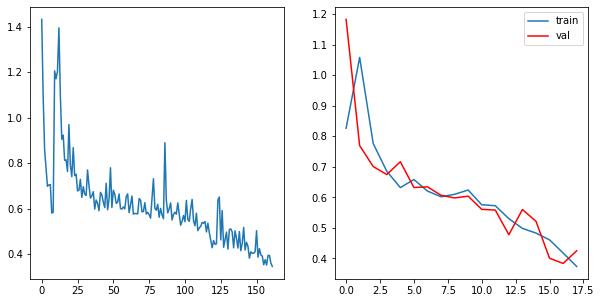

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4239, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3348, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3642, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3617, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3586, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3508, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

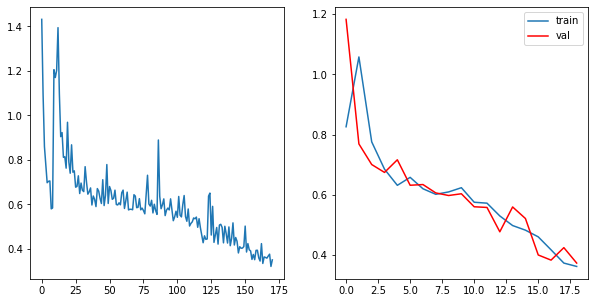

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4166, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3423, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

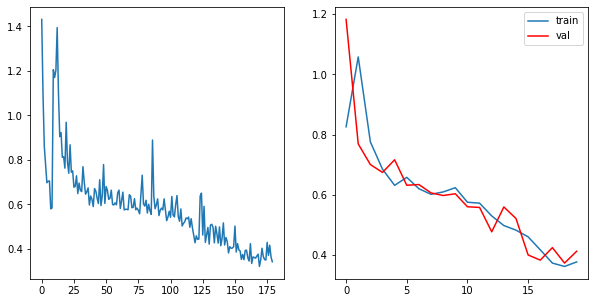

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3751, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3555, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3545, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3717, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4161, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3292, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

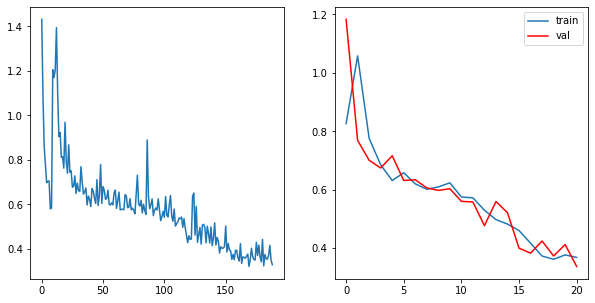

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3059, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3123, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3050, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3390, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3295, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3397, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

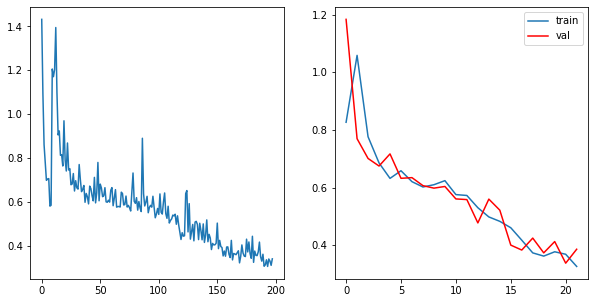

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4021, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3055, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3371, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3825, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3099, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3515, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3166, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

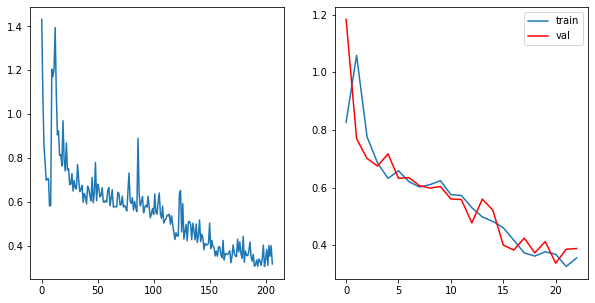

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4060, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3046, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3428, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3010, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3437, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

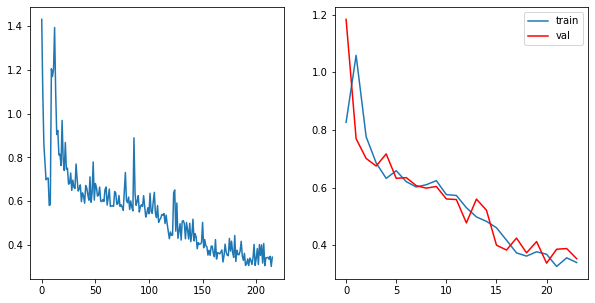

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2971, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3676, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2855, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2912, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

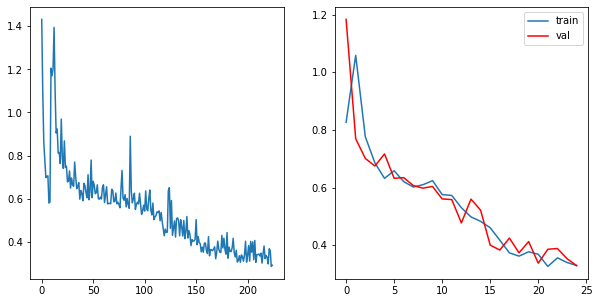

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3102, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3040, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2997, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2998, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2900, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

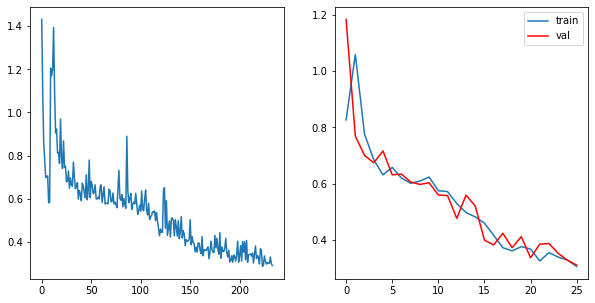

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3161, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2961, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4741, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3872, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3271, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

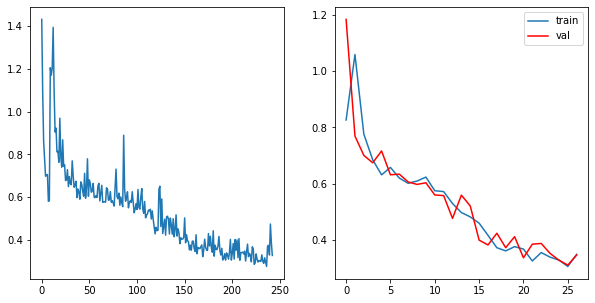

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3481, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3240, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3237, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3305, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3017, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3123, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

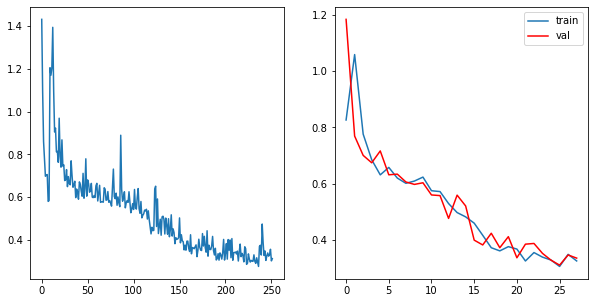

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3597, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2963, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2898, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2956, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2907, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2686, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3129, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

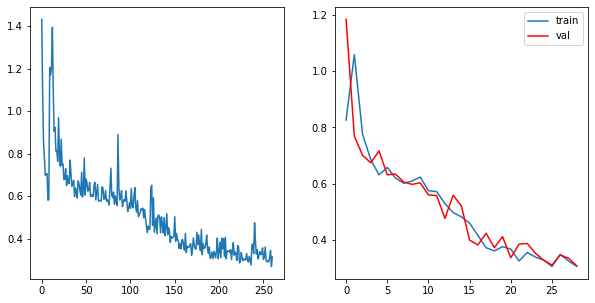

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2876, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3123, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2840, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3161, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3402, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2757, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

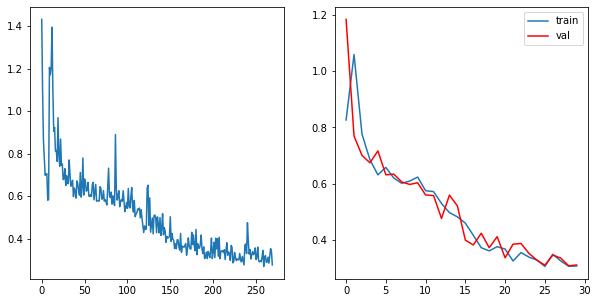

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3038, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2827, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2979, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2915, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

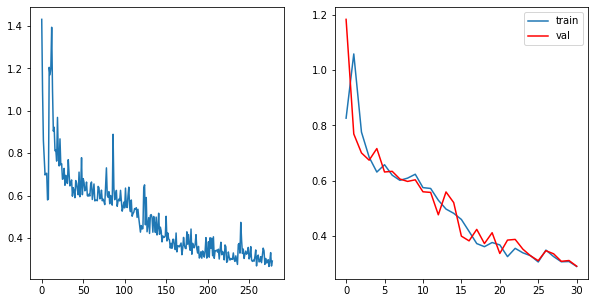

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3006, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2934, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2693, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2991, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2925, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2620, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3119, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

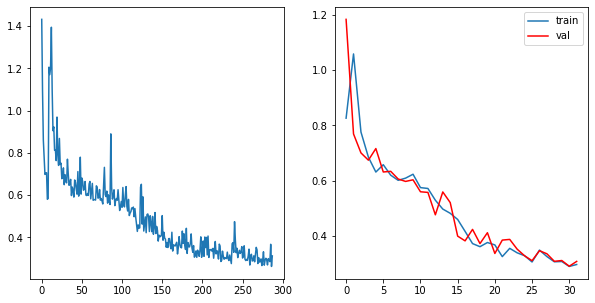

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2920, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2849, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2902, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3429, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2988, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

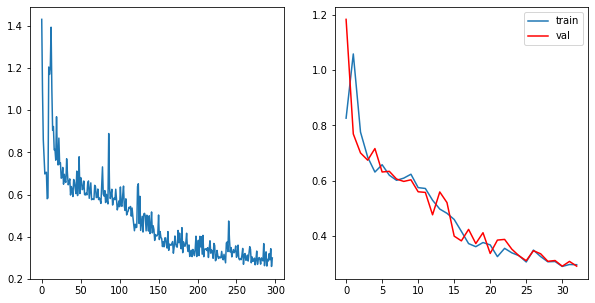

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3067, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2865, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3037, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2685, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

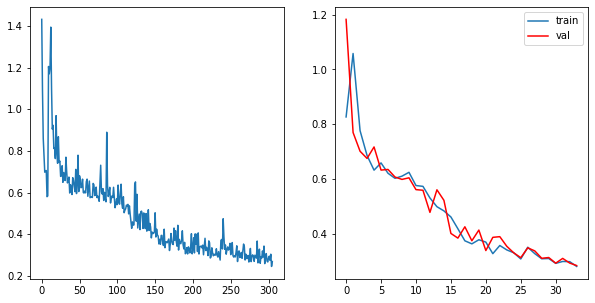

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2922, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2603, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2799, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3318, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2343, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2688, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

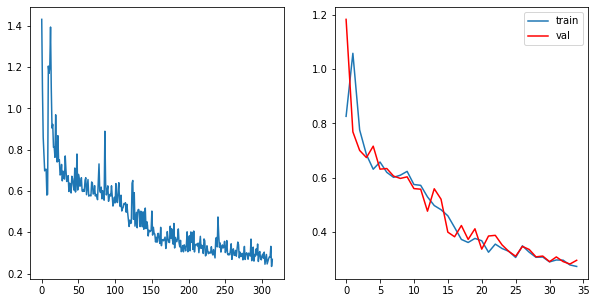

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3047, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2901, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3009, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3162, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2439, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2653, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

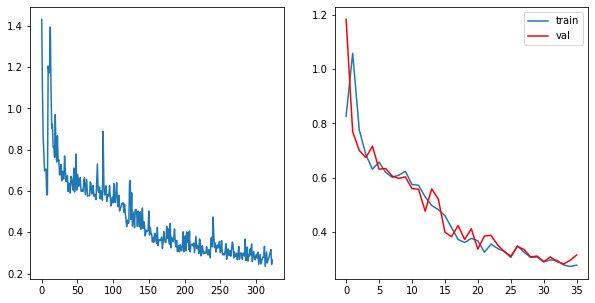

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2773, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3419, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2877, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3019, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2782, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

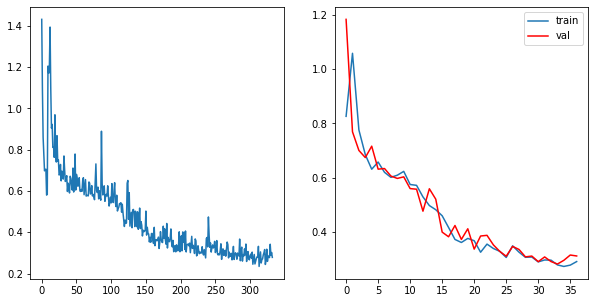

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3224, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2729, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3539, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2899, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2977, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3450, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2782, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3368, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

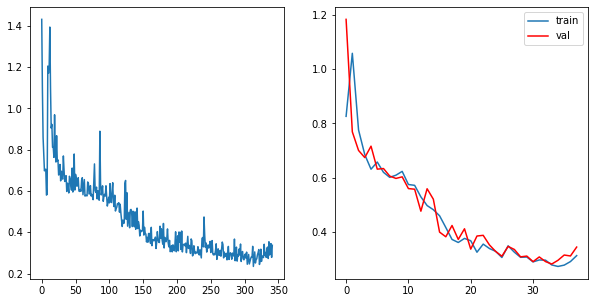

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2893, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2950, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2625, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3000, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2938, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2483, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2536, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

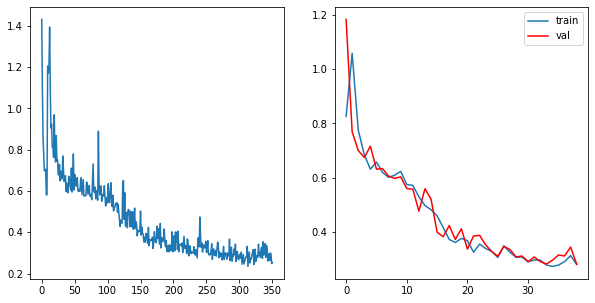

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2996, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2661, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2636, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2836, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2480, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

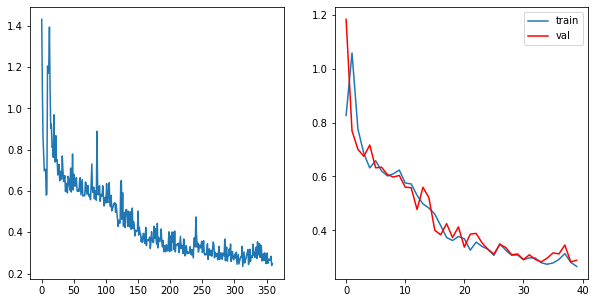

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2804, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2510, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2633, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3013, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2766, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2726, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

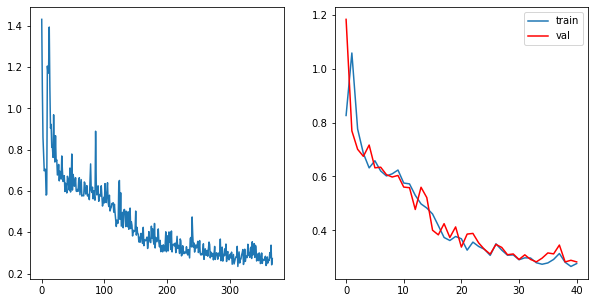

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2919, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2495, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2672, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2373, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2832, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

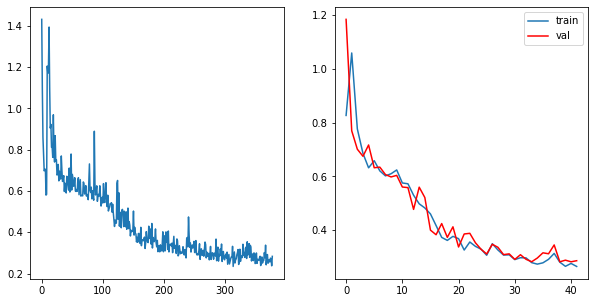

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2734, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2445, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3096, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2544, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2464, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3066, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

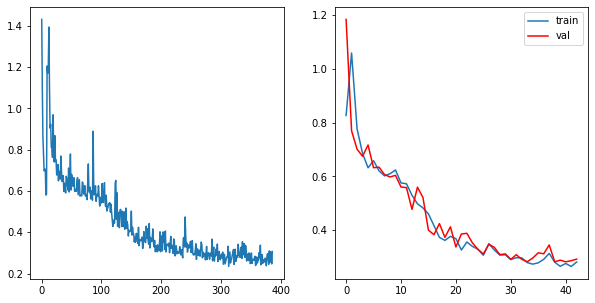

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2871, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2708, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2649, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2832, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2668, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2606, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

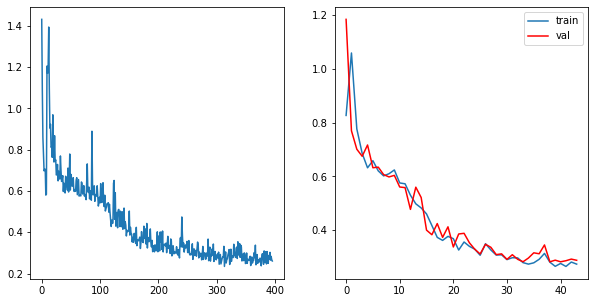

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2716, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2442, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2598, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2684, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2760, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2355, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2514, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

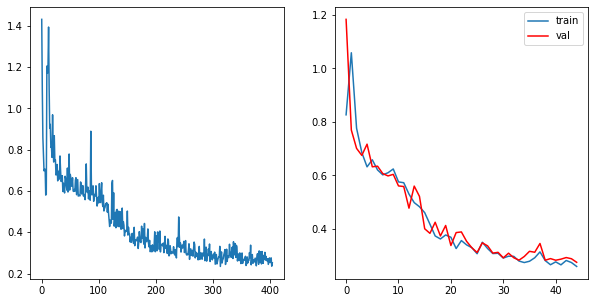

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2643, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2374, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2456, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2685, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2666, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2813, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2358, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

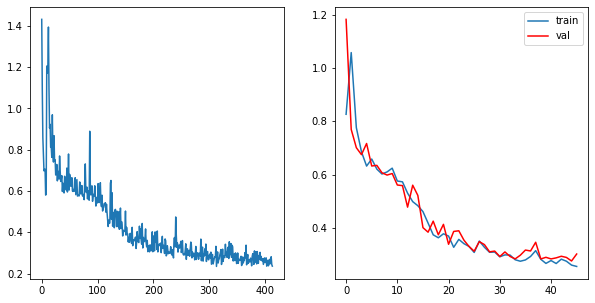

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2712, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2554, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2820, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2869, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2325, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2598, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

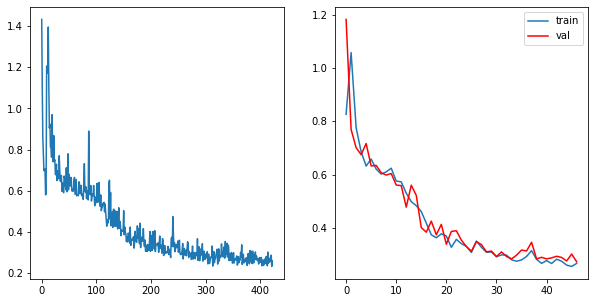

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2776, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2548, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2939, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2822, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2352, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3060, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

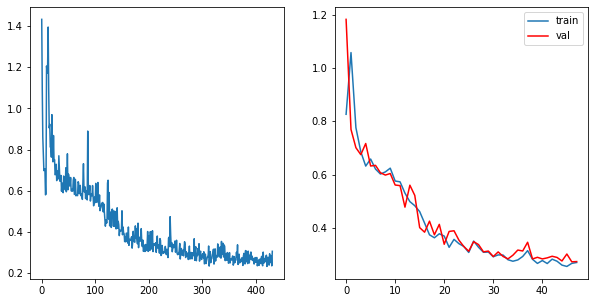

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2777, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2680, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2577, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2737, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2849, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2486, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

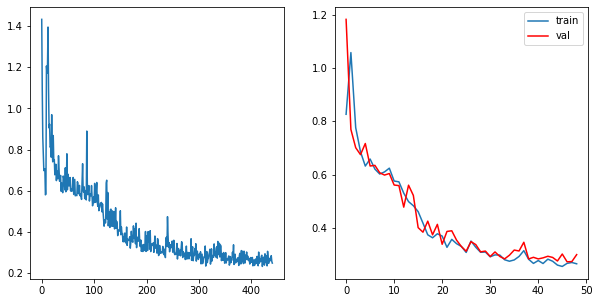

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2678, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2652, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2500, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2940, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2385, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2528, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2523, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

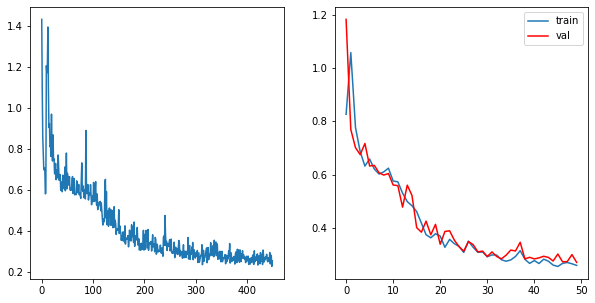

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2327, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2503, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2718, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2392, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2695, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2514, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2672, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

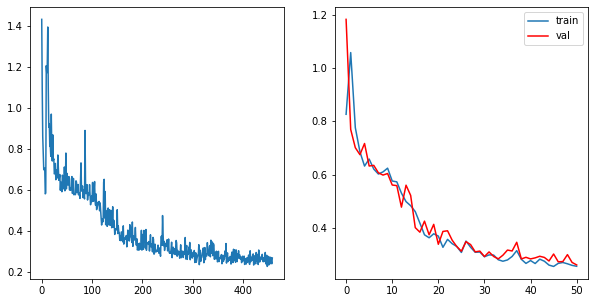

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2630, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2614, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2689, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2791, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

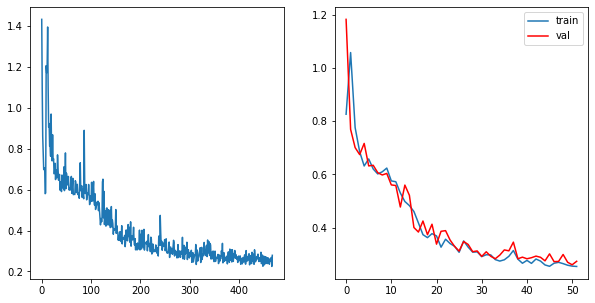

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2657, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2282, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2557, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2431, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

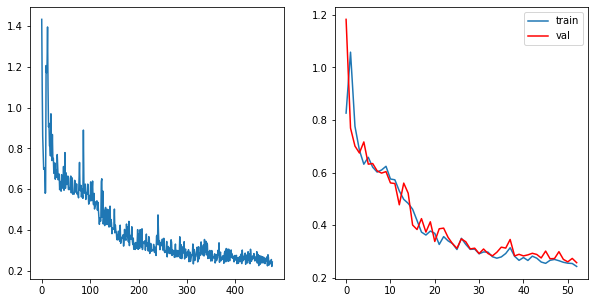

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2559, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2285, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2324, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

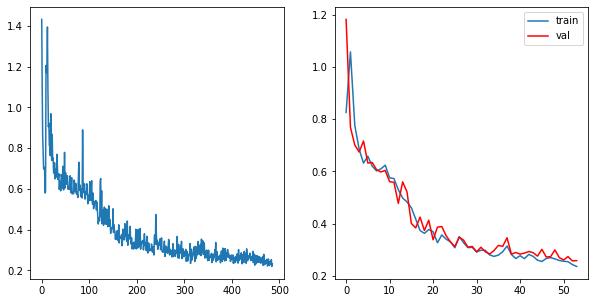

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2289, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2274, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2524, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2153, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2318, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

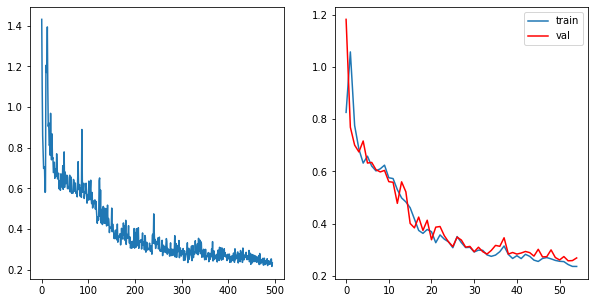

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2413, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2260, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2637, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2482, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2701, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

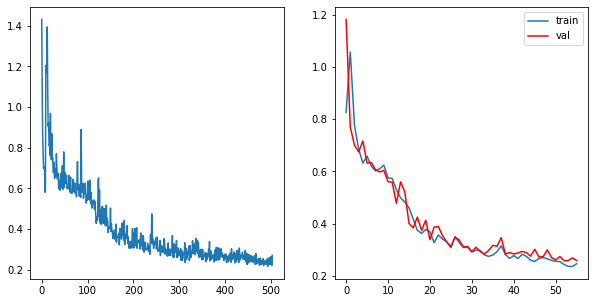

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2447, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2425, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2489, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2622, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

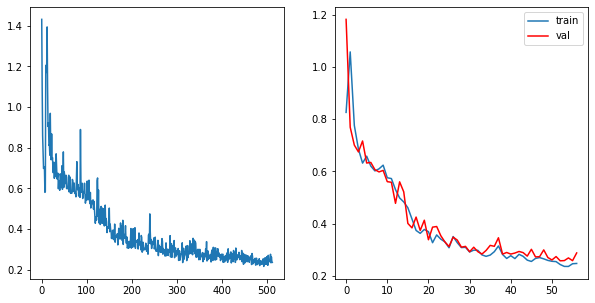

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2249, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2465, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2254, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2628, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2183, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2334, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

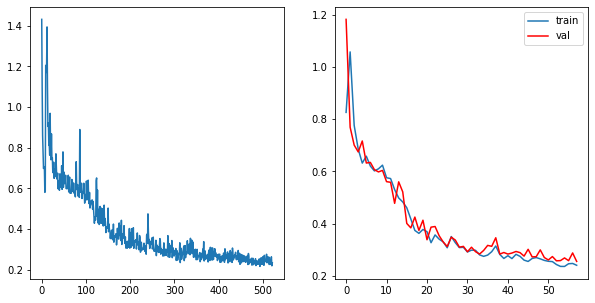

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2581, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2240, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2363, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2351, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2492, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2139, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2320, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

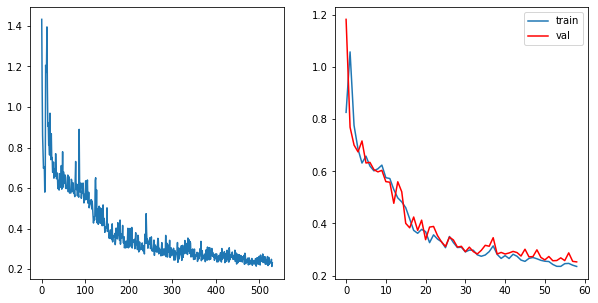

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2327, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2298, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2335, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2422, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2576, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2132, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2336, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

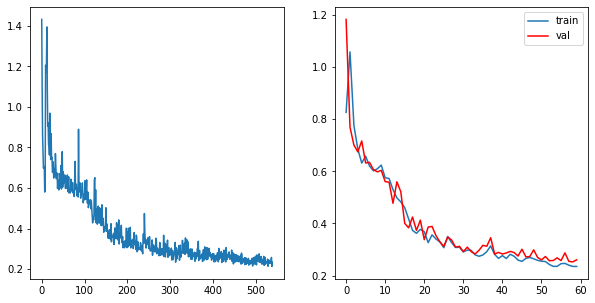

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2551, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2231, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2589, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2424, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2143, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2558, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

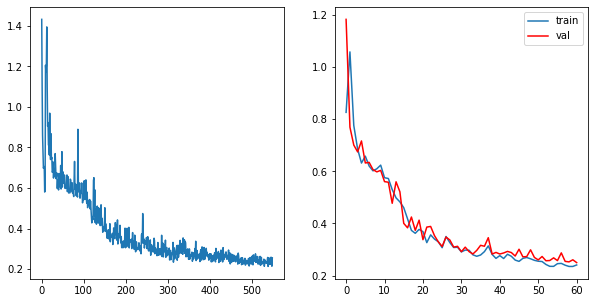

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2377, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2417, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2687, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2256, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2427, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

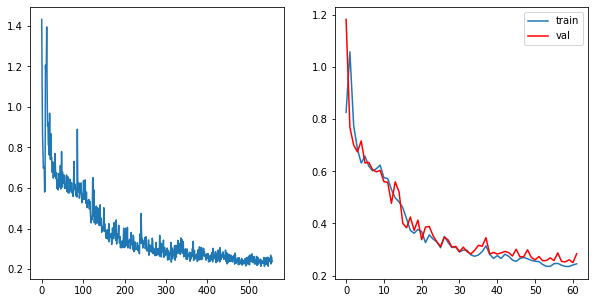

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2529, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2584, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2366, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2128, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2424, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

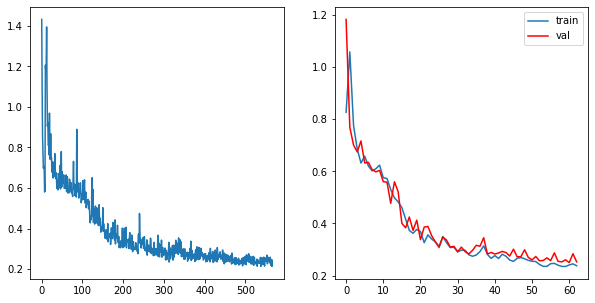

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2564, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2291, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2288, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2333, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

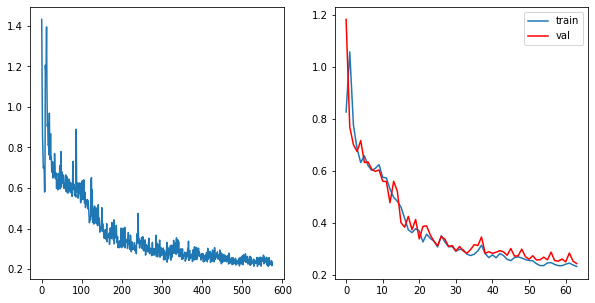

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2187, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2235, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2259, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2232, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2399, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2590, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

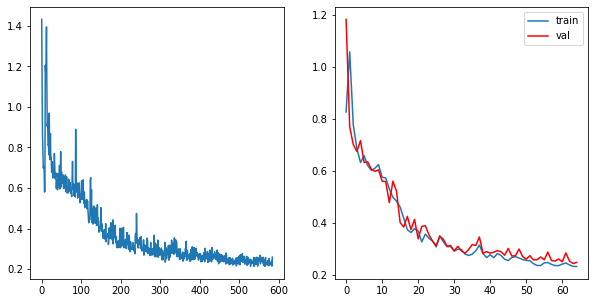

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2474, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2308, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2194, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2466, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2320, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2640, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2458, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

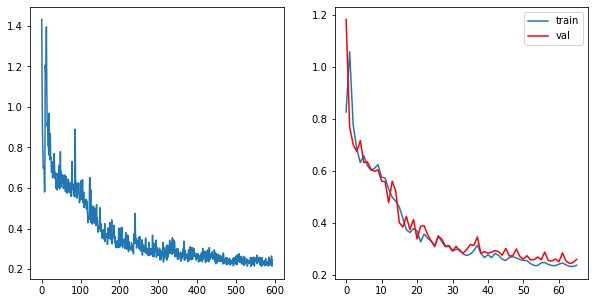

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2426, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2261, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2296, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2304, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2268, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2154, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2283, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

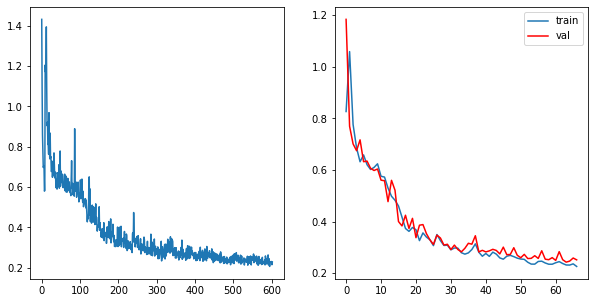

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2280, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2217, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2065, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

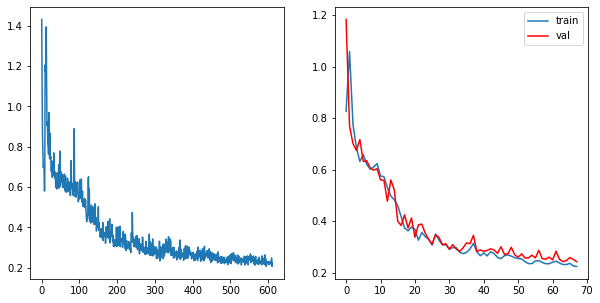

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2201, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2196, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2194, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2263, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2265, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2060, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2251, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

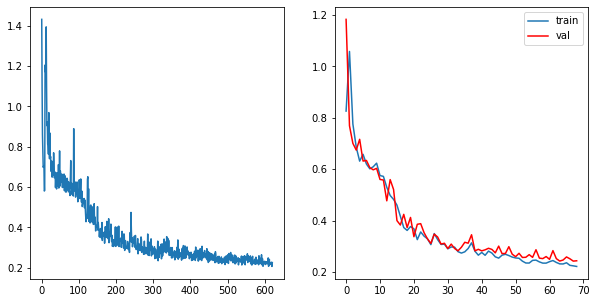

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2360, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2264, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2133, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2302, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2284, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2086, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2524, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

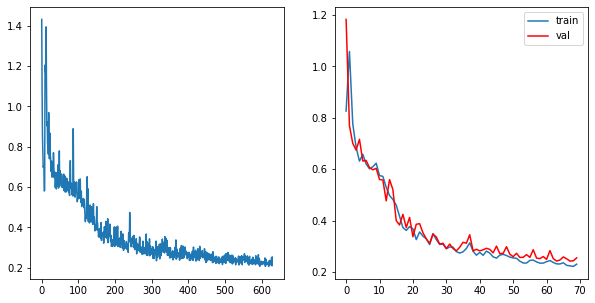

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2351, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2172, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2326, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2168, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

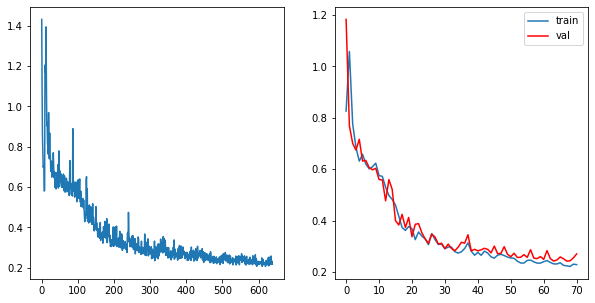

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2254, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2102, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2221, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2175, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2657, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2028, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2244, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

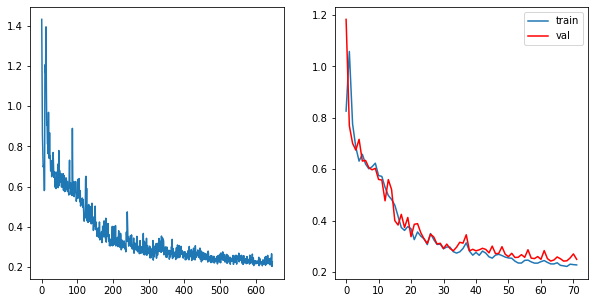

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2512, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2156, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2244, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2252, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2323, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2335, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

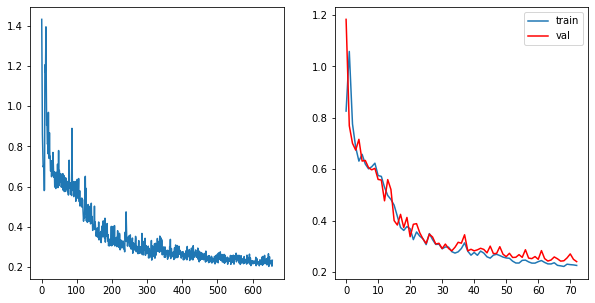

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2169, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2172, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2180, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2299, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

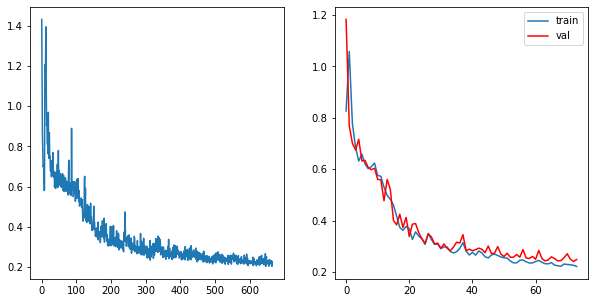

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2271, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2167, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2186, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2239, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2131, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2153, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

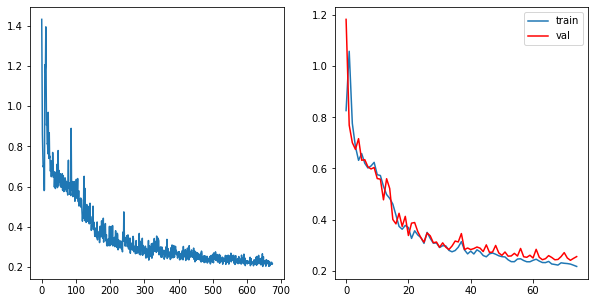

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2167, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2100, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2078, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2165, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2001, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2219, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

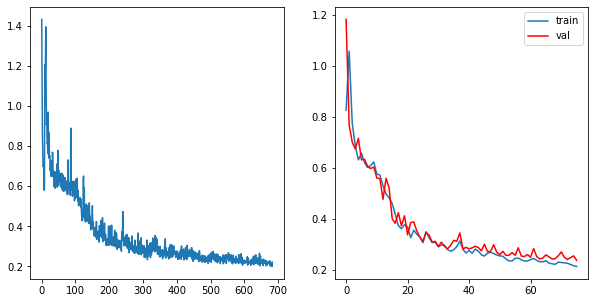

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2202, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2117, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2137, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2102, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2150, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2244, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2176, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

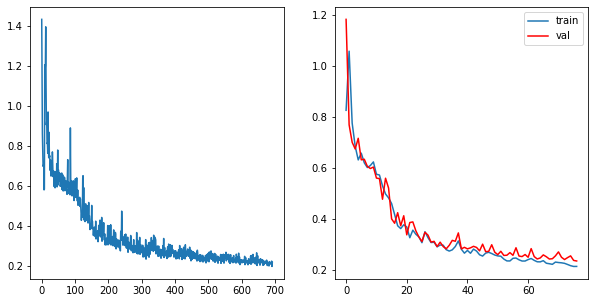

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2329, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2089, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2203, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2077, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2205, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

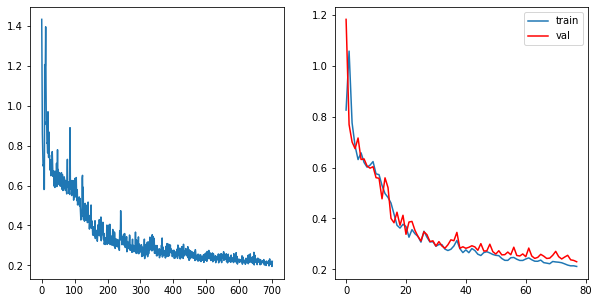

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2199, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2166, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2002, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2053, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2117, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2093, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1982, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2218, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

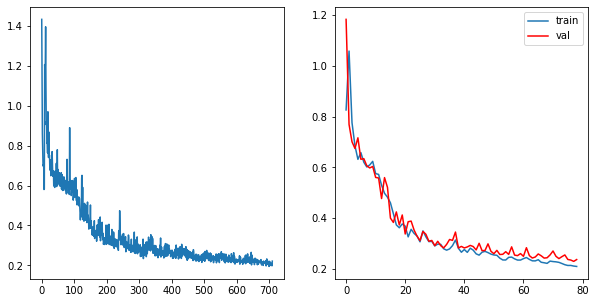

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2189, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1960, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2236, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2056, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2327, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

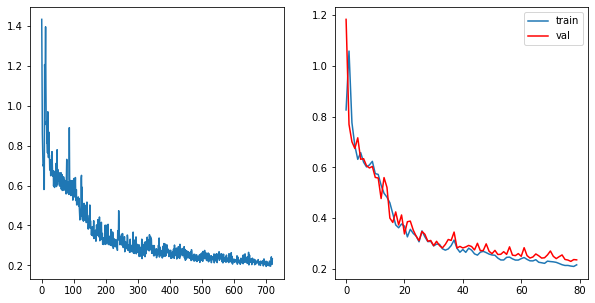

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2243, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2197, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2171, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2365, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2019, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2127, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2277, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2166, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

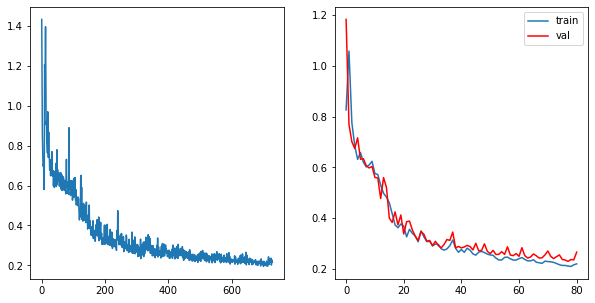

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2039, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2081, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2134, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2166, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2247, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2208, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2312, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

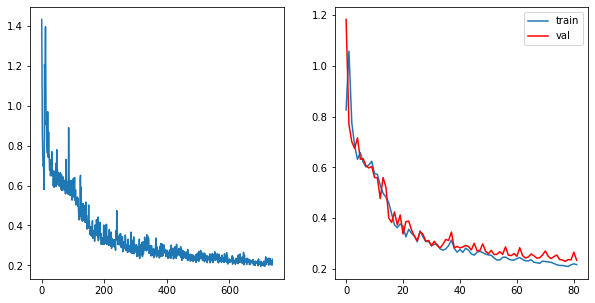

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2170, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2193, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2097, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2216, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1990, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2245, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

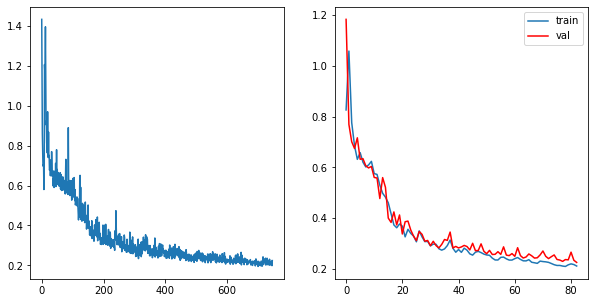

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2129, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2110, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2075, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2068, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2149, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1942, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2156, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

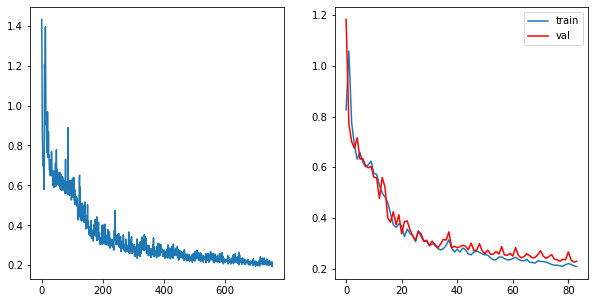

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2226, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2034, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1980, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2062, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2055, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1936, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2192, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

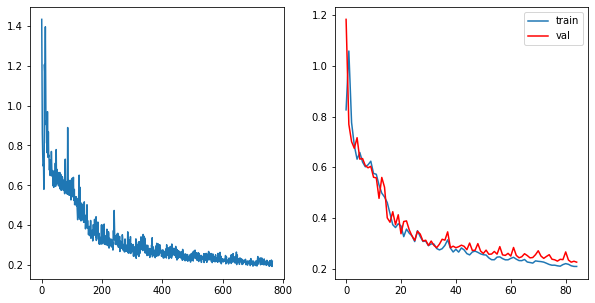

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2141, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2220, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1992, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2095, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2067, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2317, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1932, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2244, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

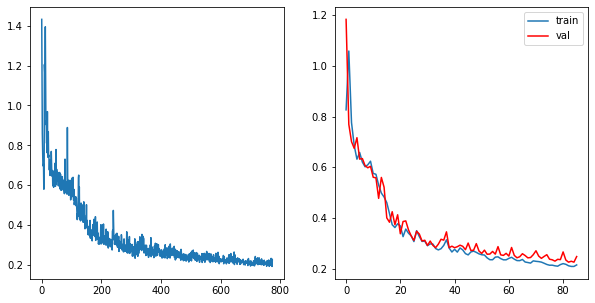

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2272, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2214, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2151, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2101, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2222, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2104, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2240, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

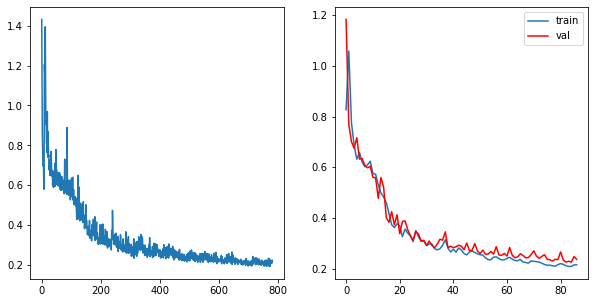

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2185, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2328, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1978, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2085, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2215, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2119, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2330, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1948, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2420, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

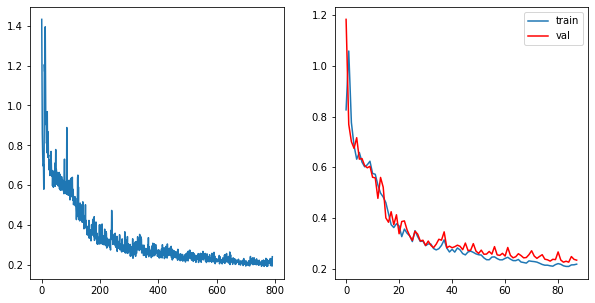

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2065, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2142, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2052, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2101, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2190, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2150, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2012, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2319, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

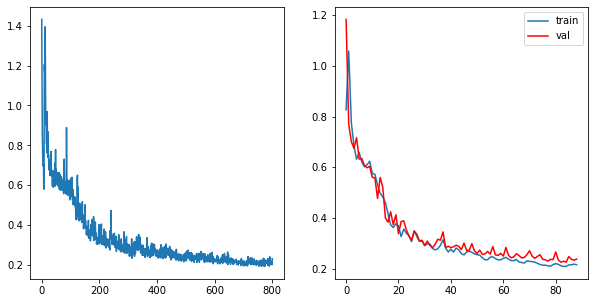

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1986, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2026, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1952, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2049, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2001, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2730, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2848, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

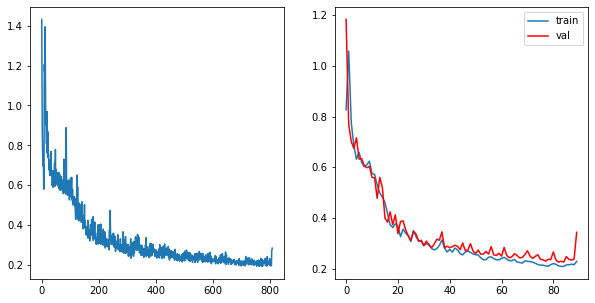

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2962, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3218, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3104, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2657, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2902, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2497, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2785, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

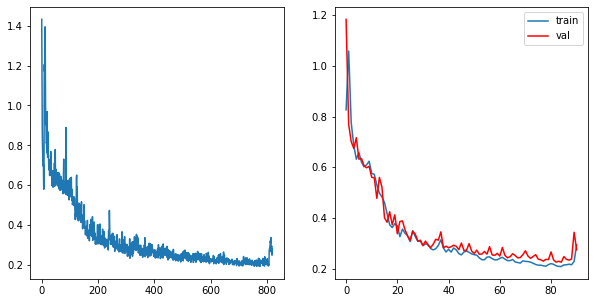

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2825, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2499, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3088, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2648, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2775, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2753, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3213, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

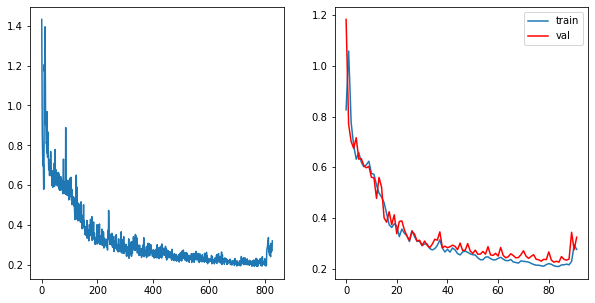

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2533, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2896, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2599, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2405, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2635, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

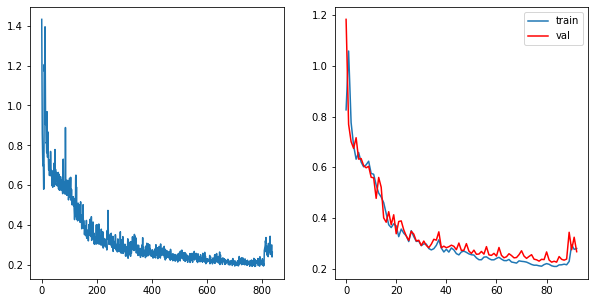

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2878, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2339, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2435, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2485, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2376, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2452, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2484, dtype=torch.float64, grad_fn=<DivBackward1>)


KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader), leave=False):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "Это моя сеть",            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_Glub_epoch_' + str(epoch)+ '.pth')
        
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(1.5144, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0115, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0343, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9227, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8560, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

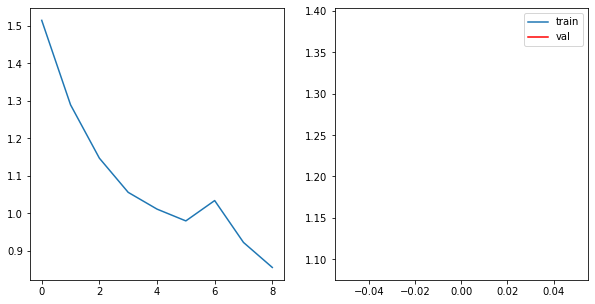

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.3931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3895, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3864, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3849, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3847, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3840, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3807, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3750, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

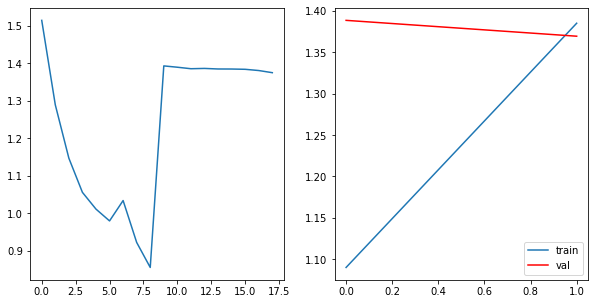

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.3736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3677, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3605, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3590, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3445, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3282, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

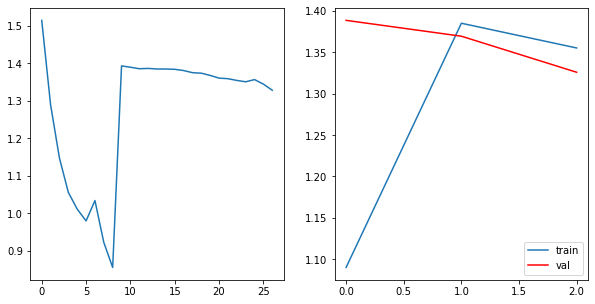

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.3280, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3209, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3013, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2933, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2806, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.3076, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2816, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2421, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

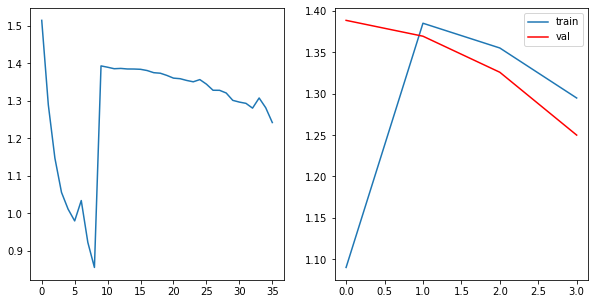

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.2520, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2418, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2035, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1930, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1659, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.2294, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1692, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1030, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

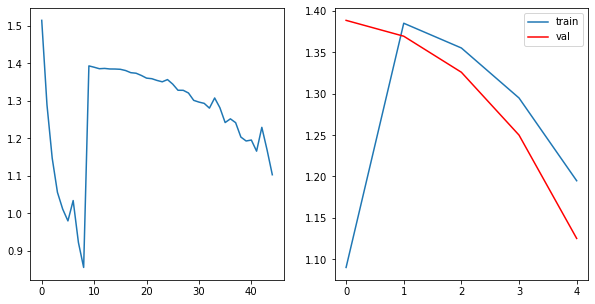

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.1340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1145, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0604, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0914, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0522, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0945, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.1061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(1.0462, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9646, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

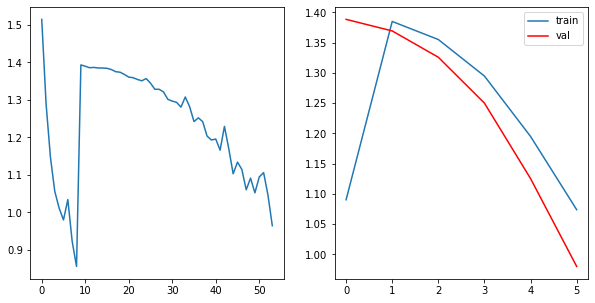

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(1.0107, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9592, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8895, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8723, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8505, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.9468, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8835, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8084, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

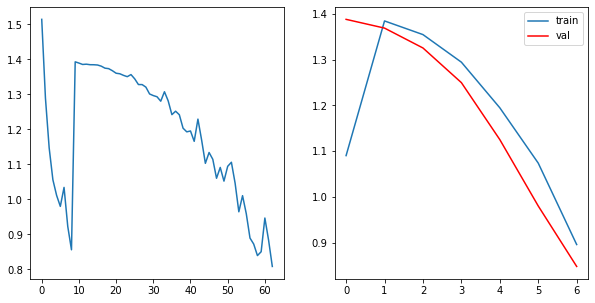

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.8187, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.8022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7836, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7444, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7696, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7765, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7533, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

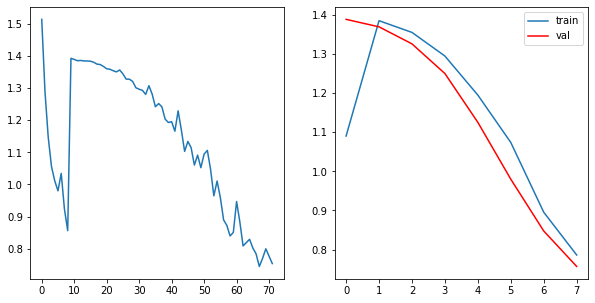

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7621, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7292, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7054, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.7155, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6632, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

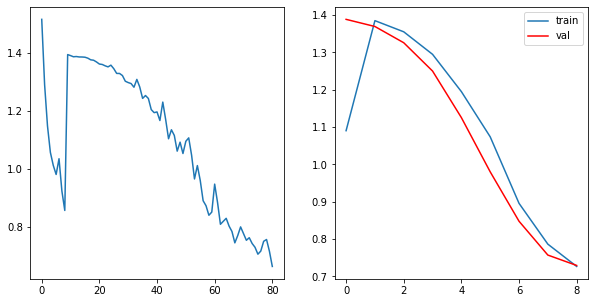

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.7064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6778, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6645, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6575, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6157, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6608, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6011, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

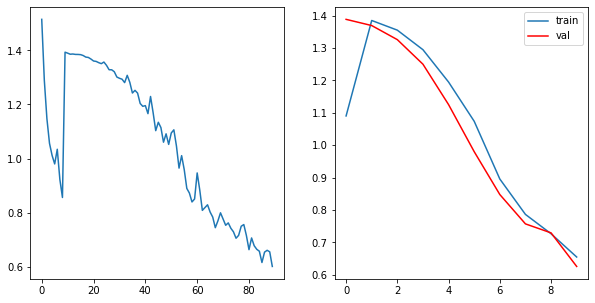

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6094, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6007, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5839, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5801, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5420, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5694, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5995, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5691, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6051, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

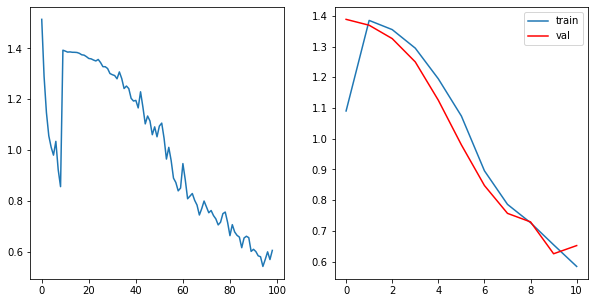

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.6282, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6939, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5917, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5567, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.6290, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5863, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5806, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

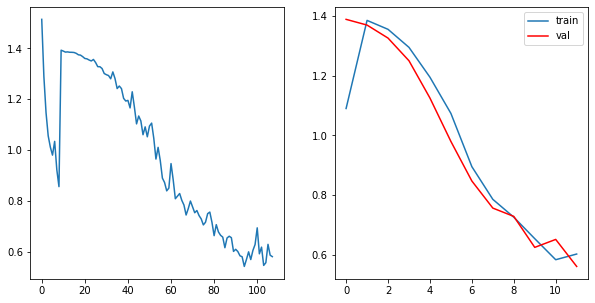

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5713, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5606, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4802, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4955, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5112, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4447, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

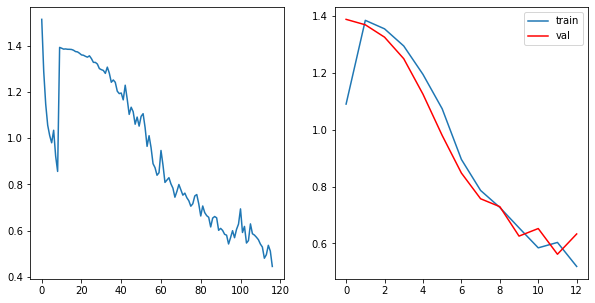

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.5839, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5287, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4828, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.5069, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4322, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4490, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4605, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4607, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4178, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

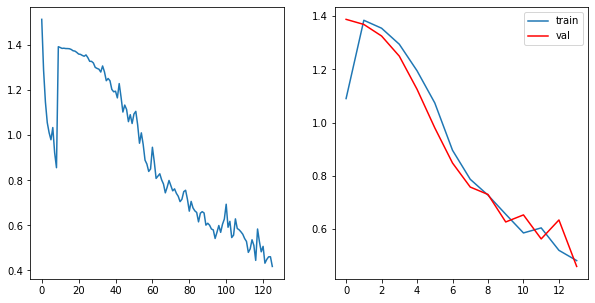

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4179, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4192, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4384, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4370, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3746, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3941, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4238, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4440, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3882, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

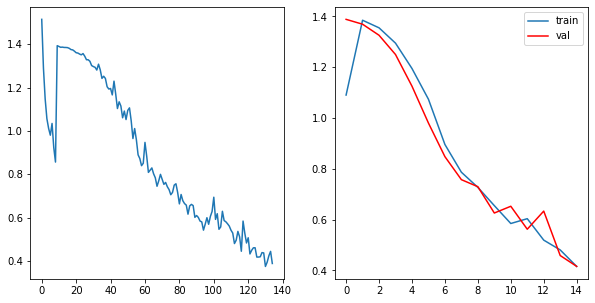

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3924, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4037, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4160, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.4173, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3634, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3861, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3855, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3426, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

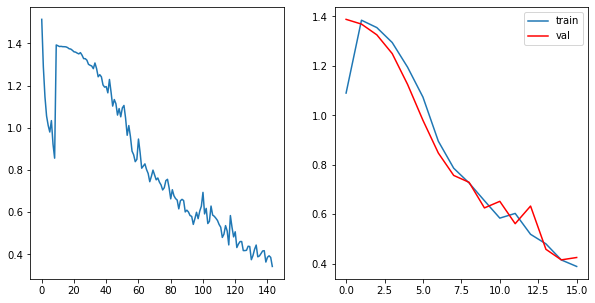

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.4014, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3791, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3871, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3779, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3768, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3526, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3179, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

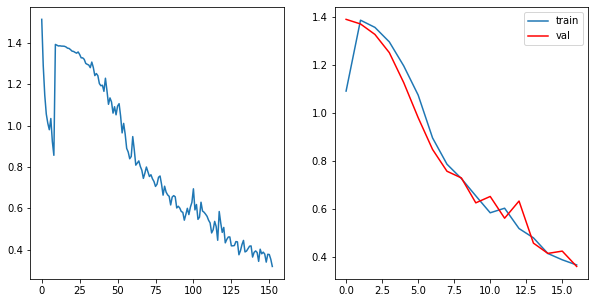

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3446, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3566, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3375, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3159, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3626, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3438, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2936, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

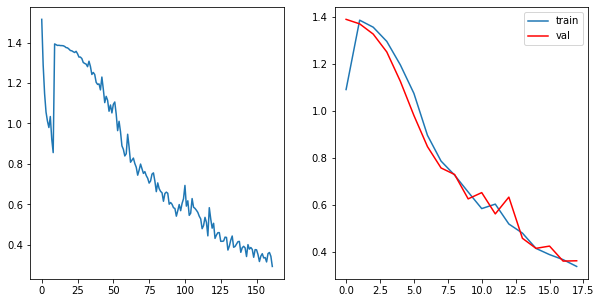

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3448, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3353, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3513, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3082, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3403, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3210, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2799, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

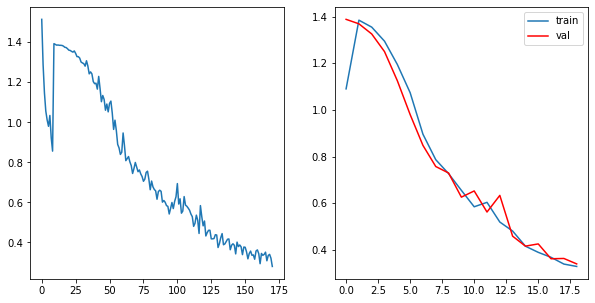

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3317, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3279, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3169, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3090, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2985, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3191, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3357, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3245, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2671, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

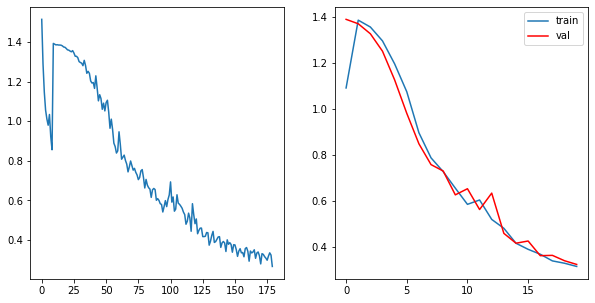

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3031, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2970, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3146, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2876, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3092, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3108, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3163, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2592, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

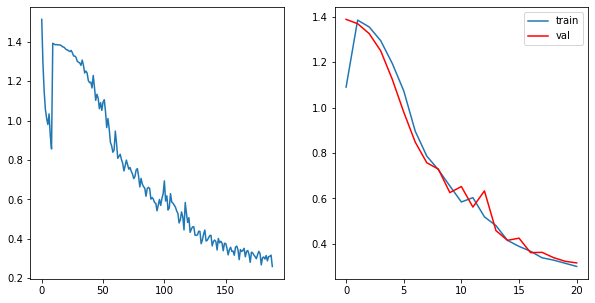

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2974, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3033, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2874, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3013, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2805, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3329, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3387, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3550, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2469, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

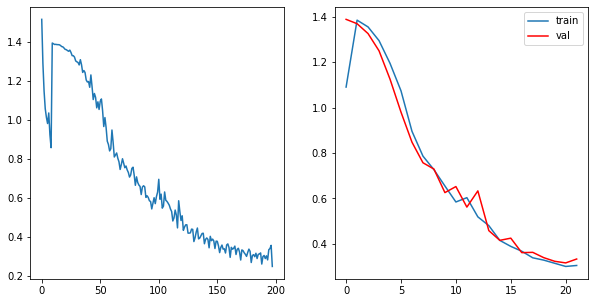

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3108, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2983, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3032, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2930, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3340, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3064, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2688, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

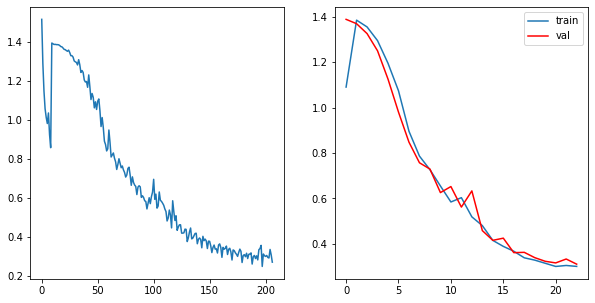

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2931, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2882, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2877, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2748, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2857, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2850, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3074, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3316, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2550, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

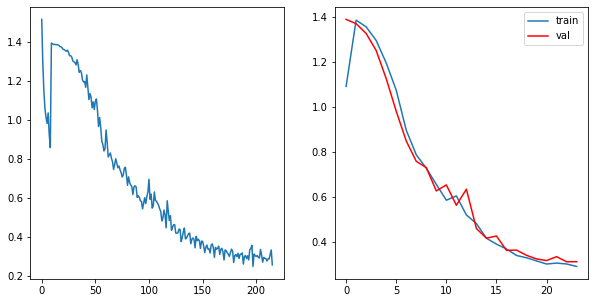

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2951, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2935, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2945, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2994, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2794, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2922, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3079, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3023, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2476, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

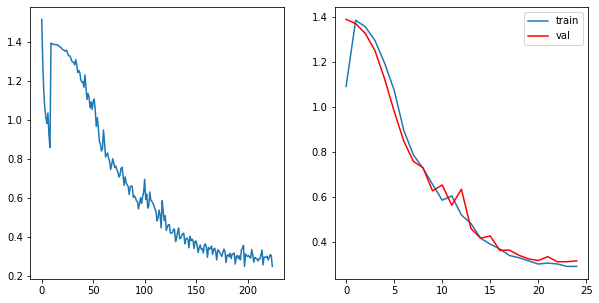

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.3020, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2700, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2771, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2864, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2900, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2905, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3061, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2438, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

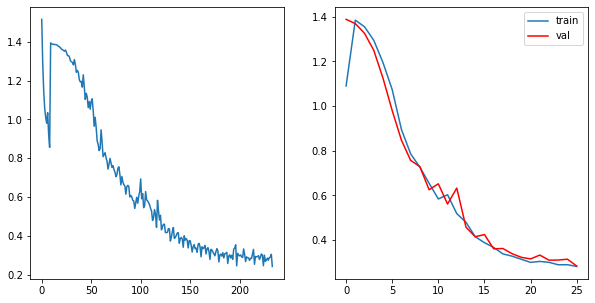

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2602, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2894, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2685, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2646, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2693, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2756, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3103, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2435, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

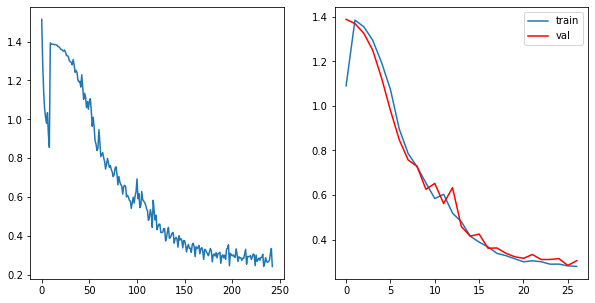

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2890, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2917, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2928, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2958, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2870, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2930, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3006, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3228, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2406, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

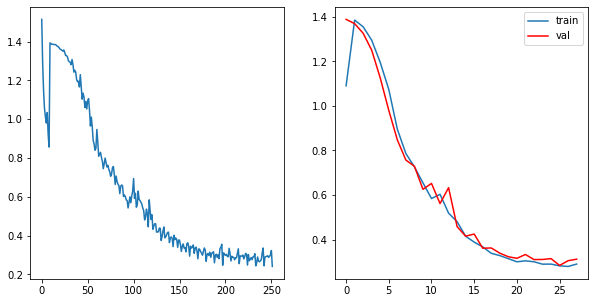

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2757, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2870, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2662, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2638, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.3022, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2903, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2966, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2961, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2454, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

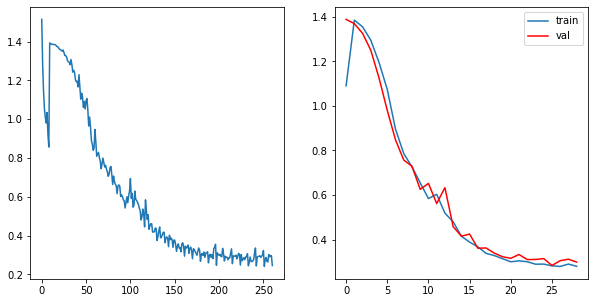

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2681, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2670, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2697, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2858, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2841, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2794, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2315, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

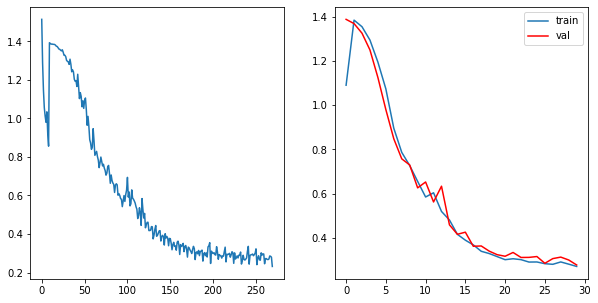

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2443, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2731, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2501, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2696, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2910, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2783, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2281, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

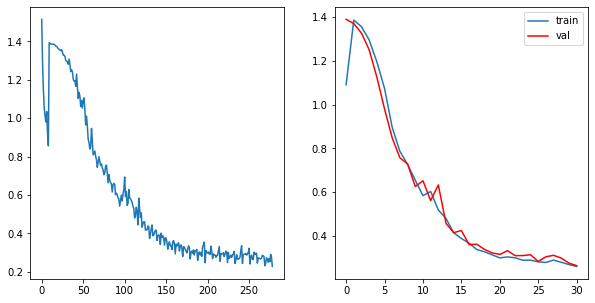

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2386, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2580, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2543, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2579, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2665, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2736, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2241, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

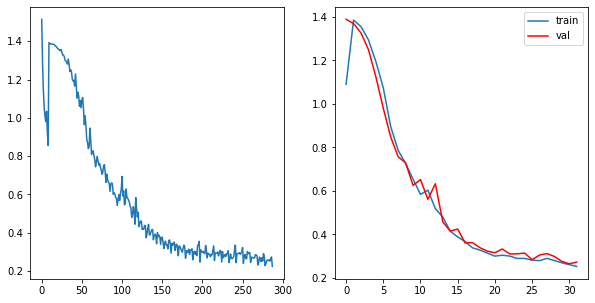

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2493, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2400, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2432, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2650, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2725, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2626, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2234, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

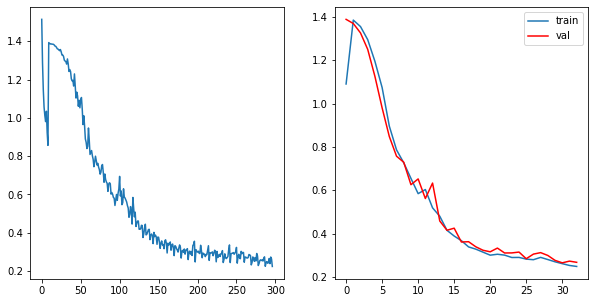

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2395, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2547, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2460, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2486, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2393, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2722, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2835, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2257, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

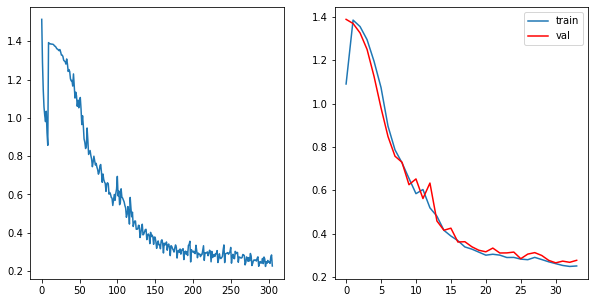

  0%|          | 0/9 [00:00<?, ?it/s]

tensor(0.2560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2361, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2382, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2487, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2538, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2423, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2601, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2220, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

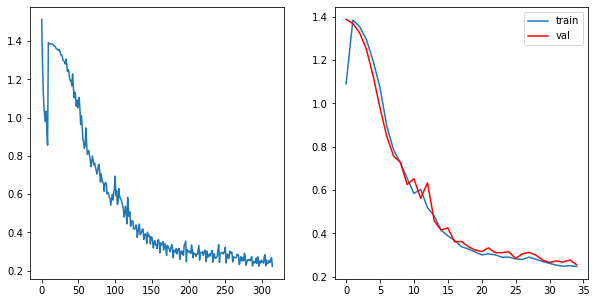

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader), leave=False):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    if epoch % 10 == 0:
        state = {'info':      "Это моя сеть",            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
        torch.save(state, '/state_randomflip_Glub_epoch_' + str(epoch)+ '.pth')
        
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()
    

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2506, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1726, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

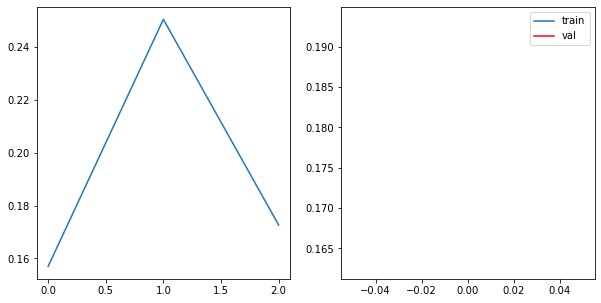

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1700, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2269, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

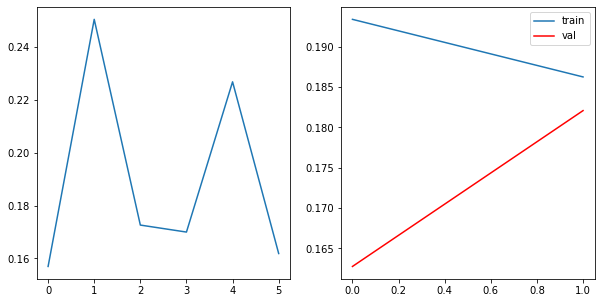

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1918, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1800, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1618, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

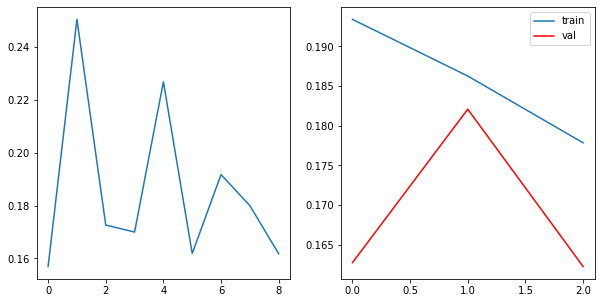

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1705, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1683, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

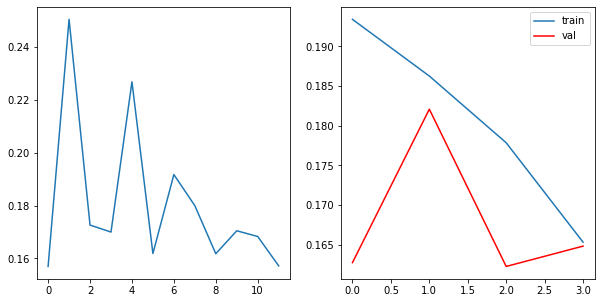

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1619, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1526, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

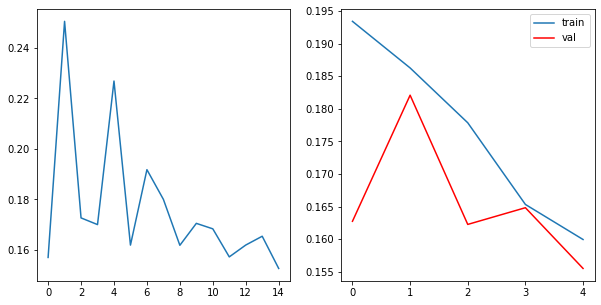

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1560, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1588, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1490, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

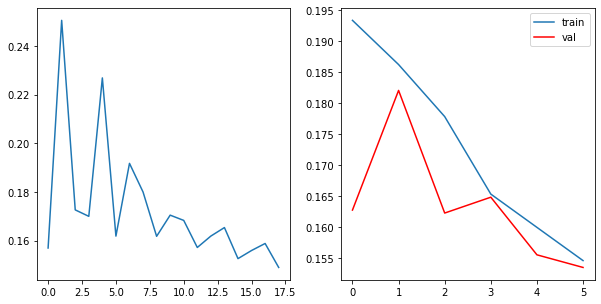

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1558, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1540, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1423, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

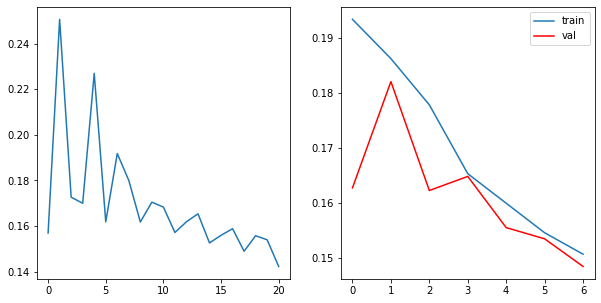

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

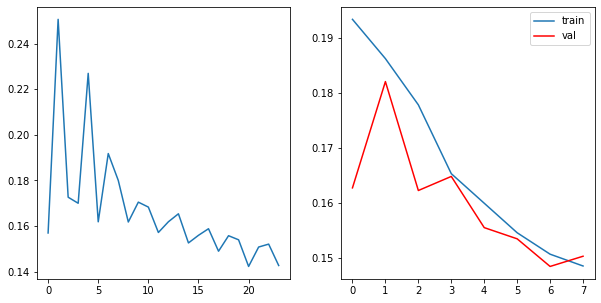

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1507, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1477, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1378, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

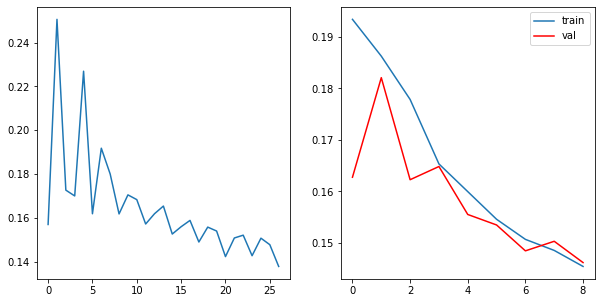

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1479, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1370, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

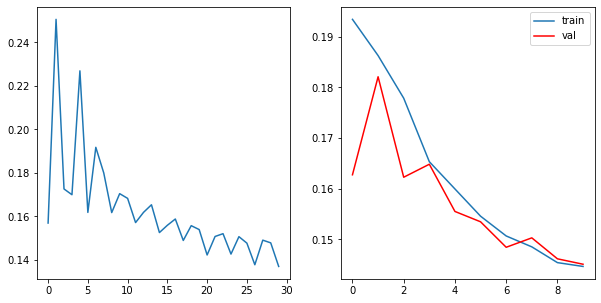

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1454, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1445, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1359, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

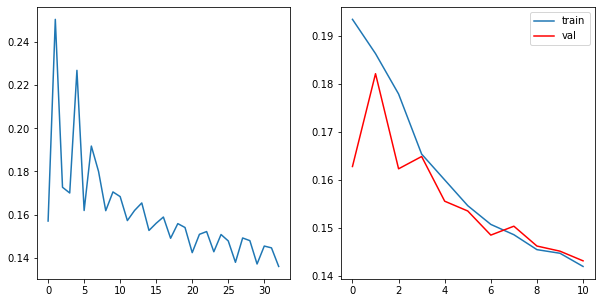

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1437, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1449, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1346, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

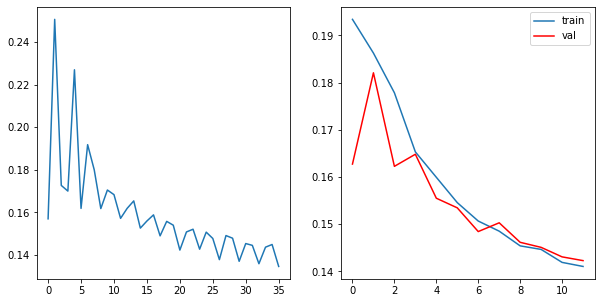

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1433, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1321, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

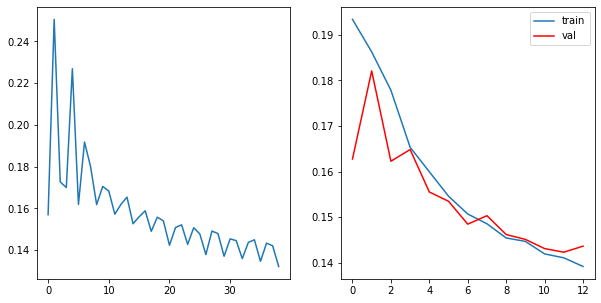

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1410, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1416, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1293, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

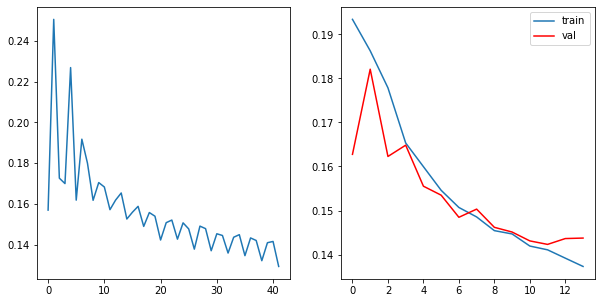

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1407, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1398, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1300, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

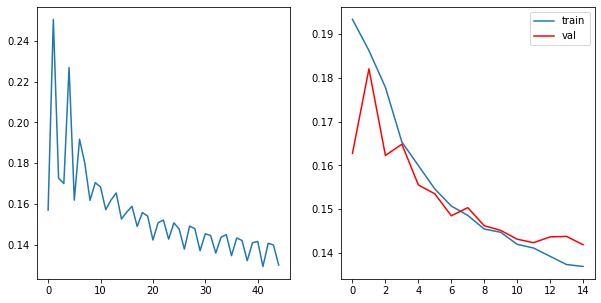

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1396, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1401, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1289, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

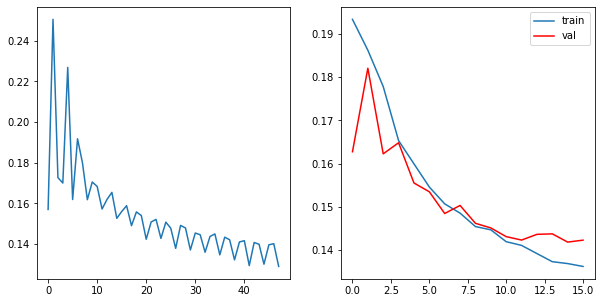

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1388, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1389, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1283, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

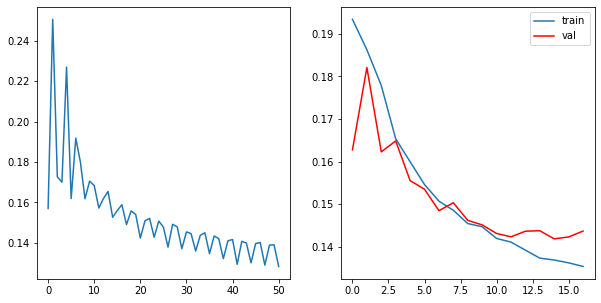

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1368, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1380, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1269, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

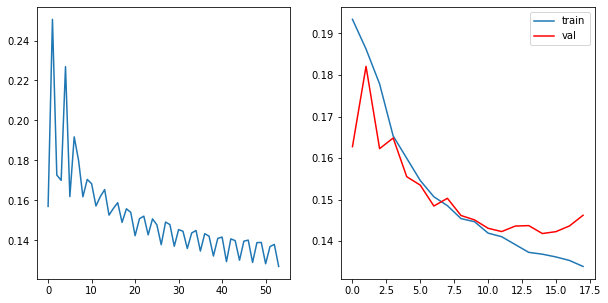

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1373, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1379, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1254, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

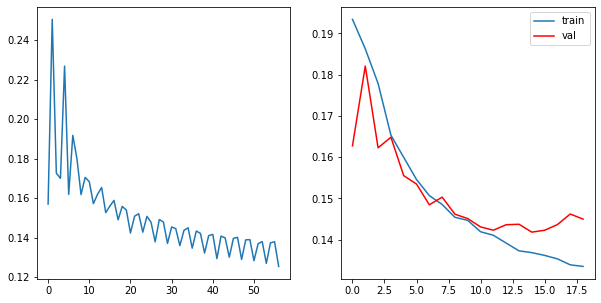

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1354, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1371, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1251, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

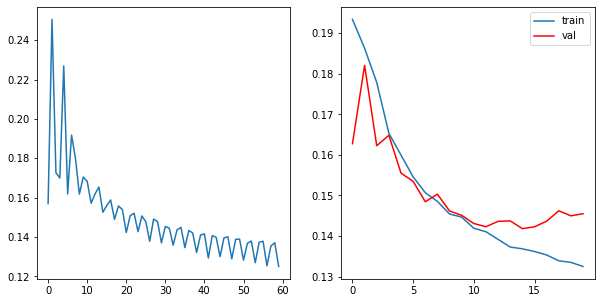

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1364, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1362, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1247, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

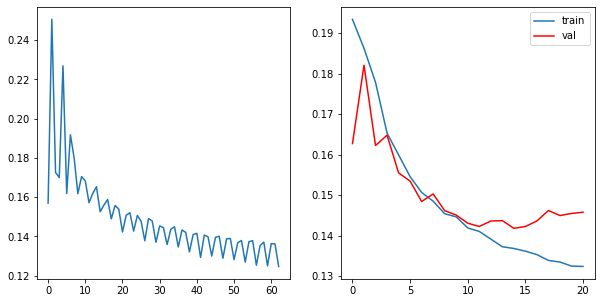

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1358, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1337, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1250, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

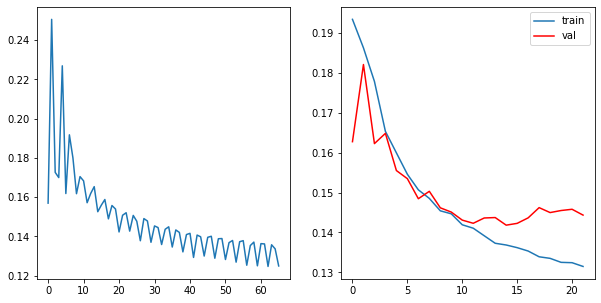

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1338, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1224, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

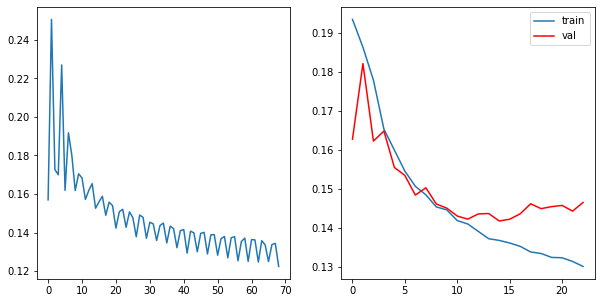

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1344, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1347, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1233, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

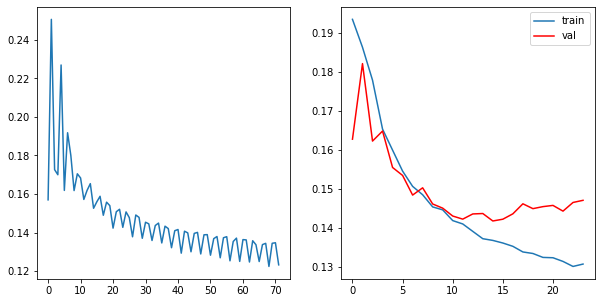

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1345, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1225, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

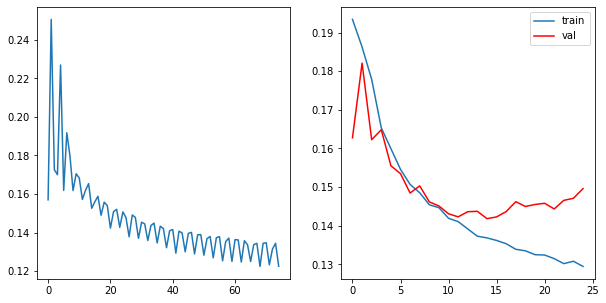

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1332, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1356, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1226, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

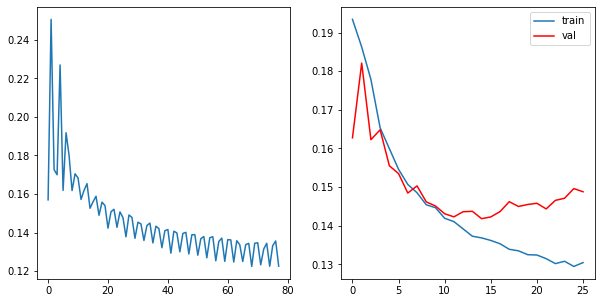

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1315, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1313, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1212, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

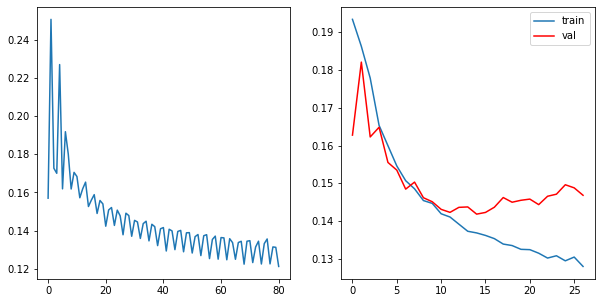

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1331, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1314, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1216, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

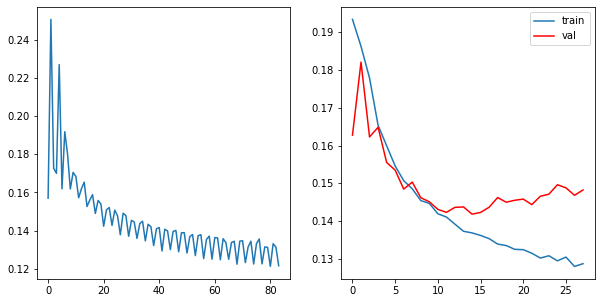

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1312, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1308, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1222, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

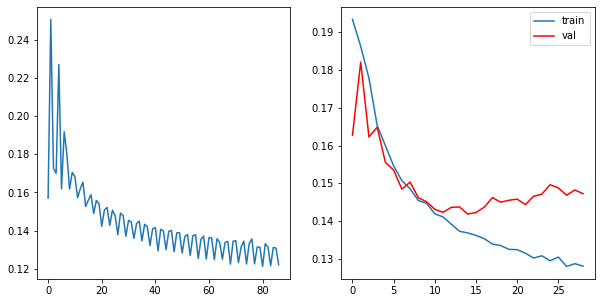

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1301, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1334, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1225, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

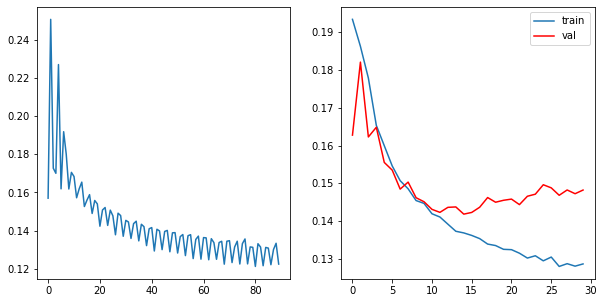

  0%|          | 0/3 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader), leave=False):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


tensor(0.1946, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.2042, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1890, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

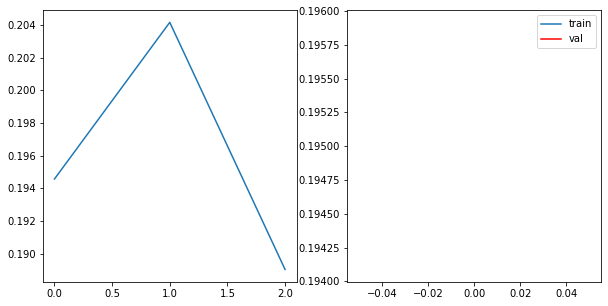

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.2011, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1727, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1891, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

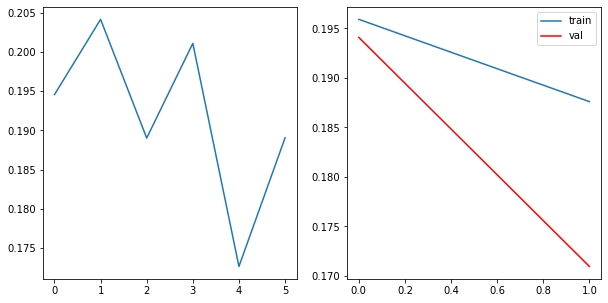

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1860, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1856, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1684, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

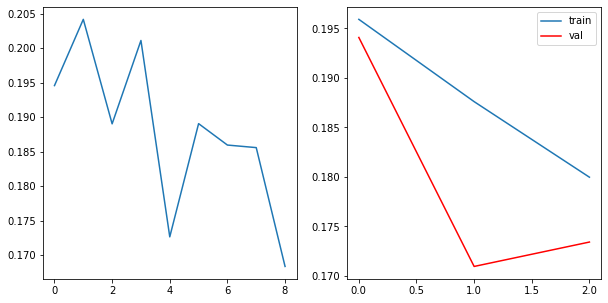

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1745, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1654, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1613, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

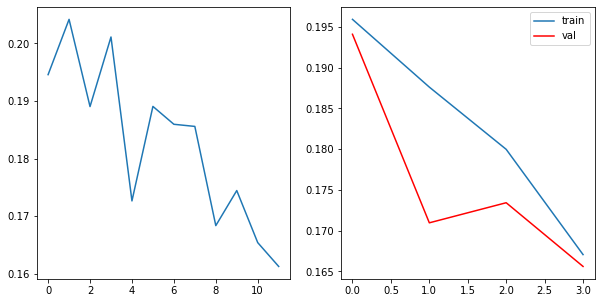

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1658, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1656, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1622, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

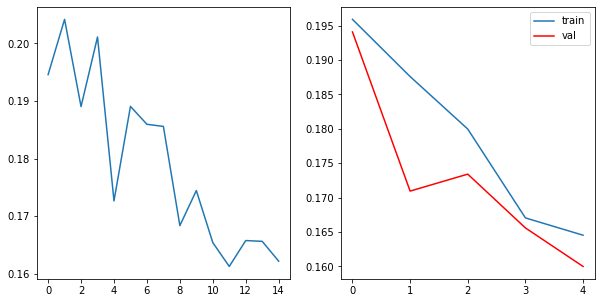

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1639, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1667, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1478, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

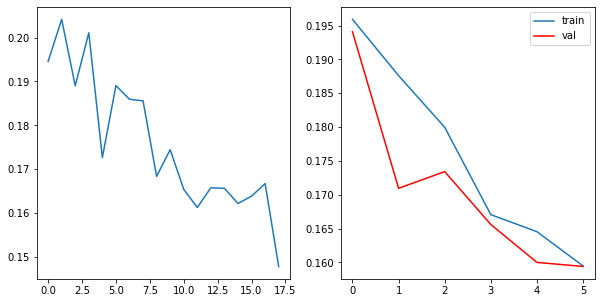

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1641, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1595, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1479, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

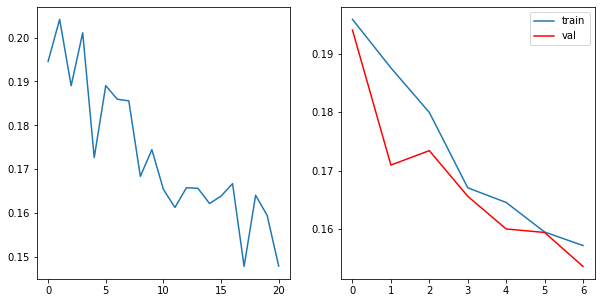

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1570, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1552, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1464, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

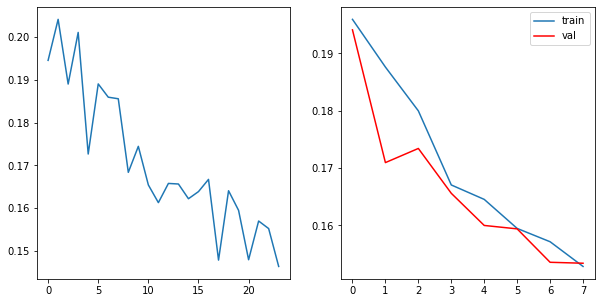

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1561, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1585, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1421, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

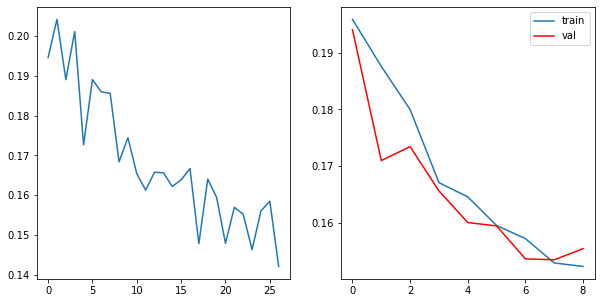

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1572, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1517, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1427, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

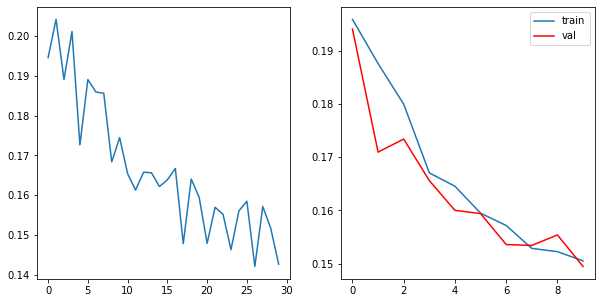

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1518, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1523, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1411, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

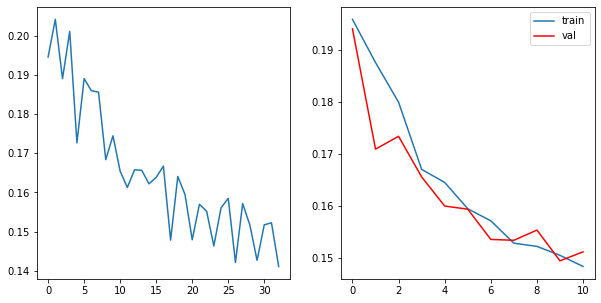

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1508, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1516, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1385, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

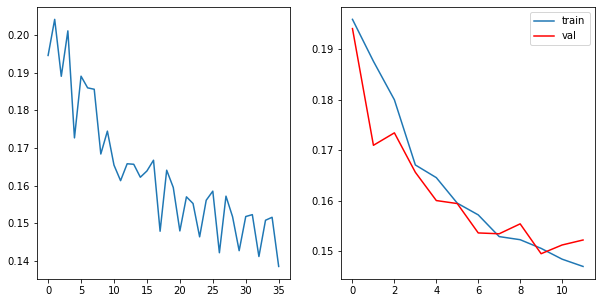

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1521, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1498, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1387, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

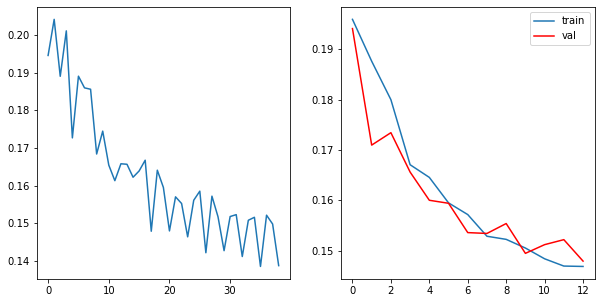

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1491, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1475, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1356, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

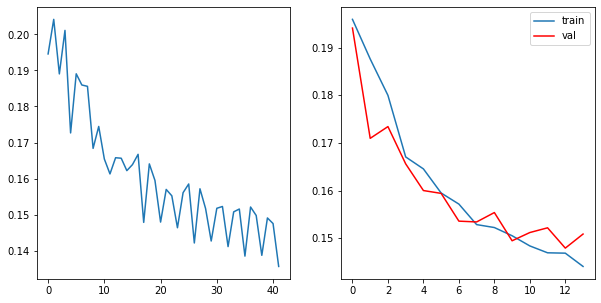

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1484, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1470, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1366, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

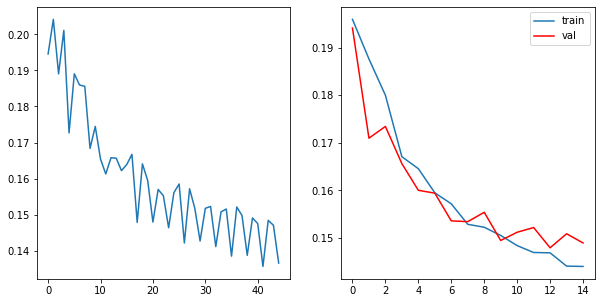

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1457, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1472, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1347, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

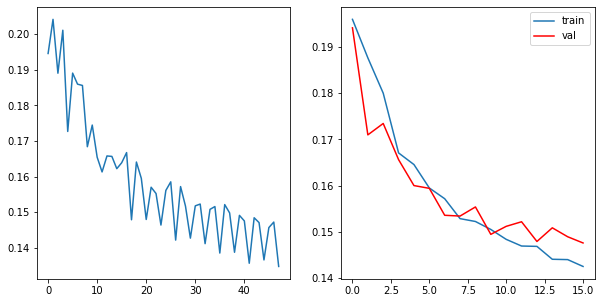

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1471, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1469, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1332, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

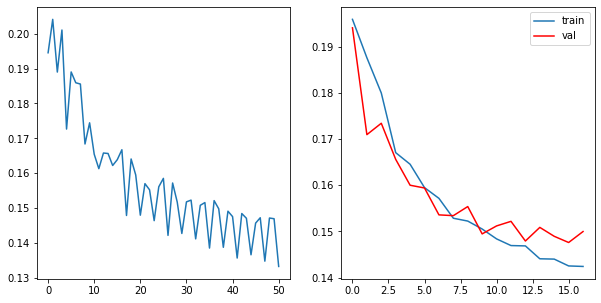

  0%|          | 0/3 [00:00<?, ?it/s]

tensor(0.1452, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1434, dtype=torch.float64, grad_fn=<DivBackward1>)
tensor(0.1327, dtype=torch.float64, grad_fn=<DivBackward1>)


  0%|          | 0/3 [00:00<?, ?it/s]

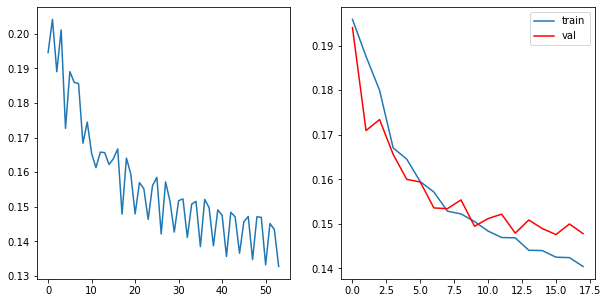

In [ ]:
from tqdm.notebook import tqdm
step_losses = []
epoch_losses_train = []
epoch_losses_val = []

for epoch in tqdm(range(epochs)):
    epoch_loss = 0
    epoch_loss_test = 0
    #model.train()
    for X, Y in tqdm(data_loader, total=len(data_loader), leave=False):
        X, Y = X.to(device), Y.to(device)
        optimizer.zero_grad()
        Y_pred = model(X)
        loss = criterion(Y_pred, Y.permute(0, 3, 1, 2))
        loss.backward()
        optimizer.step()
        epoch_loss += loss.item()
        step_losses.append(loss.item())
        print(loss)
    with torch.no_grad():
        model.eval()
        for X, Y in tqdm(data_loader_test, total=len(data_loader_test), leave=False):
            X, Y = X.to(device), Y.to(device)
            Y_pred = model(X)
            loss_test = criterion(Y_pred, Y.permute(0, 3, 1, 2))
            epoch_loss_test += loss_test.item()
    epoch_losses_val.append(epoch_loss_test/len(data_loader_test))
    epoch_losses_train.append(epoch_loss/len(data_loader))
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].plot(step_losses)
    axes[1].plot(epoch_losses_train, label = 'train')
    axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
    axes[1].legend()
    plt.show()

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].plot(step_losses)
axes[1].plot(epoch_losses_train, label = 'train')
axes[1].plot(epoch_losses_val, color = 'red', label = 'val')
axes[1].legend()

In [ ]:
import datetime
  
state = {'info':      "Это моя сеть",            # описание
         'date':      datetime.datetime.now(),   # дата и время
         'model' :    model.state_dict(),        # параметры модели
         'optimizer': optimizer.state_dict()}    # состояние оптимизатора
 
torch.save(state, '/state_randomflip_SHIR.pth') 

In [ ]:
model.eval()
Y_pred = model(X)

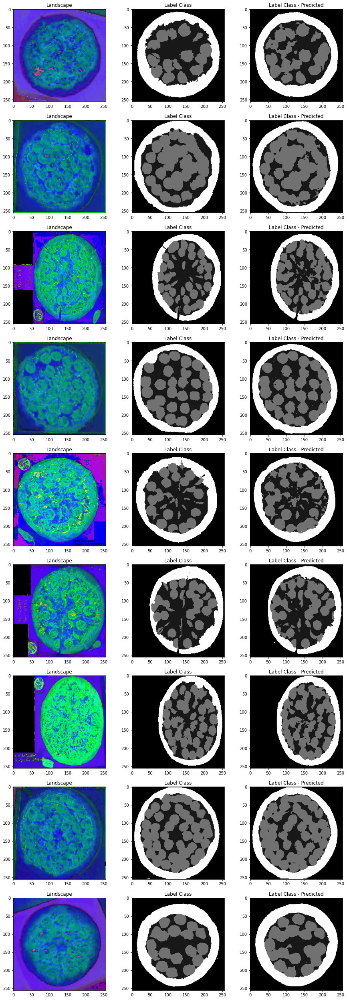

In [ ]:
fig, axes = plt.subplots(9, 3, figsize=(3*5, 9*5))

for i in range(9):
    
    landscape = inverse_transform(X[i]).permute(1, 2, 0).cpu().detach().numpy()
    label_class = __gen__(Y[i])
    label_class_predicted = __gen_pred__(Y_pred[i])
    
    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class, cmap='gray')
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted, cmap='gray')
    axes[i, 2].set_title("Label Class - Predicted")

In [ ]:
#! pip install torchmetrics
from torchmetrics import JaccardIndex

In [ ]:
def __gen_pred_iou__(mask_):
    mask_= mask_.permute(1, 2, 0)
    output = np.zeros((256, 256))
    for i in range(256):
        for j in range(256):
            if np.argmax(mask_[i][j].cpu().detach().numpy()) == 0:
                output[i][j] = 3
            elif np.argmax(mask_[i][j].cpu().detach().numpy()) == 1:
                output[i][j] = 2
            elif np.argmax(mask_[i][j].cpu().detach().numpy()) == 2:
                output[i][j] = 1
            elif np.argmax(mask_[i][j].cpu().detach().numpy()) == 3:
                output[i][j] = 0
            
    return output  

inverse_transform = transforms.Compose([
    transforms.Normalize((-0.485/0.229, -0.456/0.224, -0.406/0.225), (1/0.229, 1/0.224, 1/0.225))
    ])

In [ ]:
def __gen_iou__(mask_):
        output = np.zeros((mask_.shape[0], mask_.shape[1]))
        for i in range(mask_.shape[0]):
            for j in range(mask_.shape[1]):
                if mask_[i][j][0] == 1:
                    output[i][j] = 3
                elif mask_[i][j][1] == 1:
                    output[i][j] = 2
                elif mask_[i][j][2] == 1:
                    output[i][j] = 1
                elif mask_[i][j][3] == 1:
                    output[i][j] = 0
        return output

In [ ]:
sum_ = 0
for i in range(21):
    jac = jaccard(Y_pred[i].argmax(dim = 0), Y[i].permute(2, 0, 1).argmax(dim = 0))
    print(jac)
    sum_ += jac
print('Среднее на тесте: ', sum_/21)

tensor(0.8698)
tensor(0.8496)
tensor(0.8581)
tensor(0.8319)
tensor(0.8615)
tensor(0.8654)
tensor(0.8534)
tensor(0.8773)
tensor(0.8383)
tensor(0.8291)
tensor(0.8733)
tensor(0.8465)
tensor(0.8479)
tensor(0.8581)
tensor(0.8658)
tensor(0.8331)
tensor(0.8931)
tensor(0.8603)
tensor(0.8661)
tensor(0.8622)
tensor(0.8706)
Среднее на тесте:  tensor(0.8577)


валидация

In [ ]:
test_batch_size = 4
dataset = Dataset_new(df_val)
data_loader = DataLoader(dataset, batch_size=test_batch_size)
X, Y = next(iter(data_loader))
X, Y = X.to(device), Y.to(device)
Y_pred = model(X)
print(Y_pred.shape)

torch.Size([4, 4, 256, 256])


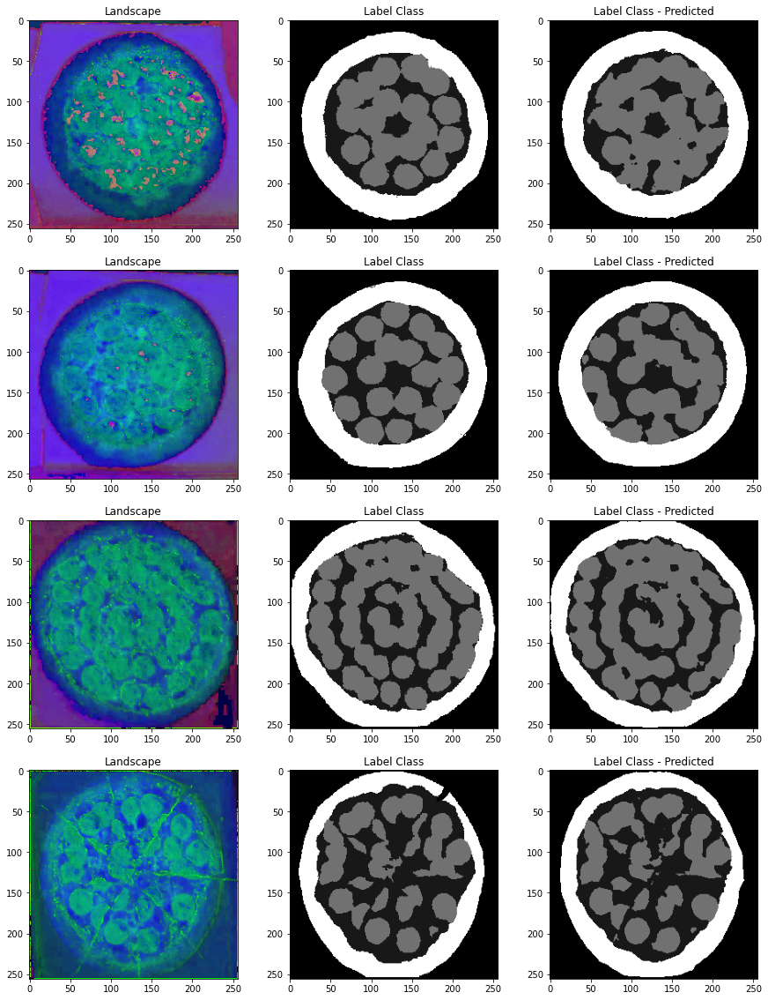

In [ ]:
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):
    
    landscape = inverse_transform(X[i]).permute(1, 2, 0).cpu().detach().numpy()
    label_class = __gen__(Y[i])
    label_class_predicted = __gen_pred__(Y_pred[i])
    
    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class, cmap='gray')
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted, cmap='gray')
    axes[i, 2].set_title("Label Class - Predicted")

In [ ]:
for i in range(test_batch_size):
    pred = __gen_pred_iou__(Y_pred[i])
    target = __gen_iou__(Y[i])
    jaccard = JaccardIndex(num_classes=4)
    print(jaccard(torch.LongTensor(pred), torch.LongTensor(target)))

tensor(0.8446)
tensor(0.8568)
tensor(0.8586)
tensor(0.8794)


TEST

In [ ]:
model.eval()

UNet(
  (Relu): ReLU()
  (Sigmoid): Sigmoid()
  (Softmax): Softmax2d()
  (Upsample): Upsample(scale_factor=2.0, mode=nearest)
  (contracting_11): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (contracting_11_res): Sequential(
    (0): Conv2d(3, 32, kernel_size=(1, 1), stride=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (contracting_12): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (contracting_21): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

In [ ]:
alls_images = os.listdir('/pepperoni_store_test/images')
alls_images_test = []
for i in range(len(alls_images)):
    alls_images_test.append(Path('/pepperoni_store_test/images/'+alls_images[i]))

alls_masks = os.listdir('/pepperoni_store_test/masks')
alls_masks_new = []
for i in range(len(alls_images)):
    for j in range(len(alls_masks)):
        if alls_images[i][:26] == alls_masks[j][0:26]:
            alls_masks_new.append(alls_masks[j])

alls_masks_test = []
for i in range(len(alls_masks_new)):
    alls_masks_test.append(Path('/pepperoni_store_test/masks/'+alls_masks_new[i]))

df_test = pd.DataFrame(list(zip(alls_images_test, alls_masks_test)), columns = ['images', 'masks'])

In [ ]:
dataset = Dataset_new(df_test)
test_batch_size = len(dataset)
data_loader = DataLoader(dataset, batch_size=test_batch_size)
X, Y = next(iter(data_loader))
X, Y = X.to(device), Y.to(device)
Y_pred = model(X)
print(Y_pred.shape)

C:\anaconda3\lib\site-packages\torchvision\transforms\transforms.py:332: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  warnings.warn(


torch.Size([21, 4, 256, 256])


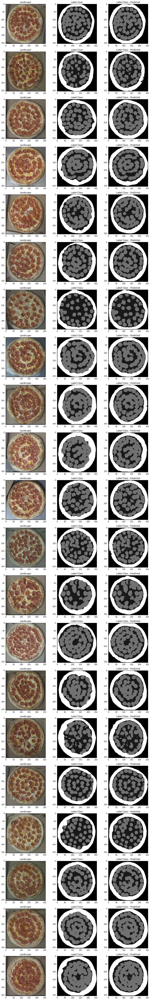

In [ ]:
fig, axes = plt.subplots(test_batch_size, 3, figsize=(3*5, test_batch_size*5))

for i in range(test_batch_size):
    
    landscape = inverse_transform(X[i]).permute(1, 2, 0).cpu().detach().numpy()
    label_class = __gen__(Y[i])
    label_class_predicted = __gen_pred__(Y_pred[i])
    
    axes[i, 0].imshow(landscape)
    axes[i, 0].set_title("Landscape")
    axes[i, 1].imshow(label_class, cmap='gray')
    axes[i, 1].set_title("Label Class")
    axes[i, 2].imshow(label_class_predicted, cmap='gray')
    axes[i, 2].set_title("Label Class - Predicted")

In [ ]:
sum_ = 0
#y_pred = torch.nn.Softmax(dim=1)(Y_pred)
for i in range(test_batch_size):
    jaccard = JaccardIndex(num_classes=4).to(device)
    jac = jaccard(Y_pred[i].argmax(dim = 0), Y[i].permute(2, 0, 1).argmax(dim = 0))
    print(jac)
    sum_ += jac
print('Среднее на тесте: ', sum_/test_batch_size)
 

tensor(0.8971)
tensor(0.8403)
tensor(0.8526)
tensor(0.8952)
tensor(0.8705)
tensor(0.7677)
tensor(0.7941)
tensor(0.9089)
tensor(0.8786)
tensor(0.8534)
tensor(0.8856)
tensor(0.8711)
tensor(0.8697)
tensor(0.8432)
tensor(0.8853)
tensor(0.8283)
tensor(0.9074)
tensor(0.8735)
tensor(0.8824)
tensor(0.8949)
tensor(0.8771)
Среднее на тесте:  tensor(0.8656)


тест на четвертях

In [ ]:
t = { #'90_grad' : transforms.RandomRotation((90,90)), 
     #'180_grad' : transforms.RandomRotation((180,180)),
     #'270_grad' : transforms.RandomRotation((270,270)), 
     #'45_grad' : transforms.RandomRotation((45,45)),
     'GaussianBlur' :  transforms.Compose([transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))]),
     'VerticalFlip' : transforms.RandomVerticalFlip(1),
     'HorizontalFlip' : transforms.RandomHorizontalFlip(1)
}
jaccard = JaccardIndex(num_classes = 4).to(device)
mean_jac_test = 0
for i in range(len(df_test)):
    print('Изображение №:', i)
    image_fn = df_test['images'][i]
    image_fp = os.path.join(image_fn)
    image = Image.open(image_fp)
    trans = transforms.Compose([
                transforms.ToTensor()])   
    
    transform_img = transforms.Compose([
                transforms.Resize((512, 512), Image.NEAREST),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
    x = transform_img(image)
    mask_fn = df_test['masks'][i]
    mask_fp = os.path.join(mask_fn)
    mask = Image.open(mask_fp)
    y = trans(mask)*255
    size_1 = y.shape[1]
    size_2 = y.shape[2]

    mean_jac_image = []
    x_1 = x[:,0:256,0:256]
    x_2 = x[:,0:256,256:512]
    x_3 = x[:,256:512,0:256]
    x_4 = x[:,256:512,256:512]
    y_pred_1 = model(x_1.reshape(-1, 3, 256, 256))
    y_pred_1 = y_pred_1[0].argmax(dim = 0)
    y_pred_2 = model(x_2.reshape(-1, 3, 256, 256))
    y_pred_2 = y_pred_2[0].argmax(dim = 0)
    y_pred_3 = model(x_3.reshape(-1, 3, 256, 256))
    y_pred_3 = y_pred_3[0].argmax(dim = 0)
    y_pred_4 = model(x_4.reshape(-1, 3, 256, 256))
    y_pred_4 = y_pred_4[0].argmax(dim = 0)
    transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
    y_pred =torch.cat((torch.cat((y_pred_1, y_pred_2), dim=1), torch.cat((y_pred_3, y_pred_4), dim=1)), dim=0)
    y_pred = transform_pred(y_pred.reshape(-1, 512, 512))
    y_true_t = _gen_masks_(y)
    jac_t = jaccard(y_pred, torch.from_numpy(y_true_t).permute(2, 0, 1).argmax(dim = 0))
    print(jac_t)
    mean_jac_test +=jac_t
    
print('Среднее IOU на всем тестовом датасете:', mean_jac_test/test_batch_size)






Изображение №: 0
tensor(0.8781)
Изображение №: 1
tensor(0.8635)
Изображение №: 2
tensor(0.8686)
Изображение №: 3
tensor(0.8512)
Изображение №: 4
tensor(0.8571)
Изображение №: 5
tensor(0.8721)
Изображение №: 6
tensor(0.8686)
Изображение №: 7
tensor(0.8917)
Изображение №: 8
tensor(0.8422)
Изображение №: 9
tensor(0.8420)
Изображение №: 10
tensor(0.8840)
Изображение №: 11
tensor(0.8763)
Изображение №: 12
tensor(0.8523)
Изображение №: 13
tensor(0.8650)
Изображение №: 14
tensor(0.8680)
Изображение №: 15
tensor(0.8287)
Изображение №: 16
tensor(0.9099)
Изображение №: 17
tensor(0.8653)
Изображение №: 18
tensor(0.8786)
Изображение №: 19
tensor(0.8662)
Изображение №: 20
tensor(0.8645)
Среднее IOU на всем тестовом датасете: tensor(0.8664)


In [ ]:
t = { #'90_grad' : transforms.RandomRotation((90,90)), 
     #'180_grad' : transforms.RandomRotation((180,180)),
     #'270_grad' : transforms.RandomRotation((270,270)), 
     #'45_grad' : transforms.RandomRotation((45,45)),
     'GaussianBlur' :  transforms.Compose([transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))]),
     'VerticalFlip' : transforms.RandomVerticalFlip(1),
     'HorizontalFlip' : transforms.RandomHorizontalFlip(1)
}
jaccard = JaccardIndex(num_classes = 4).to(device)
mean_jac_test = 0
for i in range(len(df_test)):
    print('Изображение №:', i)
    image_fn = df_test['images'][i]
    image_fp = os.path.join(image_fn)
    image = Image.open(image_fp)
    trans = transforms.Compose([
                transforms.ToTensor()])   
    
    transform_img = transforms.Compose([
                transforms.Resize((512, 512), Image.NEAREST),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
    x = transform_img(image)
    mask_fn = df_test['masks'][i]
    mask_fp = os.path.join(mask_fn)
    mask = Image.open(mask_fp)
    y = trans(mask)*255
    size_1 = y.shape[1]
    size_2 = y.shape[2]

    mean_jac_image = []
    for key in t.keys():
        if key == 'GaussianBlur':
            x_t = t[key](x)
            y_t = y
        else:
            x_t = t[key](x)
            y_t = t[key](y)
        x_1 = x_t[:,0:256,0:256]
        x_2 = x_t[:,0:256,256:512]
        x_3 = x_t[:,256:512,0:256]
        x_4 = x_t[:,256:512,256:512]
        y_pred_1 = model(x_1.reshape(-1, 3, 256, 256))
        y_pred_1 = y_pred_1[0].argmax(dim = 0)
        y_pred_2 = model(x_2.reshape(-1, 3, 256, 256))
        y_pred_2 = y_pred_2[0].argmax(dim = 0)
        y_pred_3 = model(x_3.reshape(-1, 3, 256, 256))
        y_pred_3 = y_pred_3[0].argmax(dim = 0)
        y_pred_4 = model(x_4.reshape(-1, 3, 256, 256))
        y_pred_4 = y_pred_4[0].argmax(dim = 0)
        transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
        y_pred =torch.cat((torch.cat((y_pred_1, y_pred_2), dim=1), torch.cat((y_pred_3, y_pred_4), dim=1)), dim=0)
        y_pred = transform_pred(y_pred.reshape(-1, 512, 512))
        y_true_t = _gen_masks_(y_t)
        jac_t = jaccard(y_pred, torch.from_numpy(y_true_t).permute(2, 0, 1).argmax(dim = 0))
        print(key, ' : ', jac_t)
        mean_jac_image.append(jac_t)
    x_1 = x[:,0:256,0:256]
    x_2 = x[:,0:256,256:512]
    x_3 = x[:,256:512,0:256]
    x_4 = x[:,256:512,256:512]
    y_pred_1 = model(x_1.reshape(-1, 3, 256, 256))
    y_pred_1 = y_pred_1[0].argmax(dim = 0)
    y_pred_2 = model(x_2.reshape(-1, 3, 256, 256))
    y_pred_2 = y_pred_2[0].argmax(dim = 0)
    y_pred_3 = model(x_3.reshape(-1, 3, 256, 256))
    y_pred_3 = y_pred_3[0].argmax(dim = 0)
    y_pred_4 = model(x_4.reshape(-1, 3, 256, 256))
    y_pred_4 = y_pred_4[0].argmax(dim = 0)
    transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
    y_pred =torch.cat((torch.cat((y_pred_1, y_pred_2), dim=1), torch.cat((y_pred_3, y_pred_4), dim=1)), dim=0)
    y_pred = transform_pred(y_pred.reshape(-1, 512, 512))
    y_true = _gen_masks_(y)
    jac = jaccard(y_pred, torch.from_numpy(y_true).permute(2, 0, 1).argmax(dim = 0))
    print('без преобразований: ', jac)
    mean_jac_image.append(jac)
    print('Лучшее IOU на изображении:', max(mean_jac_image))
    mean_jac_test += max(mean_jac_image)
print('Среднее IOU на всем тестовом датасете:', mean_jac_test/test_batch_size)






Изображение №: 0
GaussianBlur  :  tensor(0.8693)
VerticalFlip  :  tensor(0.8810)
HorizontalFlip  :  tensor(0.8838)
без преобразований:  tensor(0.8781)
Лучшее IOU на изображении: tensor(0.8838)
Изображение №: 1
GaussianBlur  :  tensor(0.8569)
VerticalFlip  :  tensor(0.8557)
HorizontalFlip  :  tensor(0.8707)
без преобразований:  tensor(0.8635)
Лучшее IOU на изображении: tensor(0.8707)
Изображение №: 2
GaussianBlur  :  tensor(0.8685)
VerticalFlip  :  tensor(0.8633)
HorizontalFlip  :  tensor(0.8690)
без преобразований:  tensor(0.8686)
Лучшее IOU на изображении: tensor(0.8690)
Изображение №: 3
GaussianBlur  :  tensor(0.8550)
VerticalFlip  :  tensor(0.8547)
HorizontalFlip  :  tensor(0.8465)
без преобразований:  tensor(0.8512)
Лучшее IOU на изображении: tensor(0.8550)
Изображение №: 4
GaussianBlur  :  tensor(0.8583)
VerticalFlip  :  tensor(0.8561)
HorizontalFlip  :  tensor(0.8513)
без преобразований:  tensor(0.8571)
Лучшее IOU на изображении: tensor(0.8583)
Изображение №: 5
GaussianBlur  :  t

In [ ]:
for i in range(4):
    print(y_pred[0][i][100][100])

tensor(9.6847e-06, grad_fn=<SelectBackward0>)
tensor(0.9696, grad_fn=<SelectBackward0>)
tensor(0.0303, grad_fn=<SelectBackward0>)
tensor(6.6586e-05, grad_fn=<SelectBackward0>)


In [ ]:
t = torch.nn.Softmax(dim=0)(Y_pred[0])
for i in range(4):
    print(t[i][100][100])

tensor(9.6847e-06, grad_fn=<SelectBackward0>)
tensor(0.9696, grad_fn=<SelectBackward0>)
tensor(0.0303, grad_fn=<SelectBackward0>)
tensor(6.6586e-05, grad_fn=<SelectBackward0>)


In [ ]:
import torch.nn as tornn
sftmx = tornn.Softmax(dim=0)

In [ ]:
a = np.array([[1.5, 2.5, 3.5, 4.5]])
a = transforms.ToTensor()(a)

In [ ]:
b = sftmx(a)
b

tensor([[[1., 1., 1., 1.]]], dtype=torch.float64)

In [ ]:
X = torch.tensor( [ [1.,2.,3.,4.] ] )
torch.nn.Softmax(dim=1)(X)

tensor([[0.0321, 0.0871, 0.2369, 0.6439]])

TTA

In [ ]:
def _gen_masks_(mask_):
        output = np.zeros((mask_.shape[1], mask_.shape[2], 4))
        for i in range(mask_.shape[1]):
            for j in range(mask_.shape[2]):
                if mask_[0][i][j] == 254:
                    output[i][j][0] = 1
                elif mask_[0][i][j] == 114:
                    output[i][j][1] = 1
                elif mask_[0][i][j] == 24:
                    output[i][j][2] = 1
                elif mask_[0][i][j] == 0:
                    output[i][j][3] = 1
            
        return output  


In [ ]:
class Dataset_TTA():
    
    def __init__(self, image_dir):
        self.image_dir = image_dir
        
        
        
    def __len__(self):
        return len(self.image_dir)
    
    def __getitem__(self, index):
        image_fn = self.image_dir['images'][index]
        image_fp = os.path.join(image_fn)
        image = Image.open(image_fp)
        transform_img = transforms.Compose([
             transforms.Resize((256, 256), Image.NEAREST),
                transforms.ToTensor(),
               
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
        transform_mask = transforms.Compose([
            transforms.Resize((256, 256), Image.NEAREST),    
            transforms.ToTensor()
                ])
        image = transform_img(image)

        mask_fn = self.image_dir['masks'][index]
        mask_fp = os.path.join(mask_fn)
        mask = Image.open(mask_fp)
        mask = transform_mask(mask)*255
        
        return image, mask
  

In [ ]:
dataset = Dataset_TTA(df_test)
test_batch_size = len(dataset)
data_loader = DataLoader(dataset, batch_size=test_batch_size)
X, Y = next(iter(data_loader))
X, Y = X.to(device), Y.to(device)
#Y_pred = model(X)
print(Y.shape)

torch.Size([21, 1, 256, 256])


In [ ]:
t = { #'90_grad' : transforms.RandomRotation((90,90)), 
     #'180_grad' : transforms.RandomRotation((180,180)),
     #'270_grad' : transforms.RandomRotation((270,270)), 
     #'45_grad' : transforms.RandomRotation((45,45)),
     'GaussianBlur' :  transforms.Compose([transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))]),
     'VerticalFlip' : transforms.RandomVerticalFlip(1),
     'HorizontalFlip' : transforms.RandomHorizontalFlip(1)
}
jaccard = JaccardIndex(num_classes = 4).to(device)
mean_jac_test = 0
for i in range(test_batch_size):
    print('Изображение №:', i)
    x = X[i]
    y = Y[i]
    mean_jac_image = []
    for key in t.keys():
        if key == 'GaussianBlur':
            x_t = t[key](x)
            y_t = y
        else:
            x_t = t[key](x)
            y_t = t[key](y)
        y_pred_t = model(x_t.reshape(-1, 3, 256, 256))
        y_true_t = _gen_masks_(y_t)
        jac_t = jaccard(y_pred_t[0].to(device).argmax(dim = 0), torch.from_numpy(y_true_t).to(device).permute(2, 0, 1).argmax(dim = 0))
        print(key, ' : ', jac_t)
        mean_jac_image.append(jac_t)
    y_pred = model(x.reshape(-1, 3, 256, 256))
    y_true = _gen_masks_(y)
    jac = jaccard(y_pred[0].to(device).argmax(dim = 0), torch.from_numpy(y_true).to(device).permute(2, 0, 1).argmax(dim = 0))
    print('без преобразований: ', jac)
    mean_jac_image.append(jac)
    print('Лучшее IOU на изображении:', max(mean_jac_image))
    mean_jac_test += max(mean_jac_image)
print('Среднее IOU на всем тестовом датасете:', mean_jac_test/test_batch_size)


Изображение №: 0
GaussianBlur  :  tensor(0.8613)
VerticalFlip  :  tensor(0.8636)
HorizontalFlip  :  tensor(0.8674)
без преобразований:  tensor(0.8683)
Лучшее IOU на изображении: tensor(0.8683)
Изображение №: 1
GaussianBlur  :  tensor(0.8431)
VerticalFlip  :  tensor(0.8711)
HorizontalFlip  :  tensor(0.8701)
без преобразований:  tensor(0.8765)
Лучшее IOU на изображении: tensor(0.8765)
Изображение №: 2
GaussianBlur  :  tensor(0.8645)
VerticalFlip  :  tensor(0.8701)
HorizontalFlip  :  tensor(0.8732)
без преобразований:  tensor(0.8766)
Лучшее IOU на изображении: tensor(0.8766)
Изображение №: 3
GaussianBlur  :  tensor(0.8595)
VerticalFlip  :  tensor(0.8724)
HorizontalFlip  :  tensor(0.8573)
без преобразований:  tensor(0.8676)
Лучшее IOU на изображении: tensor(0.8724)
Изображение №: 4
GaussianBlur  :  tensor(0.8625)
VerticalFlip  :  tensor(0.8652)
HorizontalFlip  :  tensor(0.8668)
без преобразований:  tensor(0.8729)
Лучшее IOU на изображении: tensor(0.8729)
Изображение №: 5
GaussianBlur  :  t

Полноразмерная TTA

In [ ]:
t = { #'90_grad' : transforms.RandomRotation((90,90)), 
     #'180_grad' : transforms.RandomRotation((180,180)),
     #'270_grad' : transforms.RandomRotation((270,270)), 
     #'45_grad' : transforms.RandomRotation((45,45)),
     'GaussianBlur' :  transforms.Compose([transforms.GaussianBlur(kernel_size=(5, 9), sigma=(0.1, 5))]),
     'VerticalFlip' : transforms.RandomVerticalFlip(1),
     'HorizontalFlip' : transforms.RandomHorizontalFlip(1)
}
jaccard = JaccardIndex(num_classes = 4).to(device)
mean_jac_test = 0
for i in range(len(df_test)):
    print('Изображение №:', i)
    image_fn = df_test['images'][i]
    image_fp = os.path.join(image_fn)
    image = Image.open(image_fp)
    trans = transforms.Compose([
                transforms.ToTensor()])   
    
    transform_img = transforms.Compose([
                transforms.Resize((256, 256), Image.NEAREST),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
    x = transform_img(image)
    mask_fn = df_test['masks'][i]
    mask_fp = os.path.join(mask_fn)
    mask = Image.open(mask_fp)
    y = trans(mask)*255
    size_1 = y.shape[1]
    size_2 = y.shape[2]

    mean_jac_image = []
    for key in t.keys():
        if key == 'GaussianBlur':
            x_t = t[key](x)
            y_t = y
        else:
            x_t = t[key](x)
            y_t = t[key](y)
        y_pred = model(x_t.reshape(-1, 3, 256, 256))
        y_pred = y_pred[0].argmax(dim = 0)
        transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
        y_pred = transform_pred(y_pred.reshape(-1, 256, 256))
        y_true_t = _gen_masks_(y_t)
        jac_t = jaccard(y_pred, torch.from_numpy(y_true_t).permute(2, 0, 1).argmax(dim = 0))
        print(key, ' : ', jac_t)
        mean_jac_image.append(jac_t)
    y_pred = model(x.reshape(-1, 3, 256, 256))
    y_pred = y_pred[0].argmax(dim = 0)
    transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
    y_pred = transform_pred(y_pred.reshape(-1, 256, 256))
    y_true = _gen_masks_(y)
    jac = jaccard(y_pred, torch.from_numpy(y_true).permute(2, 0, 1).argmax(dim = 0))
    print('без преобразований: ', jac)
    mean_jac_image.append(jac)
    print('Лучшее IOU на изображении:', max(mean_jac_image))
    mean_jac_test += max(mean_jac_image)
print('Среднее IOU на всем тестовом датасете:', mean_jac_test/test_batch_size)






Изображение №: 0
GaussianBlur  :  tensor(0.8398)
VerticalFlip  :  tensor(0.8554)
HorizontalFlip  :  tensor(0.8574)
без преобразований:  tensor(0.8580)
Лучшее IOU на изображении: tensor(0.8580)
Изображение №: 1
GaussianBlur  :  tensor(0.8620)
VerticalFlip  :  tensor(0.8623)
HorizontalFlip  :  tensor(0.8662)
без преобразований:  tensor(0.8688)
Лучшее IOU на изображении: tensor(0.8688)
Изображение №: 2
GaussianBlur  :  tensor(0.8477)
VerticalFlip  :  tensor(0.8619)
HorizontalFlip  :  tensor(0.8658)
без преобразований:  tensor(0.8687)
Лучшее IOU на изображении: tensor(0.8687)
Изображение №: 3
GaussianBlur  :  tensor(0.8639)
VerticalFlip  :  tensor(0.8674)
HorizontalFlip  :  tensor(0.8509)
без преобразований:  tensor(0.8618)
Лучшее IOU на изображении: tensor(0.8674)
Изображение №: 4
GaussianBlur  :  tensor(0.8452)
VerticalFlip  :  tensor(0.8576)
HorizontalFlip  :  tensor(0.8595)
без преобразований:  tensor(0.8656)
Лучшее IOU на изображении: tensor(0.8656)
Изображение №: 5
GaussianBlur  :  t

In [ ]:
for i in range(len(df_test)):
    print(df_test['images'][i])

\pepperoni_store_test\images\pjiStore11_20180509_000062.jpg
\pepperoni_store_test\images\pjiStore11_20180509_000070.jpg
\pepperoni_store_test\images\pjiStore11_20180509_000112.jpg
\pepperoni_store_test\images\pjiStore11_20180510_000020.jpg
\pepperoni_store_test\images\pjiStore11_20180510_000158.jpg
\pepperoni_store_test\images\pjiStore11_20180510_000248.jpg
\pepperoni_store_test\images\pjiStore11_20180511_000221.jpg
\pepperoni_store_test\images\pjiStore11_20180511_000545.jpg
\pepperoni_store_test\images\pjiStore11_20180512_000341.jpg
\pepperoni_store_test\images\pjiStore11_20180513_000331.jpg
\pepperoni_store_test\images\pjiStore11_20180513_000390.jpg
\pepperoni_store_test\images\pjiStore11_20180514_000272.jpg
\pepperoni_store_test\images\pjiStore11_20180514_000325.jpg
\pepperoni_store_test\images\pjiStore11_20180515_000106.jpg
\pepperoni_store_test\images\pjiStore11_20180516_000071.jpg
\pepperoni_store_test\images\pjiStore11_20180516_000096.jpg
\pepperoni_store_test\images\pjiStore11_

torch.Size([1, 4, 512, 512])
torch.Size([1, 512, 512])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.6645)


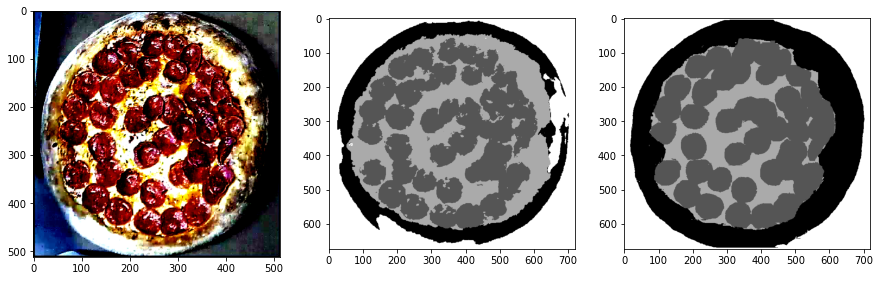

In [ ]:
image_fn = df_test['images'][9]
image_fp = os.path.join(image_fn)
image = Image.open(image_fp)
trans = transforms.Compose([
    #transforms.Resize((512, 512), Image.NEAREST),
                transforms.ToTensor()])   
    
transform_img = transforms.Compose([
                transforms.Resize((512, 512), Image.NEAREST),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
x = transform_img(image)


y_pred = model(x.reshape(-1, 3, 512, 512))
print(y_pred.shape)
y_pred = y_pred.argmax(dim = 1)
print(y_pred.shape)

mask_fn = df_test['masks'][9]
mask_fp = os.path.join(mask_fn)
mask = Image.open(mask_fp)
y = trans(mask)*255
size_1 = y.shape[1]
size_2 = y.shape[2]

transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
y_pred = transform_pred(y_pred)
y_true_t = _gen_masks_(y)
jaccard = JaccardIndex(num_classes=4)
jac_t = jaccard(y_pred[0], torch.from_numpy(y_true_t).permute(2, 0, 1).argmax(dim = 0))
print(jac_t)

fig, axes = plt.subplots(1, 3, figsize=(3*5, 9*5))
axes[0].imshow(x.permute(1, 2, 0).cpu().detach().numpy())
axes[1].imshow(y_pred[0].cpu().detach().numpy(), cmap='gray')
axes[2].imshow(torch.from_numpy(y_true_t).permute(2, 0, 1).argmax(dim = 0).cpu().detach().numpy(), cmap='gray')

In [ ]:
image_fn = df_test['images'][0]
image_fp = os.path.join(image_fn)
image = Image.open(image_fp)
trans = transforms.Compose([
                transforms.ToTensor()])   
    
transform_img = transforms.Compose([
                transforms.Resize((1024, 1024), Image.NEAREST),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
x = transform_img(image)
mask_fn = df_test['masks'][0]
mask_fp = os.path.join(mask_fn)
mask = Image.open(mask_fp)
y = trans(mask)*255
size_1 = y.shape[1]
size_2 = y.shape[2]    
y_pred = model(x.reshape(-1, 3, 256, 256))
print(y_pred.shape)
y_pred = y_pred[0].argmax(dim = 0)

transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])
y_pred = transform_pred(y_pred.reshape(-1, 256, 256))
y_true_t = _gen_masks_(y)
print(y_pred.shape)
jaccard = JaccardIndex(num_classes=4)
jac_t = jaccard(y_pred, torch.from_numpy(y_true_t).permute(2, 0, 1).argmax(dim = 0))
print(jac_t)

torch.Size([16, 4, 256, 256])
torch.Size([1, 772, 871])
tensor(0.0730)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([1, 772, 871])
tensor(0.8324)


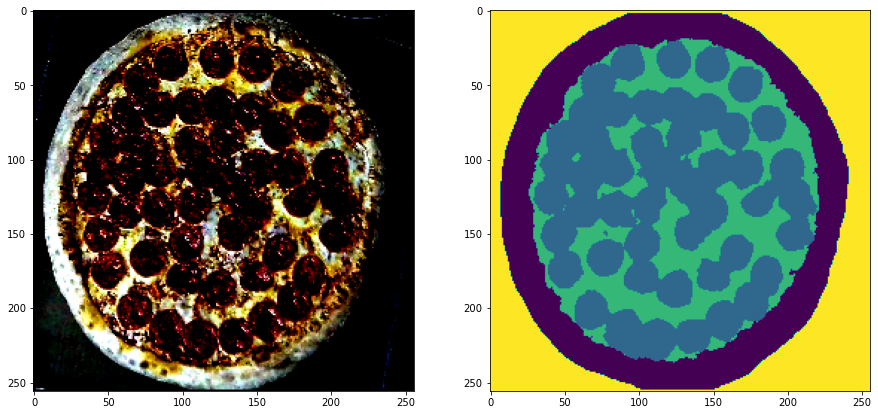

In [ ]:
image_fn = df_test['images'][0]
image_fp = os.path.join(image_fn)
image = Image.open(image_fp)
trans = transforms.Compose([
                transforms.ToTensor()])   
image = trans(image)
size_1 = image.shape[1]
size_2 = image.shape[2]
transform_img = transforms.Compose([
                transforms.Resize((256, 256), Image.NEAREST),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
image = transform_img(image)
y_pred = model(image.reshape(-1, 3, 256, 256))

y_pred = y_pred[0].argmax(dim = 0)
fig, axes = plt.subplots(1, 2, figsize=(3*5, 9*5))

axes[0].imshow(image.permute(1, 2, 0).cpu().detach().numpy())
axes[1].imshow(y_pred.cpu().detach().numpy())
transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])

y_pred = transform_pred(y_pred.reshape(-1, 256, 256))
print(y_pred.shape)
mask_fn = df_test['masks'][0]
mask_fp = os.path.join(mask_fn)
mask = Image.open(mask_fp)
mask = trans(mask)*255
mask = _gen_masks_(mask)

jaccard = JaccardIndex(num_classes=4).to(device)
jac = jaccard(y_pred[0], torch.from_numpy(mask).permute(2, 0, 1).argmax(dim = 0))
print(jac)
mask

In [ ]:
sum_ = 0
for i in range(len(df_test)):
    image_fn = df_test['images'][i]
    image_fp = os.path.join(image_fn)
    image = Image.open(image_fp)
    trans = transforms.Compose([
                transforms.ToTensor()])   
    
    transform_img = transforms.Compose([
                transforms.Resize((256, 256), Image.NEAREST),
        transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                ])
    image = transform_img(image)
    mask_fn = df_test['masks'][i]
    mask_fp = os.path.join(mask_fn)
    mask = Image.open(mask_fp)
    mask = trans(mask)*255
    size_1 = mask.shape[1]
    size_2 = mask.shape[2]
    mask = _gen_masks_(mask)

    y_pred = model(image.reshape(-1, 3, 256, 256))

    y_pred = y_pred[0].argmax(dim = 0)

    transform_pred = transforms.Compose([
                transforms.Resize((size_1, size_2), Image.NEAREST)
                ])

    y_pred = transform_pred(y_pred.reshape(-1, 256, 256))
    jaccard = JaccardIndex(num_classes=4).to(device)
    jac = jaccard(y_pred, torch.from_numpy(mask).permute(2, 0, 1).argmax(dim = 0))
    print(jac)
    sum_ += jac
print('Среднее на тесте: ', sum_/test_batch_size)

NameError: name '_gen_masks_' is not defined